<a href="https://colab.research.google.com/github/rmib200/Deap-dataset-analysis/blob/main/DEAP_Dataset_Data_Mining.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Downloading Data

To download the data you should go to https://www.eecs.qmul.ac.uk/mmv/datasets/deap/ and follow the steps detailed on the website.

In [ ]:
!wget https://storage.googleapis.com/dataproc-ucb-bucket-home/data_preprocessed_python.zip
!wget https://storage.googleapis.com/dataproc-ucb-bucket-home/metadata_csv.zip
!unzip /content/metadata_csv.zip
!unzip /content/data_preprocessed_python.zip

--2021-09-11 03:38:13--  https://storage.googleapis.com/dataproc-ucb-bucket-home/data_preprocessed_python.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 209.85.147.128, 142.250.125.128, 142.250.136.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|209.85.147.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2915493601 (2.7G) [application/x-zip-compressed]
Saving to: ‘data_preprocessed_python.zip’

data_preprocessed_p 100%[===================>]   2.71G  31.7MB/s    in 43s     

2021-09-11 03:38:57 (64.5 MB/s) - ‘data_preprocessed_python.zip’ saved [2915493601/2915493601]

--2021-09-11 03:38:57--  https://storage.googleapis.com/dataproc-ucb-bucket-home/metadata_csv.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 142.250.128.128, 142.251.6.128, 74.125.70.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.250.128.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
L

In [ ]:
# http://www.eecs.qmul.ac.uk/mmv/datasets/deap/readme.html
# 9.830.400 size

In [ ]:
# Importing dependencies
import os #Operating System
import pickle #serializar datos 
import numpy as np #numerical python
import pandas as pd #explorar datos
from sklearn.preprocessing import OrdinalEncoder #Encode labels
from sklearn.preprocessing import StandardScaler #Scale variables
from sklearn.decomposition import PCA #Decomposition
from sklearn.model_selection import cross_val_score #Cross-validate
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression #Modelo Regresion Logistica
import matplotlib.pyplot as plt # Plotting
plt.style.use('seaborn-whitegrid') #Seaborn style
plt.rcParams['figure.figsize'] = [18,5] #Fig settings

#Importing Signals

In [ ]:
# guia abrir datos DEAP https://www.researchgate.net/post/How-to-handle-DEAP-dataset-for-emotion-recognition-in-python
file = "/content/data_preprocessed_python/s01.dat" #open one data
with open(file, 'rb') as f:
  x = pickle.load(f, encoding='latin1') #store on variable x

In [ ]:
# opening all files
folder = "/content/data_preprocessed_python/" #Folder path
files = os.listdir(folder) #Read files names on folder
files = sorted(files) #Sort alphabetically
files_list = [] #create list for files
for file in files:
  full_path = f"{folder}/{file}"
  with open(full_path, "rb") as f:
    d = pickle.load(f, encoding="latin1")
    files_list.append(d) #append file to files_list
print(len(files_list)) #print number of files

labels_names = ["valence", "arousal", "dominance", "liking"]

32


#EDA

In [ ]:
#Definimos la funcion 
def data_description():

  print("==",type(x))
  print("==",x.keys())
  # print("==",x.get("labels"))
  print("==",len(x.get("labels")))
  print("Labels:")
  print("==","video/trial x [valence, arousal, dominance, liking]")
  print("==", np.shape(x.get("labels")))
  print("Data:")
  print("==","video/trial x channel x data")
  print("==",np.shape(x.get("data")))

#Llamamos la funcion
data_description()

# averiguar porque las labels son numericas  ????
# video/trial x label (valence, arousal, dominance, liking)

== <class 'dict'>
== dict_keys(['labels', 'data'])
== 40
Labels:
== video/trial x [valence, arousal, dominance, liking]
== (40, 4)
Data:
== video/trial x channel x data
== (40, 40, 8064)


In [ ]:
files_list[0]["labels"] #checking labels on subject 32
# video/trial x label (valence, arousal, dominance, liking)
aa = pd.DataFrame(files_list[0]["labels"], columns=labels_names)
aa

,valence,arousal,dominance,liking
0,7.71,7.60,6.90,7.83
1,8.10,7.31,7.28,8.47
2,8.58,7.54,9.00,7.08
3,4.94,6.01,6.12,8.06
4,6.96,3.92,7.19,6.05
5,8.27,3.92,7.00,8.03
6,7.44,3.73,7.08,7.04
7,7.32,2.55,6.32,5.87
8,4.04,3.29,3.62,5.99
9,1.99,4.86,2.04,7.09


In [ ]:
#video/trial x channel x data
len(x.get("data")[10, 0, :])
ch = x.get("data")[10, 0, :]

In [ ]:
eeg_ch_names = ["Fp1","AF3","F3","F7","FC5","FC1","C3","T7","CP5","CP1","P3","P7","PO3","O1","Oz","Pz","Fp2","AF4","Fz","F4","F8","FC6","FC2","Cz","C4","T8","CP6","CP2","P4","P8","PO4","O2"]
extra_ch_names = ["hEOG","vEOG", "zEMG","tEMG",	"GSR","Respiration", "Plethysmograph",	"Temperature"]
len(extra_ch_names)
all_ch_names = eeg_ch_names.copy()
all_ch_names.extend(extra_ch_names)
len(all_ch_names)

40

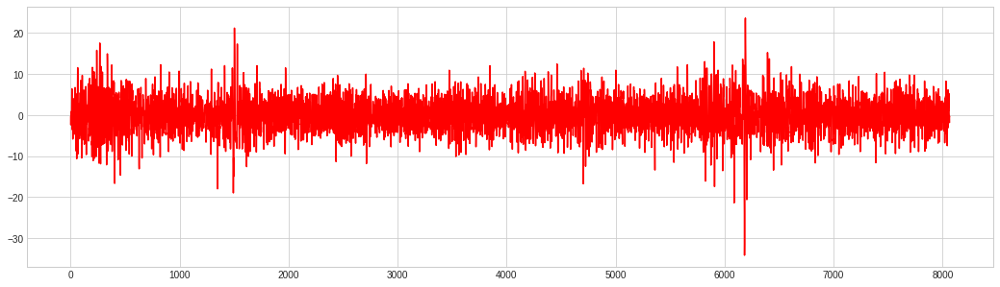

In [ ]:
# plot con matplotlib
# plt.figure(figsize=(18,5))

plt.plot(x.get("data")[10, 0, :], "r"); #plot


In [ ]:
# !pip install mne==0.21
!pip install mne
import mne

     |████████████████████████████████| 6.9 MB 4.3 MB/s 


In [ ]:
# plot con plotly
import plotly.express as px
fig = px.line(y=ch)
fig.update_layout(title=eeg_ch_names[0],
                  yaxis_title="Amplitude (mV)",
                  xaxis_title="Time (ms)")
fig.show()

In [ ]:
biosemi = mne.channels.make_standard_montage("biosemi32")
biosemi.ch_names[:39]

['Fp1',
 'AF3',
 'F7',
 'F3',
 'FC1',
 'FC5',
 'T7',
 'C3',
 'CP1',
 'CP5',
 'P7',
 'P3',
 'Pz',
 'PO3',
 'O1',
 'Oz',
 'O2',
 'PO4',
 'P4',
 'P8',
 'CP6',
 'CP2',
 'C4',
 'T8',
 'FC6',
 'FC2',
 'F4',
 'F8',
 'AF4',
 'Fp2',
 'Fz',
 'Cz']

In [ ]:
eeg_ch_names

['Fp1',
 'AF3',
 'F3',
 'F7',
 'FC5',
 'FC1',
 'C3',
 'T7',
 'CP5',
 'CP1',
 'P3',
 'P7',
 'PO3',
 'O1',
 'Oz',
 'Pz',
 'Fp2',
 'AF4',
 'Fz',
 'F4',
 'F8',
 'FC6',
 'FC2',
 'Cz',
 'C4',
 'T8',
 'CP6',
 'CP2',
 'P4',
 'P8',
 'PO4',
 'O2']

In [ ]:
# creating MNE RAW Object
# The data was downsampled to 128Hz.
# EOG artefacts were removed as in [1].
# A bandpass frequency filter from 4.0-45.0Hz was applied.
# The data was averaged to the common reference.
# The EEG channels were reordered so that they all follow the Geneva order as above.
# The data was segmented into 60 second trials and a 3 second pre-trial baseline removed.
# The trials were reordered from presentation order to video (Experiment_id) order.
sfreq = 128
ch_types = ["eeg"]*len(eeg_ch_names)
info = mne.create_info(ch_names = eeg_ch_names, ch_types=ch_types, sfreq = sfreq)
info.set_montage("biosemi32")
samples = x.get("data")[0,:len(eeg_ch_names),:]*-1e6
raw = mne.io.RawArray(samples, info)

Creating RawArray with float64 data, n_channels=32, n_times=8064
    Range : 0 ... 8063 =      0.000 ...    62.992 secs
Ready.


In [ ]:
# Duration
# samples / samples per sec
duration =  samples.shape[1] / sfreq
print(f"{duration} secs")

63.0 secs


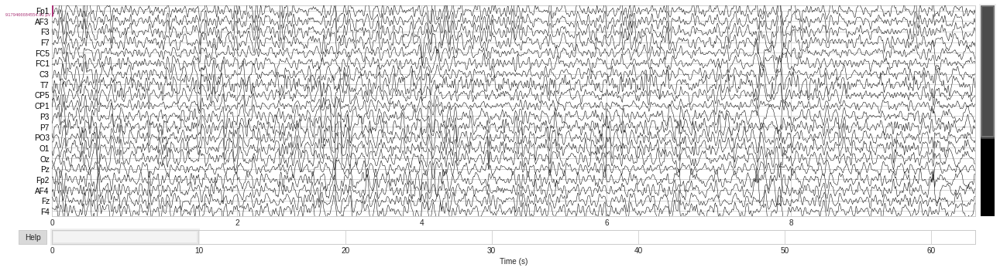

In [ ]:
raw.plot(scalings="auto");

In [ ]:
samples.shape

(32, 8064)

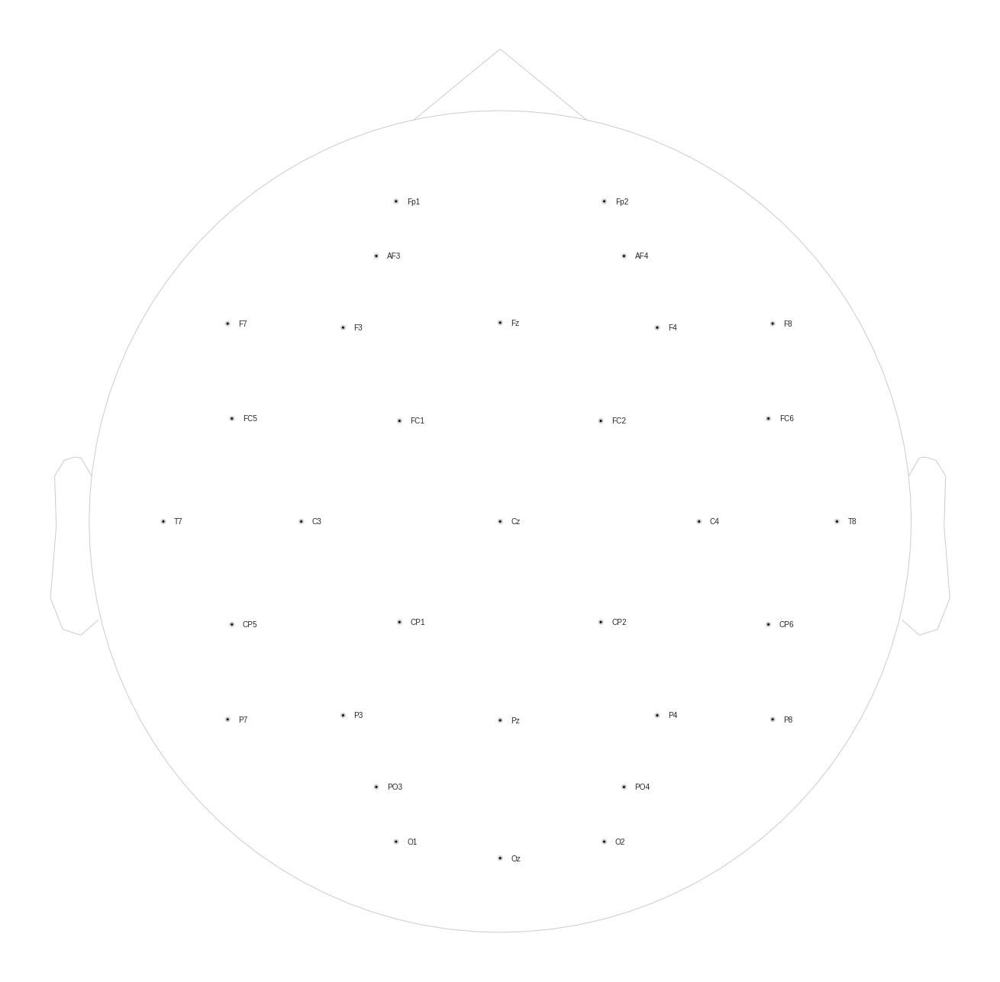

In [ ]:
raw.plot_sensors(show_names=True);

Effective window size : 16.000 (s)


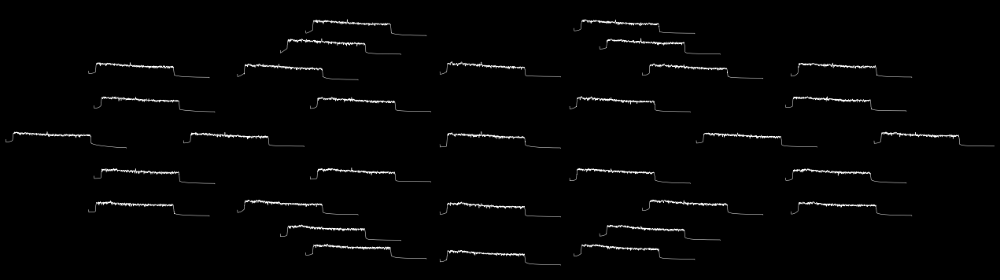

In [ ]:
# plt.figure(figsize=(.5,.5))
# plt.rcParams['figure.figsize'] = [6,5] #Fig settings
raw.plot_psd_topo();

Effective window size : 16.000 (s)


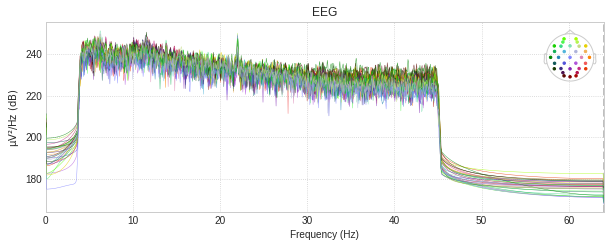

In [ ]:
raw.plot_psd();

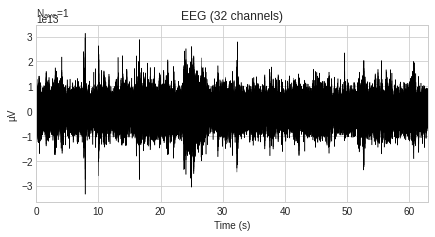

In [ ]:
evoked_array = mne.EvokedArray(samples, info)
evoked_array.plot();

Fitting ICA to data using 32 channels (please be patient, this may take a while)
Selecting by number: 16 components
 


<ipython-input-26-5e98925df909>:2: RuntimeWarning:

The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.



Fitting ICA took 1.9s.
Creating RawArray with float64 data, n_channels=16, n_times=8064
    Range : 0 ... 8063 =      0.000 ...    62.992 secs
Ready.


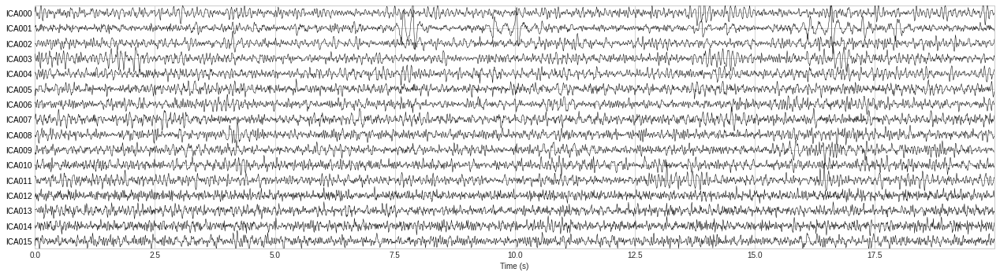

In [ ]:
ica = mne.preprocessing.ICA(n_components=16, max_iter="auto", method='infomax', random_state=420)
ica.fit(raw)
ica.plot_sources(raw, show_scrollbars=False);

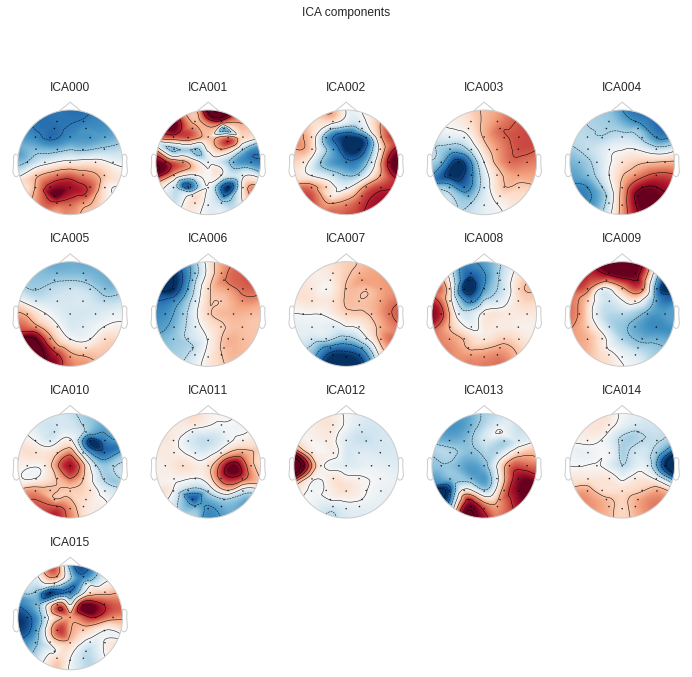

[<MNEFigure size 702x696.24 with 16 Axes>]

In [ ]:
ica.plot_components()

In [ ]:
def plot_classes(x, title):
  plt.hist(x);
  plt.title("Class");
  plt.xlabel(title)
  plt.ylabel("Frequency");

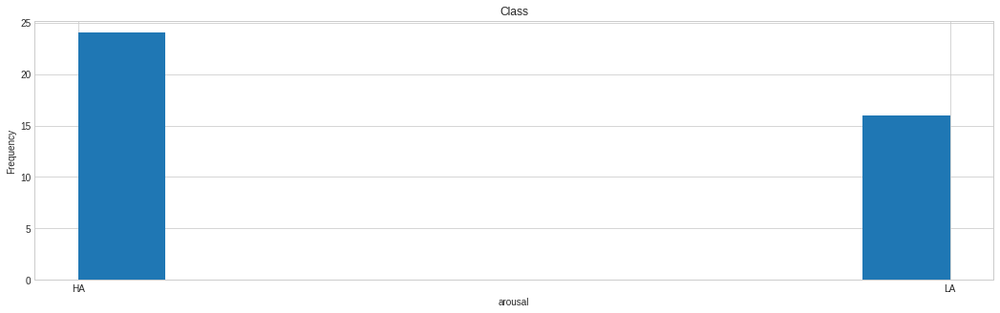

In [ ]:
def create_labels(
    data, 
    col_name
    ):
  '''
  Args:
    data (dict): the dict that contains the labels and the data of the subject
    col_name (string): the dimension to transform to label. Could be valence or arousal
  Returns:
    (list): verbal labels of the dimension
  '''
  # (valence, arousal, dominance, liking)
  lbls = data.get("labels")
  if col_name == "valence":
    num_lbls = lbls[:,0]
    labels = ["PV" if val > 5 else "NV" for val in num_lbls]
  elif col_name == "arousal":
    num_lbls = lbls[:,1]
    labels = ["HA" if val > 5 else "LA" for val in num_lbls]
  return labels

dim = ["arousal", "valence"]
arousal_array = create_labels(x, dim[0])
valence_array = create_labels(x, dim[1])
plot_classes(arousal_array, dim[0])

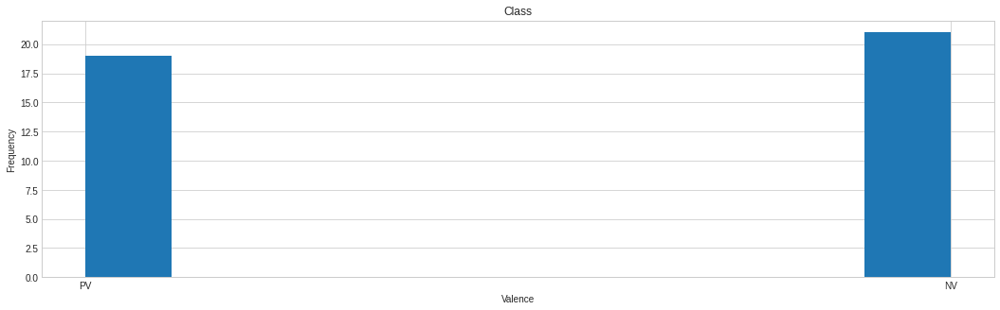

In [ ]:
plot_classes(valence_array, "Valence")

In [ ]:
def get_eeg_trial(data, trial):
  num_chs = len(eeg_ch_names)
  trial = data["data"][trial, :num_chs,:]
  return trial

first = get_eeg_trial(x, 0)
first.shape

(32, 8064)

#Standarization of EEG signals

In [ ]:
def standarize(data):
  sc = StandardScaler()
  transformed = sc.fit_transform(data)
  return transformed

[[ 0.30138776  0.38398657  0.77681029 ... -0.8866981  -1.10809871
  -0.8434212 ]
 [ 0.03963698  0.32284624  0.4730104  ... -0.93705839 -1.55621073
  -1.02632178]
 [-0.70450006  0.53232013  0.70789715 ... -0.82727773 -1.83308539
  -1.54968301]
 ...
 [-1.13062283 -0.29270558 -0.79895012 ...  2.09836256  1.71077539
   1.30037063]
 [-0.39327587 -0.21863585  0.26498683 ...  0.82824882  1.6272026
   1.65349175]
 [ 0.1183232   0.48219557  1.15094343 ...  0.70258034  0.78767398
   1.07994698]]


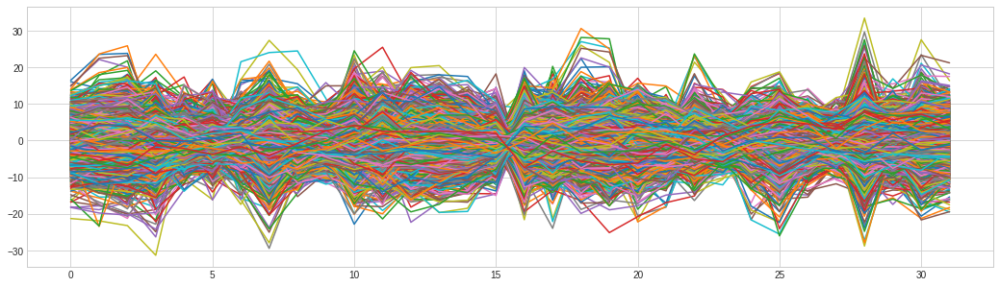

In [ ]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
transformed = sc.fit_transform(first)
print(transformed)

plt.plot(first);

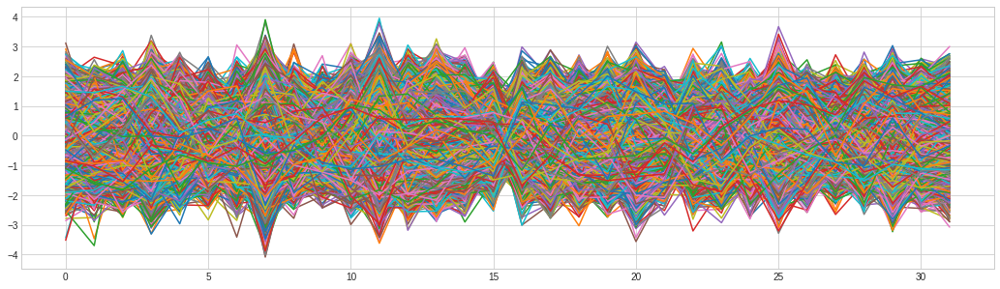

In [ ]:
first_scaled = standarize(first)
plt.plot(first_scaled);

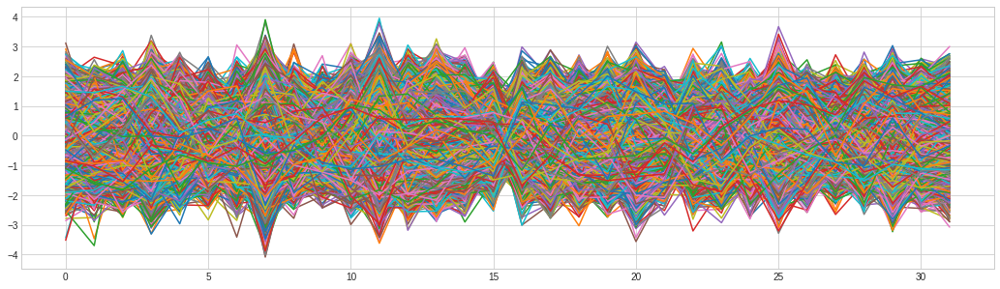

In [ ]:
plt.plot(transformed);

#Dimensionality Reduction - PCA

In [ ]:
# Principal Component Analysis
def get_pca(data):
  '''
    Args:
    data (pandas)
    Returns: 
     (numpy.array) PCA matrix
  '''
  n_components = min(data.shape)
  pca = PCA(n_components = n_components)
  pca_transformed_data = pca.fit_transform(data)
  return pca_transformed_data, pca

# pca = get_pca(transformed)

In [ ]:
def plot_pca(data):
  """
  Args:
    data (list): list with exaplained variance values
  """
  plt.figure(figsize=(18,5))
  x = range(len(data.explained_variance_))
  plt.plot(x, data.explained_variance_, "o-")
  plt.title("PCA")
  plt.xlabel("Components")
  plt.ylabel("Variance Explained")

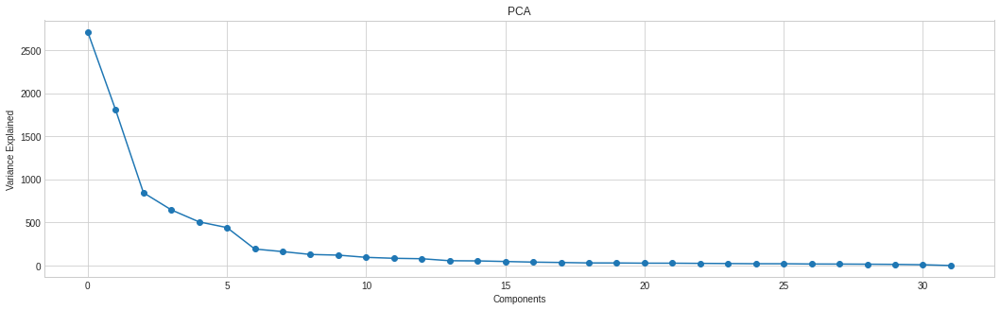

In [ ]:
z = get_eeg_trial(x, 0)
z = standarize(z)
z, pca = get_pca(z)
plot_pca(pca)

In [ ]:
def prepare_subject(data):
  """
  Args:
    data (dictionary)
  Returns:
    X (numpy.array): All subject EEG prepared
  """
  all_eeg_trials = []
  len_trials = range(len(data.get("labels")))

  for trial in len_trials:
    z = get_eeg_trial(data, trial)
    z = standarize(z)
    z, _ = get_pca(z)
    all_eeg_trials.append(z)
  X = np.concatenate(all_eeg_trials) #create numpy object of shape 
  return X

In [ ]:
def y_labels(labels_array):
  """
  Args:
    labels_array (numpy.array): Array with single labels per trial
  Returns:
    all_labels (numpy.array): array of labels for all subject
  """
  all_labels = []
  len_eeg_chs = 32
  for label in labels_array:
    a = [label]*len_eeg_chs
    all_labels.extend(a)
  return all_labels

In [ ]:
X = prepare_subject(x)
X.shape

(1280, 32)

In [ ]:
all_arousal_labels = y_labels(arousal_array)
all_valence_labels = y_labels(valence_array)

#Model Training - Logistic Regression

In [ ]:
model = LogisticRegression(random_state=240)

scores_arousal = cross_val_score(model, X, all_arousal_labels, cv=10)
scores_valence = cross_val_score(model, X, all_valence_labels, cv=10)

In [ ]:
print(f"Arousal Results : Subject 0 | Accuracy {scores_arousal.mean()} | STD {scores_arousal.std()}")
print(f"Valence Results : Subject 0 | Accuracy {scores_valence.mean()} | STD {scores_valence.std()}")

Arousal Results : Subject 0 | Accuracy 0.6 | STD 0.003125
Valence Results : Subject 0 | Accuracy 0.525 | STD 0.003125


In [ ]:
def plot_cm(y_test, y_pred):
  from sklearn.metrics import confusion_matrix
  cm = confusion_matrix(y_test, y_pred)
  labels = np.unique(y_pred).tolist()
  print(cm)
  # https://medium.com/@dtuk81/confusion-matrix-visualization-fc31e3f30fea
  import seaborn as sns
  plt.figure(figsize=(8,5))
  plt.title("Confusion Matrix")
  sns.heatmap(cm, xticklabels = labels, yticklabels = labels, annot=True, fmt="g")
  plt.xlabel("True")
  plt.ylabel("Predicted");
  plt.show();

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[[91 54]
 [84 27]]


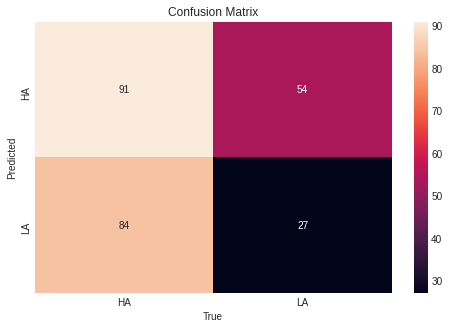

[[66 63]
 [75 52]]


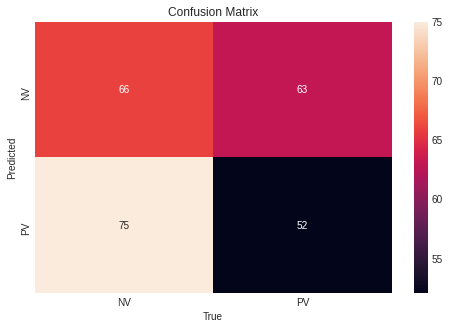

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(X, all_arousal_labels, test_size=0.20, random_state=42)
y_pred_arousal = cross_val_predict(model, x_test, y_test, cv=10)
plot_cm(y_test, y_pred_arousal)
# plot_roc_curve(x_test, y_test, y_pred_arousal)
x_train, x_test, y_train, y_test = train_test_split(X, all_valence_labels, test_size=0.20, random_state=42)
y_pred_valence = cross_val_predict(model, x_test, y_test, cv=10)
plot_cm(y_test, y_pred_valence)
# plot_roc_curve(x_test, y_test, y_pred_valence)

In [ ]:
import sys
if 'google.colab' in sys.modules:
    # Install h2o dependencies
    !pip install requests
    !pip install tabulate
    !pip install "colorama>=0.3.8"
    !pip install future
    # Install h2o
    try:
        import h2o
    except:
        !pip install -f http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html h2o

Looking in links: http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html
     |████████████████████████████████| 170.0 MB 24 kB/s 
  Created wheel for h2o: filename=h2o-3.32.1.7-py2.py3-none-any.whl size=170040343 sha256=41020e525068b2415ddea018b30acde8bb8a07c954171e3821ef0c8e09885682
  Stored in directory: /root/.cache/pip/wheels/6e/60/8f/172971bebc94f839b69460f46c9a5fc9e7e88457453bb149d7
Successfully built h2o


In [ ]:
import h2o
from h2o.automl import H2OAutoML
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 ..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.11" 2021-04-20; OpenJDK Runtime Environment (build 11.0.11+9-Ubuntu-0ubuntu2.18.04); OpenJDK 64-Bit Server VM (build 11.0.11+9-Ubuntu-0ubuntu2.18.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.7/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpw7ghnwx_
  JVM stdout: /tmp/tmpw7ghnwx_/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpw7ghnwx_/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,02 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.32.1.7
H2O_cluster_version_age:,8 days
H2O_cluster_name:,H2O_from_python_unknownUser_4u1pxr
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.172 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"accepting new members, healthy"


In [ ]:
prefix = "PC_"
cols = [str(a+1) for a in range(X.shape[1])]
# cols = f"{range(X.shape[1])}"
x_df = pd.DataFrame(X, columns= cols).add_prefix(prefix)
# print(cols)
x_df.head()

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,PC_27,PC_28,PC_29,PC_30,PC_31,PC_32
0,-60.158586,15.530597,-33.246506,8.042089,-15.641912,-30.641444,-14.395774,-2.360160,8.555465,18.664690,-2.214602,-4.491030,7.246076,-14.957543,1.815427,-3.731100,-7.437310,4.055727,-3.484536,1.901865,-3.408795,-0.244639,-0.225221,0.419732,-6.271429,-13.881489,-1.802833,1.364543,1.828746,1.102924,-0.238358,2.592855e-14
1,-69.800341,28.028995,-9.613087,-3.583581,-21.484069,-26.815572,-8.213101,-12.467261,6.634796,8.430131,-10.698073,0.485774,6.466944,-3.721929,-0.330721,1.266204,-5.279670,3.387804,-9.139863,2.179104,-5.223466,3.351777,-1.689220,3.157887,9.176897,14.503583,1.484797,-1.585177,-2.431131,-0.605888,0.520349,2.592855e-14
2,-67.801610,39.683984,5.090301,-3.559391,-28.411306,-19.957138,-0.477959,-18.828078,0.959588,-9.595379,-13.125355,5.528994,4.712058,17.904990,-7.118950,5.031865,1.831424,7.552337,16.150814,-4.045331,-1.382453,0.203553,-1.961578,-0.652715,-2.126739,-2.724094,-1.336426,-1.969399,1.445820,0.884814,-0.174356,2.592855e-14
3,-44.038024,48.780275,-48.040599,5.410090,-33.368687,-1.541838,-10.631555,9.612985,18.990602,-3.496295,24.920585,-5.917749,-13.266065,6.133955,8.988822,3.882018,3.754162,-3.900475,0.157262,2.515406,8.184644,-4.552091,-2.212409,-3.245580,1.581444,1.399080,-2.094719,-5.643393,-0.677215,0.598360,-0.031493,2.592855e-14
4,-11.737326,23.929163,-28.860048,57.469731,-12.408501,-10.374568,3.828666,11.592707,-1.131784,-11.659140,7.401719,-1.794501,-10.651558,4.975508,-1.403189,-4.001603,3.676674,-1.347109,0.061143,-2.905028,-8.429988,5.302776,3.110398,4.846112,-1.115360,1.029544,5.919814,12.828533,1.322198,-2.443996,-0.448640,2.592855e-14


In [ ]:
X

array([[-6.01585864e+01,  1.55305975e+01, -3.32465062e+01, ...,
         1.10292366e+00, -2.38357628e-01,  2.59285452e-14],
       [-6.98003410e+01,  2.80289948e+01, -9.61308726e+00, ...,
        -6.05888251e-01,  5.20348905e-01,  2.59285452e-14],
       [-6.78016103e+01,  3.96839840e+01,  5.09030125e+00, ...,
         8.84814137e-01, -1.74356153e-01,  2.59285452e-14],
       ...,
       [ 4.01732558e+01, -3.07047165e+01, -3.66290093e+01, ...,
         1.76455821e-01,  3.77558739e-01,  2.22084223e-14],
       [ 8.40531160e+01, -3.57567269e+01, -7.97217111e+00, ...,
        -1.45917291e+00, -1.04687242e+01,  2.22084223e-14],
       [ 7.91336755e+01, -9.79060854e+00, -2.11717595e+01, ...,
         9.67547984e-01,  3.62057518e+00,  2.22084223e-14]])

In [ ]:
df_arousal = x_df.copy()
df_arousal["arousal"] = all_arousal_labels
df_valence = x_df.copy()
df_valence["valence"] = all_valence_labels

In [ ]:
def prepare_sub_data(data, arousal_labels_array, valence_labels_array):
  """
  Args:
    data ()
    arousal_labels_array
    valence_labels_array
  Returns:
    df_final (pandas.DataFrame)
  """
  prefix = "PC_"
  cols = [str(a+1) for a in range(data.shape[1])]
  # cols = f"{range(X.shape[1])}"
  x_df = pd.DataFrame(data, columns= cols).add_prefix(prefix)
  # print(cols)
  # x_df.head()
  df_final_arousal = x_df.copy()
  df_final_arousal["arousal"] = arousal_labels_array
  df_final_valence = x_df.copy()
  df_final_valence["valence"] = valence_labels_array
  return df_final_arousal, df_final_valence

df_final_arousal, df_final_valence = prepare_sub_data(X, all_arousal_labels, all_valence_labels)

Entrenando sujetos con clases imbalanceadas. Se redujo el numero de casos de la clase con mayoría.

In [ ]:
def train_subject(data_df, label, max_models, exclude=None):
  """
  Args:
    data_df (pandas.DataFrame): the prepared data in pandas df. Last column should be labels.
  Return:
   (class 'h2o.automl.autoh2o.H2OAutoML') = h2o AutoML model
  """ 
  h2o_session_data = h2o.H2OFrame(python_obj=data_df)
  train, test = h2o_session_data.split_frame(ratios=[0.8], seed=420)
  if label == "arousal":
    y = "arousal"
  else:
    y = "valence"
  train[y] = train[y].asfactor()
  test[y] = test[y].asfactor()

  max_models=max_models
  x = train.columns[:-1] #only names of columns
  if exclude != None:
    aml = H2OAutoML(max_models=max_models, seed=420, balance_classes=True, exclude_algos = exclude, verbosity="info")
    print("==Excluded Models:", exclude)
  else:
    aml = H2OAutoML(max_models=max_models, seed=420, balance_classes=True, verbosity="info")
  aml.train(x=x, y=y, training_frame=train)
  # print("==",type(aml)) #class 'h2o.automl.autoh2o.H2OAutoML'
  return aml, train, test

# max_models = 10
# aml_arousal, train_arousal, test_arousal = train_subject(df_final_arousal, max_models)
# aml_valence ,train_valence, test_valence = train_subject(df_final_valence, max_models)
# aml_arousal.explain(test_arousal)
# aml_valence.explain(test_valence)

In [ ]:
h2o_session_data = h2o.H2OFrame(python_obj=df_arousal)
train, test = h2o_session_data.split_frame(ratios=[0.8], seed=420)
y = "arousal"
train[y] = train[y].asfactor()
test[y] = test[y].asfactor()

max_models=10
x = train.columns[:-1] #only names of columns
aml = H2OAutoML(max_models=max_models, seed=420)
aml.train(x=x, y=y, training_frame=train)

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |████████████████████████████████████████████████████████| 100%


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_BestOfFamily_AutoML_20210910_051607,1,0.0104637,1,0,0.0452337,0.00204609,1343,0.126192,StackedEnsemble
StackedEnsemble_AllModels_AutoML_20210910_051607,1,0.00784393,1,0,0.0390617,0.00152582,1155,0.253878,StackedEnsemble
GBM_4_AutoML_20210910_051607,1,0.0170289,1,0,0.0549904,0.00302394,2829,0.106919,GBM
GBM_1_AutoML_20210910_051607,0.999965,0.0414119,0.999949,0.00243902,0.0825997,0.00682272,2847,0.056919,GBM
GBM_3_AutoML_20210910_051607,0.99993,0.0190961,0.999898,0.00483137,0.0651395,0.00424315,3362,0.072886,GBM
GBM_2_AutoML_20210910_051607,0.999782,0.0383259,0.999675,0.00483137,0.0878985,0.00772615,2756,0.084338,GBM
XGBoost_3_AutoML_20210910_051607,0.932824,0.337933,0.897496,0.142006,0.326401,0.106538,639,0.010946,XGBoost
XGBoost_1_AutoML_20210910_051607,0.810252,0.518105,0.744632,0.268098,0.417502,0.174308,397,0.008777,XGBoost
GBM_5_AutoML_20210910_051607,0.73806,0.589841,0.589055,0.280517,0.449551,0.202096,256,0.013665,GBM
XGBoost_2_AutoML_20210910_051607,0.736539,0.59334,0.639798,0.312683,0.450382,0.202844,318,0.008279,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_BestOfFamily_AutoML_20210910_051607


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9999996421025376: 


,,HA,LA,Error,Rate
0,HA,615.0,0.0,0.0,(0.0/615.0)
1,LA,0.0,418.0,0.0,(0.0/418.0)
2,Total,615.0,418.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

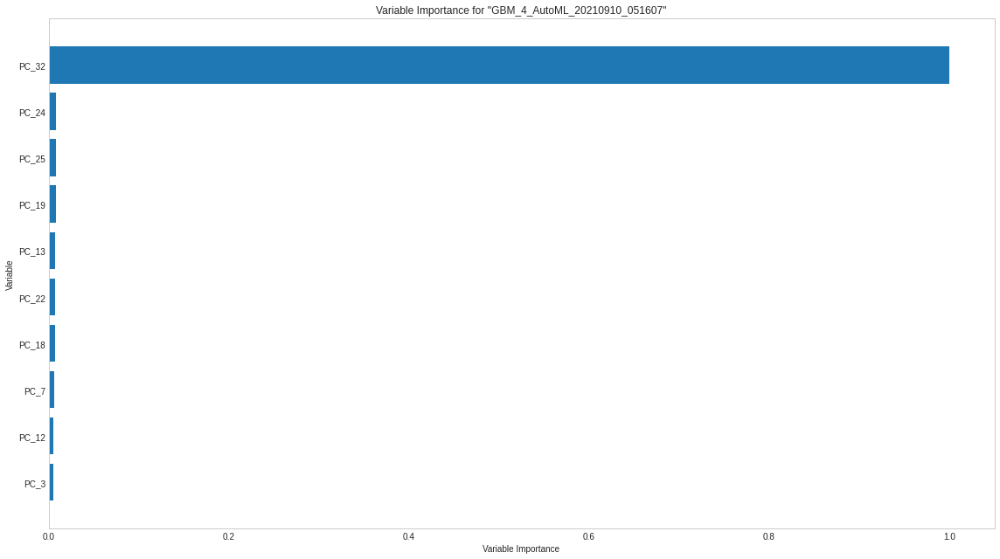

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

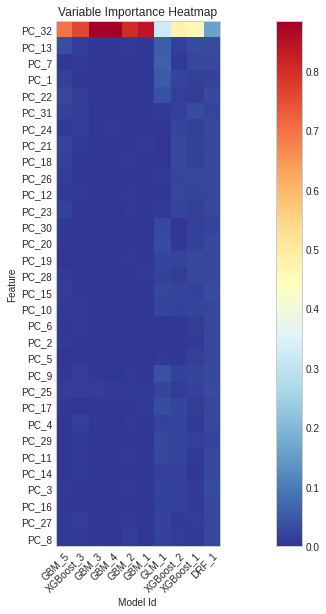

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

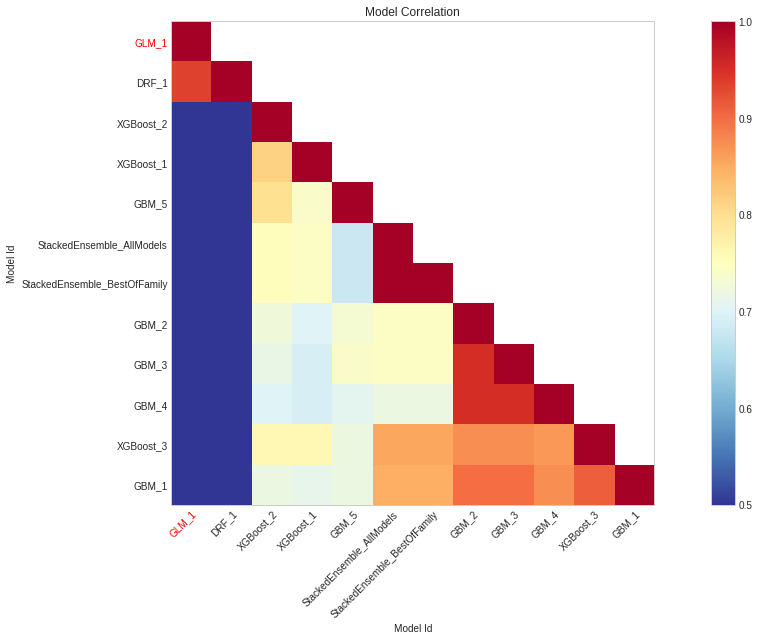

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

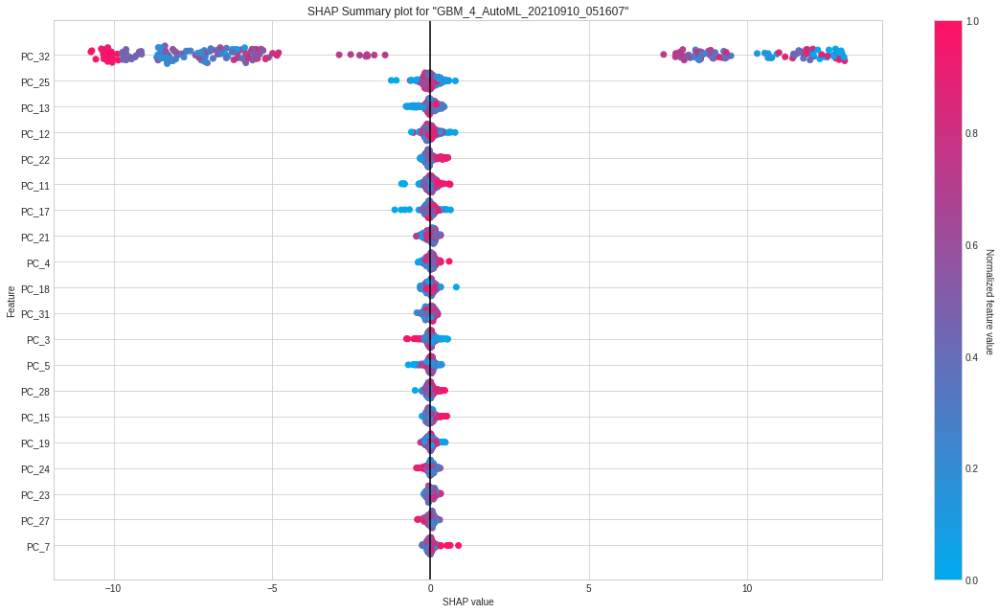

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

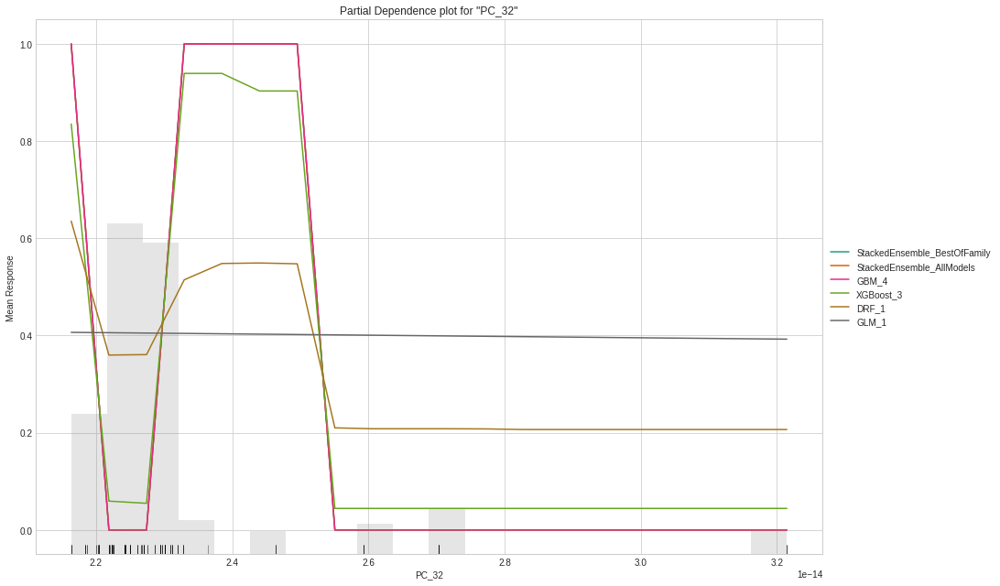

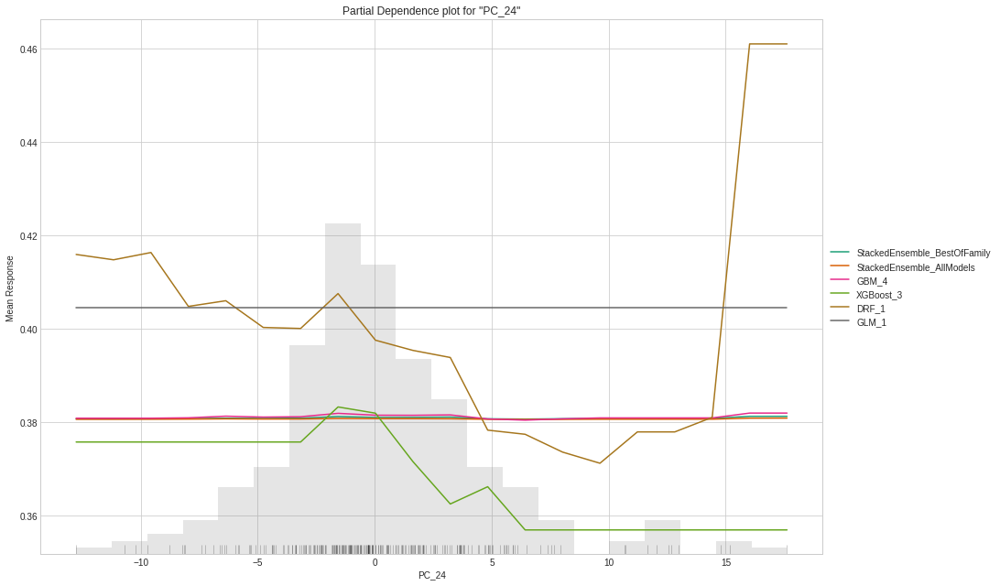

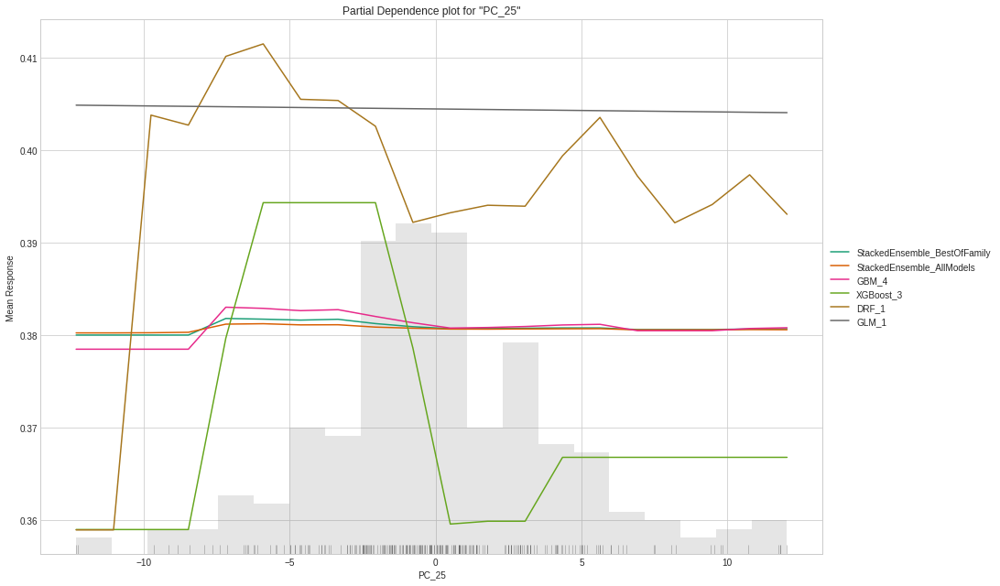

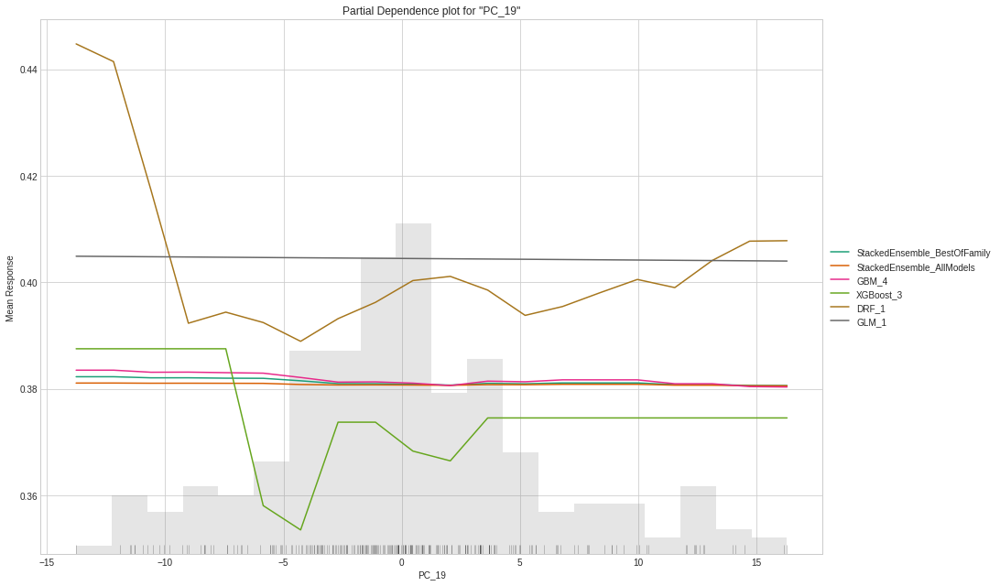

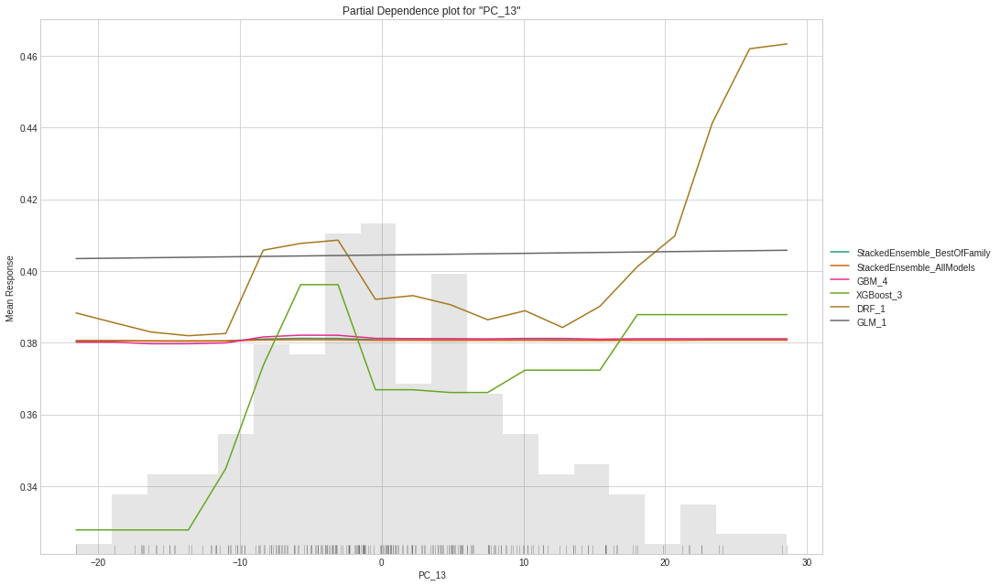

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_BestOfFamily_AutoML_20210910_051607,1,0.0104637,1,0,0.0452337,0.00204609,1343,0.126192,StackedEnsemble
StackedEnsemble_AllModels_AutoML_20210910_051607,1,0.00784393,1,0,0.0390617,0.00152582,1155,0.253878,StackedEnsemble
GBM_4_AutoML_20210910_051607,1,0.0170289,1,0,0.0549904,0.00302394,2829,0.106919,GBM
GBM_1_AutoML_20210910_051607,0.999965,0.0414119,0.999949,0.00243902,0.0825997,0.00682272,2847,0.056919,GBM
GBM_3_AutoML_20210910_051607,0.99993,0.0190961,0.999898,0.00483137,0.0651395,0.00424315,3362,0.072886,GBM
GBM_2_AutoML_20210910_051607,0.999782,0.0383259,0.999675,0.00483137,0.0878985,0.00772615,2756,0.084338,GBM
XGBoost_3_AutoML_20210910_051607,0.932824,0.337933,0.897496,0.142006,0.326401,0.106538,639,0.010946,XGBoost
XGBoost_1_AutoML_20210910_051607,0.810252,0.518105,0.744632,0.268098,0.417502,0.174308,397,0.008777,XGBoost
GBM_5_AutoML_20210910_051607,0.73806,0.589841,0.589055,0.280517,0.449551,0.202096,256,0.013665,GBM
XGBoost_2_AutoML_20210910_051607,0.736539,0.59334,0.639798,0.312683,0.450382,0.202844,318,0.008279,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_BestOfFamily_AutoML_20210910_051607


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9999996421025376: 


,,HA,LA,Error,Rate
0,HA,615.0,0.0,0.0,(0.0/615.0)
1,LA,0.0,418.0,0.0,(0.0/418.0)
2,Total,615.0,418.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

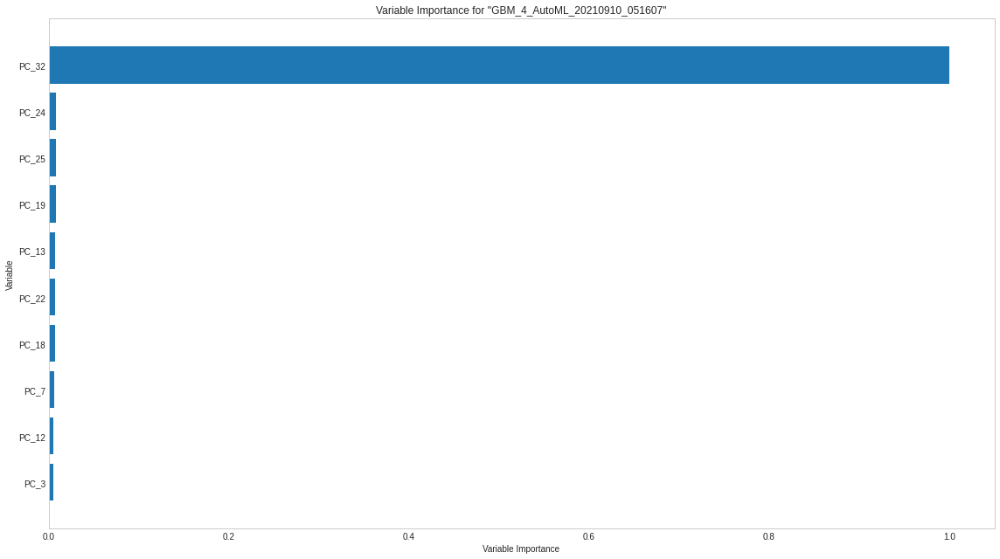

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

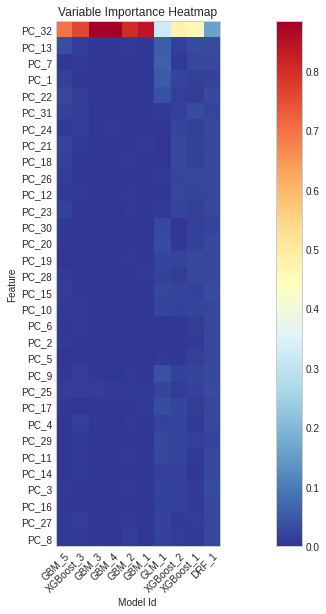

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

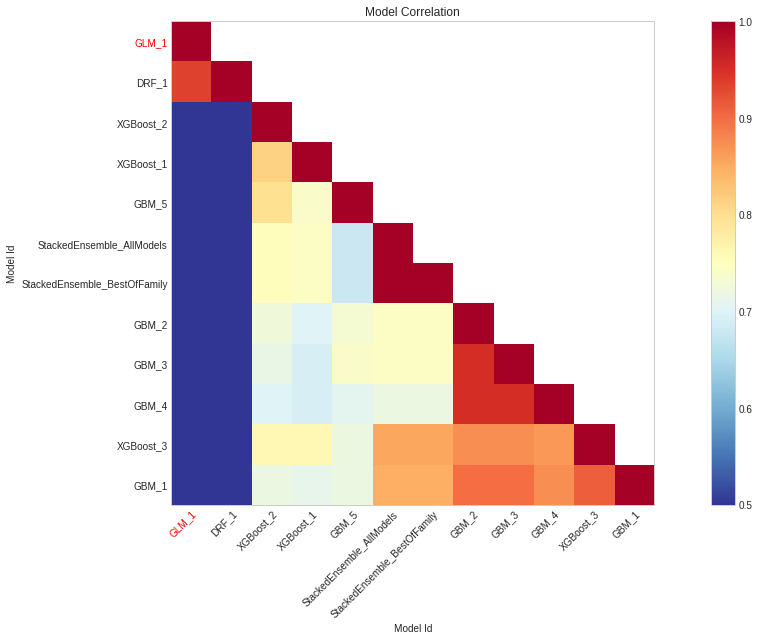

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

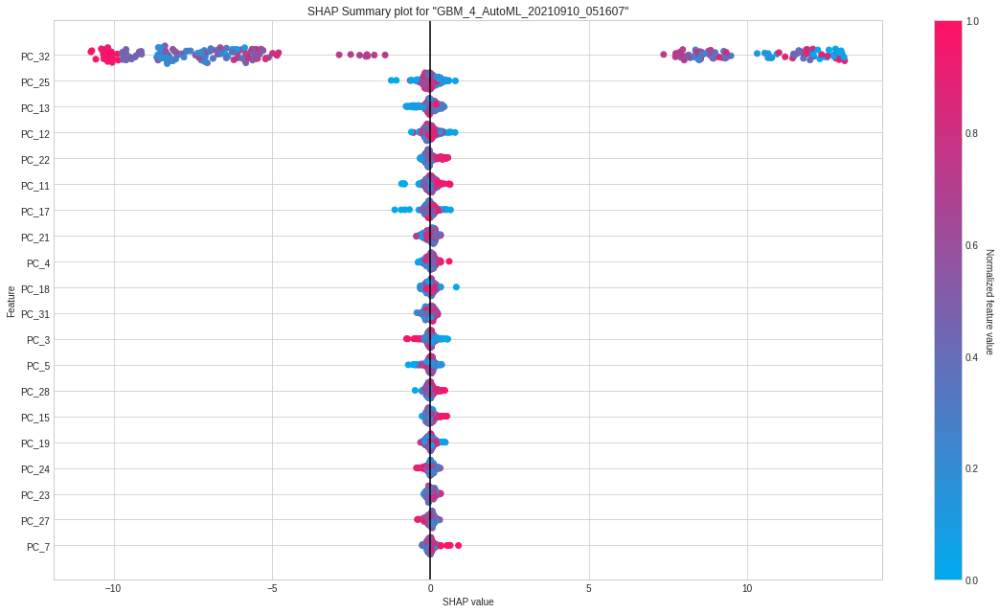

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

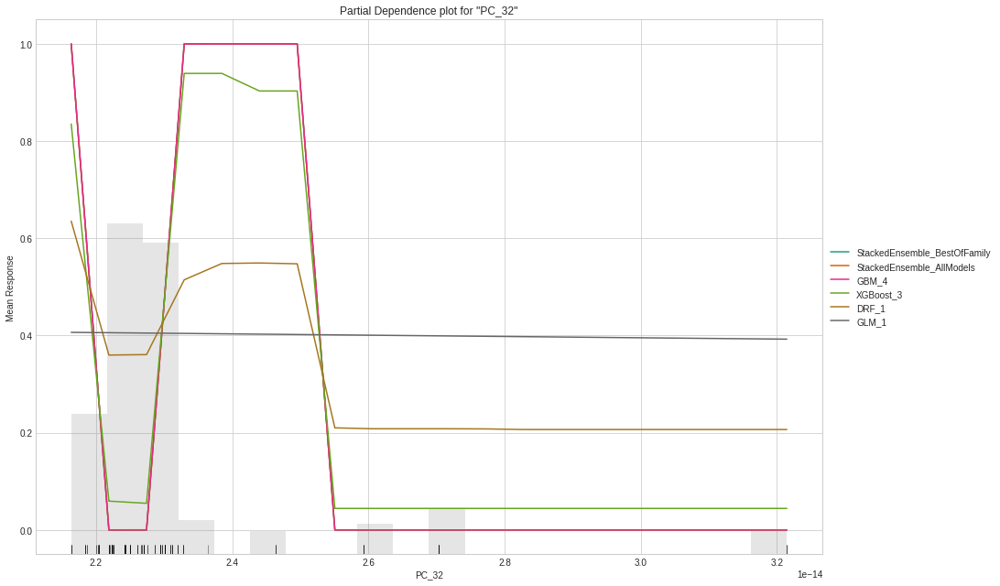

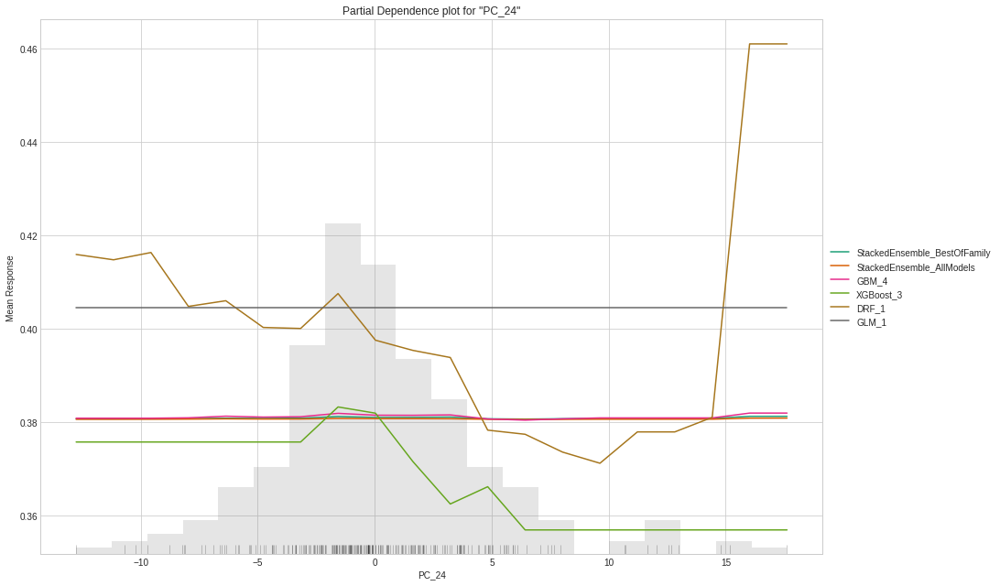

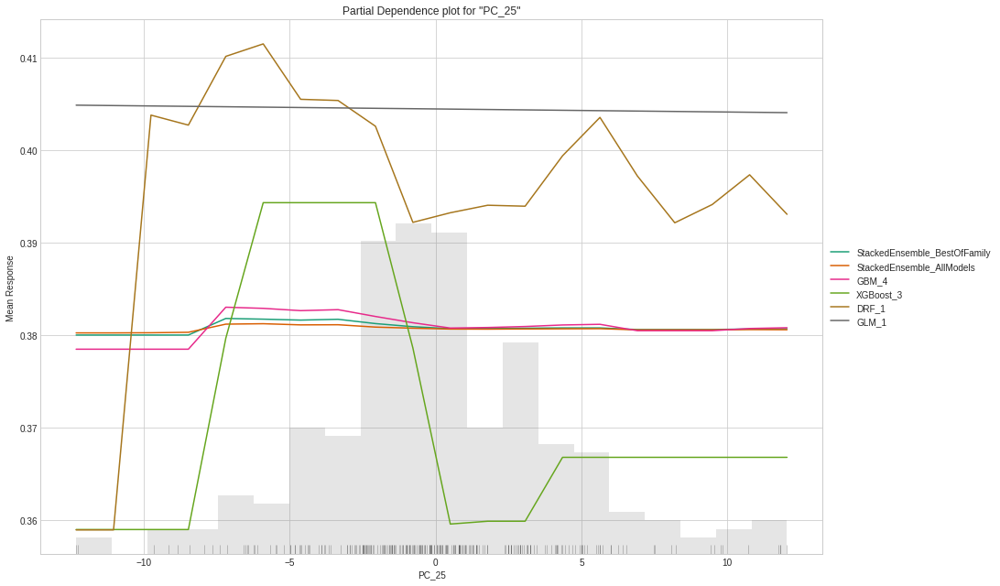

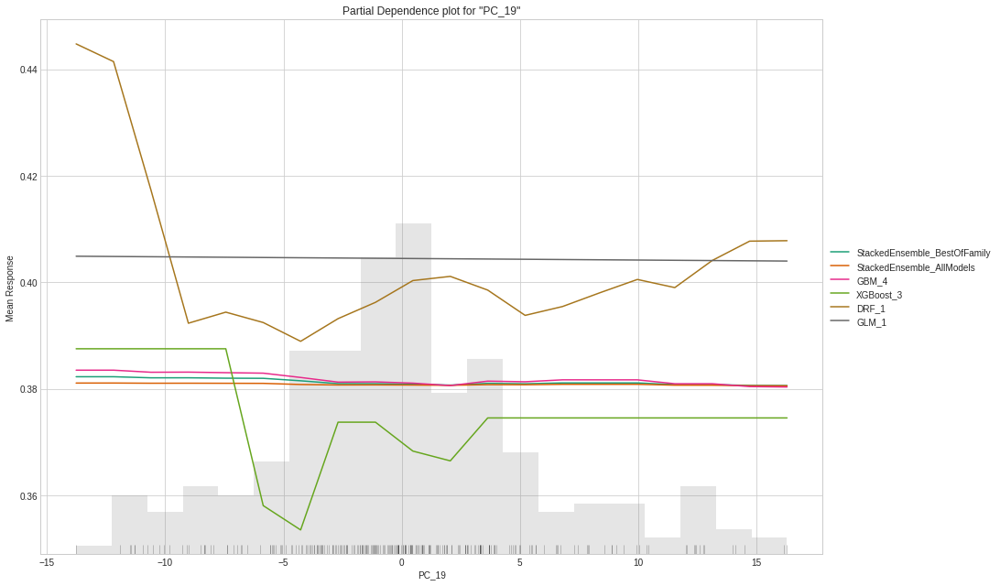

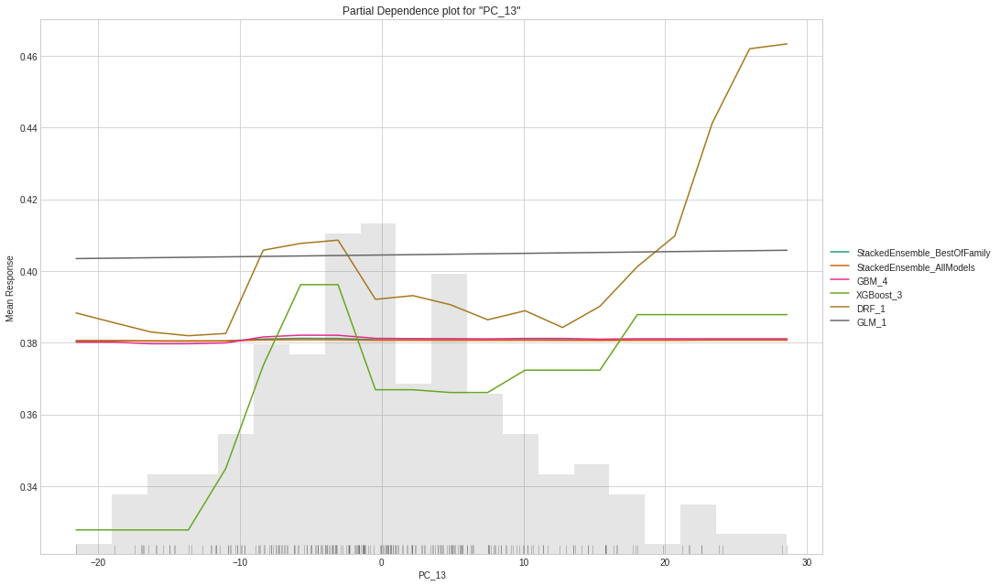

In [ ]:
aml.explain(test)

In [ ]:
h2o_session_data = h2o.H2OFrame(python_obj=df_valence)
train, test = h2o_session_data.split_frame(ratios=[0.8], seed=420)
y = "valence"
train[y] = train[y].asfactor()
test[y] = test[y].asfactor()

max_models=10
x = train.columns[:-1] #only names of columns
aml = H2OAutoML(max_models=max_models, seed=420)
aml.train(x=x, y=y, training_frame=train)

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |████████████████████████████████████████████████████████| 100%


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_3_AutoML_20210910_051819,0.998177,0.066274,0.997999,0.0255511,0.135177,0.0182729,1087,0.02619,GBM
StackedEnsemble_BestOfFamily_AutoML_20210910_051819,0.998066,0.0562854,0.997872,0.025241,0.133423,0.0178016,482,0.030872,StackedEnsemble
StackedEnsemble_AllModels_AutoML_20210910_051819,0.997863,0.0593395,0.997647,0.0264589,0.138523,0.0191887,583,0.070501,StackedEnsemble
GBM_4_AutoML_20210910_051819,0.997301,0.0729518,0.996972,0.0244252,0.147406,0.0217287,1269,0.02959,GBM
GBM_1_AutoML_20210910_051819,0.996919,0.0917394,0.996564,0.029423,0.156068,0.0243572,1077,0.048012,GBM
GBM_2_AutoML_20210910_051819,0.995322,0.0949962,0.994769,0.0374883,0.170911,0.0292106,1362,0.034566,GBM
XGBoost_3_AutoML_20210910_051819,0.979565,0.218357,0.977966,0.0798016,0.249002,0.0620018,492,0.008481,XGBoost
XGBoost_1_AutoML_20210910_051819,0.907077,0.392348,0.896087,0.169024,0.353406,0.124896,555,0.007376,XGBoost
XGBoost_2_AutoML_20210910_051819,0.840511,0.493603,0.825101,0.247126,0.403833,0.163081,217,0.007204,XGBoost
DRF_1_AutoML_20210910_051819,0.80236,0.535229,0.839627,0.23298,0.421232,0.177437,547,0.018026,DRF


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_3_AutoML_20210910_051819


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9503816973369323: 


,,NV,PV,Error,Rate
0,NV,544.0,0.0,0.0,(0.0/544.0)
1,PV,0.0,489.0,0.0,(0.0/489.0)
2,Total,544.0,489.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

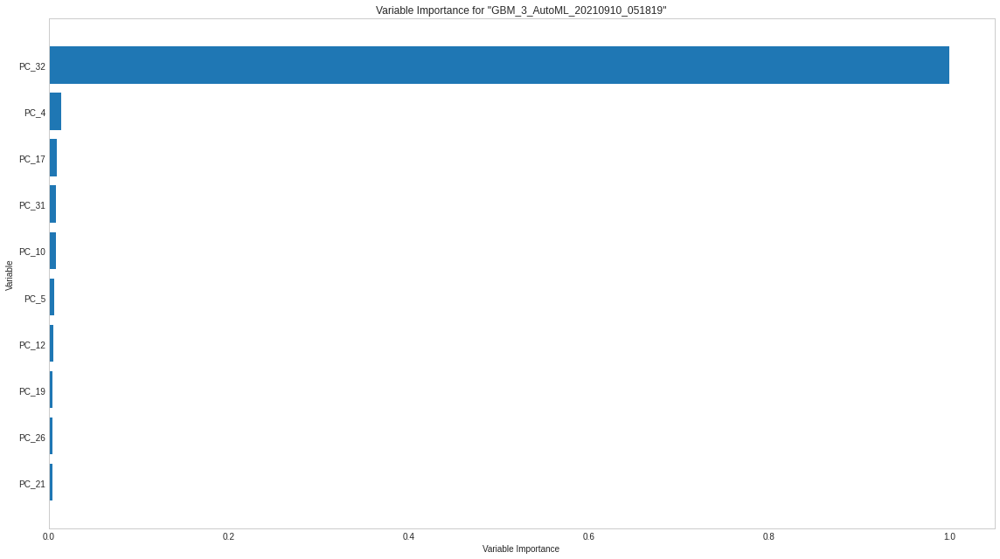

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

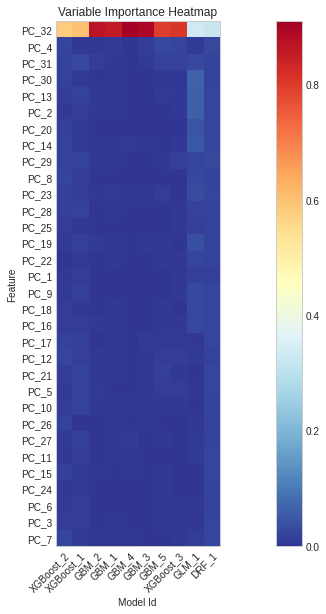

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

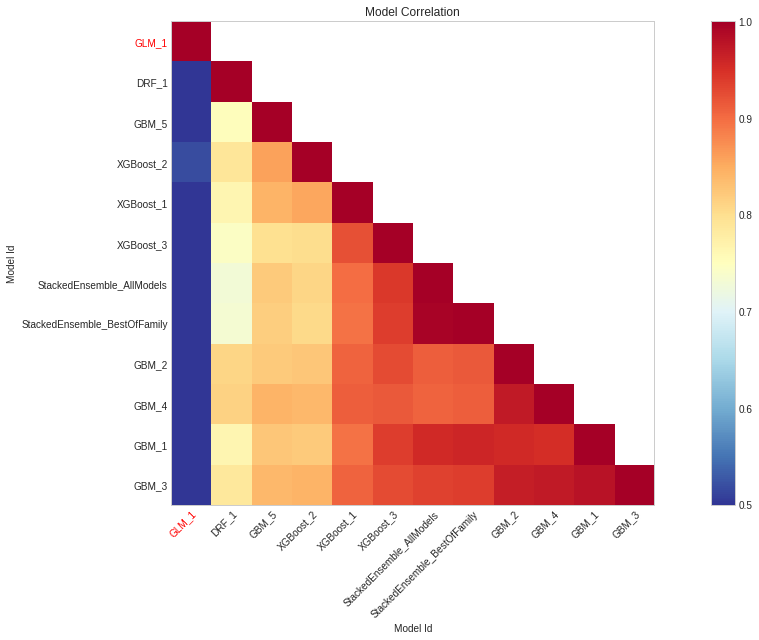

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

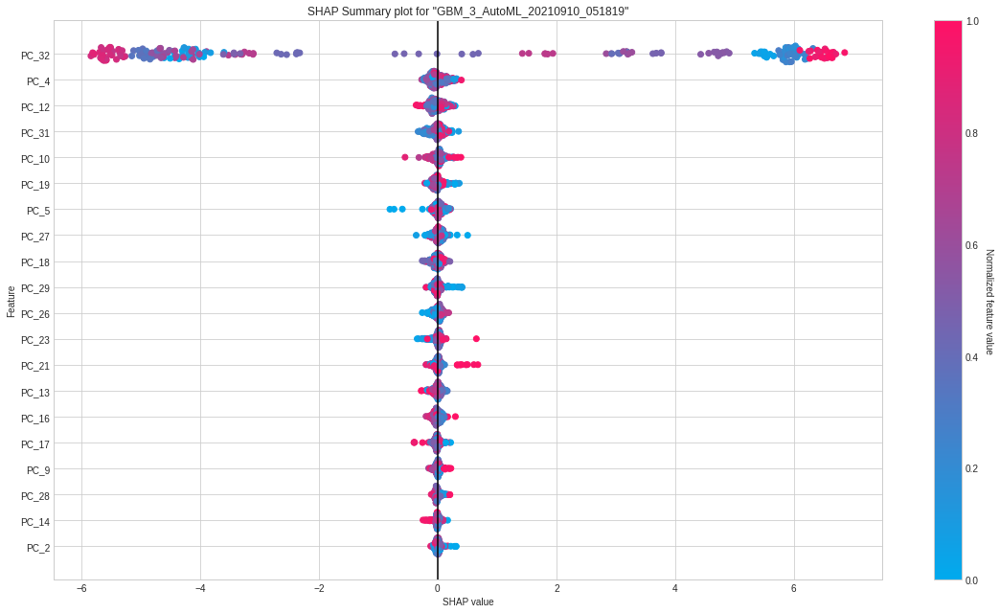

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

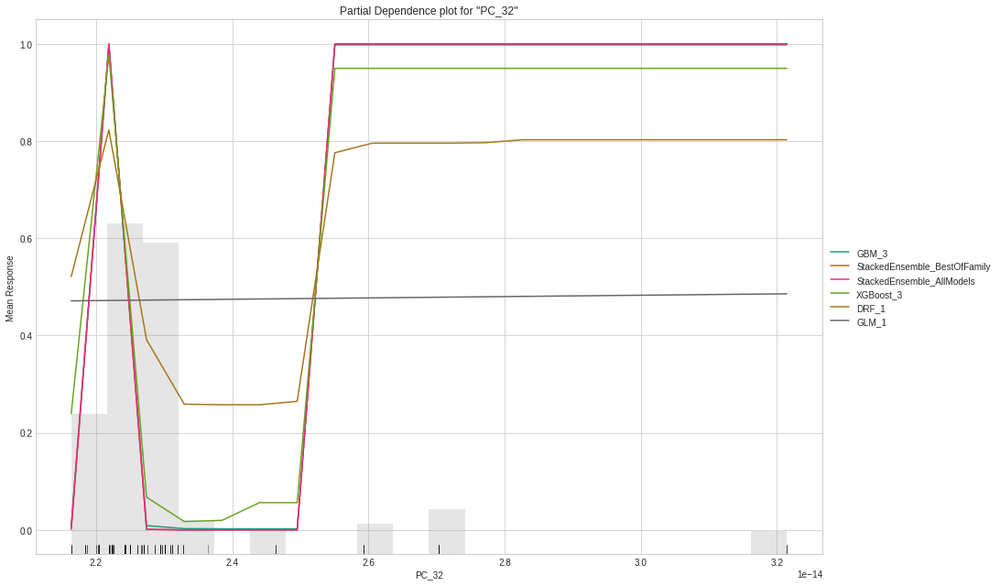

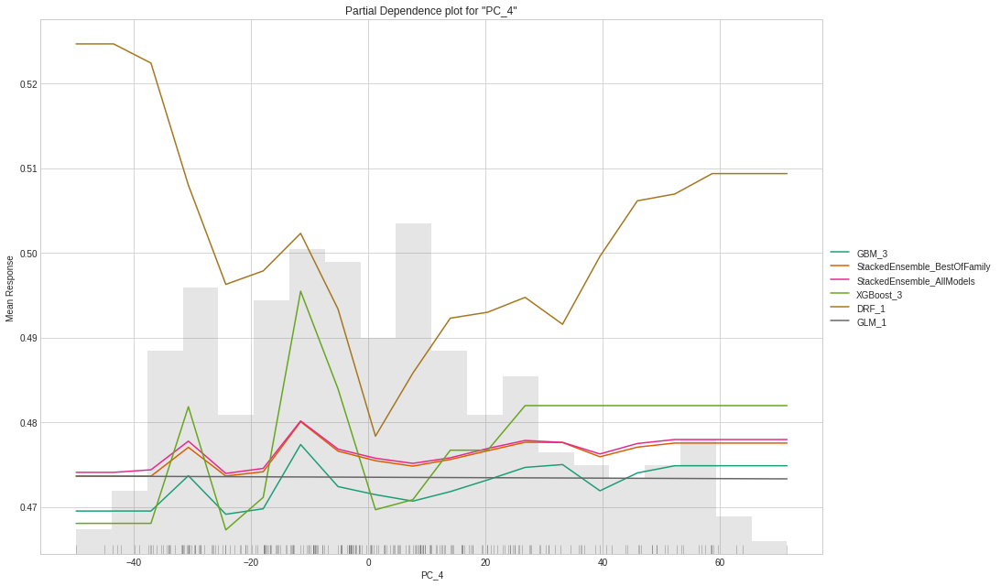

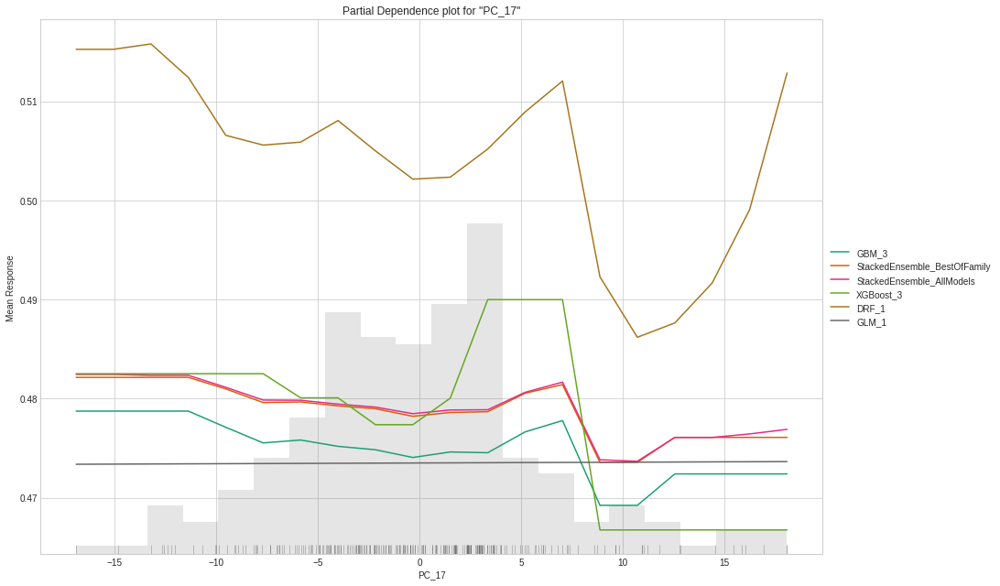

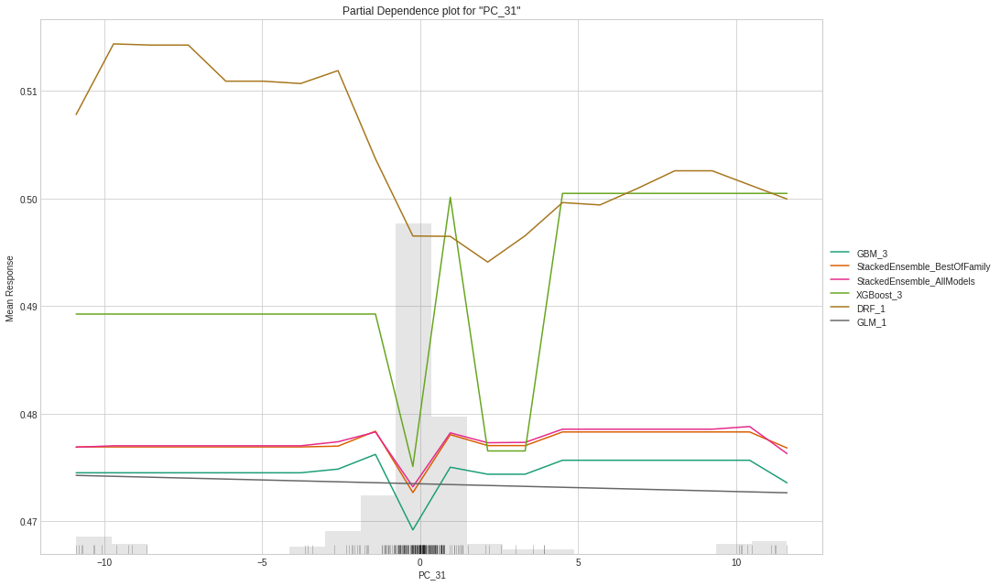

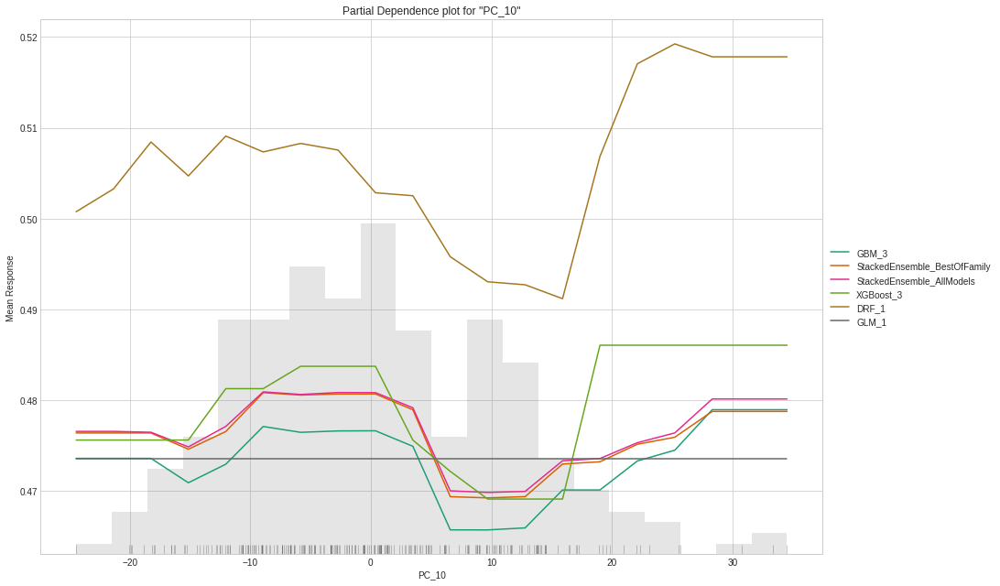

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_3_AutoML_20210910_051819,0.998177,0.066274,0.997999,0.0255511,0.135177,0.0182729,1087,0.02619,GBM
StackedEnsemble_BestOfFamily_AutoML_20210910_051819,0.998066,0.0562854,0.997872,0.025241,0.133423,0.0178016,482,0.030872,StackedEnsemble
StackedEnsemble_AllModels_AutoML_20210910_051819,0.997863,0.0593395,0.997647,0.0264589,0.138523,0.0191887,583,0.070501,StackedEnsemble
GBM_4_AutoML_20210910_051819,0.997301,0.0729518,0.996972,0.0244252,0.147406,0.0217287,1269,0.02959,GBM
GBM_1_AutoML_20210910_051819,0.996919,0.0917394,0.996564,0.029423,0.156068,0.0243572,1077,0.048012,GBM
GBM_2_AutoML_20210910_051819,0.995322,0.0949962,0.994769,0.0374883,0.170911,0.0292106,1362,0.034566,GBM
XGBoost_3_AutoML_20210910_051819,0.979565,0.218357,0.977966,0.0798016,0.249002,0.0620018,492,0.008481,XGBoost
XGBoost_1_AutoML_20210910_051819,0.907077,0.392348,0.896087,0.169024,0.353406,0.124896,555,0.007376,XGBoost
XGBoost_2_AutoML_20210910_051819,0.840511,0.493603,0.825101,0.247126,0.403833,0.163081,217,0.007204,XGBoost
DRF_1_AutoML_20210910_051819,0.80236,0.535229,0.839627,0.23298,0.421232,0.177437,547,0.018026,DRF


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_3_AutoML_20210910_051819


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9503816973369323: 


,,NV,PV,Error,Rate
0,NV,544.0,0.0,0.0,(0.0/544.0)
1,PV,0.0,489.0,0.0,(0.0/489.0)
2,Total,544.0,489.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

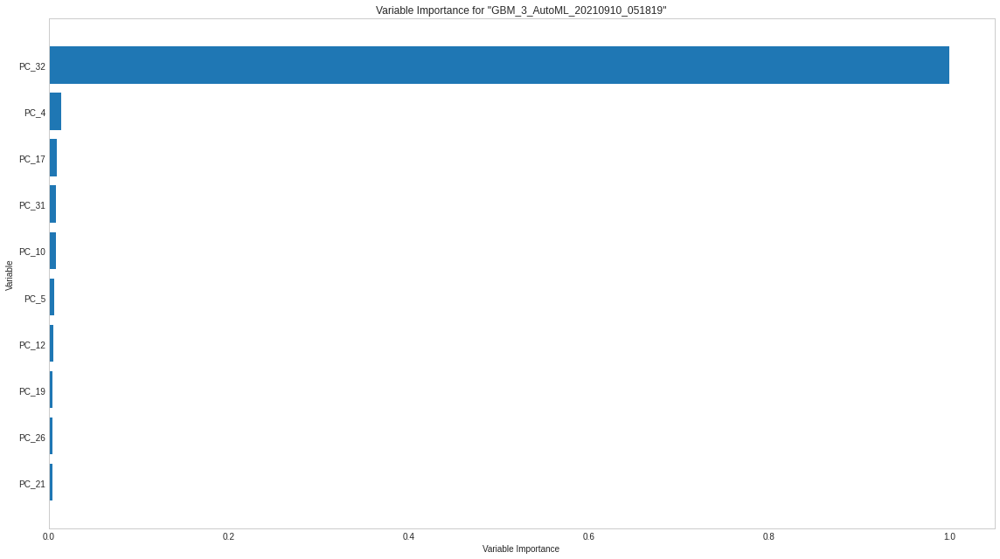

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

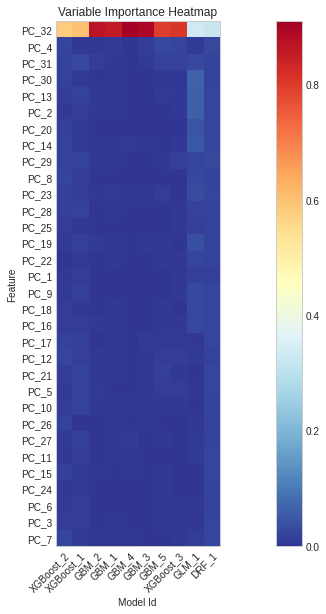

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

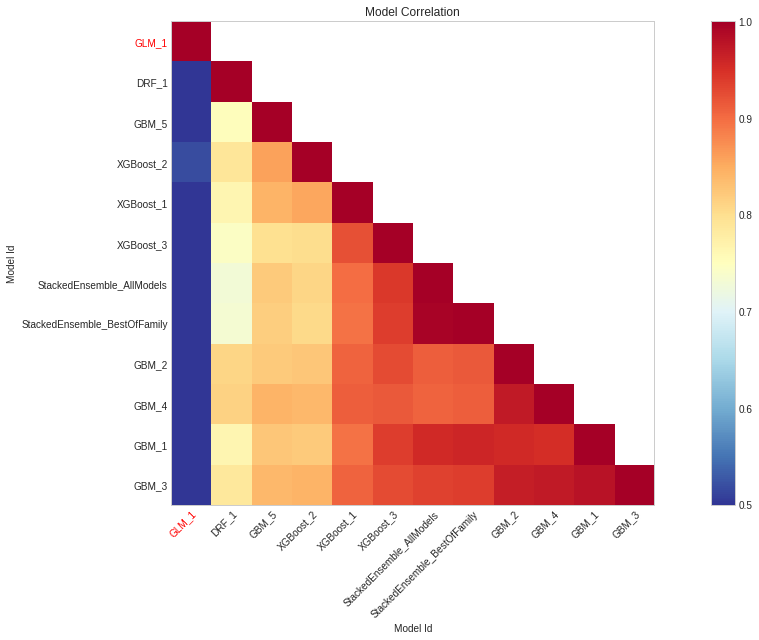

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

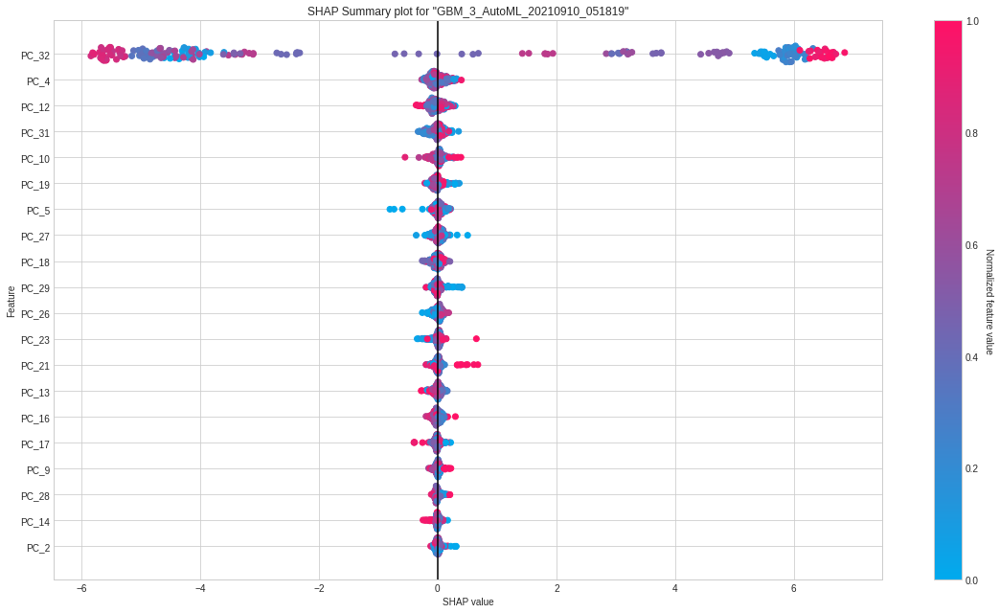

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

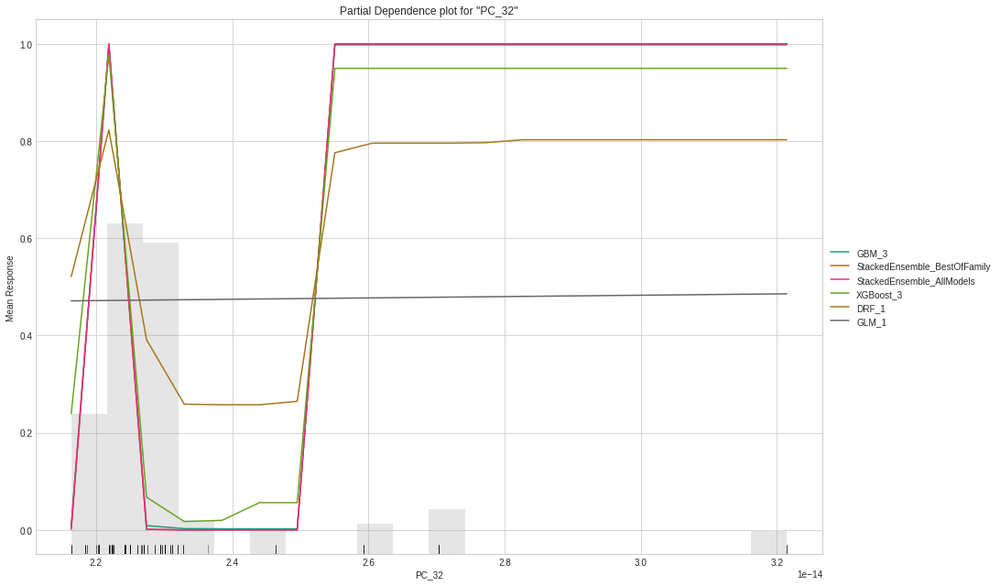

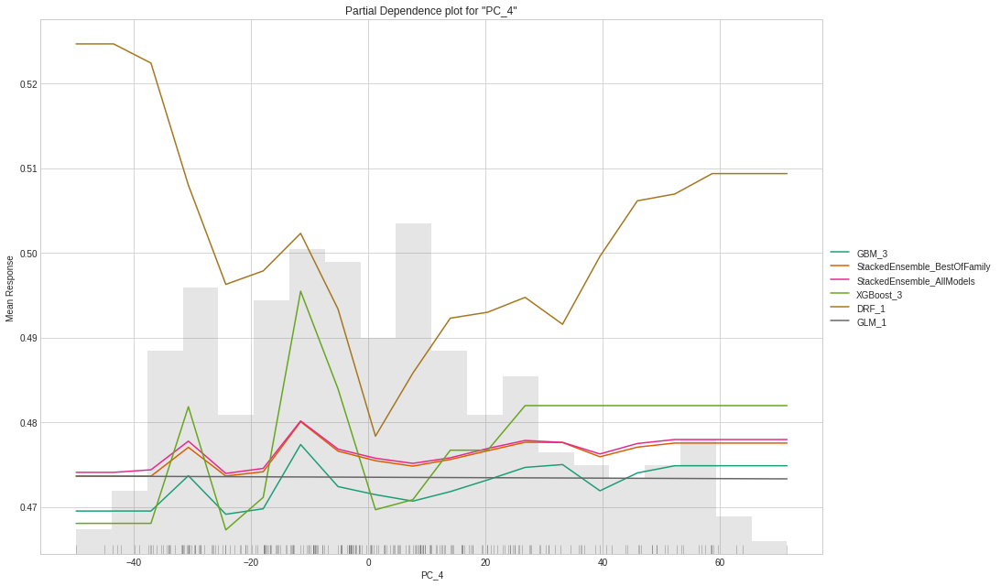

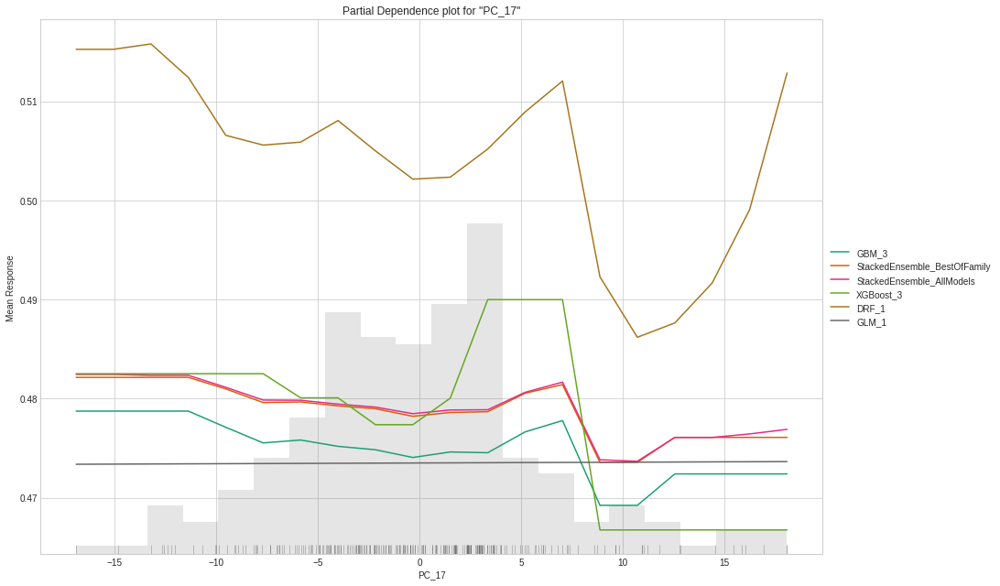

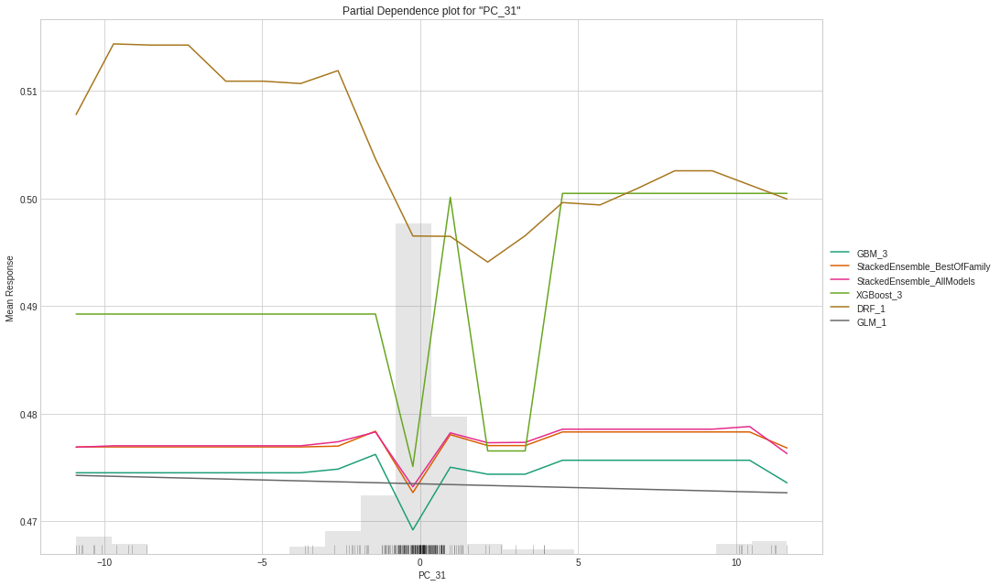

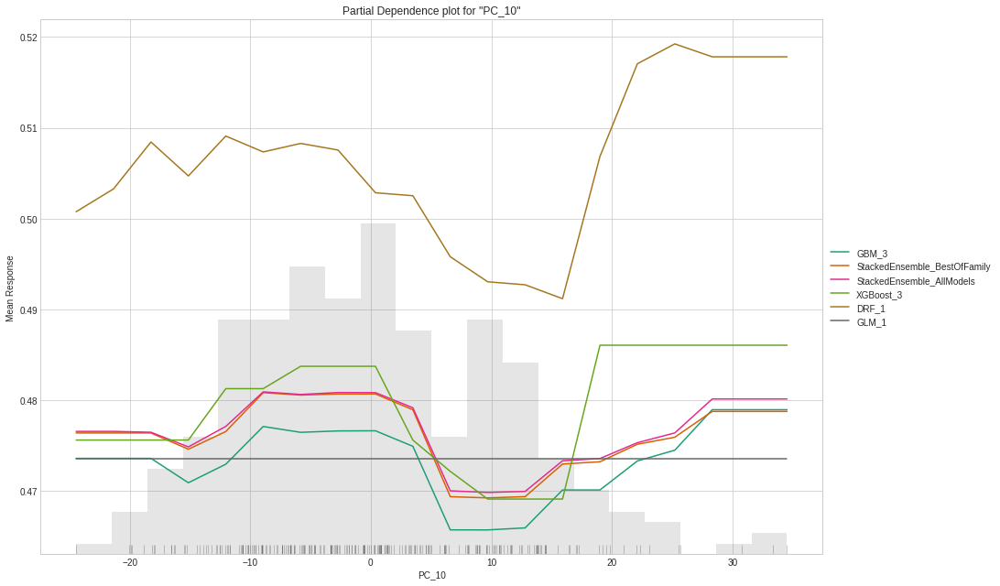

In [ ]:
aml.explain(test)

0 ==  HA | 1 == LA


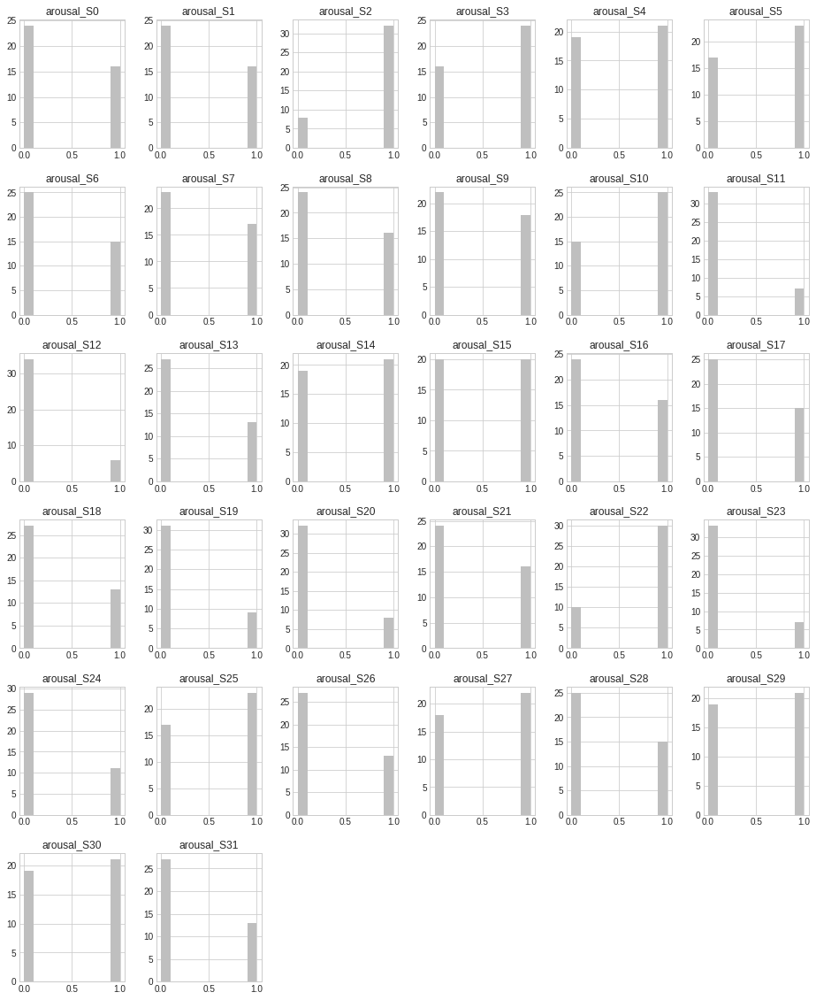

In [ ]:
def labels_df(files_list, dim):
  '''
  Args:
    files_list
    dim: "valence" or "arousal"
  '''
  labels_list = []
  for file in files_list:
    lb = create_labels(file, dim)
    labels_list.append(lb)
  lab_df = pd.DataFrame(labels_list).T
  ord_enc = OrdinalEncoder()
  lab_df_enc = ord_enc.fit_transform(lab_df)
  lab_df_enc = pd.DataFrame(lab_df_enc).add_prefix(f"{dim}_S")
  return lab_df_enc, ord_enc

lab_df, enc = labels_df(files_list, "arousal")
lab_df.hist(color="0.75", figsize=(16,20));
print(f"0 ==  {enc.categories_[0].tolist()[0]} | 1 == {enc.categories_[0].tolist()[1]}")


0 ==  NV | 1 == PV


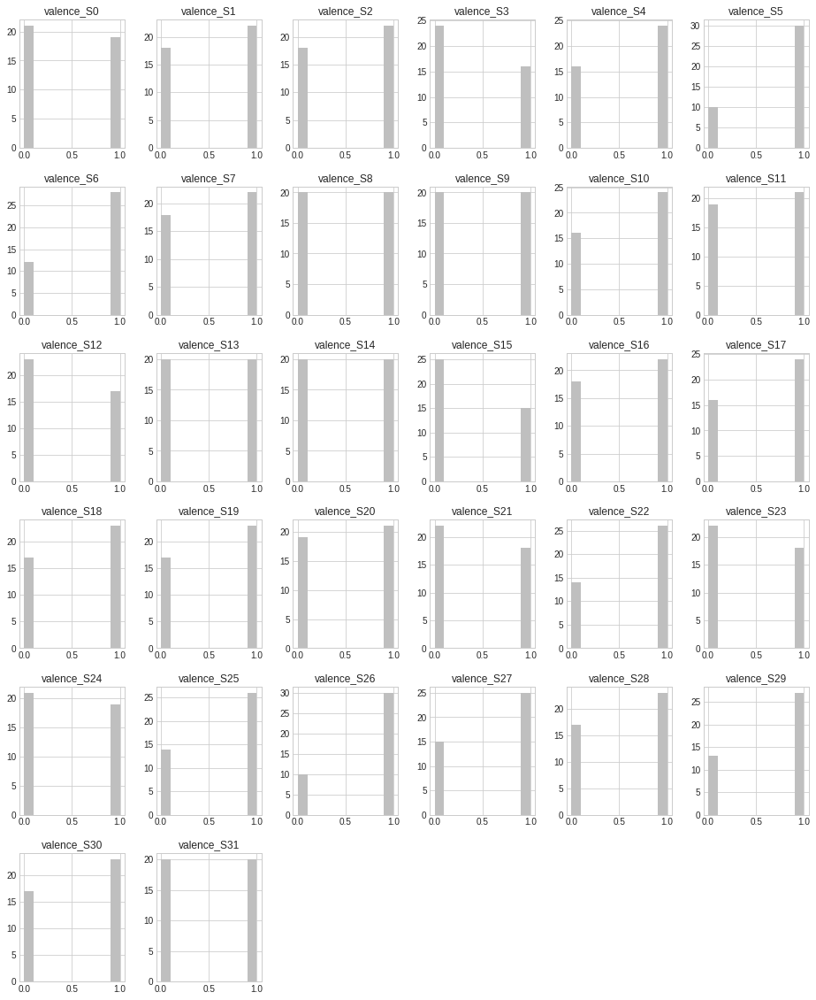

In [ ]:
lab_df, enc = labels_df(files_list, "valence")
lab_df.hist(color="0.75", figsize=(16,20));
print(f"0 ==  {enc.categories_[0].tolist()[0]} | 1 == {enc.categories_[0].tolist()[1]}")

In [ ]:
# files_list
# model for each participant arousal, valence
# general model of all participants arousal valence

In [ ]:
# Machine Learning

# preprocessing -> Standarize Signal -> PCA (Principal Component Analysis) -> [ML] Logistic Regression (Binomial)
# AutoML -> Leader -> Less Error, Higher Accuracy

# TODO

# model for each participants
# general model
# model for each video

#Entrenamiento 3 primeros sujetos con Stacked Ensemble

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |
05:19:43.975: Project: AutoML_20210910_51943974
05:19:43.975: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:19:43.975: Build control seed: 420
05:19:43.975: training frame: Frame key: automl_training_py_257_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -8569701433379092882
05:19:43.975: validation frame: NULL
05:19:43.975: leaderboard frame: NULL
05:19:43.975: blending frame: NULL
05:19:43.975: response column: arousal
05:19:43.975: fold column: null
05:19:43.975: weights column: null
05:19:43.975: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
05:19:43.976: AutoML job created: 2021.09.10

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_4_AutoML_20210910_051943,0.999981,0.0169944,0.999972,0.00119617,0.0600048,0.00360058,3153,0.101085,GBM
StackedEnsemble_BestOfFamily_AutoML_20210910_051943,0.999969,0.0131033,0.999954,0.00200918,0.0563355,0.00317369,609,0.100347,StackedEnsemble
StackedEnsemble_AllModels_AutoML_20210910_051943,0.999965,0.0122915,0.999949,0.00200918,0.0559909,0.00313498,672,0.164857,StackedEnsemble
GBM_3_AutoML_20210910_051943,0.99986,0.0233973,0.999796,0.00521453,0.0747808,0.00559217,3129,0.05986,GBM
GBM_2_AutoML_20210910_051943,0.999735,0.0344444,0.999606,0.00602754,0.0856885,0.00734253,4023,0.054877,GBM
GBM_1_AutoML_20210910_051943,0.998214,0.0901616,0.997285,0.0192788,0.14668,0.0215151,1932,0.041361,GBM
XGBoost_3_AutoML_20210910_051943,0.932824,0.337933,0.897496,0.142006,0.326401,0.106538,541,0.006996,XGBoost
XGBoost_1_AutoML_20210910_051943,0.810252,0.518105,0.744632,0.268098,0.417502,0.174308,204,0.00606,XGBoost
XGBoost_2_AutoML_20210910_051943,0.736539,0.59334,0.639798,0.312683,0.450382,0.202844,426,0.00563,XGBoost
GBM_5_AutoML_20210910_051943,0.731628,0.594729,0.618303,0.296357,0.451782,0.204107,269,0.009017,GBM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_4_AutoML_20210910_051943


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.999965347514561: 


,,HA,LA,Error,Rate
0,HA,615.0,0.0,0.0,(0.0/615.0)
1,LA,0.0,605.0,0.0,(0.0/605.0)
2,Total,615.0,605.0,0.0,(0.0/1220.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

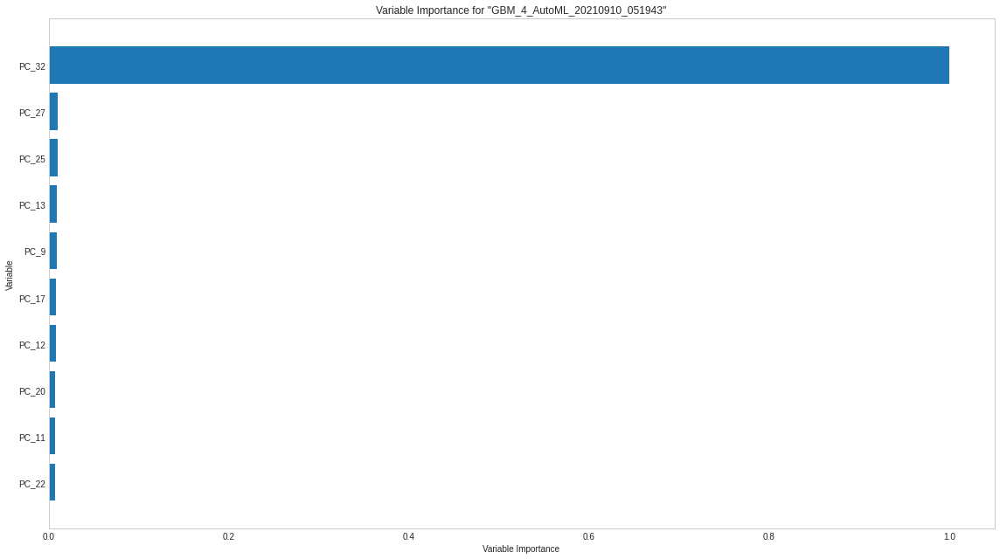

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

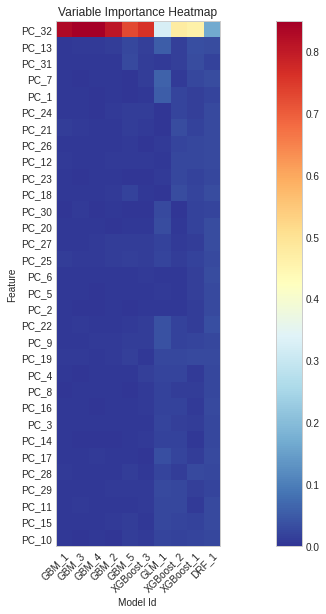

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

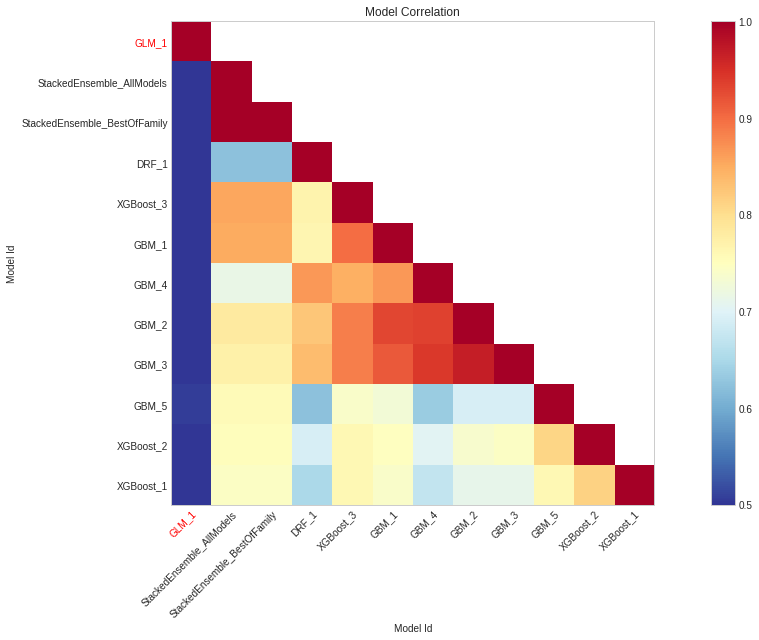

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

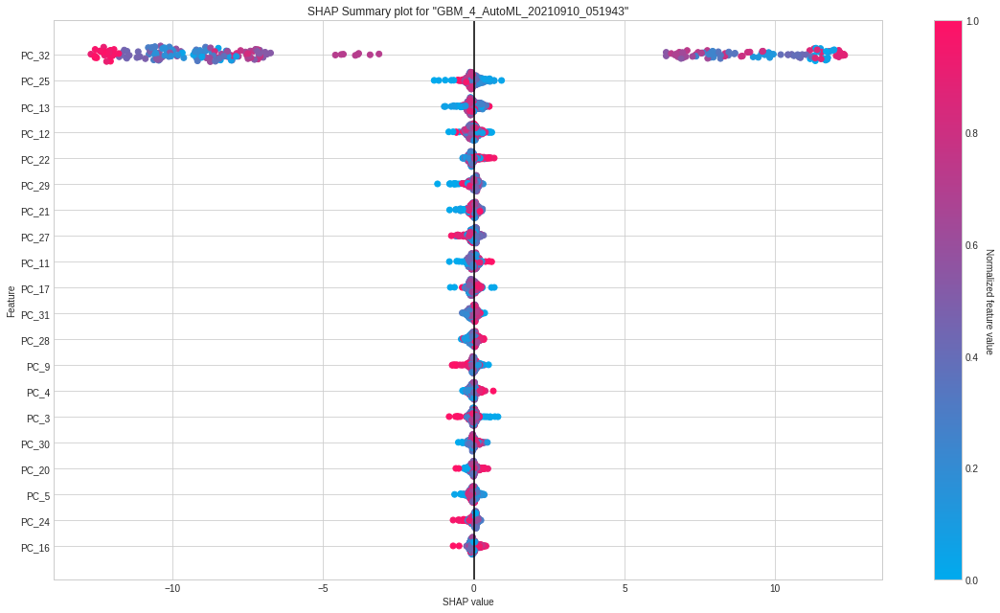

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

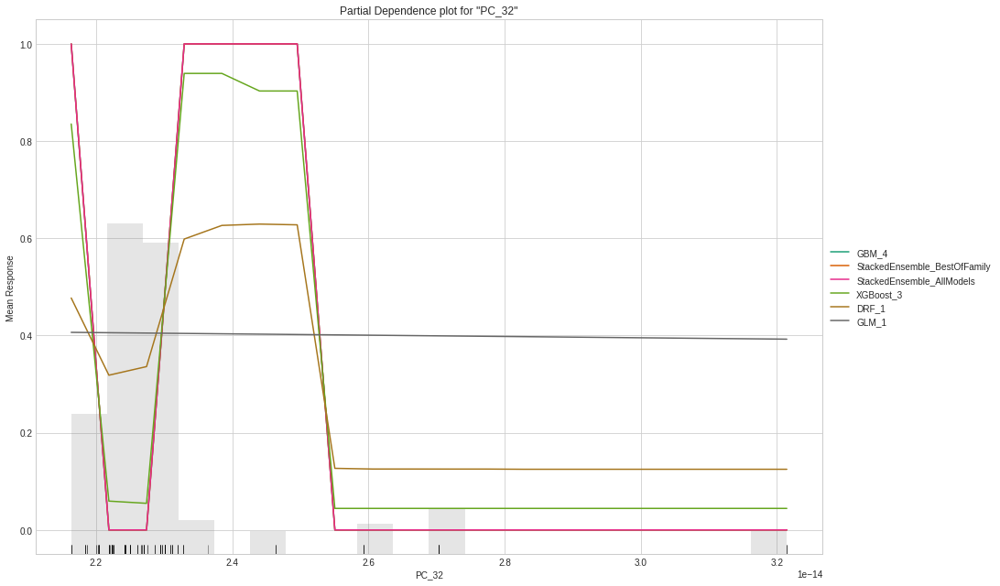

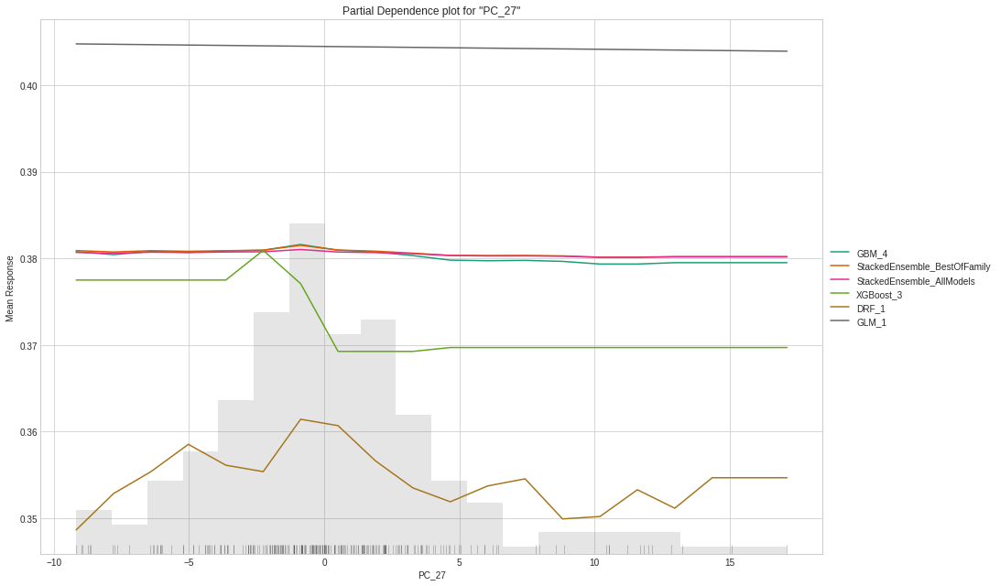

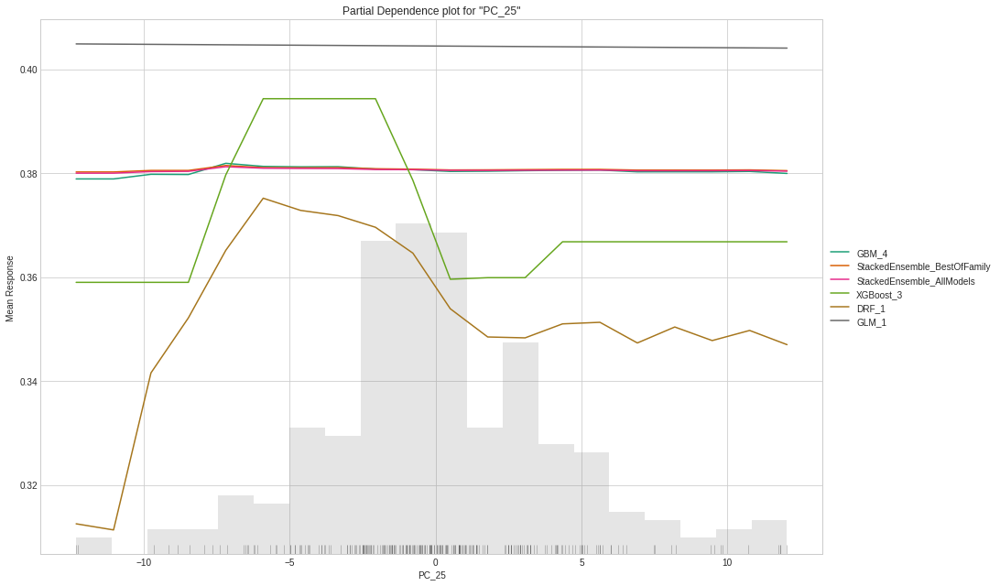

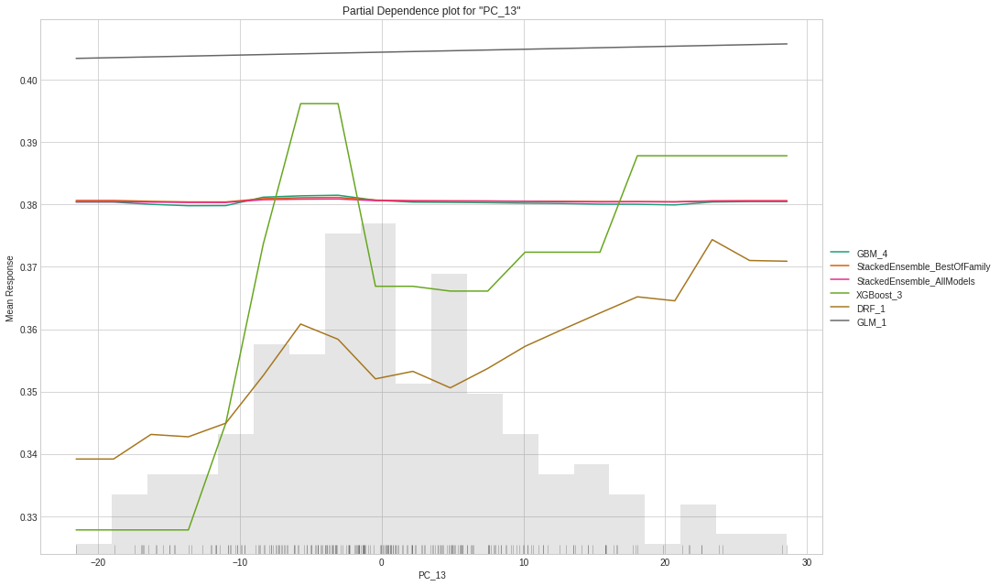

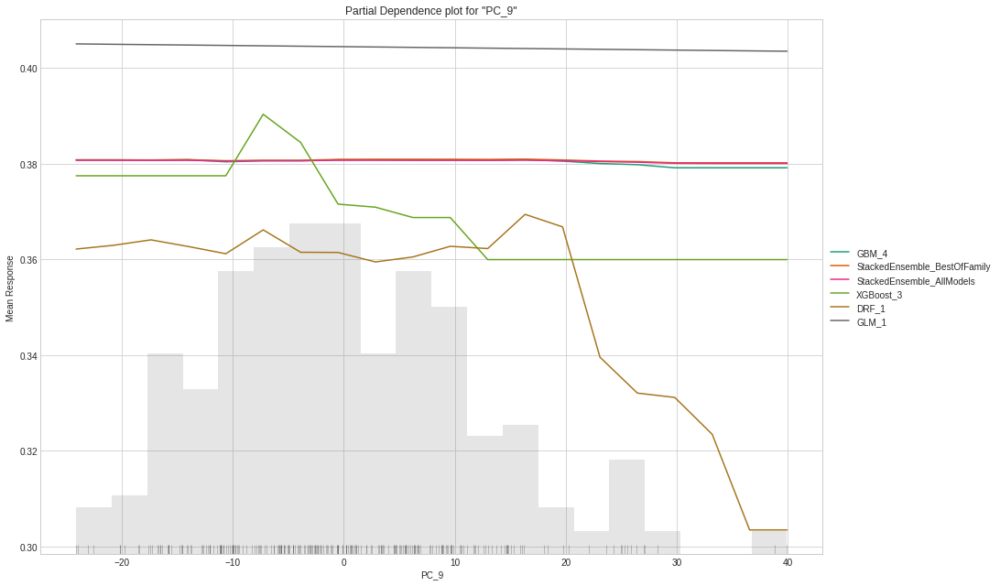



==== Subject 0 | Label valence ====


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_4_AutoML_20210910_052107,0.997276,0.0700384,0.996979,0.0288028,0.147102,0.0216391,1424,0.037383,GBM
StackedEnsemble_AllModels_AutoML_20210910_052107,0.997218,0.0696554,0.996913,0.0278949,0.148241,0.0219755,489,0.081208,StackedEnsemble
StackedEnsemble_BestOfFamily_AutoML_20210910_052107,0.997181,0.0687426,0.996869,0.0281017,0.14566,0.0212169,345,0.035765,StackedEnsemble
GBM_2_AutoML_20210910_052107,0.996771,0.0819694,0.996431,0.0307444,0.156882,0.0246119,1203,0.030073,GBM
GBM_1_AutoML_20210910_052107,0.99676,0.0930413,0.99643,0.0299399,0.157995,0.0249623,1336,0.028443,GBM
GBM_3_AutoML_20210910_052107,0.996316,0.0852955,0.995939,0.0312613,0.160935,0.0258999,1137,0.031838,GBM
XGBoost_3_AutoML_20210910_052107,0.979565,0.218357,0.977966,0.0798016,0.249002,0.0620018,330,0.00897,XGBoost
XGBoost_1_AutoML_20210910_052107,0.907077,0.392348,0.896087,0.169024,0.353406,0.124896,246,0.007515,XGBoost
XGBoost_2_AutoML_20210910_052107,0.840511,0.493603,0.825101,0.247126,0.403833,0.163081,266,0.006108,XGBoost
GBM_5_AutoML_20210910_052107,0.814336,0.513319,0.818239,0.27123,0.415257,0.172438,411,0.012415,GBM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_4_AutoML_20210910_052107


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9784278304816042: 


,,NV,PV,Error,Rate
0,NV,544.0,0.0,0.0,(0.0/544.0)
1,PV,0.0,552.0,0.0,(0.0/552.0)
2,Total,544.0,552.0,0.0,(0.0/1096.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

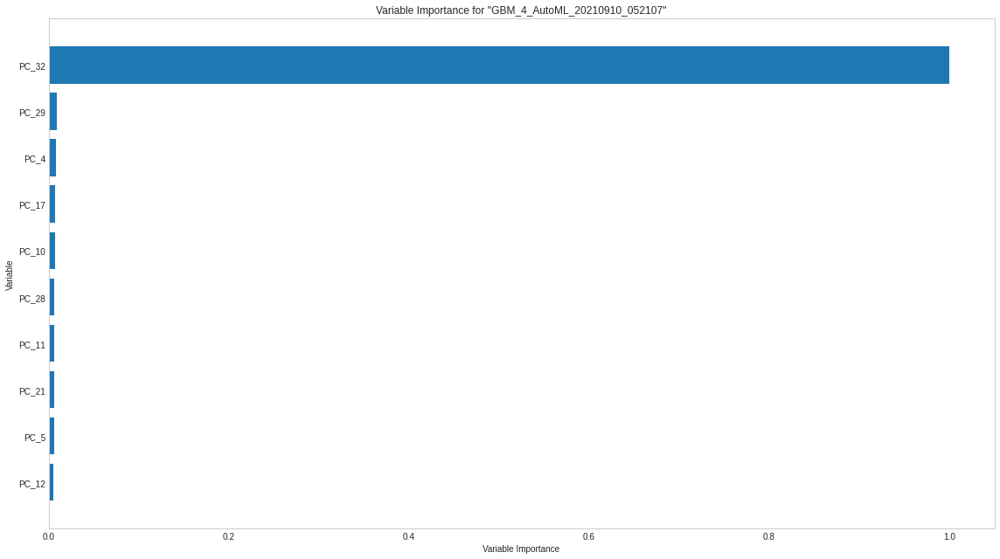

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

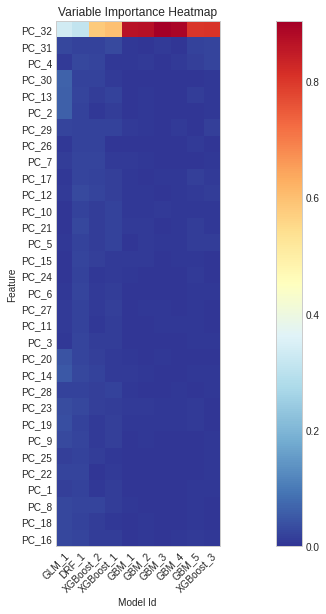

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

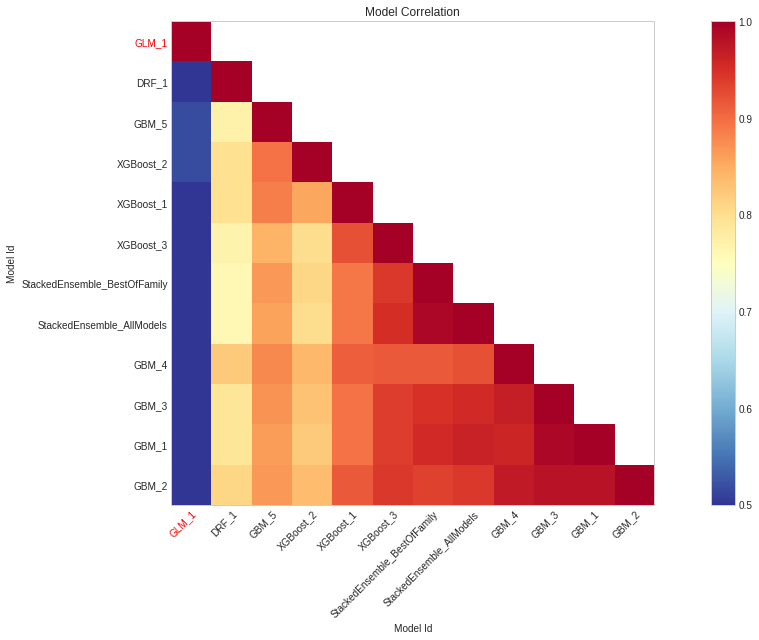

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

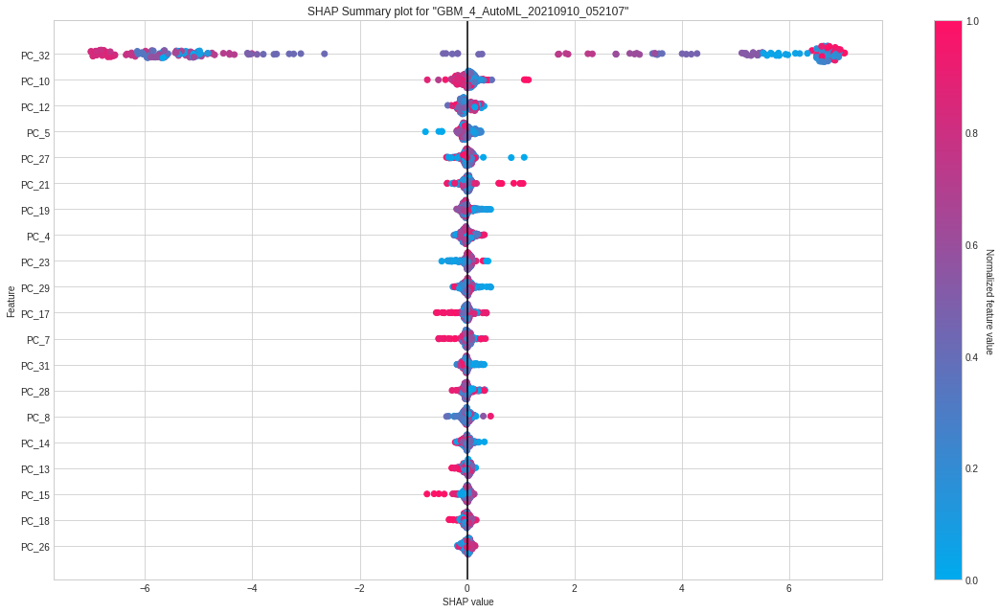

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

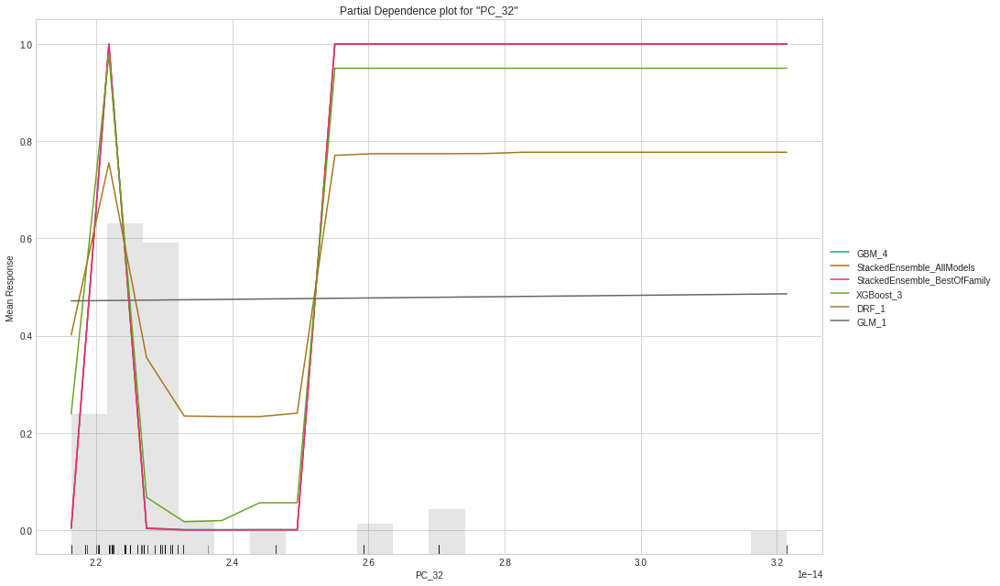

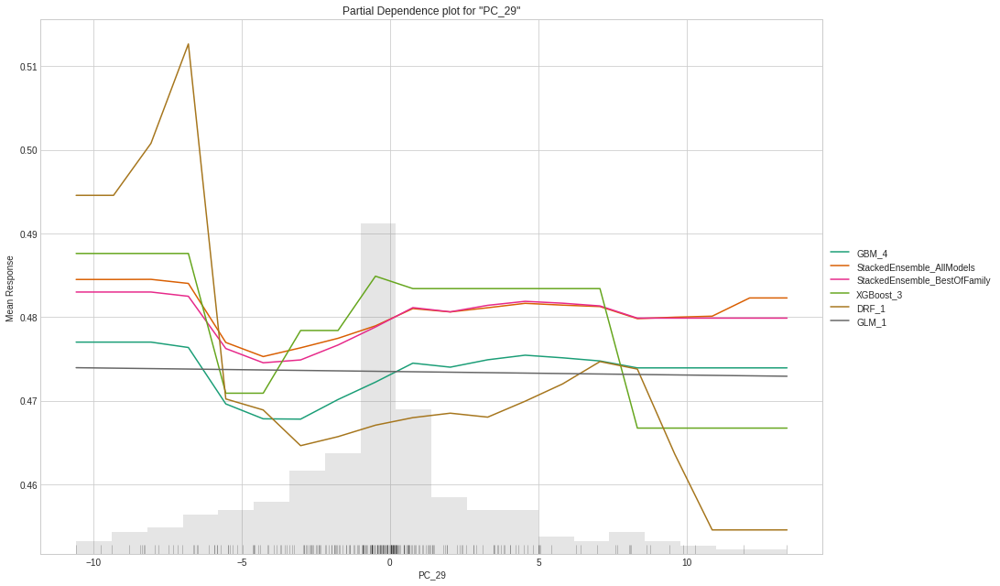

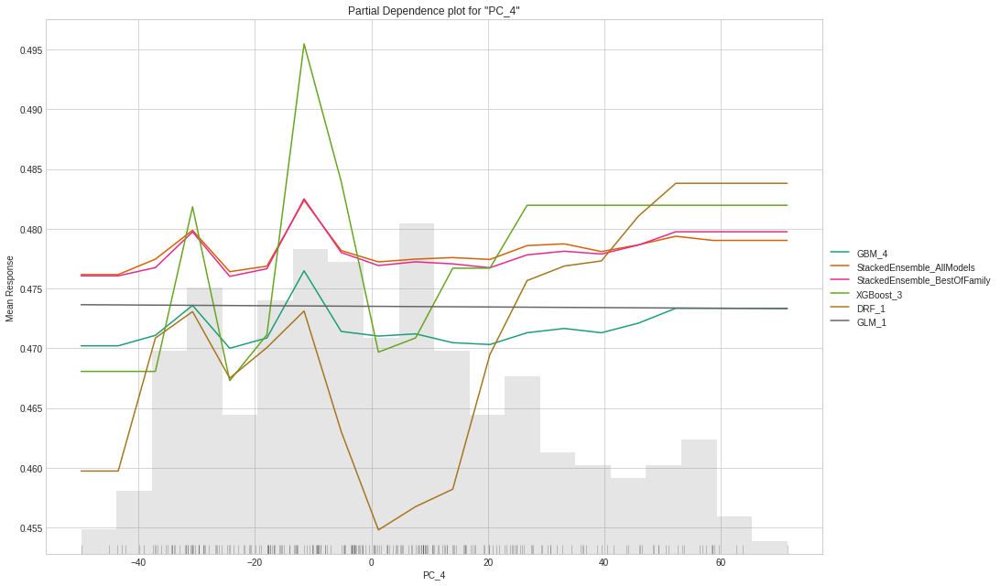

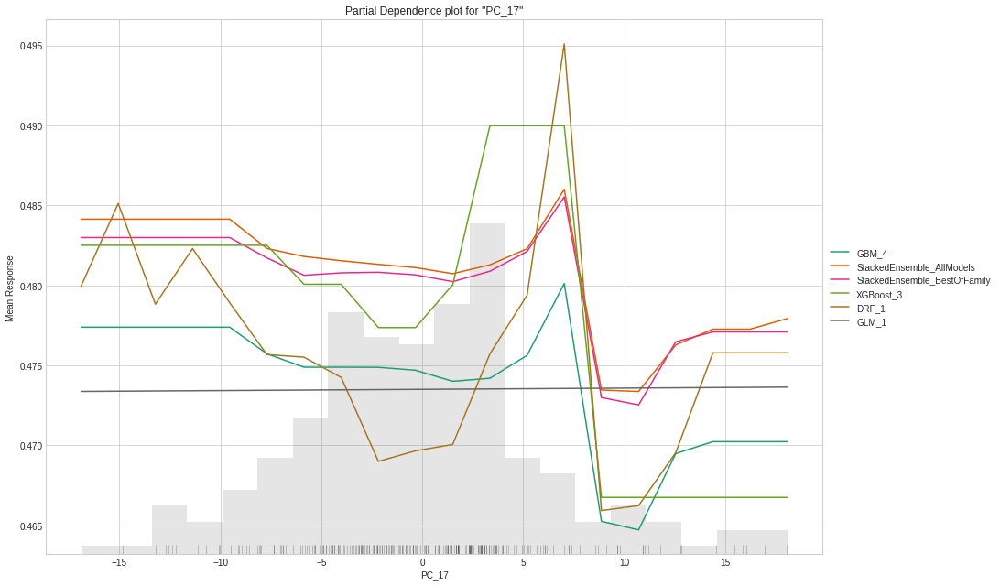

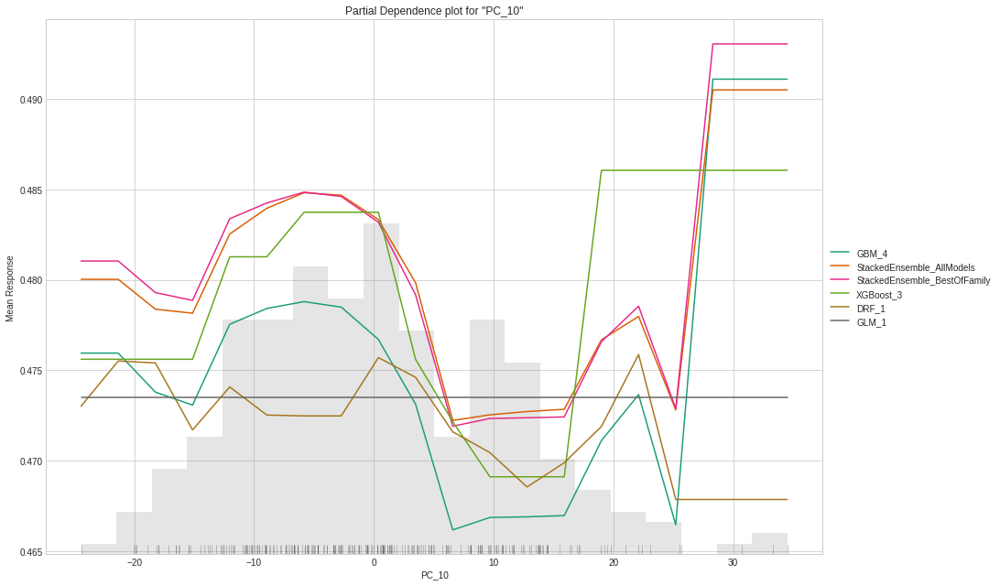



Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |
05:22:45.876: Project: AutoML_20210910_52245876
05:22:45.877: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:22:45.877: Build control seed: 420
05:22:45.877: training frame: Frame key: automl_training_py_563_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -7129540488822410997
05:22:45.877: validation frame: NULL
05:22:45.877: leaderboard frame: NULL
05:22:45.877: blending frame: NULL
05:22:45.877: response column: arousal
05:22:45.877: fold column: null
05:22:45.877: weights column: null
05:22:45.877: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
05:22:45.877: AutoML job created: 2021.09.

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_AutoML_20210910_052245,0.999868,0.0182901,0.999807,0.00445816,0.0686698,0.00471554,747,0.149629,StackedEnsemble
StackedEnsemble_BestOfFamily_AutoML_20210910_052245,0.999814,0.0195666,0.999726,0.00409165,0.0699234,0.00488928,556,0.045335,StackedEnsemble
GBM_1_AutoML_20210910_052245,0.999787,0.0506059,0.999685,0.00490998,0.103043,0.0106179,2085,0.039286,GBM
GBM_2_AutoML_20210910_052245,0.999298,0.0489759,0.999011,0.011286,0.113412,0.0128622,2000,0.04776,GBM
GBM_3_AutoML_20210910_052245,0.998676,0.0570324,0.998118,0.0177473,0.12847,0.0165045,1885,0.043408,GBM
GBM_4_AutoML_20210910_052245,0.998447,0.0591219,0.997869,0.0161106,0.125747,0.0158123,1670,0.036102,GBM
XGBoost_3_AutoML_20210910_052245,0.960792,0.271247,0.942696,0.112996,0.287644,0.0827392,257,0.007454,XGBoost
XGBoost_1_AutoML_20210910_052245,0.897899,0.398428,0.851317,0.186118,0.361348,0.130572,454,0.007589,XGBoost
GBM_5_AutoML_20210910_052245,0.85259,0.46109,0.816461,0.248582,0.392007,0.153669,696,0.014735,GBM
XGBoost_2_AutoML_20210910_052245,0.81594,0.508018,0.767223,0.256595,0.415513,0.172651,277,0.006186,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_AutoML_20210910_052245


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9998819194387033: 


,,HA,LA,Error,Rate
0,HA,611.0,0.0,0.0,(0.0/611.0)
1,LA,0.0,422.0,0.0,(0.0/422.0)
2,Total,611.0,422.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

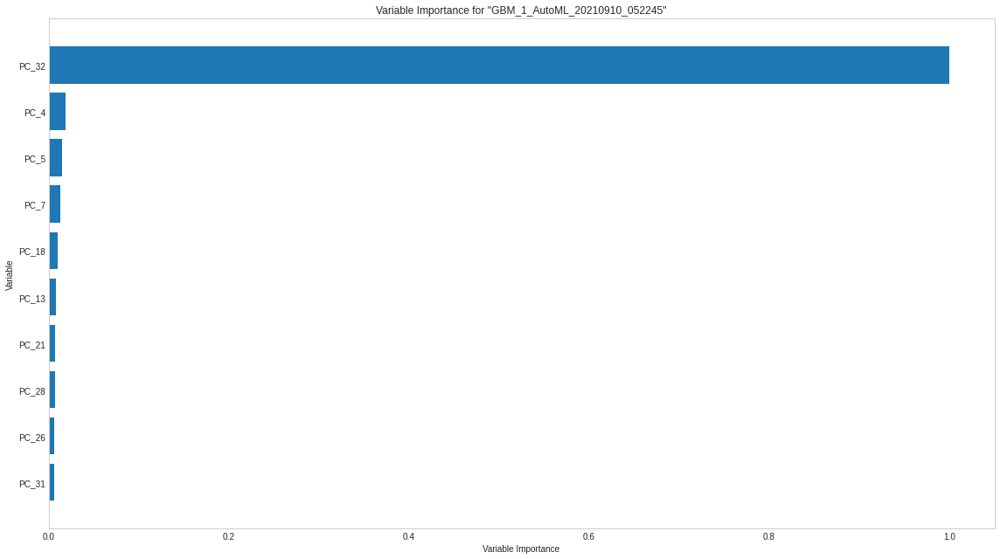

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

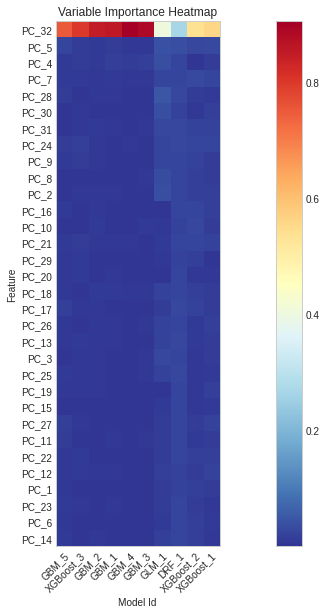

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

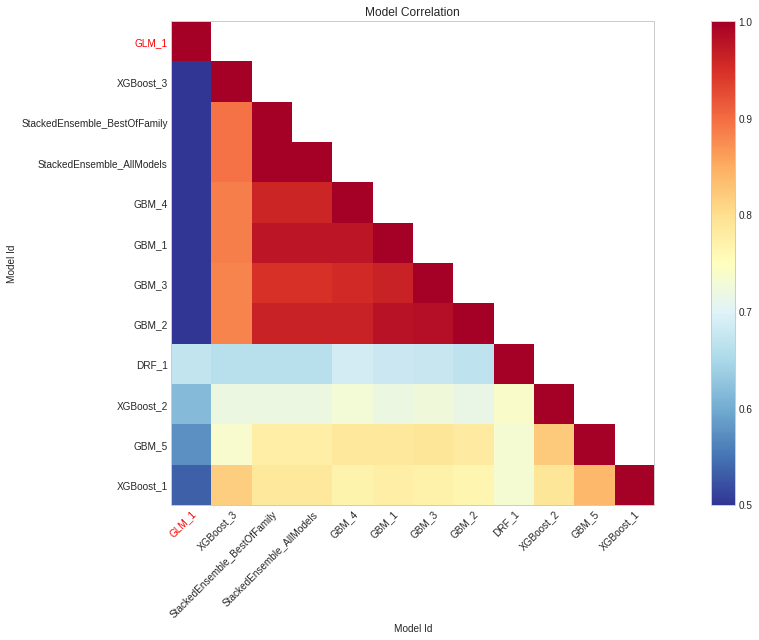

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

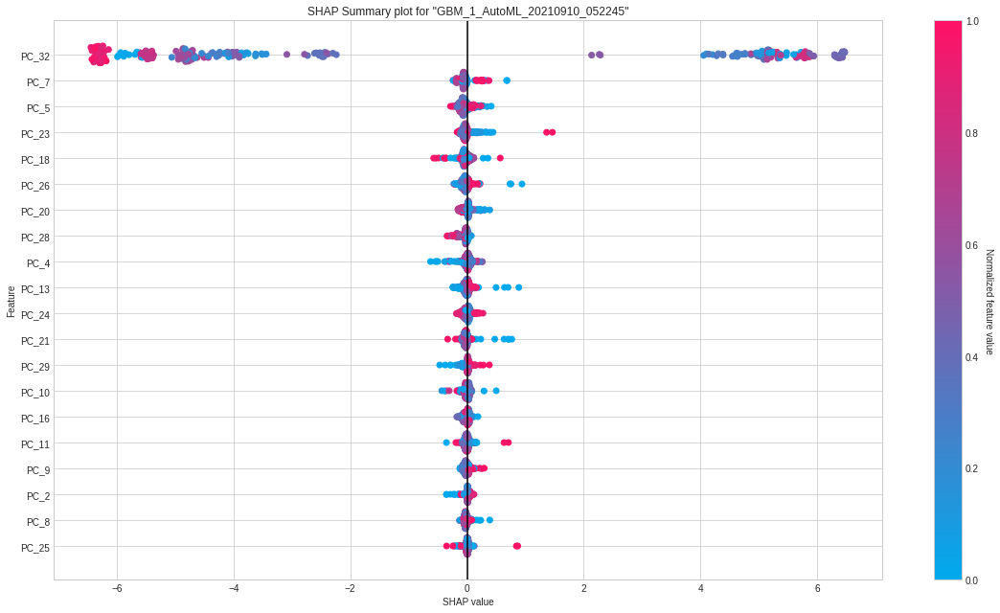

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

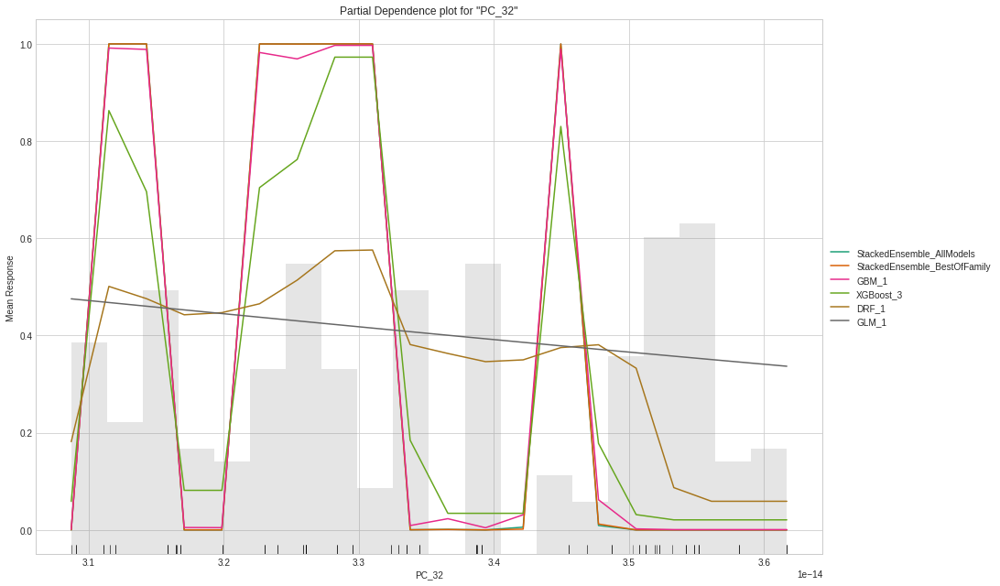

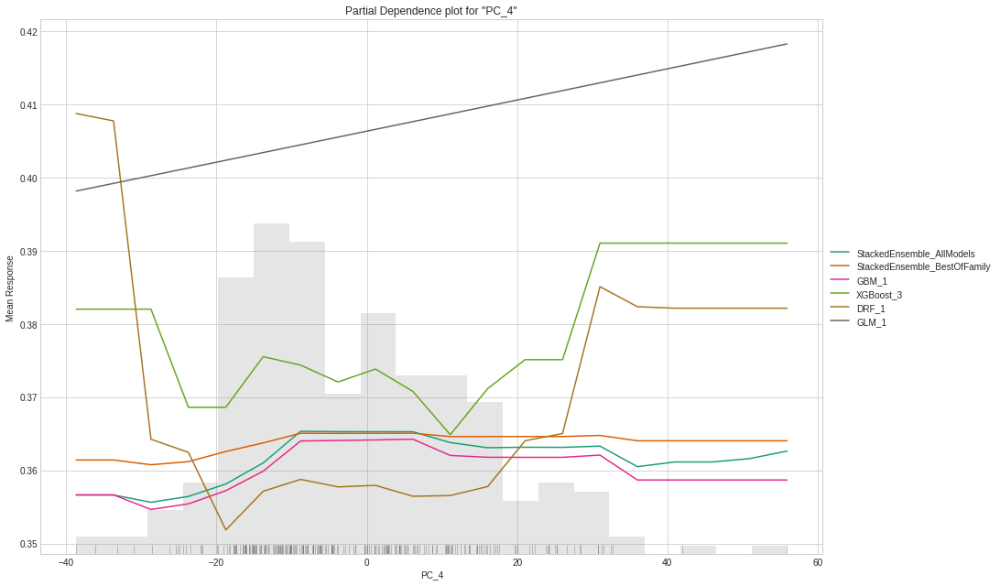

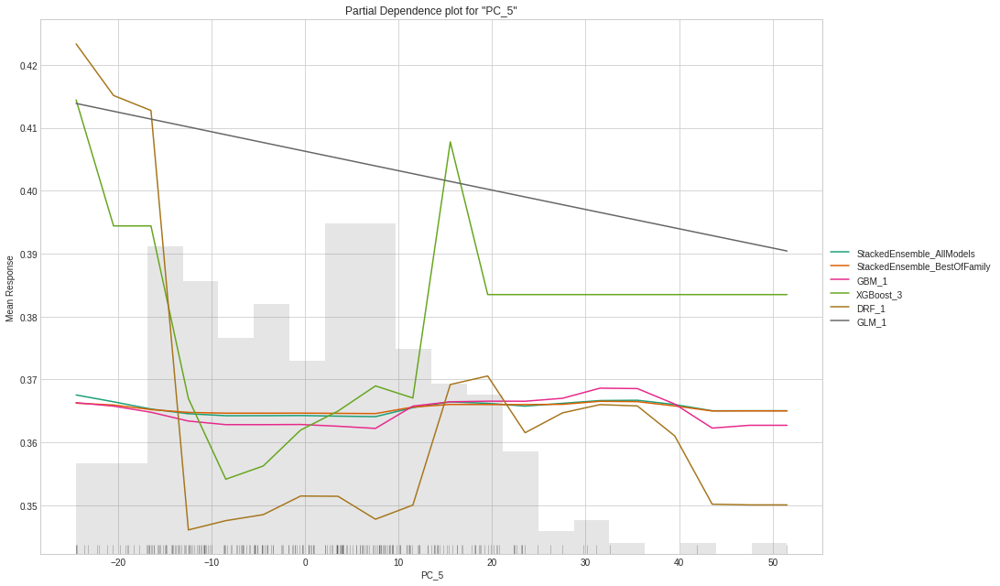

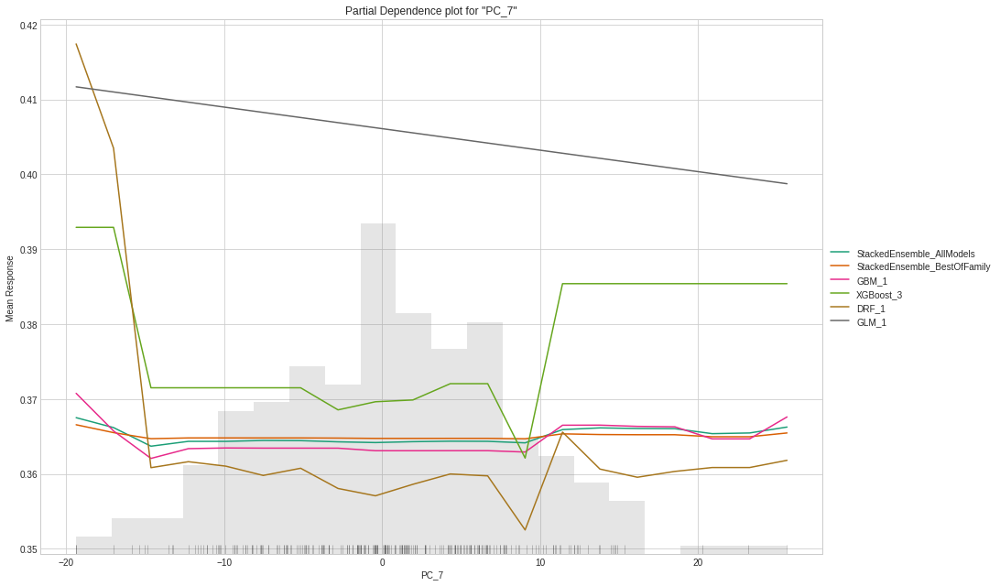

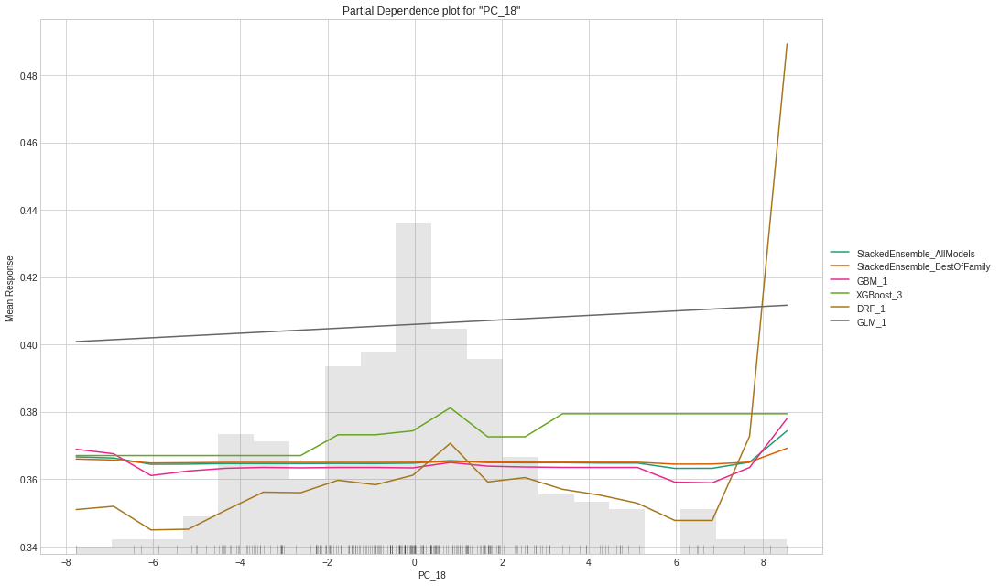



==== Subject 1 | Label valence ====


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_BestOfFamily_AutoML_20210910_052354,0.998789,0.0441574,0.999035,0.0138055,0.109955,0.0120901,452,0.05177,StackedEnsemble
StackedEnsemble_AllModels_AutoML_20210910_052354,0.998611,0.0460273,0.998899,0.0142188,0.111872,0.0125154,491,0.063138,StackedEnsemble
GBM_3_AutoML_20210910_052354,0.998455,0.0761741,0.998782,0.0154341,0.133647,0.0178615,1343,0.030219,GBM
GBM_1_AutoML_20210910_052354,0.997092,0.115075,0.997601,0.0270374,0.16861,0.0284292,1484,0.03112,GBM
GBM_4_AutoML_20210910_052354,0.996703,0.0884121,0.997321,0.0282527,0.15677,0.0245768,1431,0.029525,GBM
GBM_2_AutoML_20210910_052354,0.996243,0.09838,0.996858,0.0307077,0.164255,0.0269798,1699,0.038961,GBM
XGBoost_3_AutoML_20210910_052354,0.956817,0.295852,0.965728,0.113886,0.297741,0.0886496,302,0.017528,XGBoost
XGBoost_1_AutoML_20210910_052354,0.779334,0.569844,0.783507,0.300552,0.437536,0.191437,324,0.007373,XGBoost
GBM_5_AutoML_20210910_052354,0.768095,0.577119,0.778467,0.29326,0.442,0.195364,258,0.01012,GBM
XGBoost_2_AutoML_20210910_052354,0.734009,0.614781,0.748587,0.339008,0.458158,0.209909,330,0.006814,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_BestOfFamily_AutoML_20210910_052354


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9982278951579276: 


,,NV,PV,Error,Rate
0,NV,474.0,0.0,0.0,(0.0/474.0)
1,PV,0.0,559.0,0.0,(0.0/559.0)
2,Total,474.0,559.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

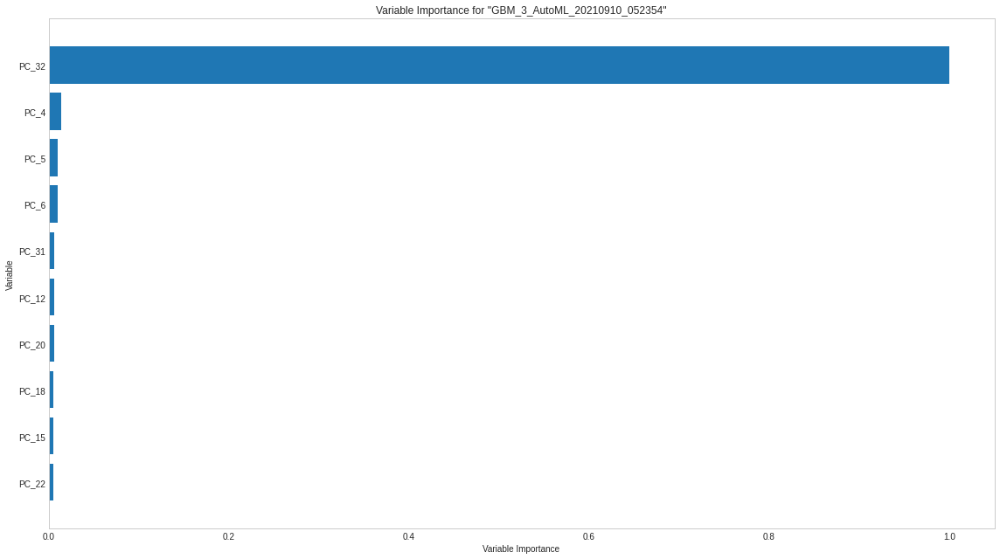

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

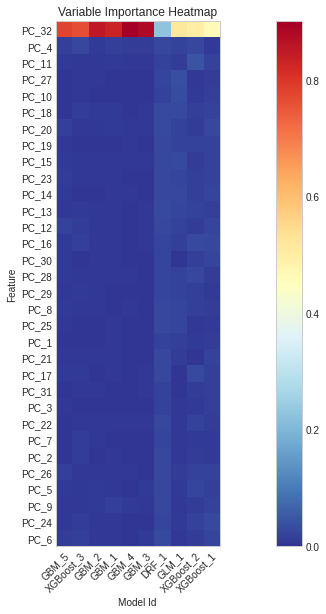

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

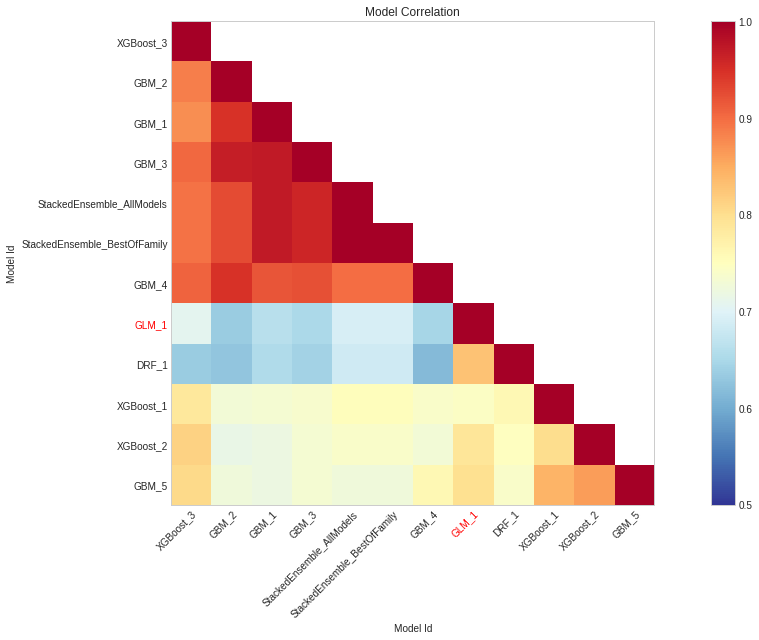

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

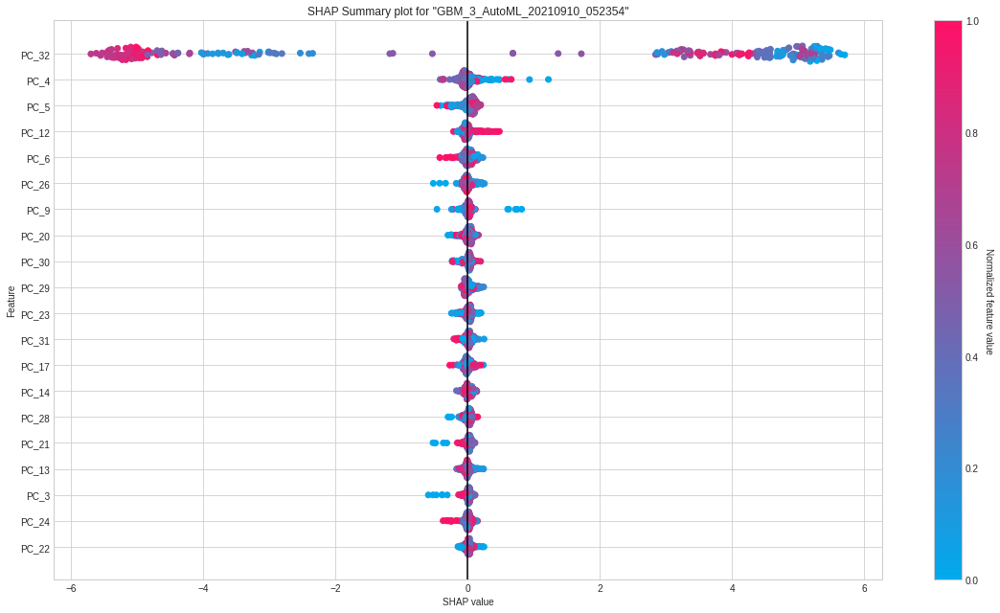

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

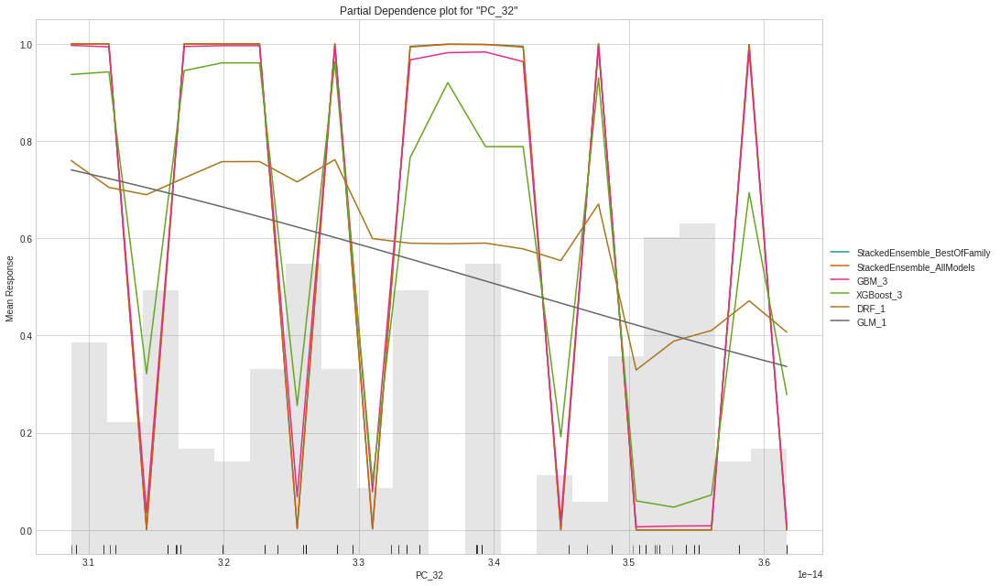

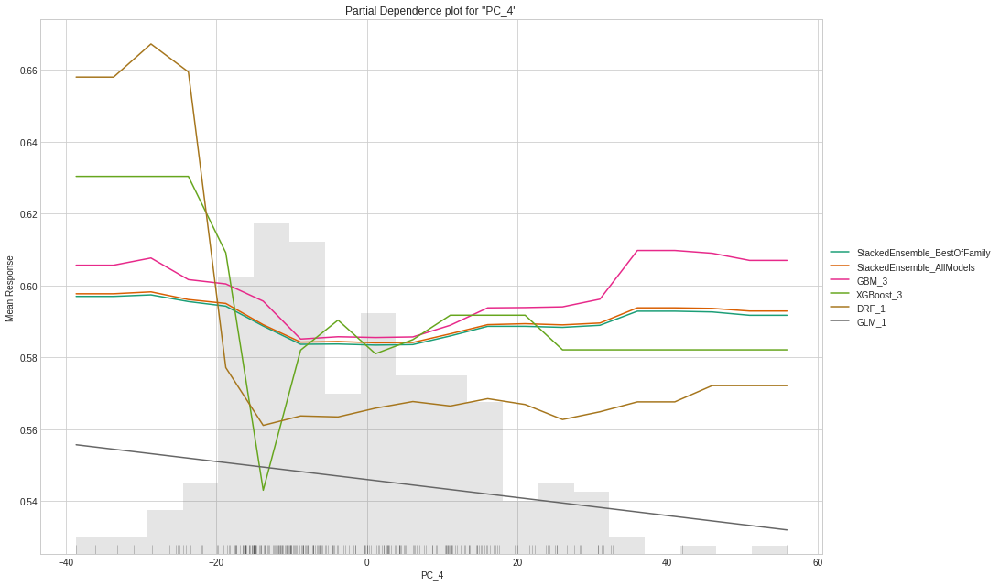

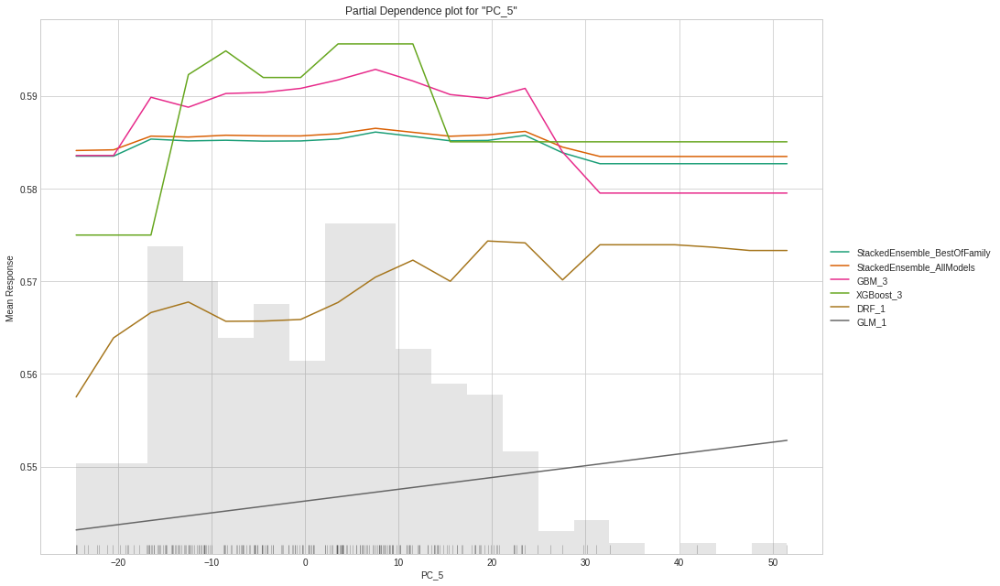

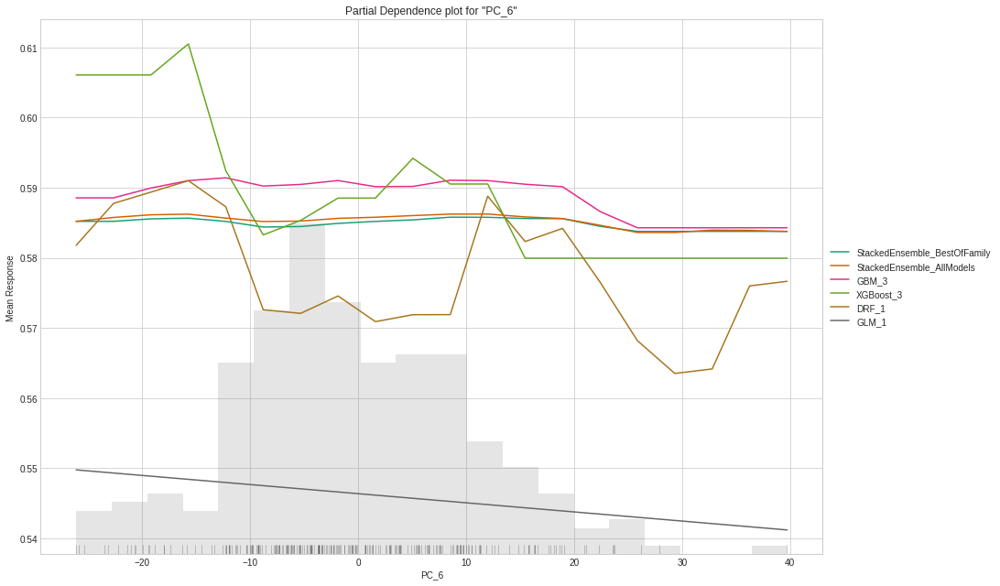

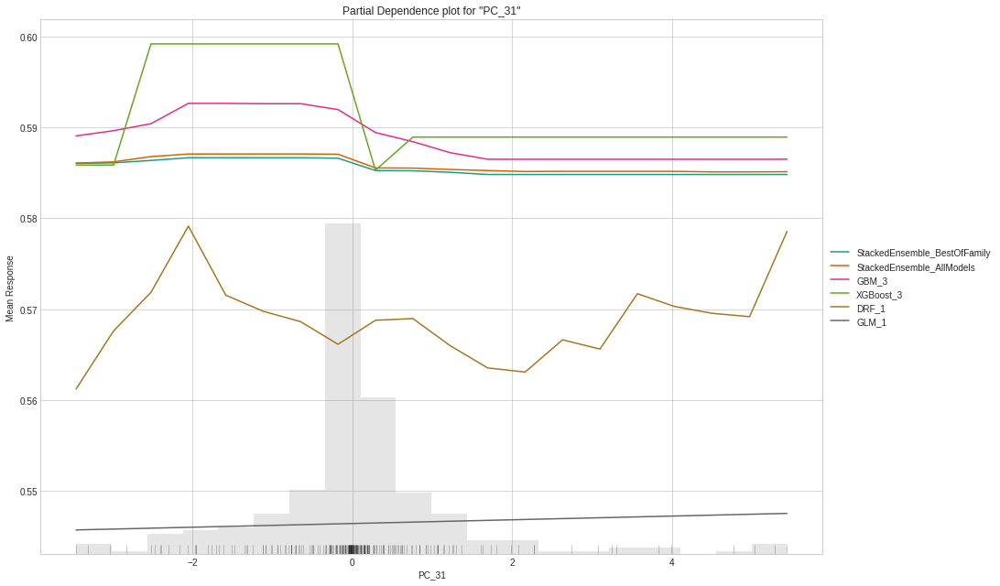



Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |
05:25:31.777: Project: AutoML_20210910_52531777
05:25:31.777: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:25:31.777: Build control seed: 420
05:25:31.777: training frame: Frame key: automl_training_py_883_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -6393927612194368767
05:25:31.777: validation frame: NULL
05:25:31.777: leaderboard frame: NULL
05:25:31.777: blending frame: NULL
05:25:31.777: response column: arousal
05:25:31.777: fold column: null
05:25:31.777: weights column: null
05:25:31.778: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
05:25:31.778: AutoML job created: 2021.09.

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_AutoML_20210910_052531,1,0.000459352,1,0,0.000606703,3.68089e-07,1363,0.5403,StackedEnsemble
GBM_3_AutoML_20210910_052531,1,1.16071e-09,1,0,2.07125e-08,4.29007e-16,7695,0.169361,GBM
StackedEnsemble_BestOfFamily_AutoML_20210910_052531,1,0.00079176,1,0,0.00281794,7.94078e-06,598,0.106896,StackedEnsemble
GBM_1_AutoML_20210910_052531,1,1.09806e-07,1,0,2.97912e-06,8.87516e-12,8475,0.160188,GBM
GBM_4_AutoML_20210910_052531,1,8.95067e-06,1,0,0.000153637,2.36044e-08,5830,0.108905,GBM
GBM_2_AutoML_20210910_052531,1,4.42932e-09,1,0,1.03857e-07,1.07862e-14,7730,0.155661,GBM
XGBoost_3_AutoML_20210910_052531,0.991207,0.140899,0.99786,0.0454676,0.200363,0.0401451,281,0.008768,XGBoost
GBM_5_AutoML_20210910_052531,0.981412,0.189164,0.995463,0.0877037,0.248033,0.0615202,1031,0.023373,GBM
XGBoost_1_AutoML_20210910_052531,0.947072,0.264107,0.986809,0.153092,0.289908,0.0840464,259,0.008421,XGBoost
DRF_1_AutoML_20210910_052531,0.820577,0.472946,0.937991,0.472844,0.393004,0.154452,606,0.018887,DRF


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_AutoML_20210910_052531


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.999774771461061: 


,,HA,LA,Error,Rate
0,HA,211.0,0.0,0.0,(0.0/211.0)
1,LA,0.0,822.0,0.0,(0.0/822.0)
2,Total,211.0,822.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

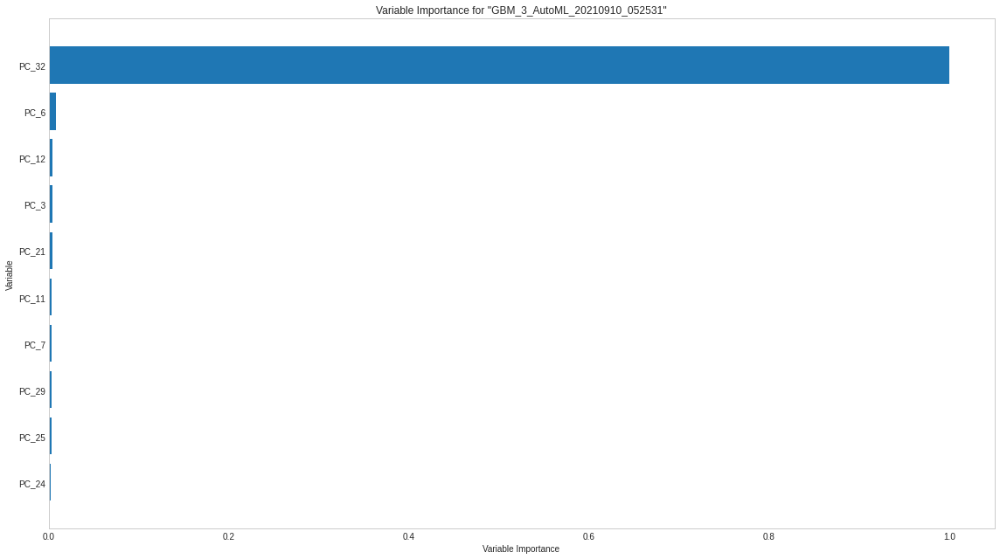

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

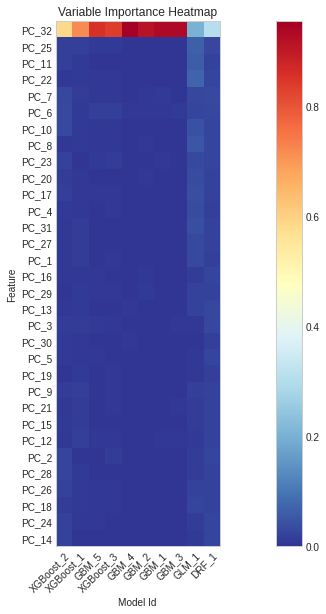

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

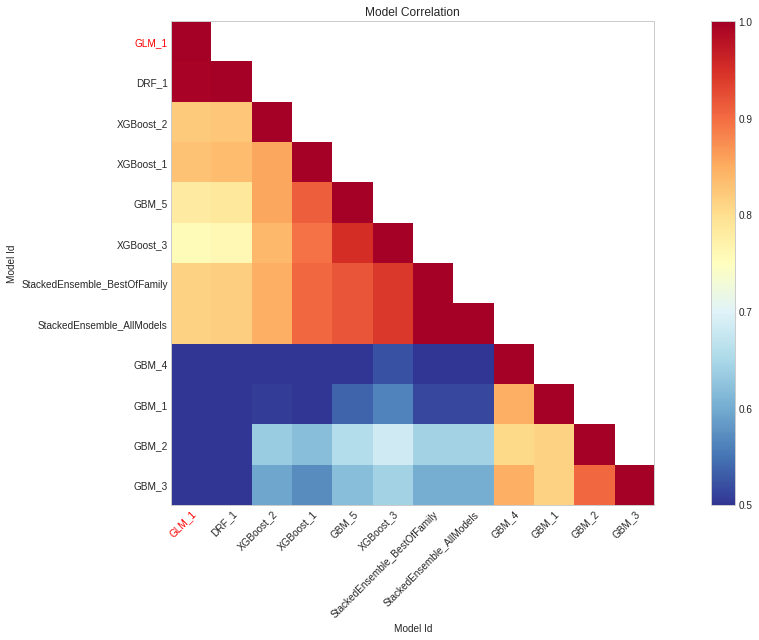

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

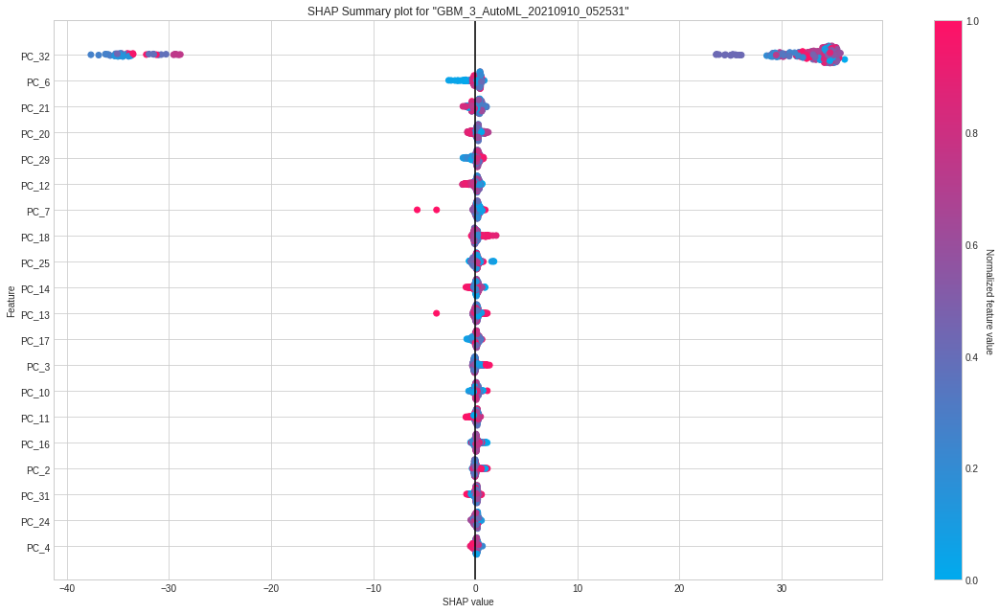

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

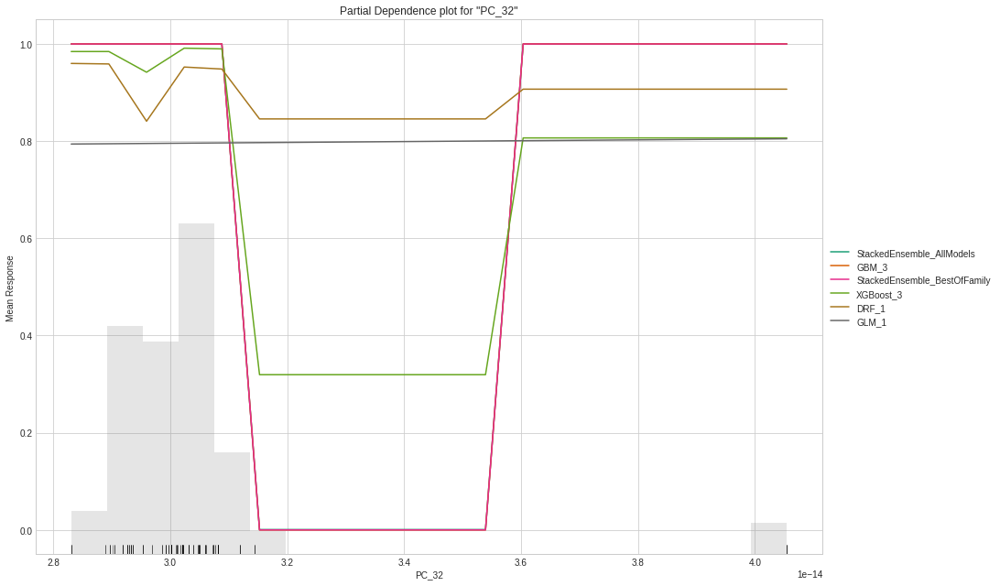

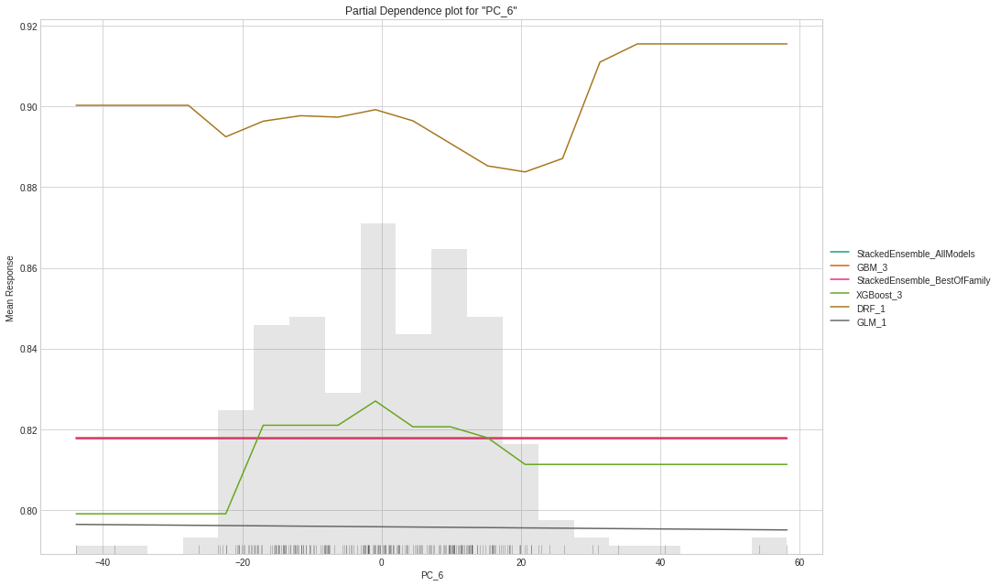

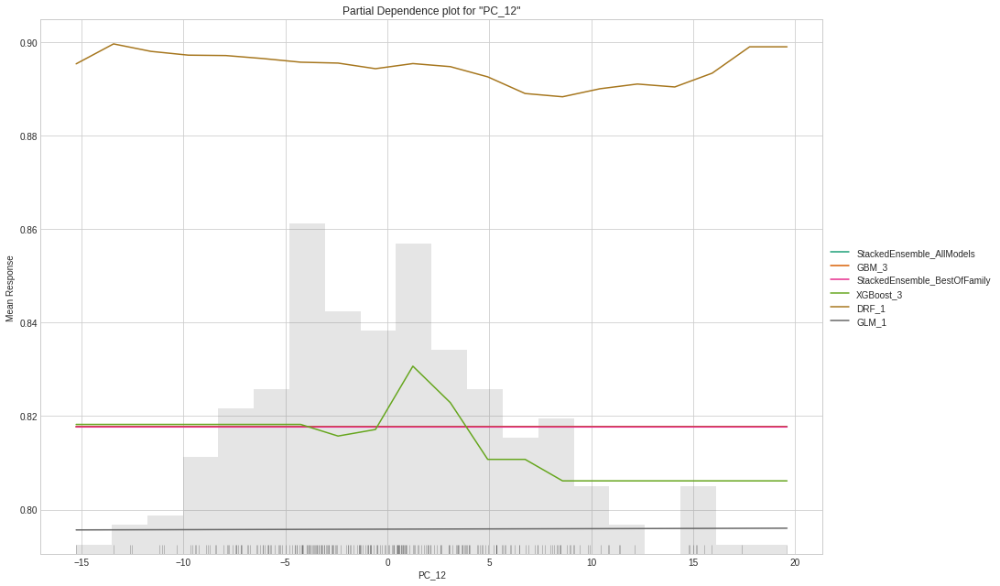

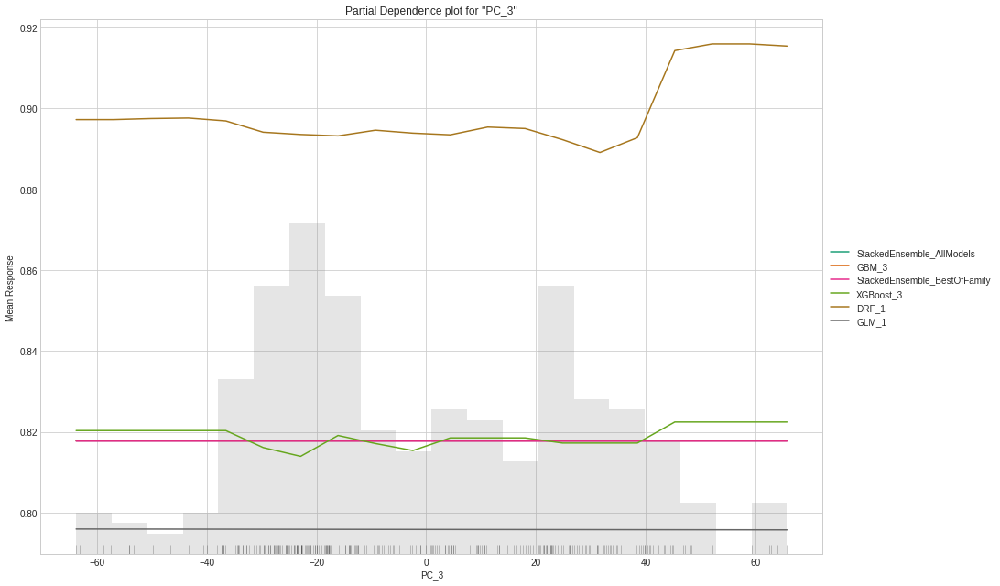

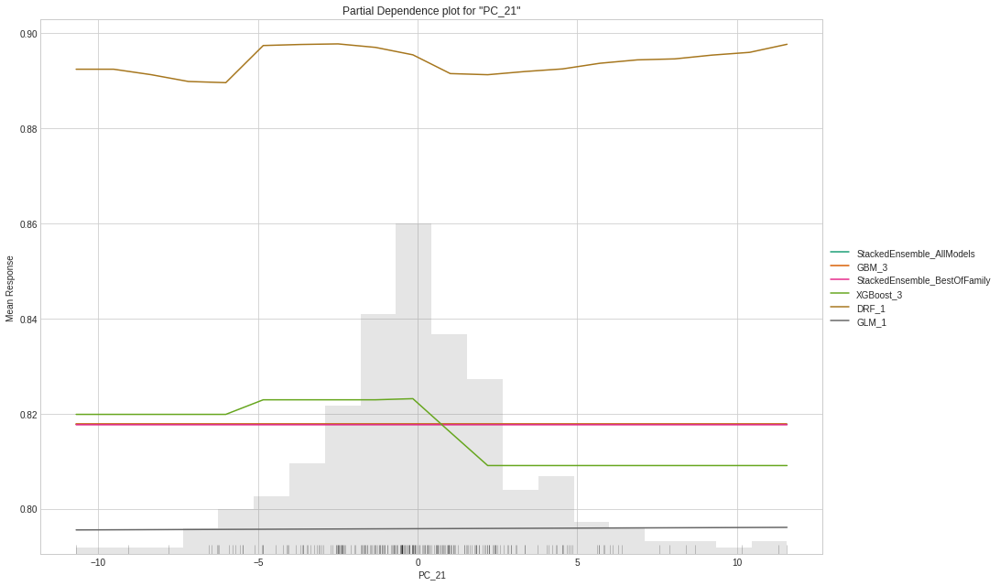



==== Subject 2 | Label valence ====


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_4_AutoML_20210910_052852,1,0.00985807,1,0,0.0419275,0.00175791,4006,0.107193,GBM
GBM_1_AutoML_20210910_052852,1,0.00459503,1,0,0.0169977,0.00028892,4699,0.093193,GBM
GBM_2_AutoML_20210910_052852,1,0.0130492,1,0,0.0412708,0.00170328,3562,0.076568,GBM
GBM_3_AutoML_20210910_052852,1,0.00641873,1,0,0.0291499,0.000849718,3919,0.082129,GBM
StackedEnsemble_AllModels_AutoML_20210910_052852,1,0.00241952,1,0,0.0123401,0.000152278,992,0.27446,StackedEnsemble
StackedEnsemble_BestOfFamily_AutoML_20210910_052852,1,0.00705653,1,0,0.034638,0.00119979,939,0.090196,StackedEnsemble
XGBoost_3_AutoML_20210910_052852,0.919916,0.379529,0.936693,0.17763,0.346338,0.11995,392,0.013329,XGBoost
GBM_5_AutoML_20210910_052852,0.775448,0.596455,0.822264,0.311007,0.451847,0.204165,287,0.01128,GBM
XGBoost_1_AutoML_20210910_052852,0.739053,0.611271,0.764386,0.354469,0.458073,0.209831,864,0.007312,XGBoost
XGBoost_2_AutoML_20210910_052852,0.704145,0.626989,0.759072,0.414497,0.468153,0.219167,205,0.006643,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_4_AutoML_20210910_052852


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9999966274672284: 


,,NV,PV,Error,Rate
0,NV,562.0,0.0,0.0,(0.0/562.0)
1,PV,0.0,555.0,0.0,(0.0/555.0)
2,Total,562.0,555.0,0.0,(0.0/1117.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

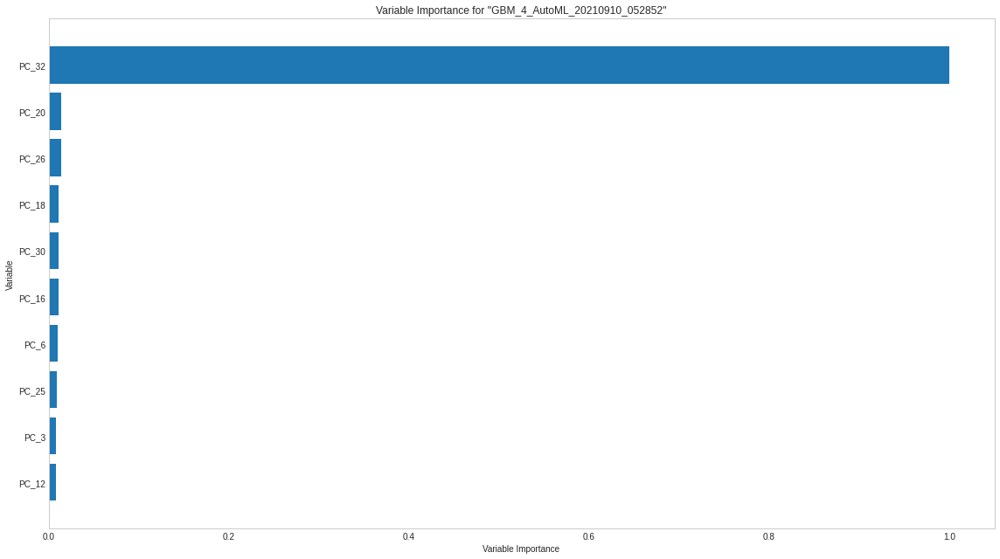

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

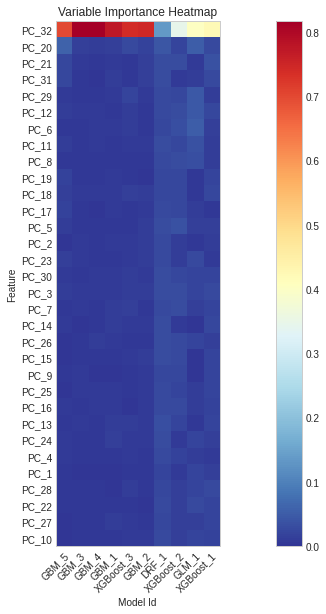

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

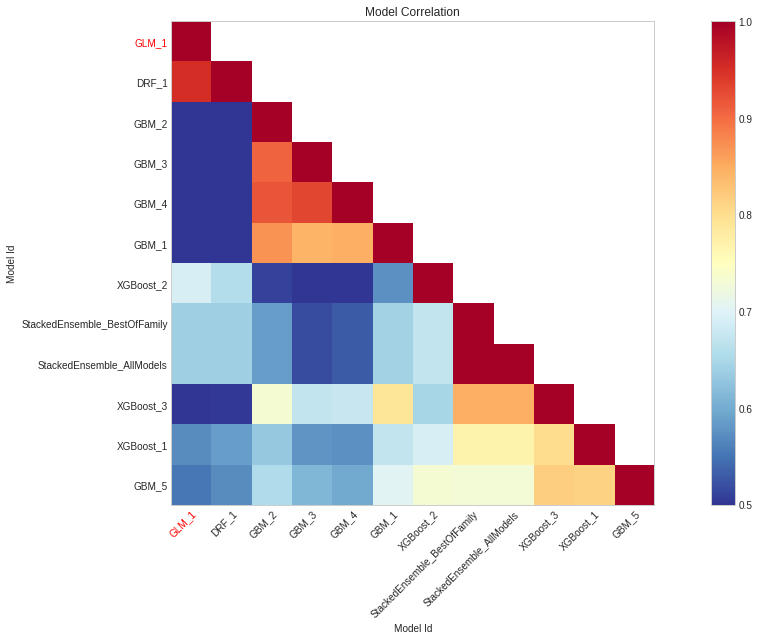

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

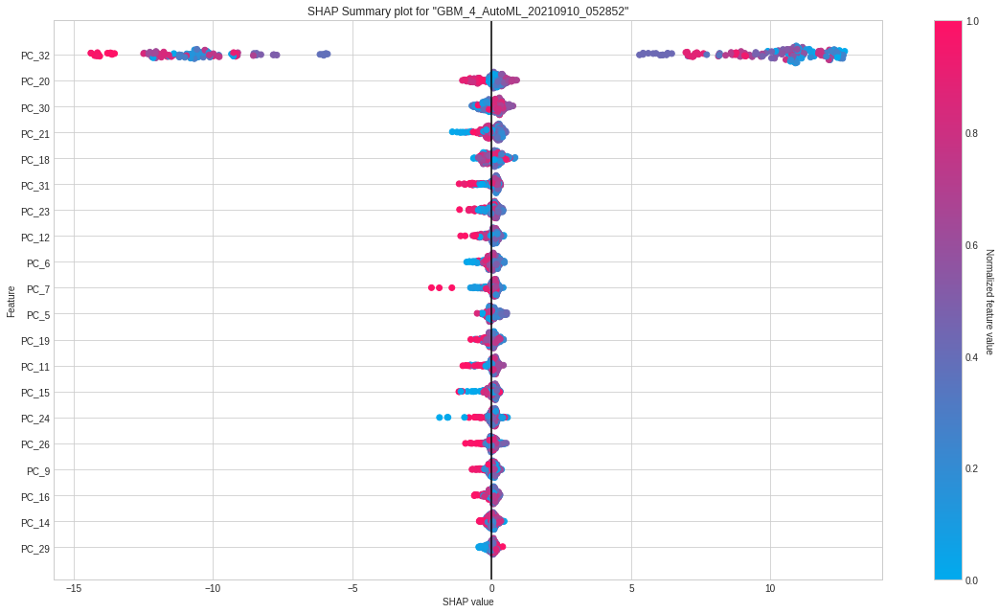

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

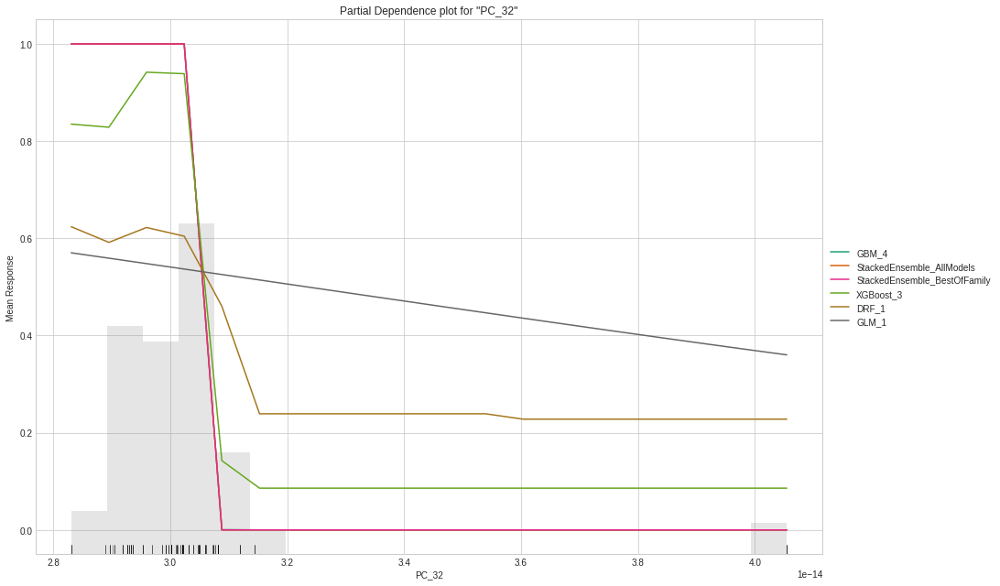

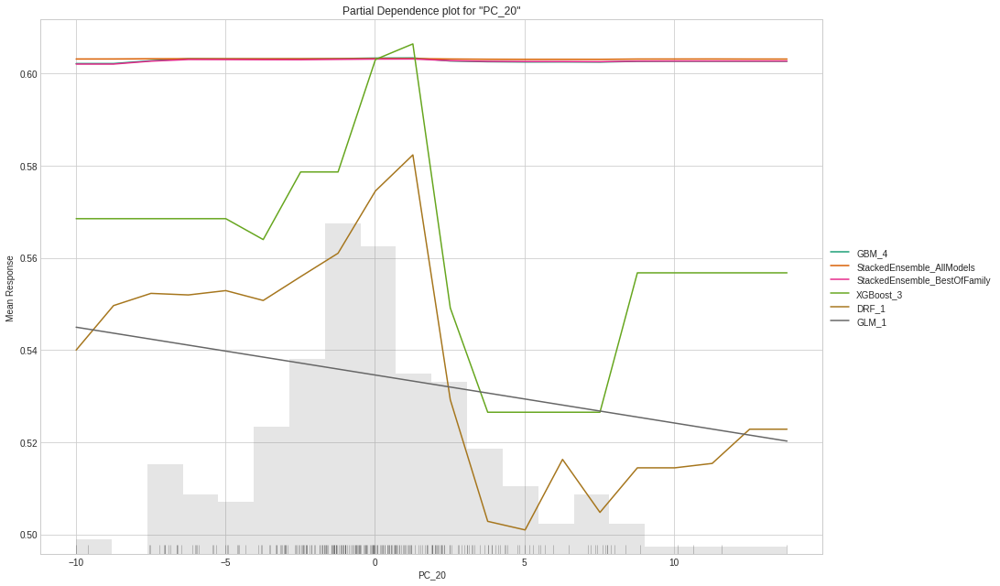

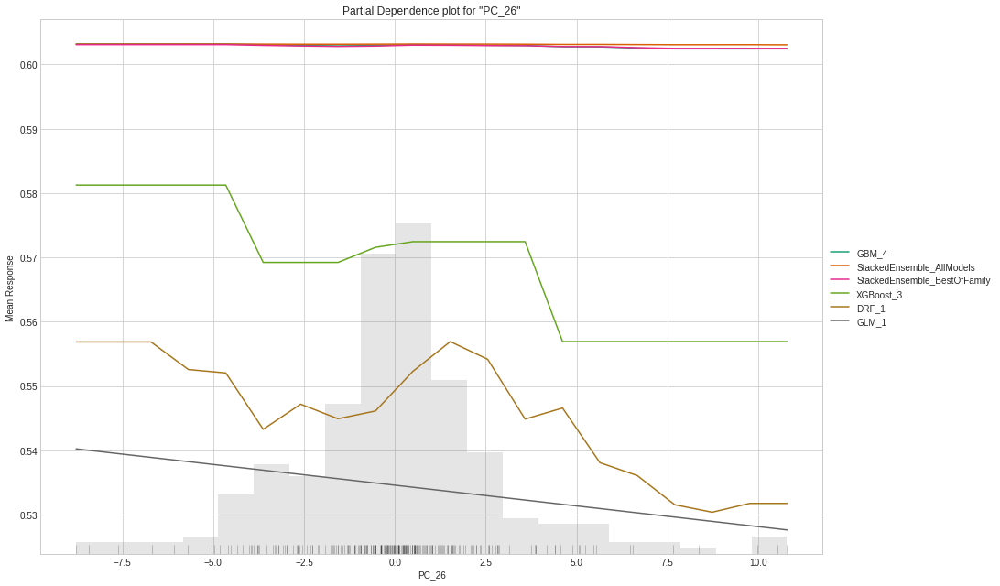

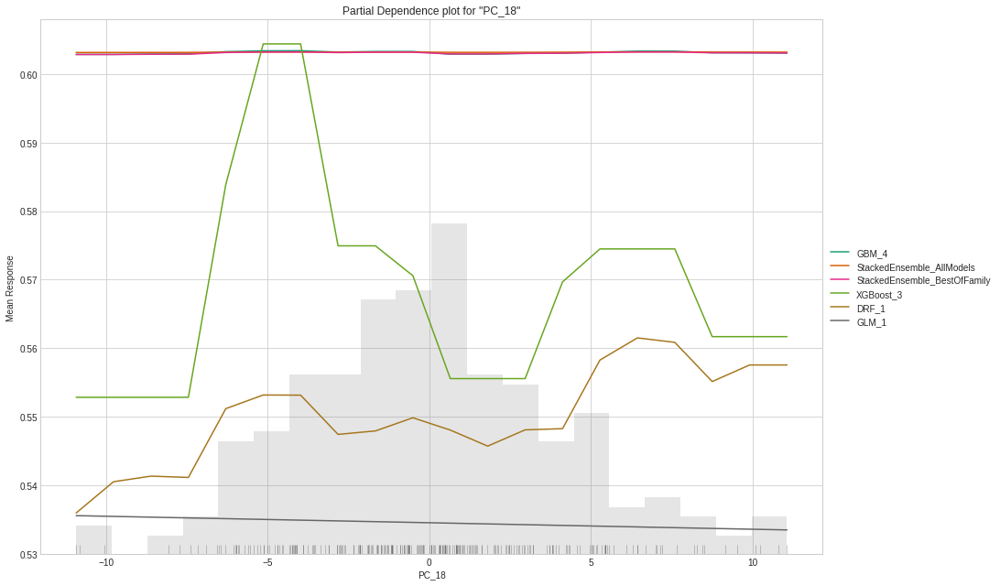

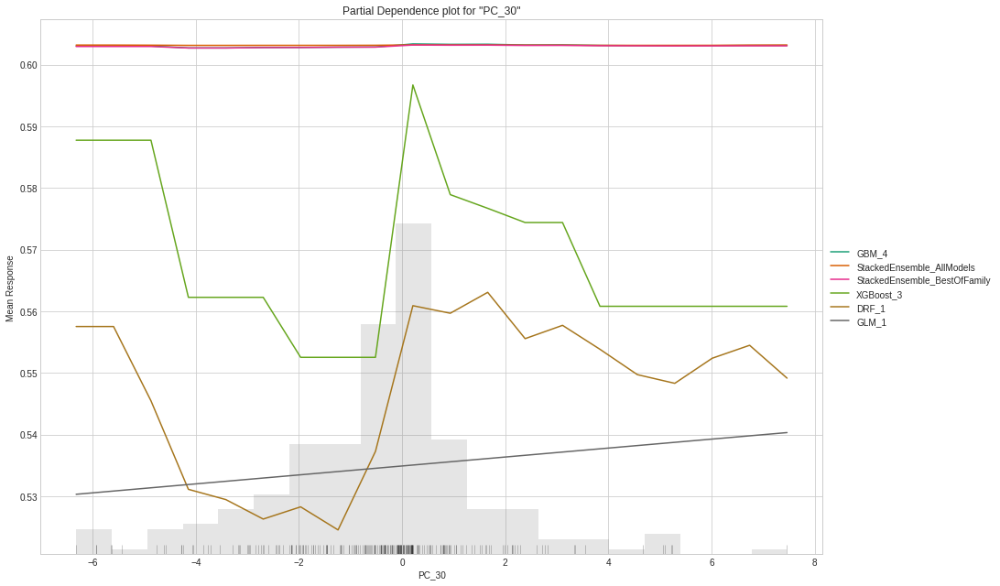



CPU times: user 2min 38s, sys: 10.7 s, total: 2min 48s
Wall time: 12min 9s


In [ ]:
#train subjects
%%time
subjects = 3 #3 subjects - Wall time: 14min 31s
max_models = 10
dim = ["arousal", "valence"]

for subject in range(subjects):
  x = files_list[subject]
  X = prepare_subject(x)

  arousal_array = create_labels(x, dim[0])
  valence_array = create_labels(x, dim[1])

  all_arousal_labels = y_labels(arousal_array)
  all_valence_labels = y_labels(valence_array)


  df_final_arousal, df_final_valence = prepare_sub_data(X, all_arousal_labels, all_valence_labels)

  aml_arousal, train_arousal, test_arousal = train_subject(df_final_arousal, dim[0], max_models)
  aml_valence ,train_valence, test_valence = train_subject(df_final_valence, dim[1], max_models)
  print(f"==== Subject {subject} | Label {dim[0]} ====")
  aml_arousal.explain(test_arousal)
  print(f"==== Subject {subject} | Label {dim[1]} ====")
  aml_valence.explain(test_valence)

In [ ]:
#train subjects Fn
%%time

subjects = 3 #3 subjects - Wall time: 14min 31s
max_models = 10
def train_subjects(subjects, max_models, exclude=None):
  """
  Args: 
    subjects (list) :
    max_models (int) : 
    exclude (list) : Models to exclude from Analysis

  Out:
    No return

  """

  dim = ["arousal", "valence"]

  # for subject in range(subjects):
  for subject in subjects:
    x = files_list[subject]
    X = prepare_subject(x)

    arousal_array = create_labels(x, dim[0])
    valence_array = create_labels(x, dim[1])

    all_arousal_labels = y_labels(arousal_array)
    all_valence_labels = y_labels(valence_array)


    df_final_arousal, df_final_valence = prepare_sub_data(X, all_arousal_labels, all_valence_labels)

   
    

    aml_arousal, train_arousal, test_arousal = train_subject(df_final_arousal, dim[0], max_models, exclude)
    print(f"\n==== Subject {subject} | Label {dim[0].capitalize()} ====\n")
    aml_arousal.explain(test_arousal)
    predict_arousal = aml_arousal.predict(test_arousal)
    print(predict_arousal)
    aml_valence ,train_valence, test_valence = train_subject(df_final_valence, dim[1], max_models, exclude)
    print(f"\n==== Subject {subject} | Label {dim[1].capitalize()} ====\n")
    aml_valence.explain(test_valence)
    predict_valence = aml_valence.predict(test_valence)
    print(predict_valence)

# train_subjects(subjects, max_models)

CPU times: user 5 µs, sys: 1e+03 ns, total: 6 µs
Wall time: 8.58 µs


In [ ]:
# ETA all subjects -> 2:40 hrs

Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:22:20.432: Project: AutoML_20210911_42220420
04:22:20.436: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:22:20.438: Build control seed: 420
04:22:20.442: training frame: Frame key: automl_training_py_4_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267376  checksum: -8569701433379092882
04:22:20.442: validation frame: NULL
04:22:20.442: leaderboard frame: NULL
04:22:20.442: blending frame: NULL
04:22:20.444: response column: arousal
04:22:20.445: fold column: null
04:22:20.446: weights column: null
04:22:20.509: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:22:2

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_2_AutoML_20210911_042220,0.999735,0.0344444,0.999606,0.00602754,0.0856885,0.00734253,3793,0.108775,GBM
GBM_1_AutoML_20210911_042220,0.998214,0.0901616,0.997285,0.0192788,0.14668,0.0215151,3471,0.046884,GBM
XGBoost_3_AutoML_20210911_042220,0.932824,0.337933,0.897496,0.142006,0.326401,0.106538,715,0.012968,XGBoost
XGBoost_1_AutoML_20210911_042220,0.810252,0.518105,0.744632,0.268098,0.417502,0.174308,480,0.012847,XGBoost
XGBoost_2_AutoML_20210911_042220,0.736539,0.59334,0.639798,0.312683,0.450382,0.202844,365,0.010934,XGBoost
DRF_1_AutoML_20210911_042220,0.648281,0.634523,0.582365,0.440127,0.472316,0.223083,1064,0.03187,DRF
GLM_1_AutoML_20210911_042220,0.440123,0.674968,0.354311,0.472311,0.490882,0.240965,187,0.009826,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_2_AutoML_20210911_042220


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9975097360123493: 


,,HA,LA,Error,Rate
0,HA,615.0,0.0,0.0,(0.0/615.0)
1,LA,0.0,607.0,0.0,(0.0/607.0)
2,Total,615.0,607.0,0.0,(0.0/1222.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

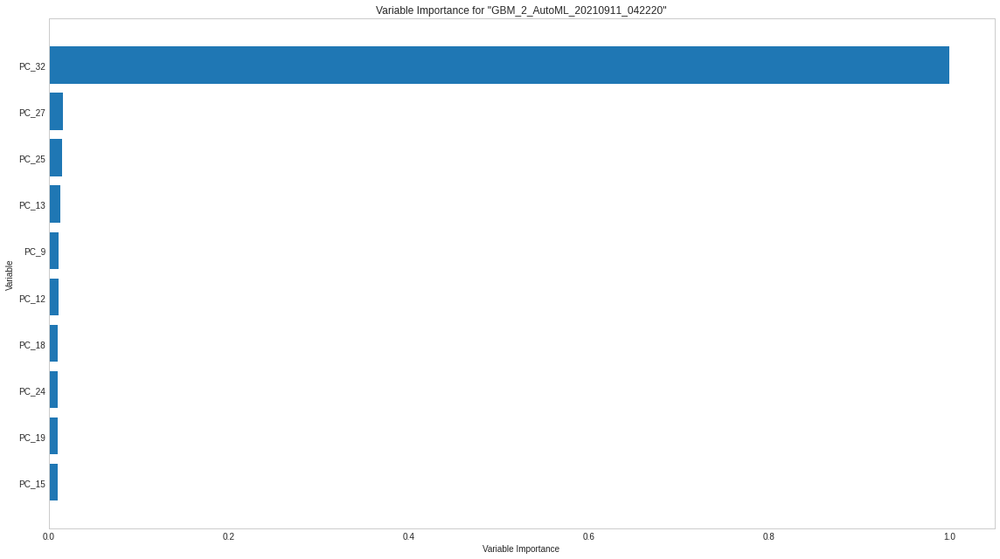

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

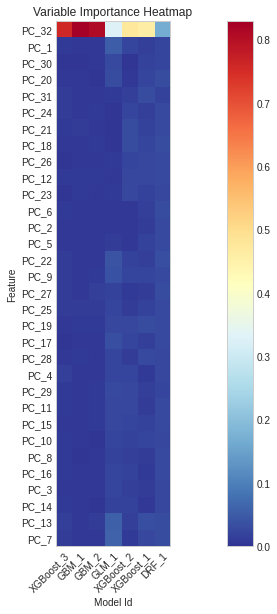

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

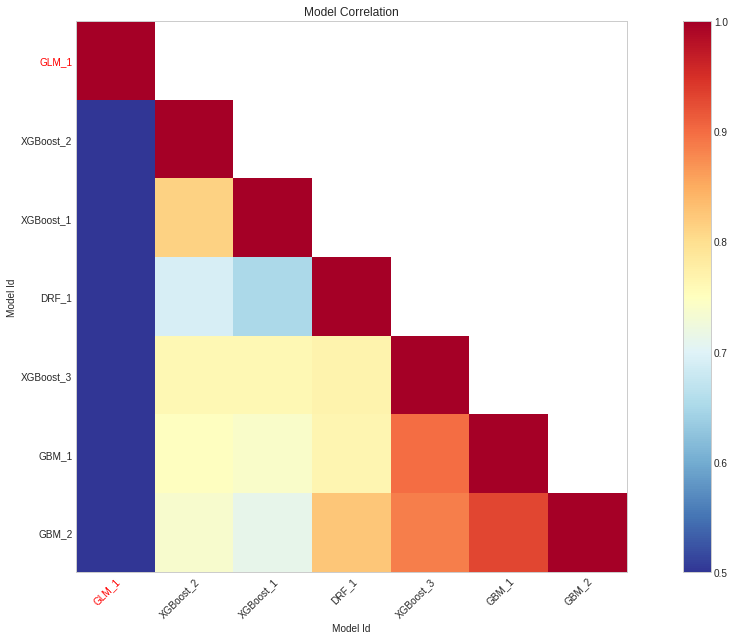

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

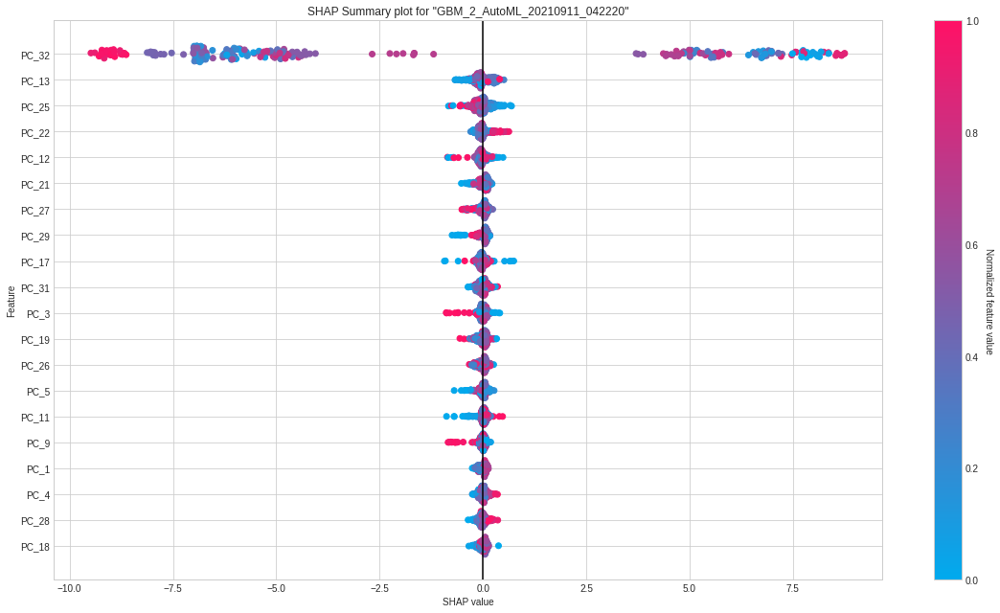

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

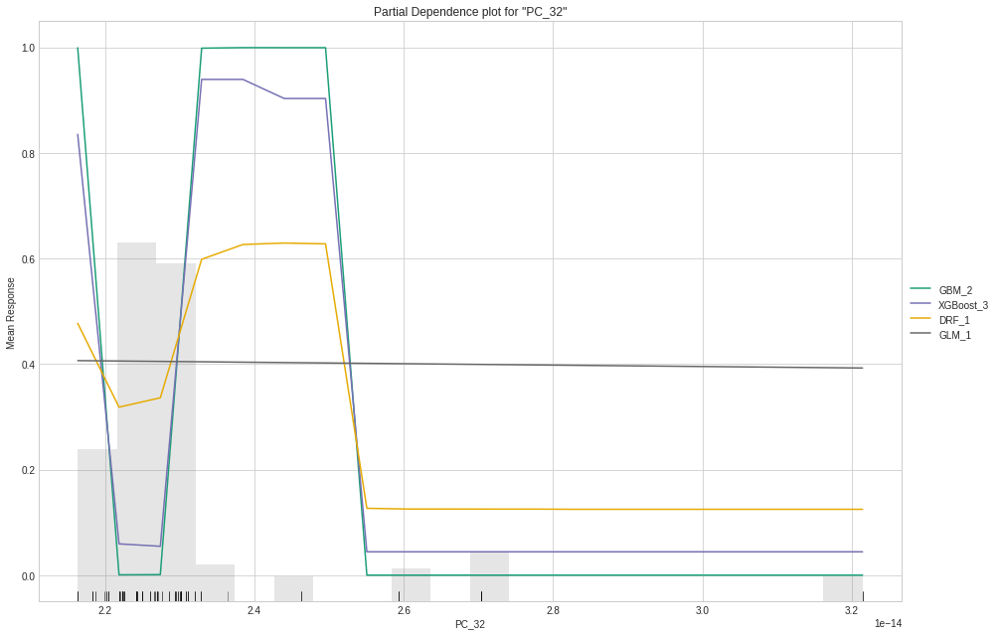

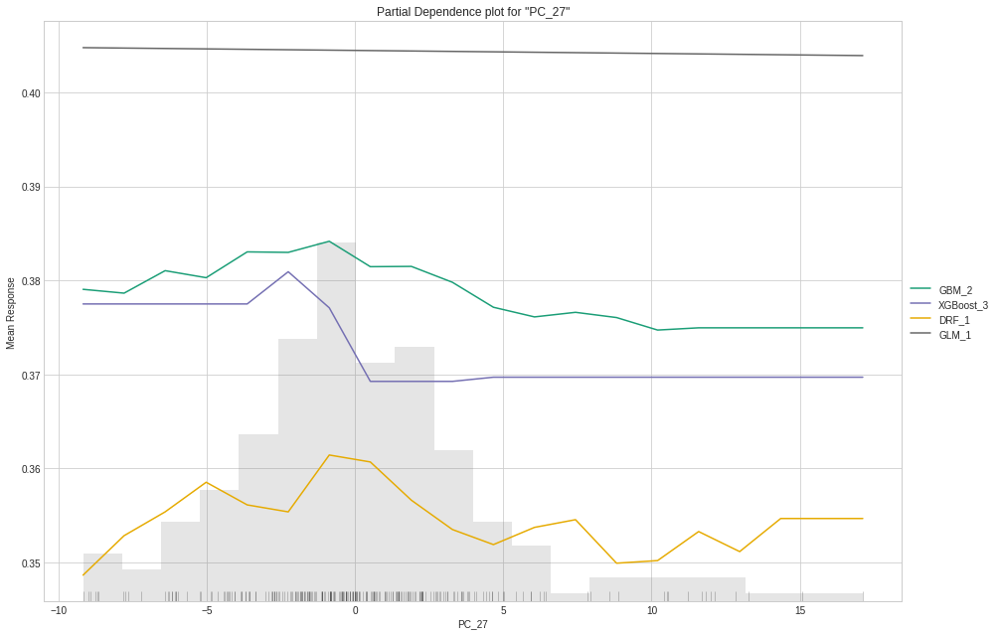

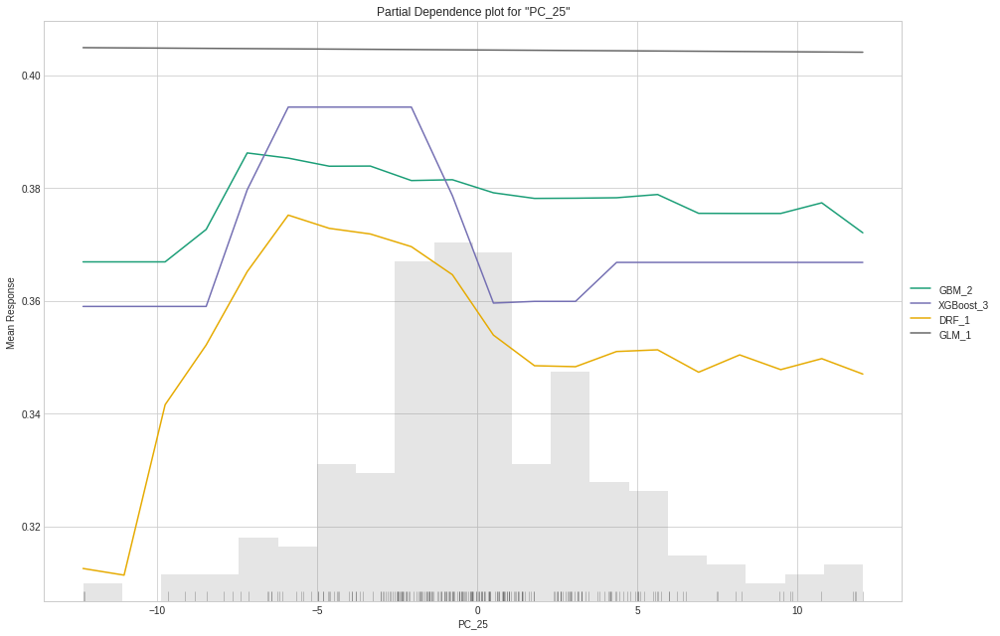

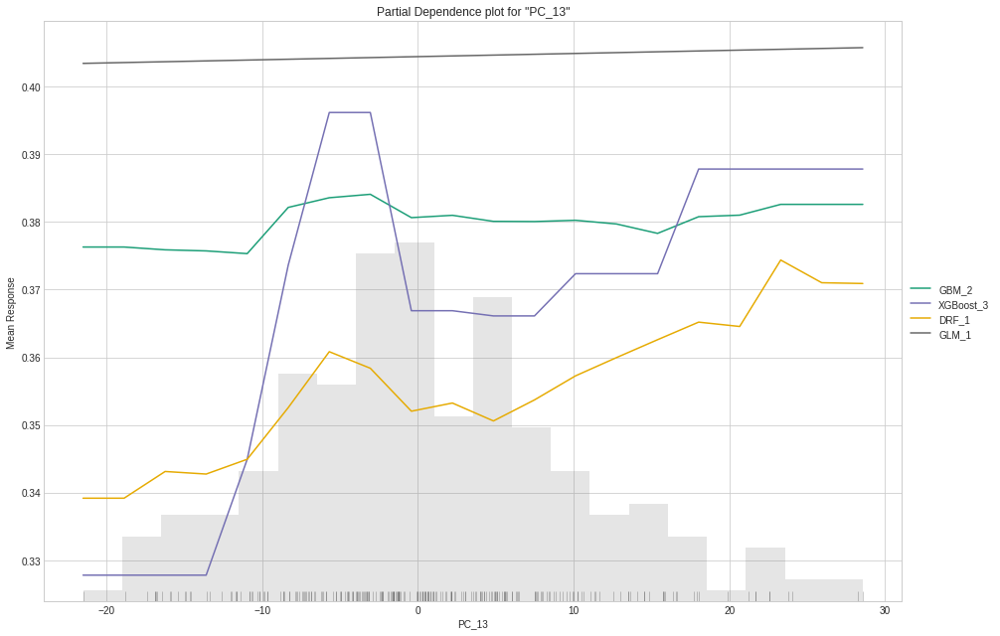

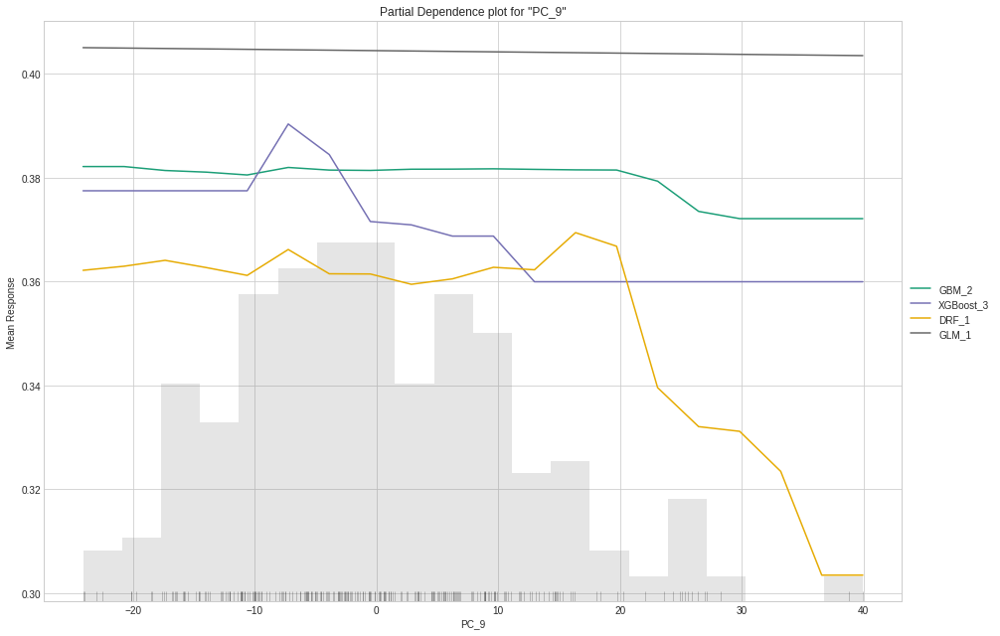



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,HA,LA
HA,0.999965,3.5453e-05
HA,0.999953,4.65498e-05
HA,0.999958,4.16952e-05
HA,0.999922,7.84316e-05
HA,0.999942,5.81394e-05
HA,0.999891,0.000109011
HA,0.999965,3.51568e-05
HA,0.999981,1.86157e-05
HA,0.999879,0.000120825
HA,0.999985,1.49768e-05



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:24:00.566: Project: AutoML_20210911_42400566
04:24:00.567: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:24:00.567: Build control seed: 420
04:24:00.567: training frame: Frame key: automl_training_py_139_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -7993497005368322580
04:24:00.567: validation frame: NULL
04:24:00.567: leaderboard frame: NULL
04:24:00.567: blending frame: NULL
04:24:00.567: response column: valence
04:24:00.567: fold column: null
04:24:00.568: weights column: null
04:24:00.568: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:2

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_2_AutoML_20210911_042400,0.996771,0.0819694,0.996431,0.0307444,0.156882,0.0246119,1761,0.05002,GBM
GBM_1_AutoML_20210911_042400,0.99676,0.0930413,0.99643,0.0299399,0.157995,0.0249623,1895,0.038012,GBM
XGBoost_3_AutoML_20210911_042400,0.979565,0.218357,0.977966,0.0798016,0.249002,0.0620018,476,0.013121,XGBoost
XGBoost_1_AutoML_20210911_042400,0.907077,0.392348,0.896087,0.169024,0.353406,0.124896,679,0.009344,XGBoost
XGBoost_2_AutoML_20210911_042400,0.840511,0.493603,0.825101,0.247126,0.403833,0.163081,1015,0.009204,XGBoost
DRF_1_AutoML_20210911_042400,0.789141,0.555149,0.826402,0.255131,0.430179,0.185054,785,0.019759,DRF
GLM_1_AutoML_20210911_042400,0.412139,0.691962,0.48973,0.499081,0.499407,0.249407,141,0.012314,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_2_AutoML_20210911_042400


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9375916721072783: 


,,NV,PV,Error,Rate
0,NV,544.0,0.0,0.0,(0.0/544.0)
1,PV,0.0,553.0,0.0,(0.0/553.0)
2,Total,544.0,553.0,0.0,(0.0/1097.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

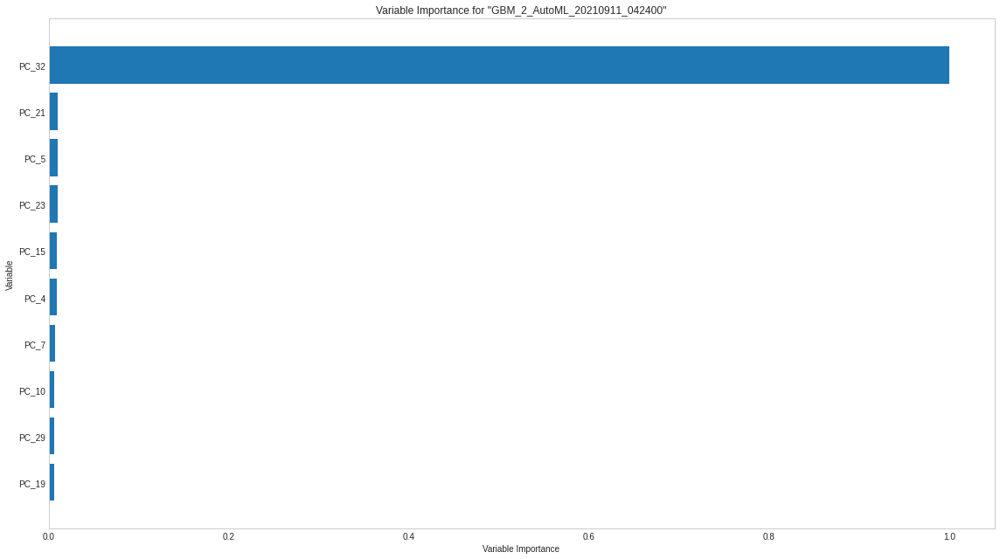

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

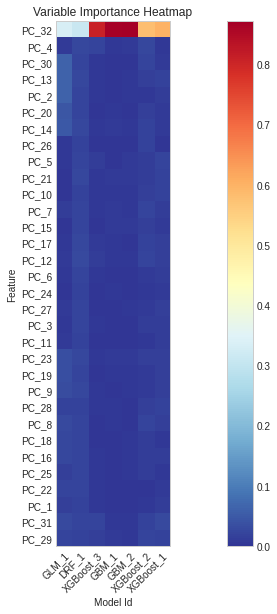

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

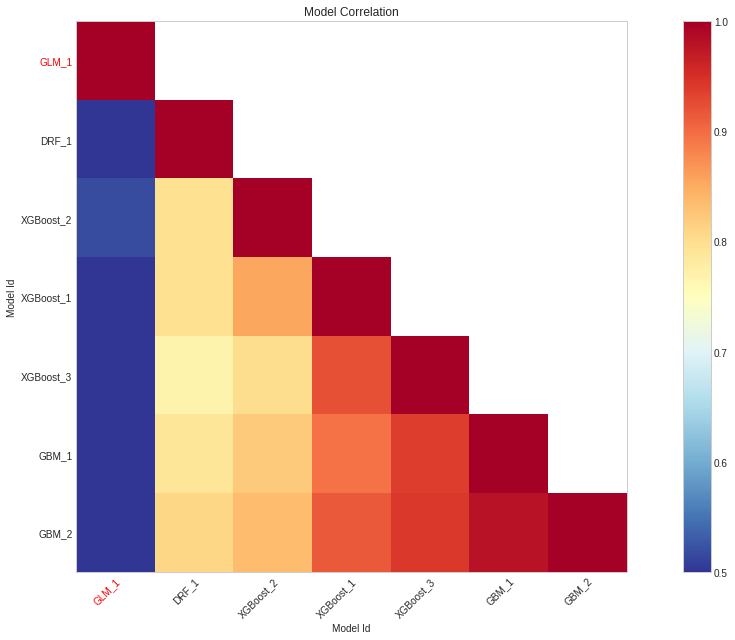

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

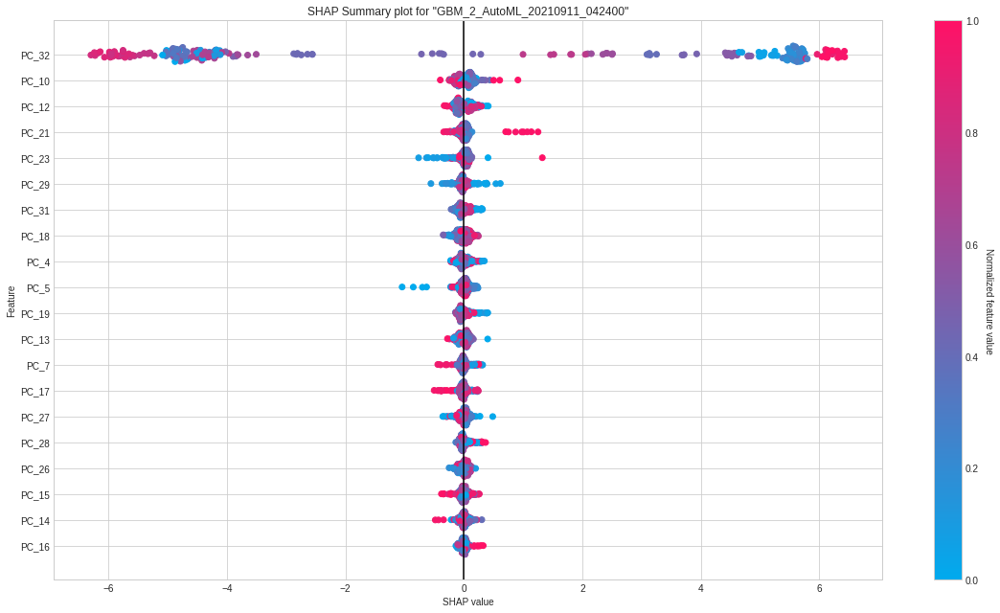

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

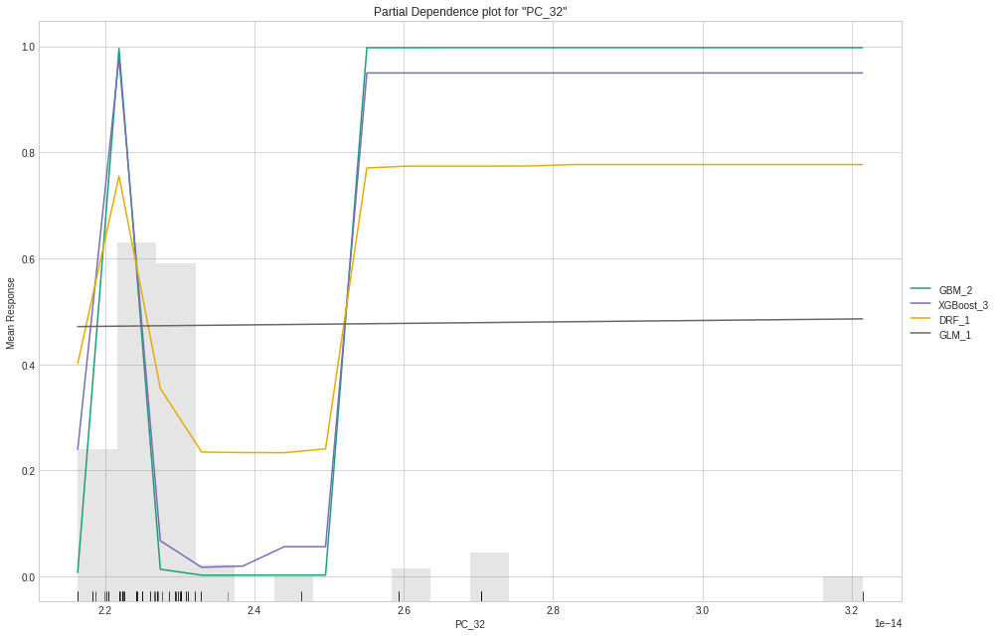

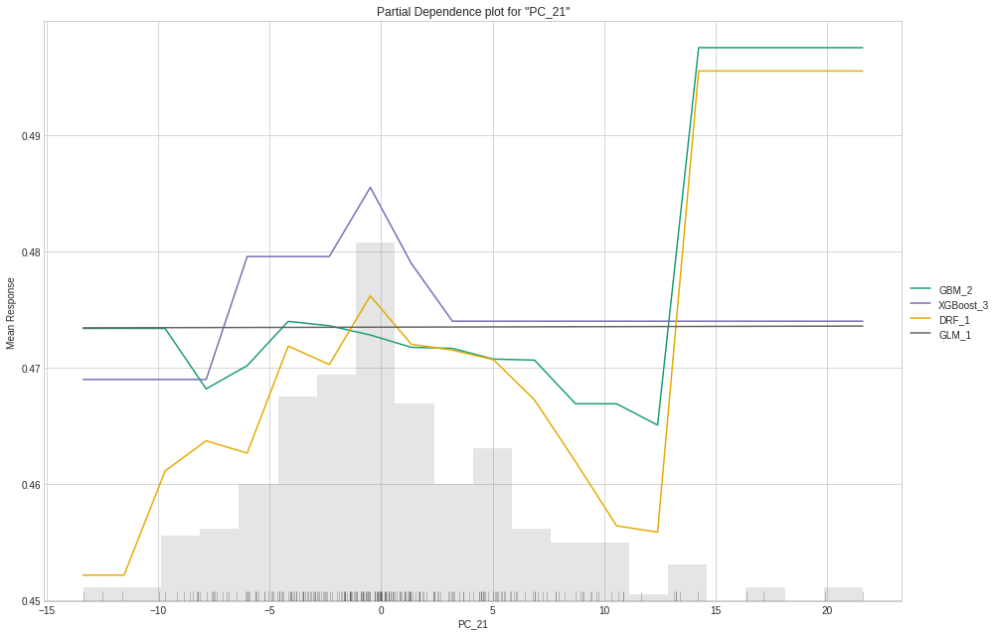

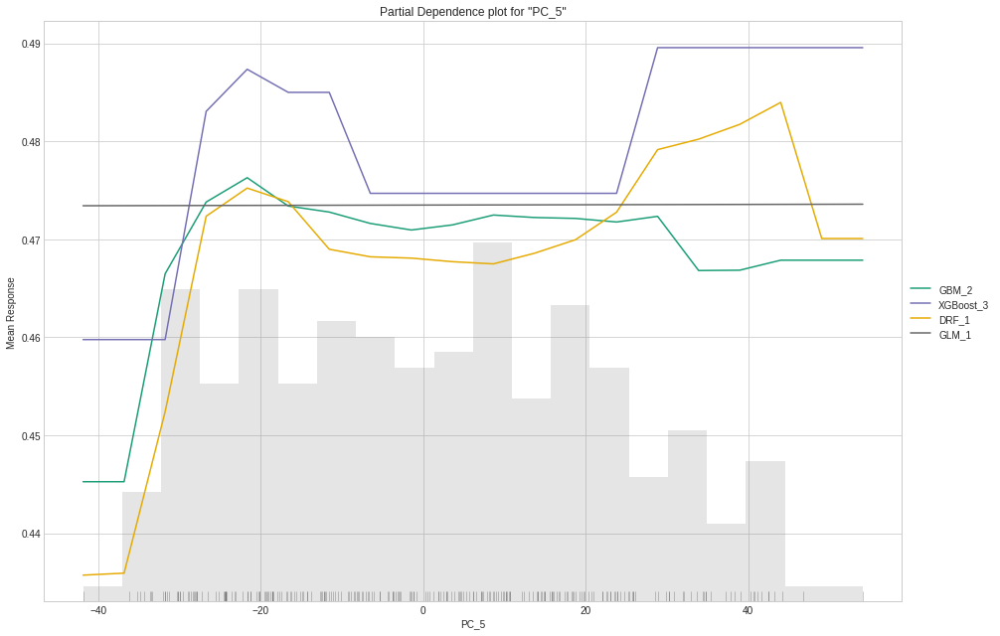

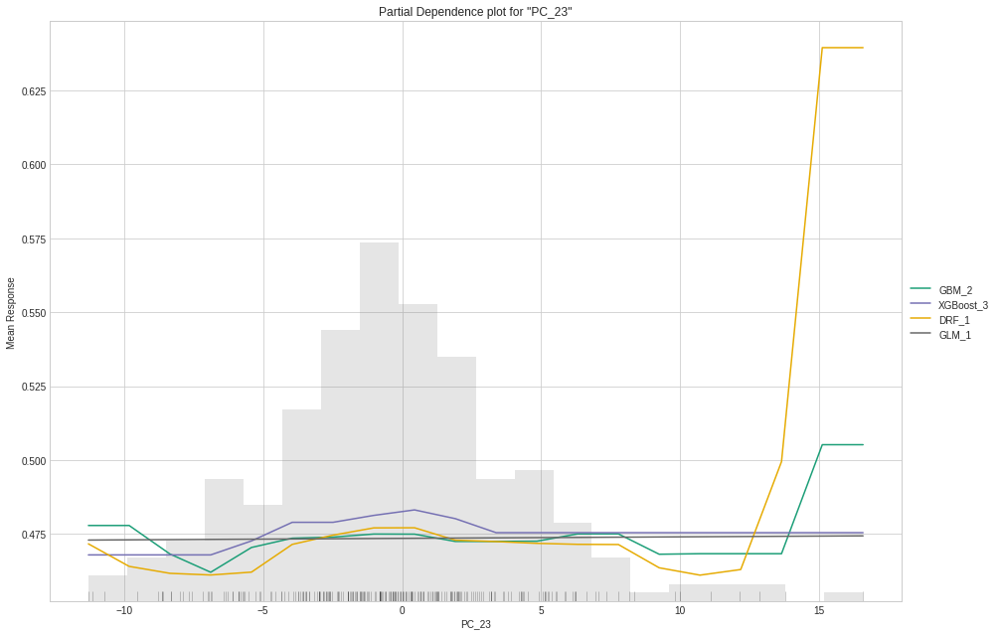

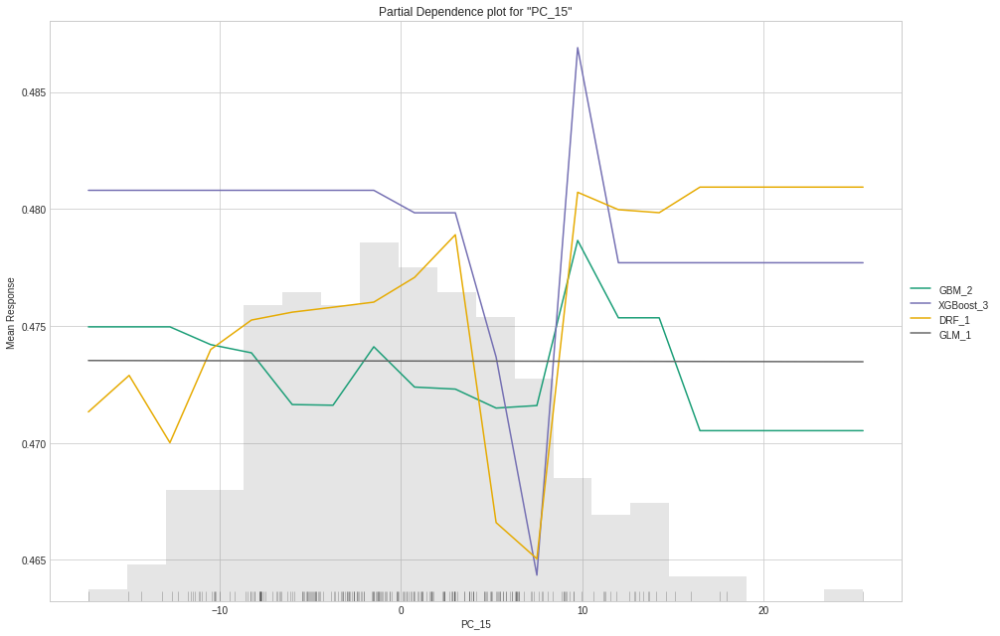



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,NV,PV
PV,0.00204213,0.997958
PV,0.00264075,0.997359
PV,0.00576642,0.994234
PV,0.00171809,0.998282
PV,0.00119389,0.998806
PV,0.00307386,0.996926
PV,0.00211131,0.997889
PV,0.00121791,0.998782
PV,0.00203995,0.99796
PV,0.0024225,0.997577



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:25:07.825: Project: AutoML_20210911_42507824
04:25:07.825: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:25:07.825: Build control seed: 420
04:25:07.826: training frame: Frame key: automl_training_py_262_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -7129540488822410997
04:25:07.826: validation frame: NULL
04:25:07.826: leaderboard frame: NULL
04:25:07.826: blending frame: NULL
04:25:07.826: response column: arousal
04:25:07.826: fold column: null
04:25:07.826: weights column: null
04:25:07.826: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:2

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_1_AutoML_20210911_042507,0.999787,0.0506059,0.999685,0.00490998,0.103043,0.0106179,3012,0.064646,GBM
GBM_2_AutoML_20210911_042507,0.999298,0.0489759,0.999011,0.011286,0.113412,0.0128622,2908,0.053951,GBM
XGBoost_3_AutoML_20210911_042507,0.960792,0.271247,0.942696,0.112996,0.287644,0.0827392,896,0.008433,XGBoost
XGBoost_1_AutoML_20210911_042507,0.897899,0.398428,0.851317,0.186118,0.361348,0.130572,774,0.008164,XGBoost
XGBoost_2_AutoML_20210911_042507,0.81594,0.508018,0.767223,0.256595,0.415513,0.172651,329,0.006791,XGBoost
DRF_1_AutoML_20210911_042507,0.719272,0.588757,0.592329,0.351456,0.455981,0.207919,597,0.01777,DRF
GLM_1_AutoML_20210911_042507,0.583059,0.670329,0.430364,0.41253,0.488746,0.238872,179,0.009177,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_1_AutoML_20210911_042507


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9533623536084207: 


,,HA,LA,Error,Rate
0,HA,611.0,0.0,0.0,(0.0/611.0)
1,LA,0.0,611.0,0.0,(0.0/611.0)
2,Total,611.0,611.0,0.0,(0.0/1222.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

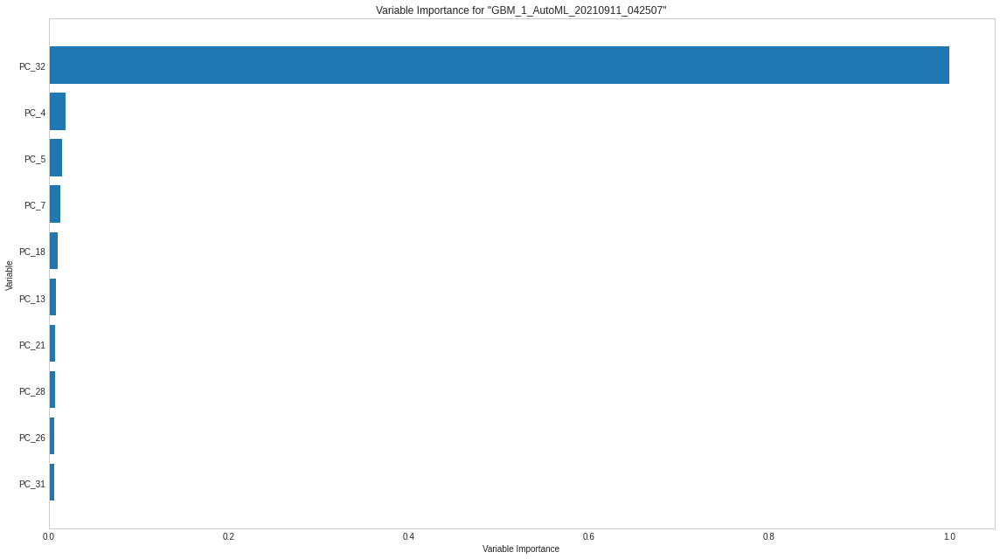

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

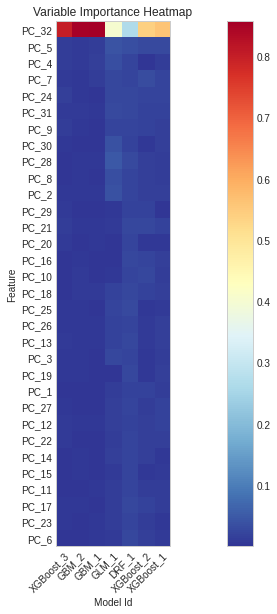

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

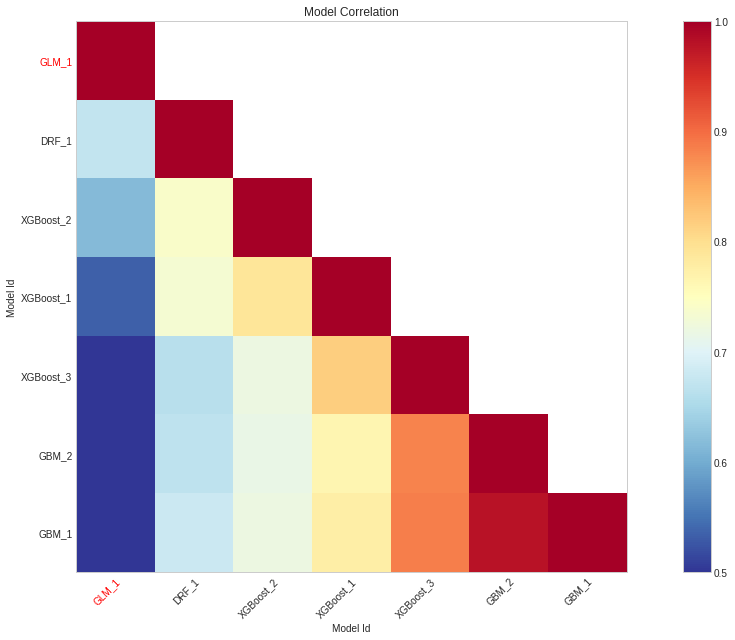

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

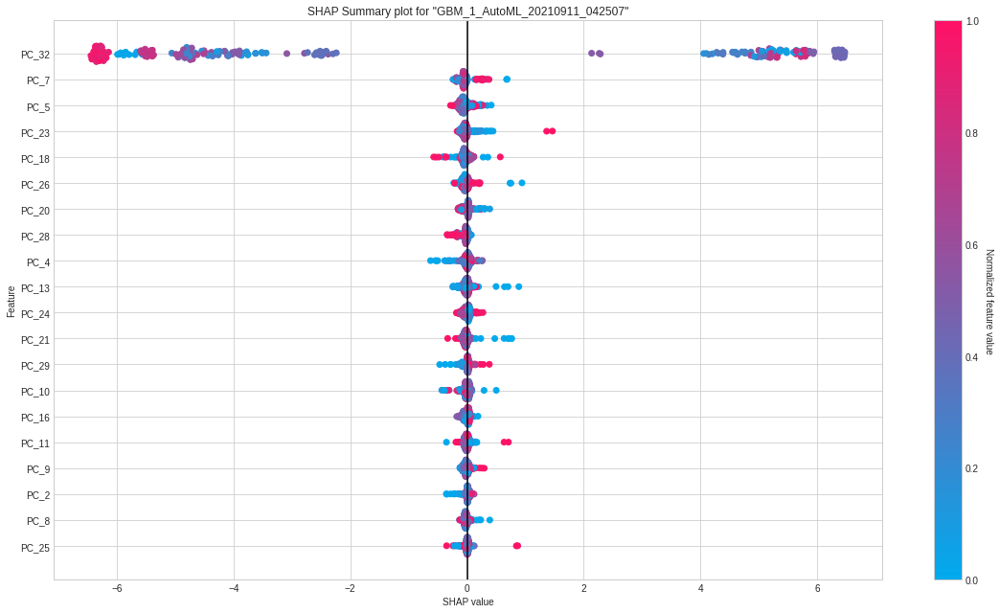

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

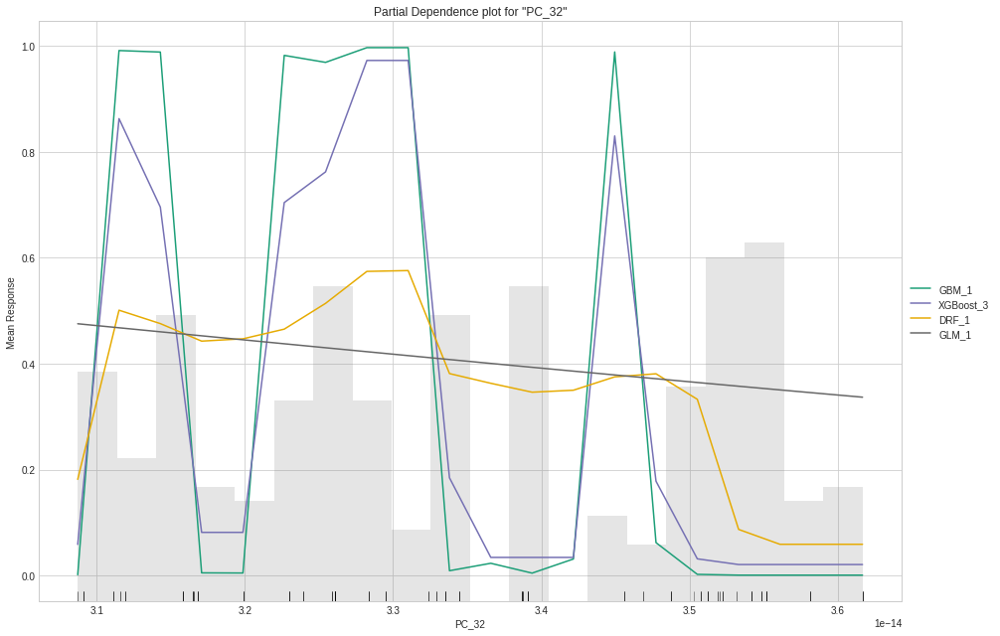

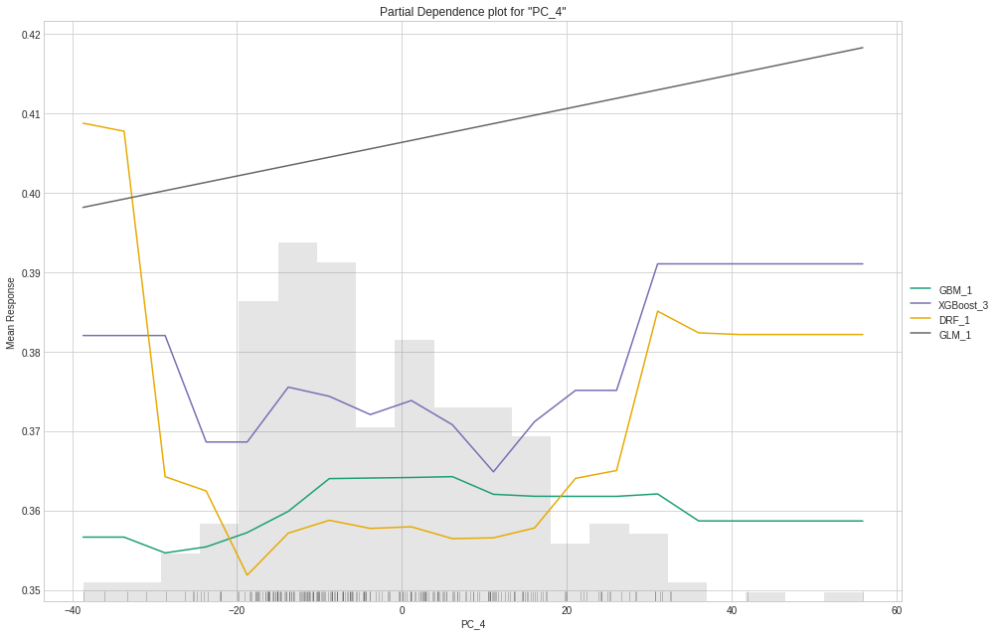

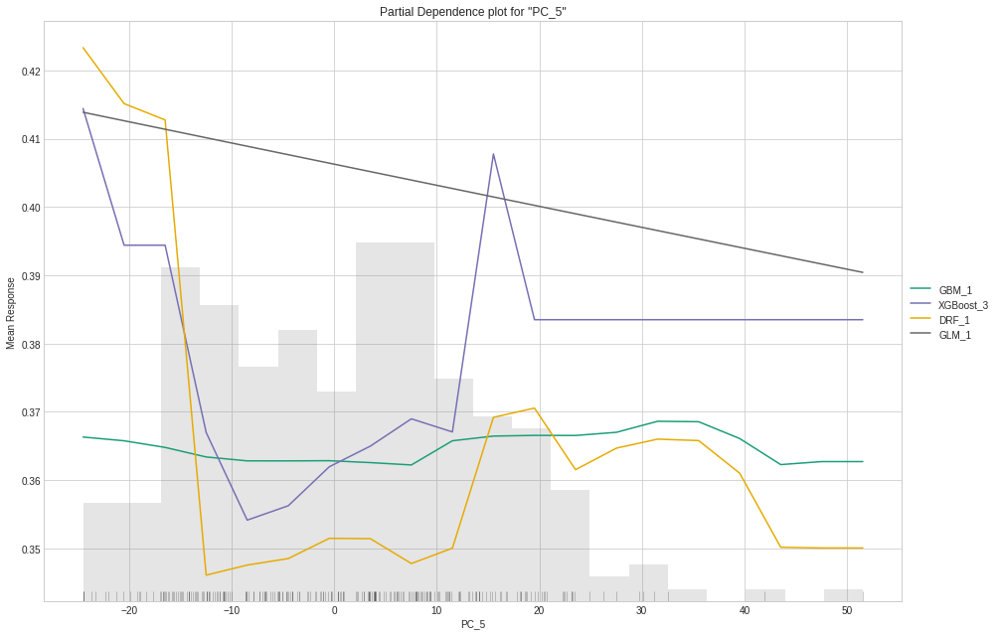

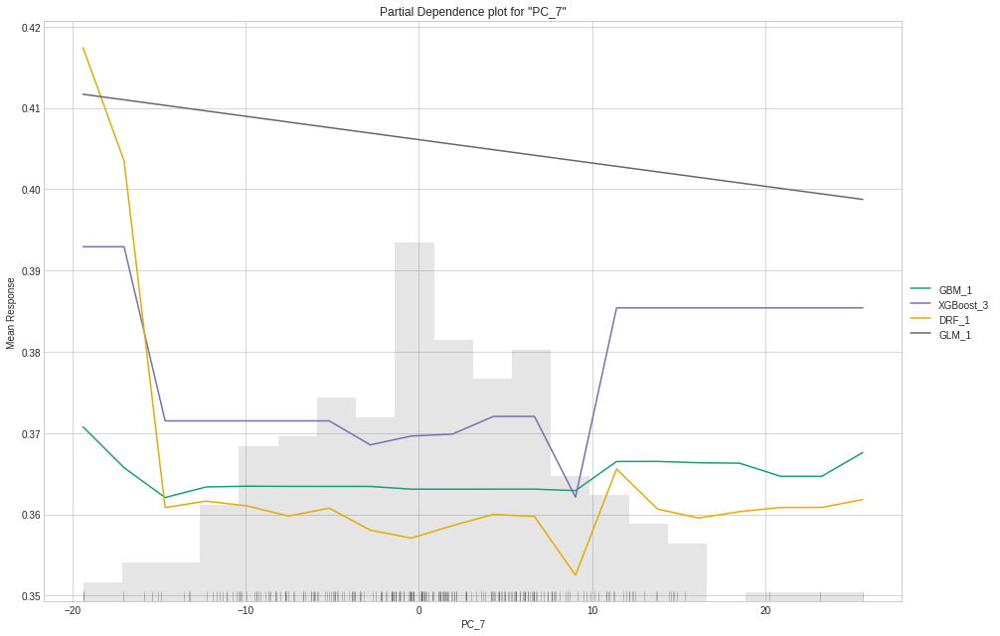

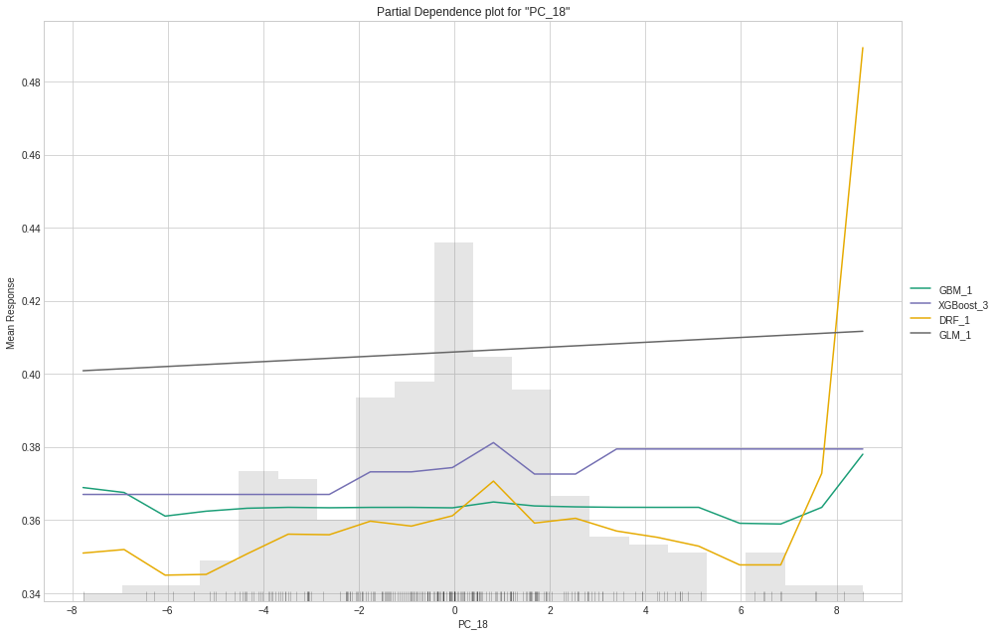



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,HA,LA
HA,0.996952,0.00304843
HA,0.97773,0.02227
HA,0.997229,0.00277053
HA,0.984084,0.0159162
HA,0.995204,0.00479647
HA,0.981183,0.0188172
HA,0.988672,0.0113277
HA,0.995871,0.00412902
HA,0.972686,0.0273136
HA,0.969395,0.0306046



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:26:19.515: Project: AutoML_20210911_42619515
04:26:19.516: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:26:19.516: Build control seed: 420
04:26:19.516: training frame: Frame key: automl_training_py_384_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: 6421991642591212286
04:26:19.516: validation frame: NULL
04:26:19.516: leaderboard frame: NULL
04:26:19.516: blending frame: NULL
04:26:19.516: response column: valence
04:26:19.516: fold column: null
04:26:19.516: weights column: null
04:26:19.516: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:26

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_1_AutoML_20210911_042619,0.997092,0.115075,0.997601,0.0270374,0.16861,0.0284292,1893,0.058698,GBM
GBM_2_AutoML_20210911_042619,0.996243,0.09838,0.996858,0.0307077,0.164255,0.0269798,2152,0.046282,GBM
XGBoost_3_AutoML_20210911_042619,0.956817,0.295852,0.965728,0.113886,0.297741,0.0886496,867,0.010018,XGBoost
XGBoost_1_AutoML_20210911_042619,0.779334,0.569844,0.783507,0.300552,0.437536,0.191437,186,0.01351,XGBoost
XGBoost_2_AutoML_20210911_042619,0.734009,0.614781,0.748587,0.339008,0.458158,0.209909,257,0.010182,XGBoost
DRF_1_AutoML_20210911_042619,0.733945,0.605955,0.73831,0.352283,0.456512,0.208403,588,0.020305,DRF
GLM_1_AutoML_20210911_042619,0.652144,0.655983,0.637007,0.376618,0.481023,0.231383,240,0.006599,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_1_AutoML_20210911_042619


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.8643533889445721: 


,,NV,PV,Error,Rate
0,NV,568.0,0.0,0.0,(0.0/568.0)
1,PV,0.0,559.0,0.0,(0.0/559.0)
2,Total,568.0,559.0,0.0,(0.0/1127.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

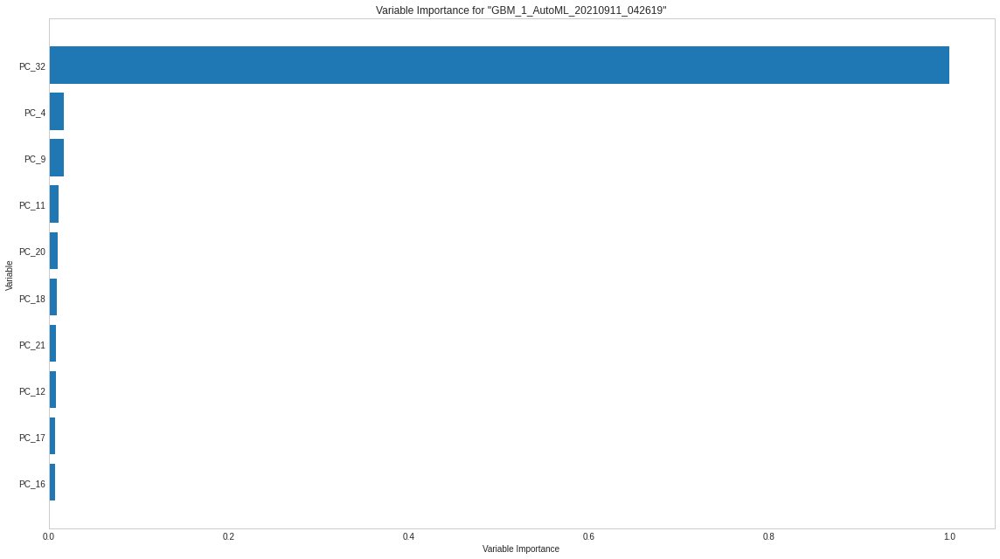

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

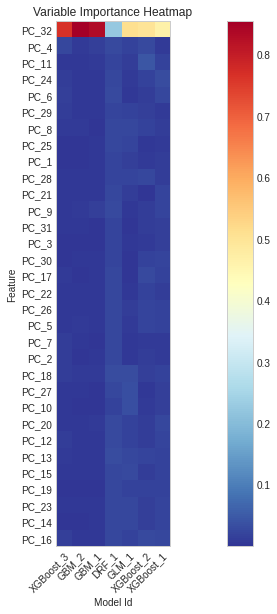

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

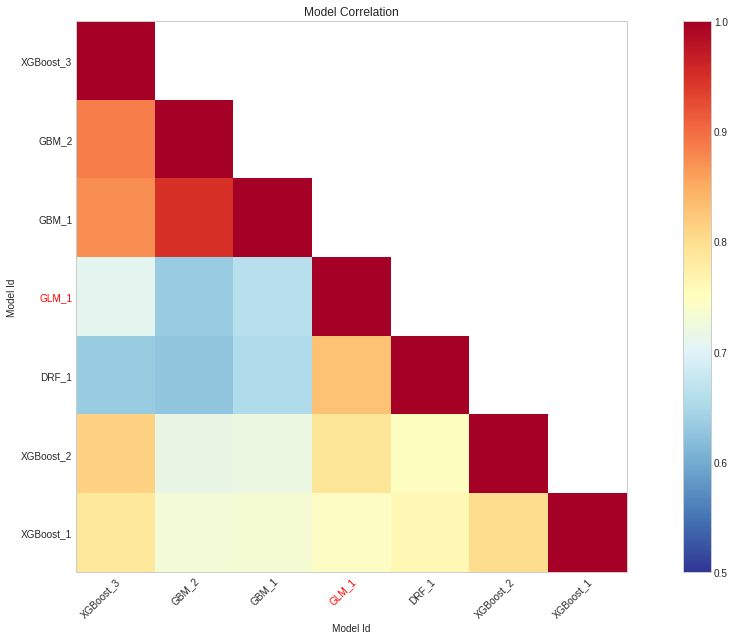

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

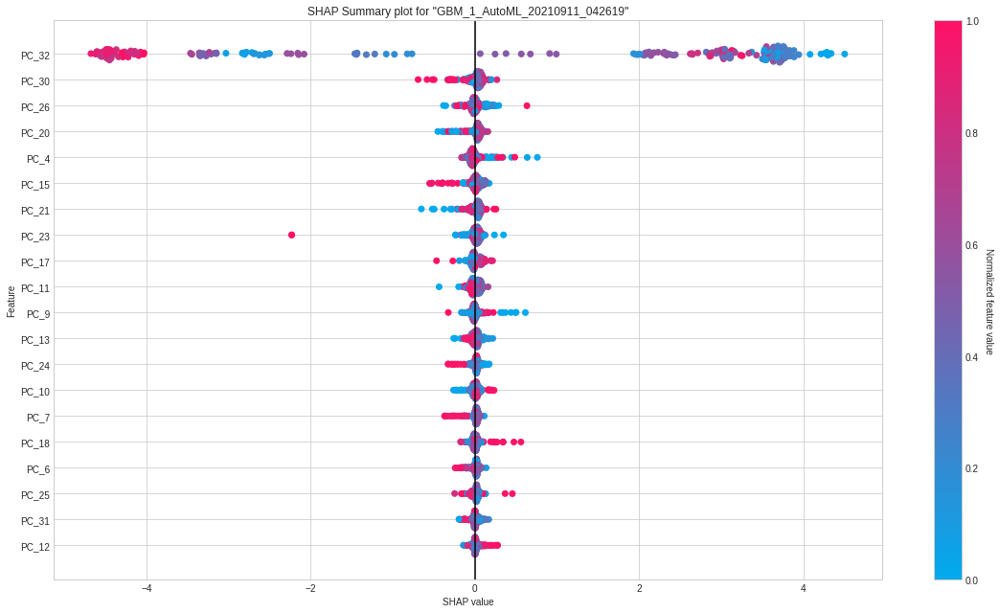

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

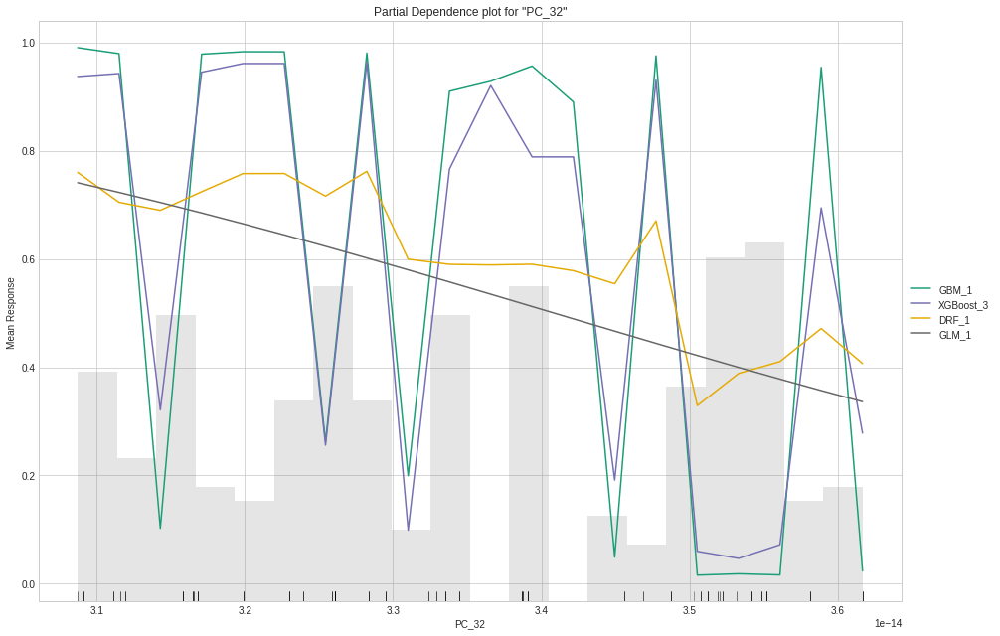

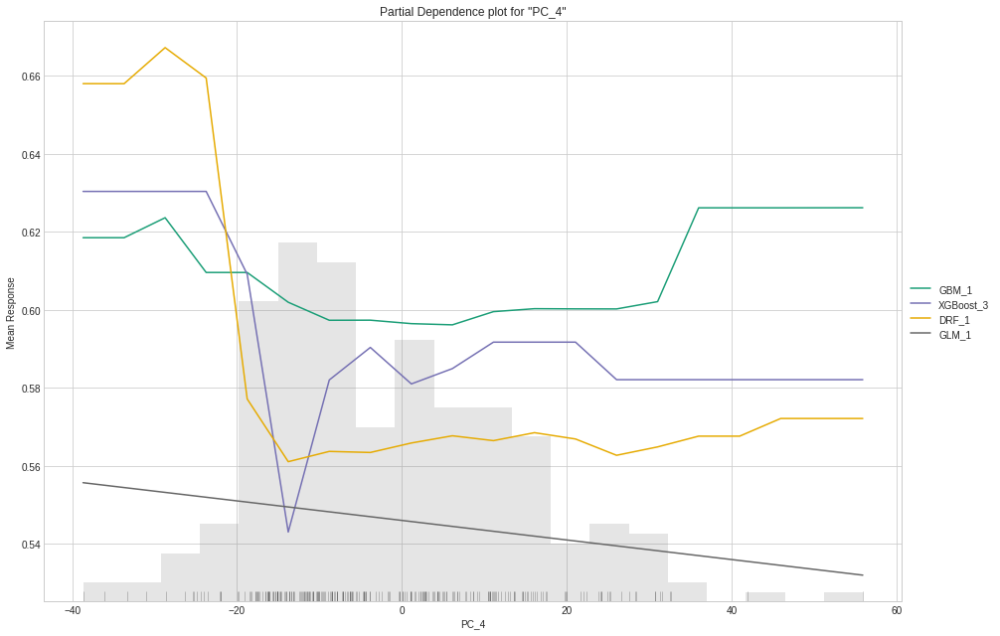

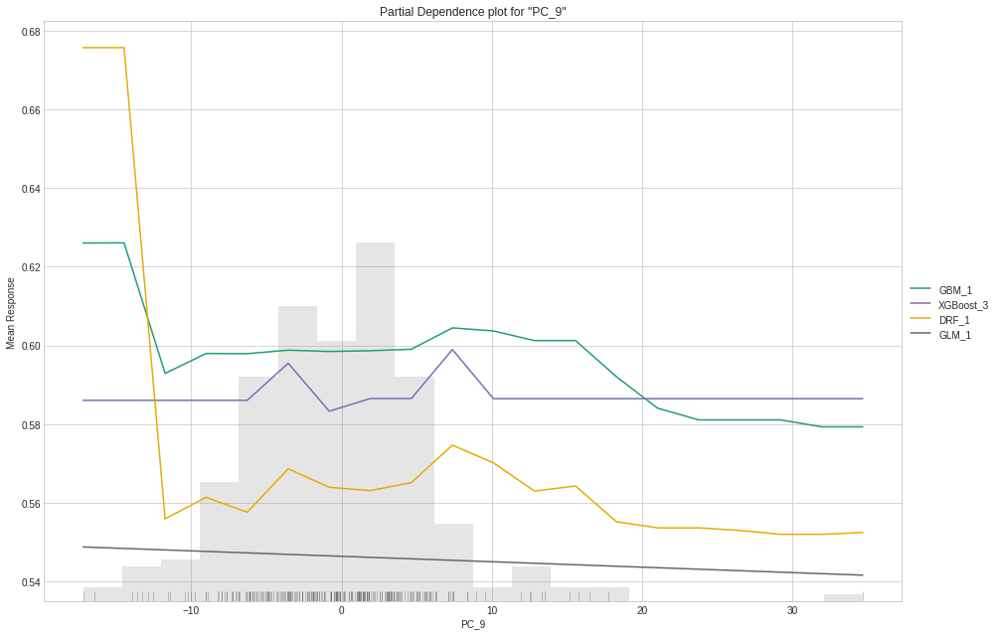

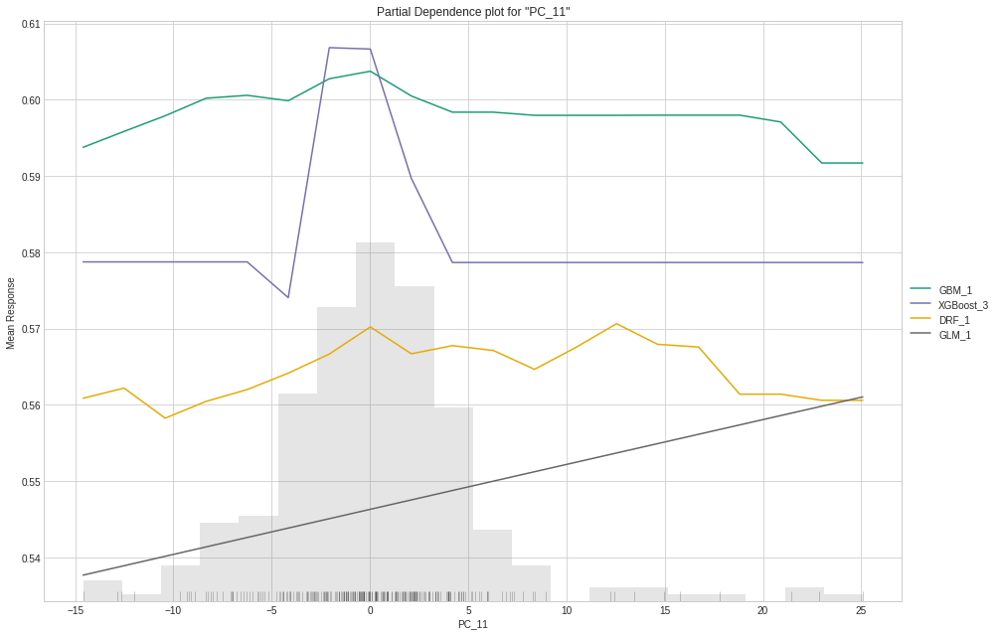

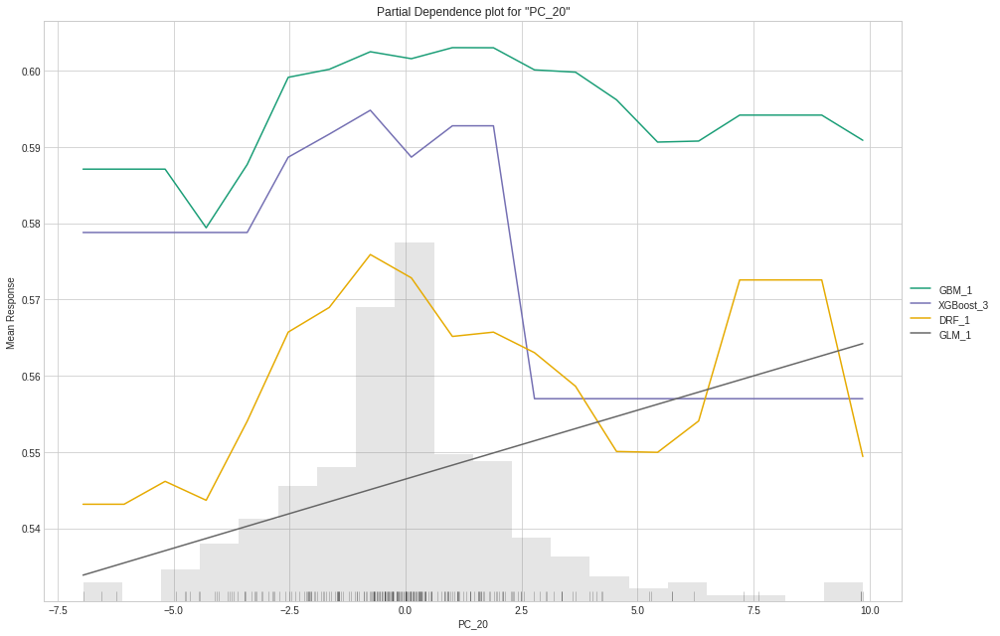



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,NV,PV
PV,0.011773,0.988227
PV,0.0147661,0.985234
PV,0.0143553,0.985645
PV,0.0073814,0.992619
PV,0.0190442,0.980956
PV,0.016525,0.983475
PV,0.0364033,0.963597
PV,0.0168514,0.983149
PV,0.0253434,0.974657
PV,0.0381343,0.961866



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:27:25.214: Project: AutoML_20210911_42725214
04:27:25.215: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:27:25.215: Build control seed: 420
04:27:25.215: training frame: Frame key: automl_training_py_501_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267376  checksum: -6393927612194368767
04:27:25.215: validation frame: NULL
04:27:25.215: leaderboard frame: NULL
04:27:25.215: blending frame: NULL
04:27:25.215: response column: arousal
04:27:25.215: fold column: null
04:27:25.215: weights column: null
04:27:25.215: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:2

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_2_AutoML_20210911_042725,1,4.42932e-09,1,0,1.03857e-07,1.07862e-14,9689,0.262437,GBM
GBM_1_AutoML_20210911_042725,1,1.09806e-07,1,0,2.97912e-06,8.87516e-12,10333,0.247999,GBM
XGBoost_3_AutoML_20210911_042725,0.991207,0.140899,0.99786,0.0454676,0.200363,0.0401451,544,0.010201,XGBoost
XGBoost_1_AutoML_20210911_042725,0.947072,0.264107,0.986809,0.153092,0.289908,0.0840464,289,0.009828,XGBoost
DRF_1_AutoML_20210911_042725,0.820577,0.472946,0.937991,0.472844,0.393004,0.154452,940,0.020741,DRF
XGBoost_2_AutoML_20210911_042725,0.808414,0.401963,0.936638,0.357782,0.357163,0.127566,214,0.011495,XGBoost
GLM_1_AutoML_20210911_042725,0.313047,0.507668,0.724561,0.5,0.403731,0.162999,28,0.006969,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_2_AutoML_20210911_042725


Confusion Matrix (Act/Pred) for max f1 @ threshold = 1.0: 


,,HA,LA,Error,Rate
0,HA,821.0,0.0,0.0,(0.0/821.0)
1,LA,0.0,822.0,0.0,(0.0/822.0)
2,Total,821.0,822.0,0.0,(0.0/1643.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

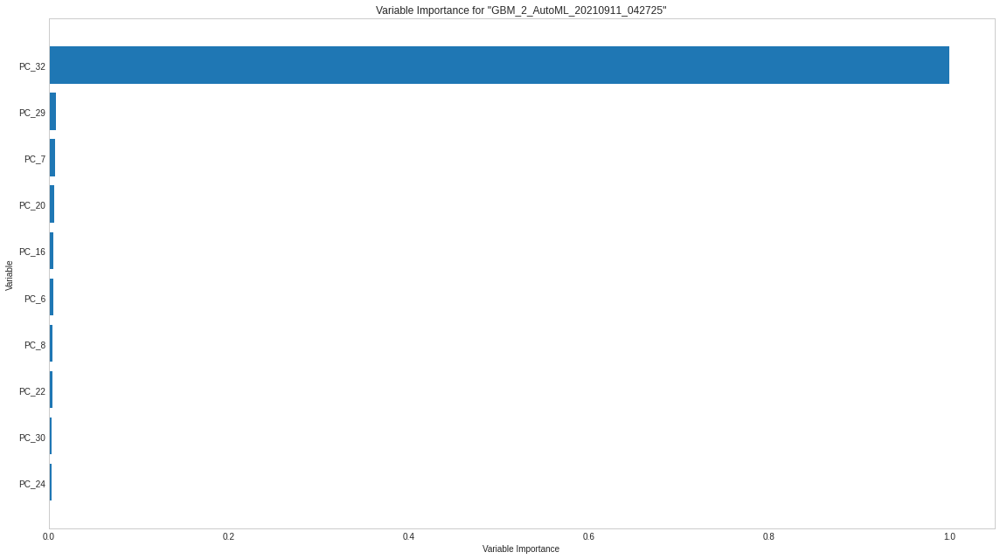

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

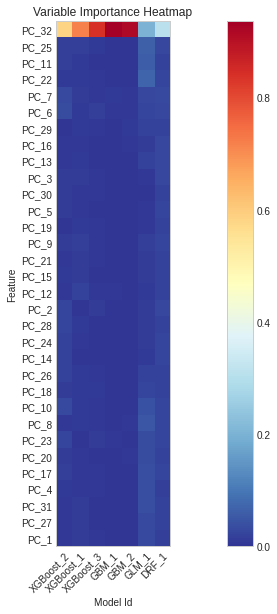

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

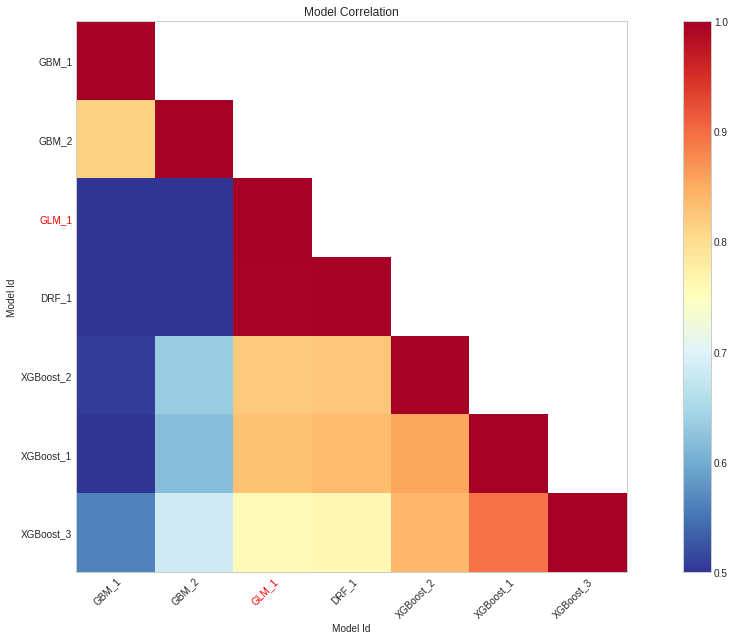

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

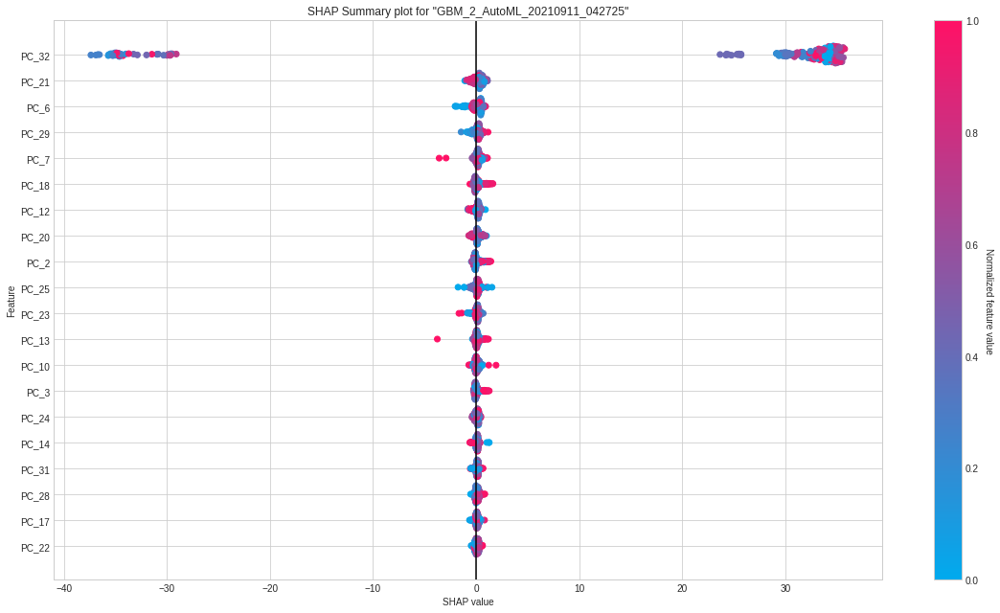

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

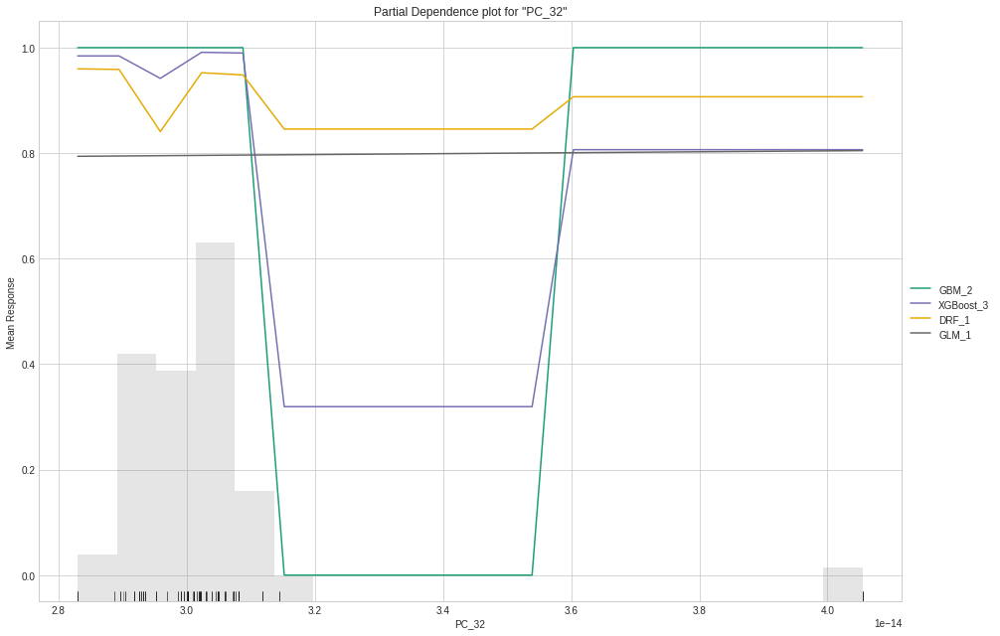

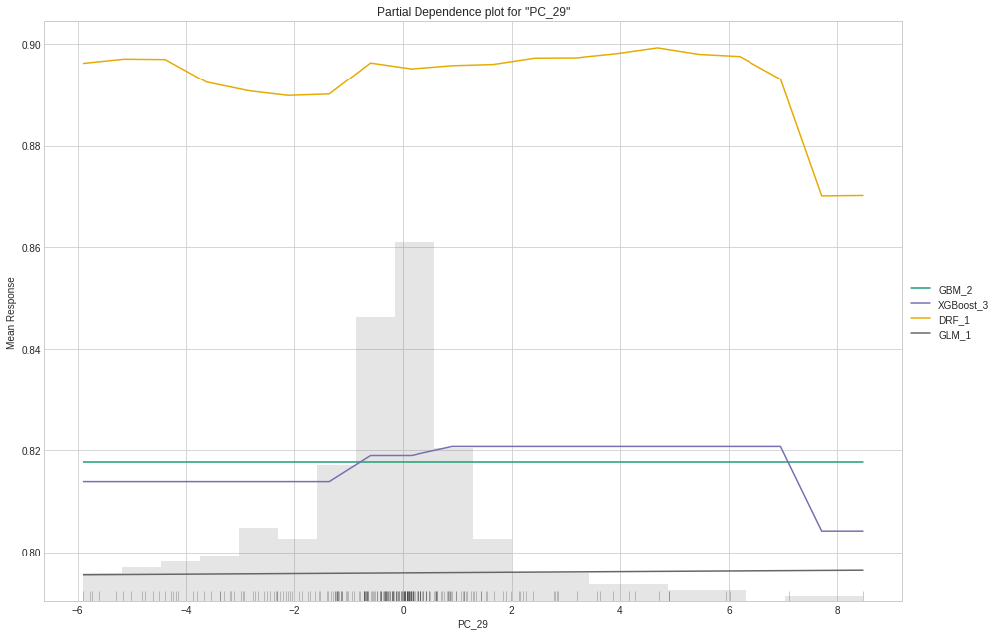

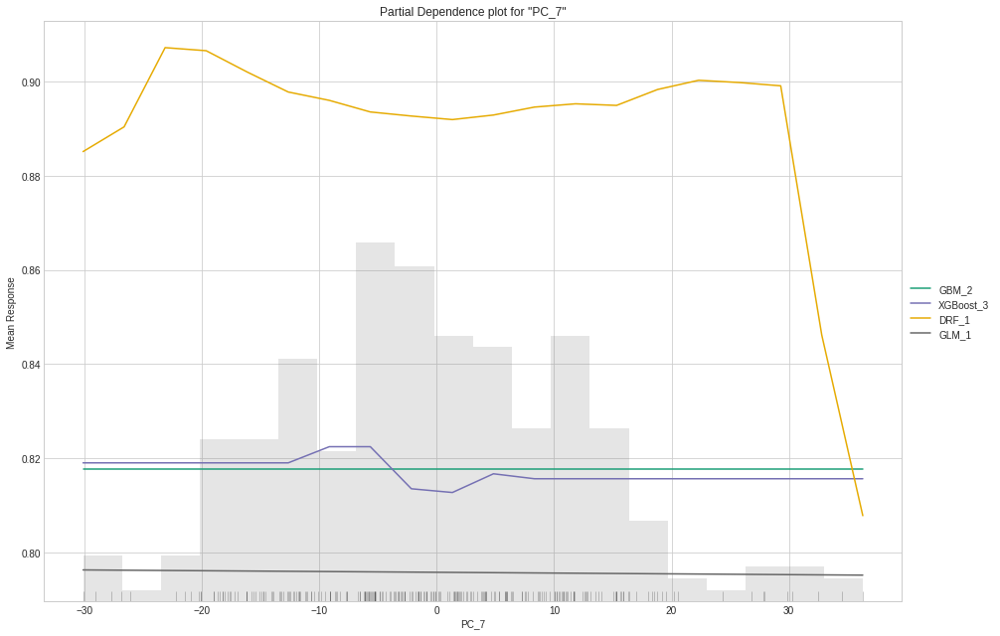

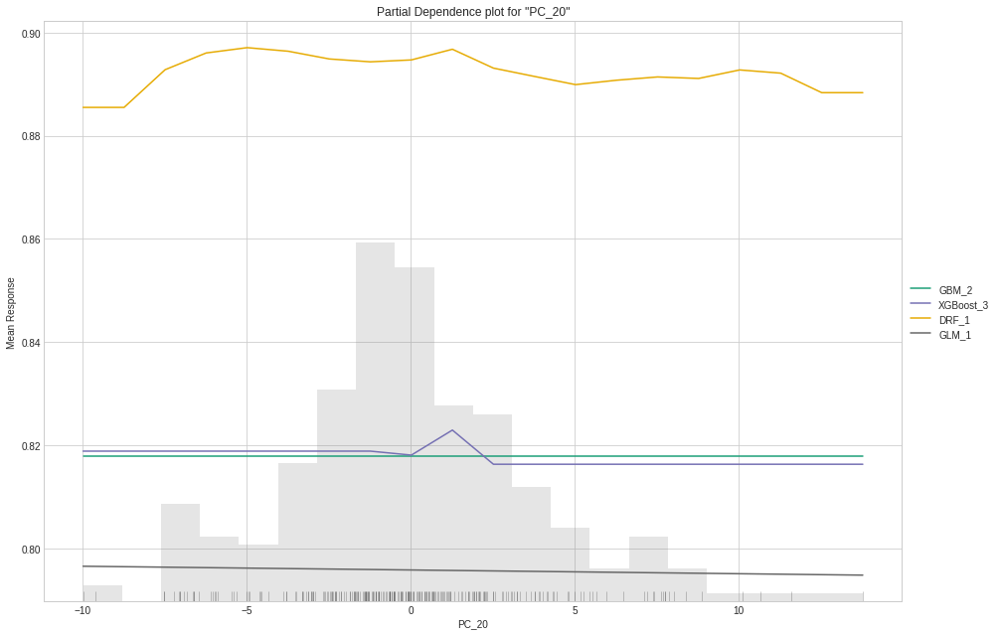

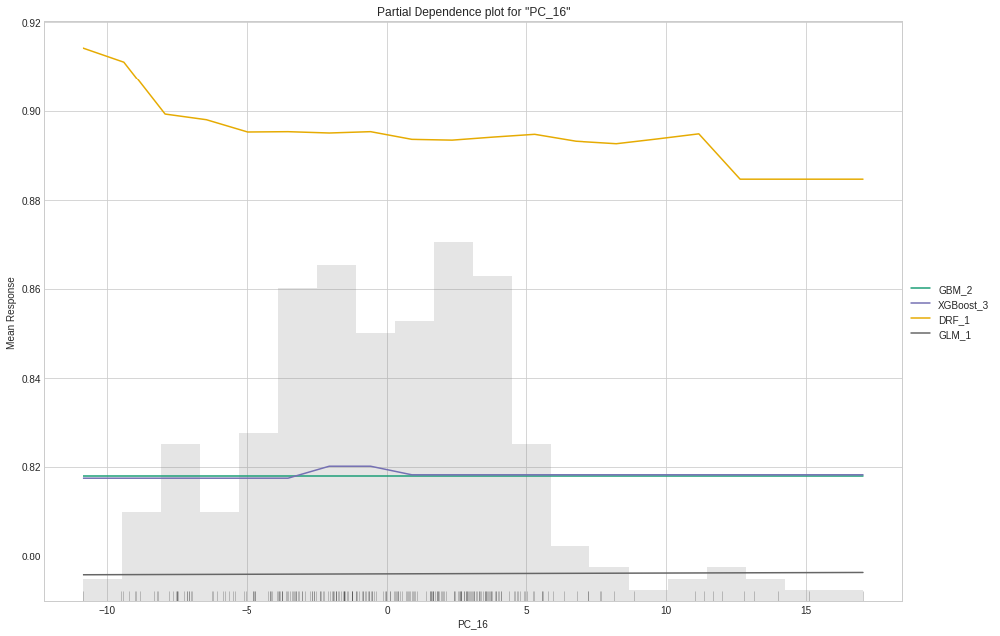



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,HA,LA
LA,0,1
LA,0,1
LA,0,1
LA,0,1
LA,0,1
LA,0,1
LA,0,1
LA,0,1
HA,2.82592e-13,1
HA,2.45385e-14,1



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:30:09.84: Project: AutoML_20210911_43009084
04:30:09.86: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:30:09.86: Build control seed: 420
04:30:09.86: training frame: Frame key: automl_training_py_635_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -1583201780906548806
04:30:09.86: validation frame: NULL
04:30:09.86: leaderboard frame: NULL
04:30:09.86: blending frame: NULL
04:30:09.86: response column: valence
04:30:09.86: fold column: null
04:30:09.86: weights column: null
04:30:09.87: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:30:09.87: Di

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_1_AutoML_20210911_043009,1,0.00459503,1,0,0.0169977,0.00028892,5837,0.174388,GBM
GBM_2_AutoML_20210911_043009,1,0.0130492,1,0,0.0412708,0.00170328,4190,0.110355,GBM
XGBoost_3_AutoML_20210911_043009,0.919916,0.379529,0.936693,0.17763,0.346338,0.11995,390,0.009516,XGBoost
XGBoost_1_AutoML_20210911_043009,0.739053,0.611271,0.764386,0.354469,0.458073,0.209831,219,0.009771,XGBoost
XGBoost_2_AutoML_20210911_043009,0.704145,0.626989,0.759072,0.414497,0.468153,0.219167,186,0.009371,XGBoost
DRF_1_AutoML_20210911_043009,0.632295,0.658489,0.643306,0.423005,0.482953,0.233243,704,0.019783,DRF
GLM_1_AutoML_20210911_043009,0.478081,0.689362,0.519033,0.490586,0.498114,0.248118,163,0.007331,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_1_AutoML_20210911_043009


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9999771690262196: 


,,NV,PV,Error,Rate
0,NV,558.0,0.0,0.0,(0.0/558.0)
1,PV,0.0,555.0,0.0,(0.0/555.0)
2,Total,558.0,555.0,0.0,(0.0/1113.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

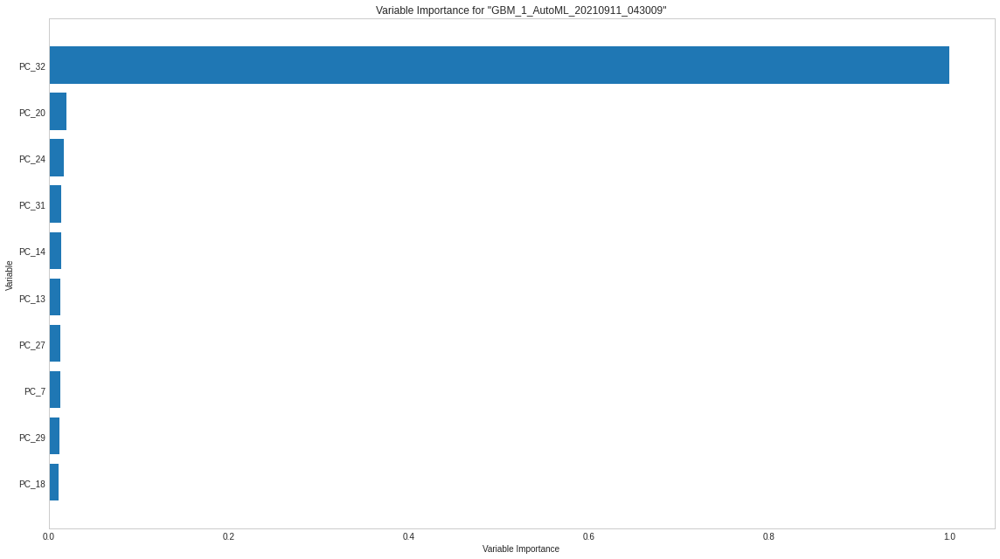

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

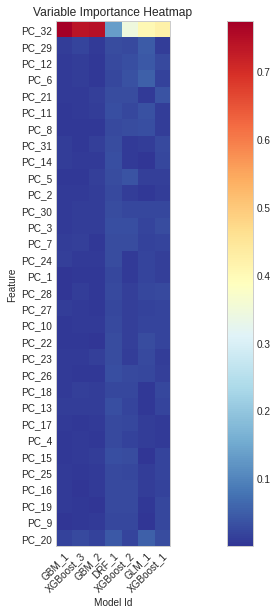

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

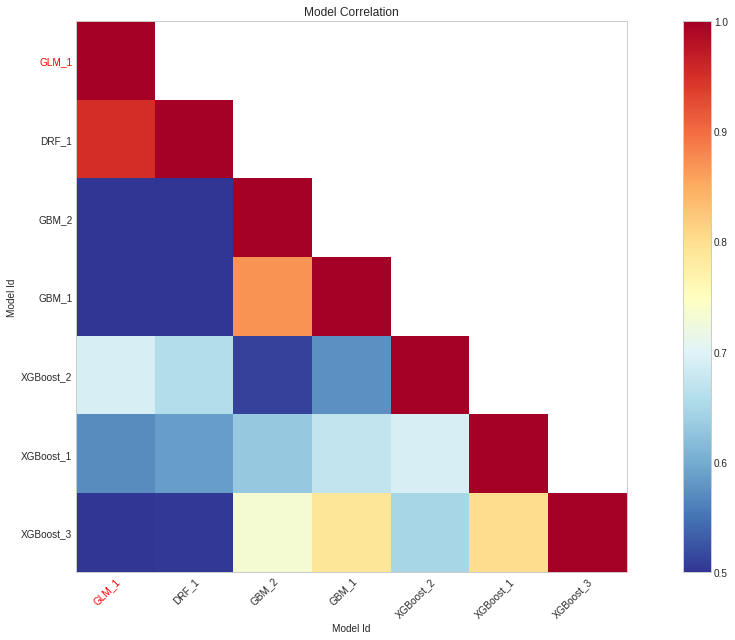

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

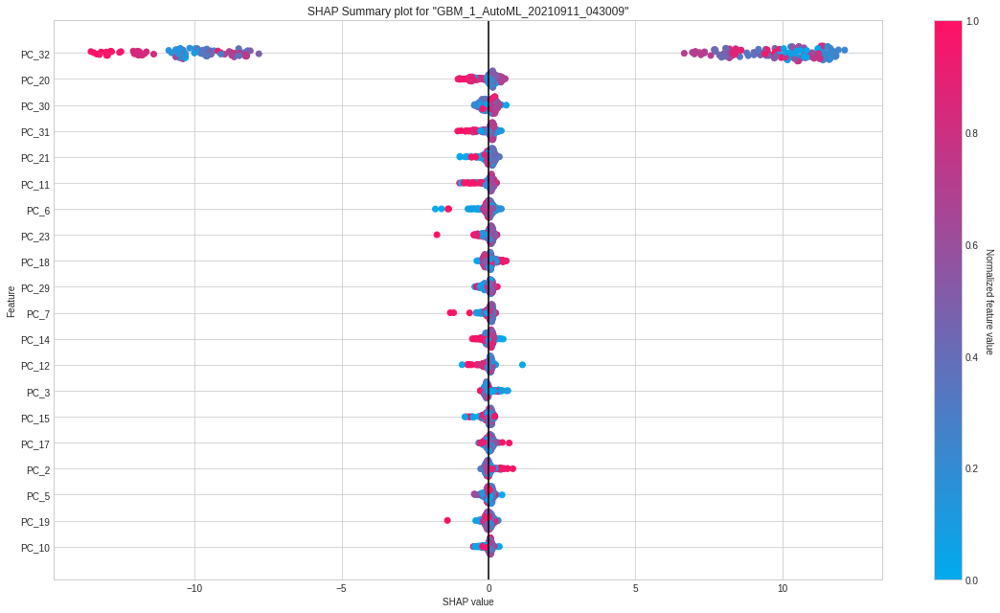

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

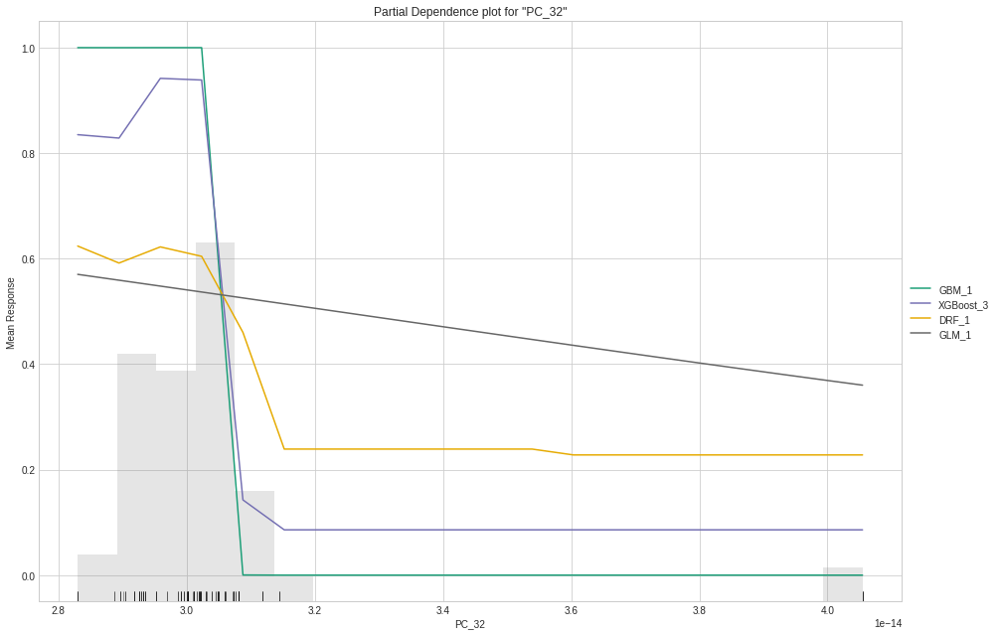

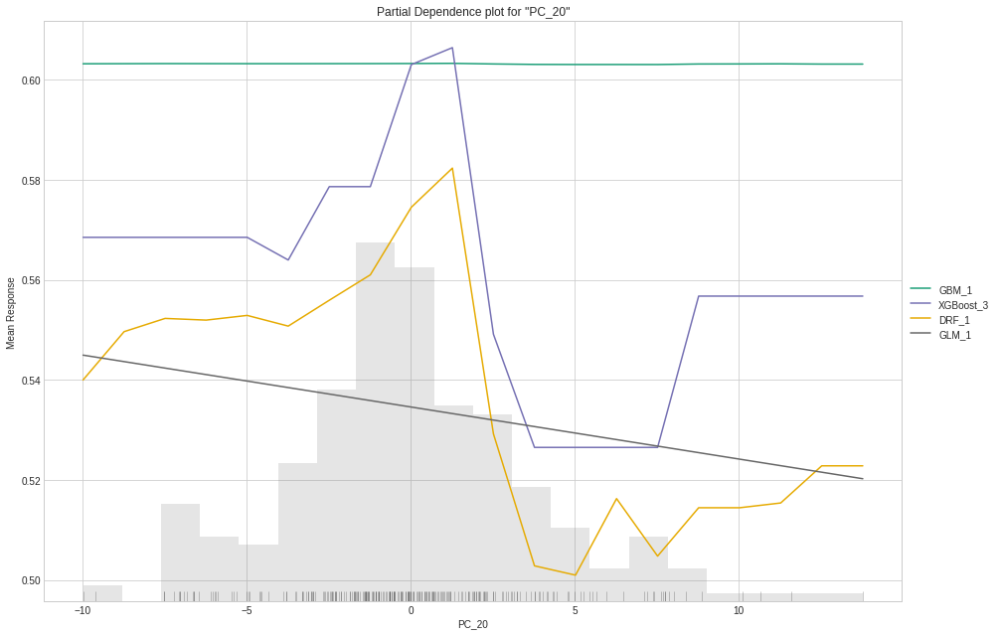

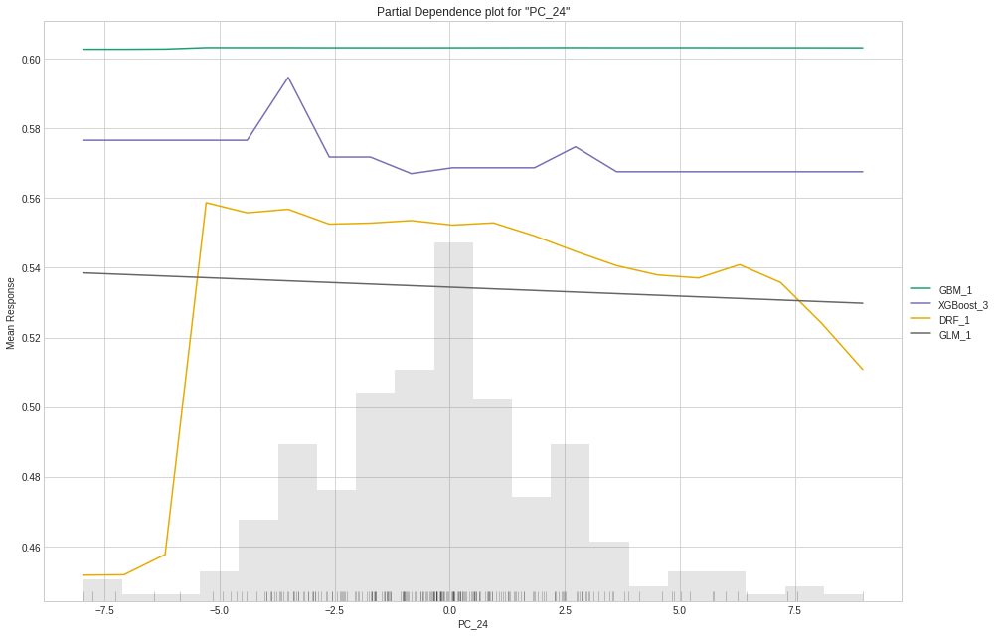

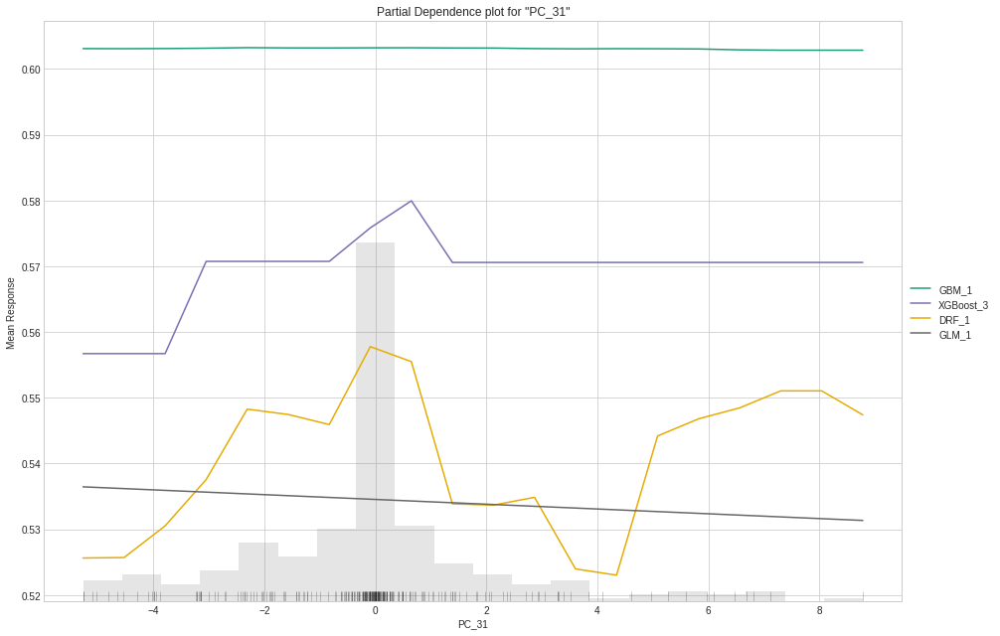

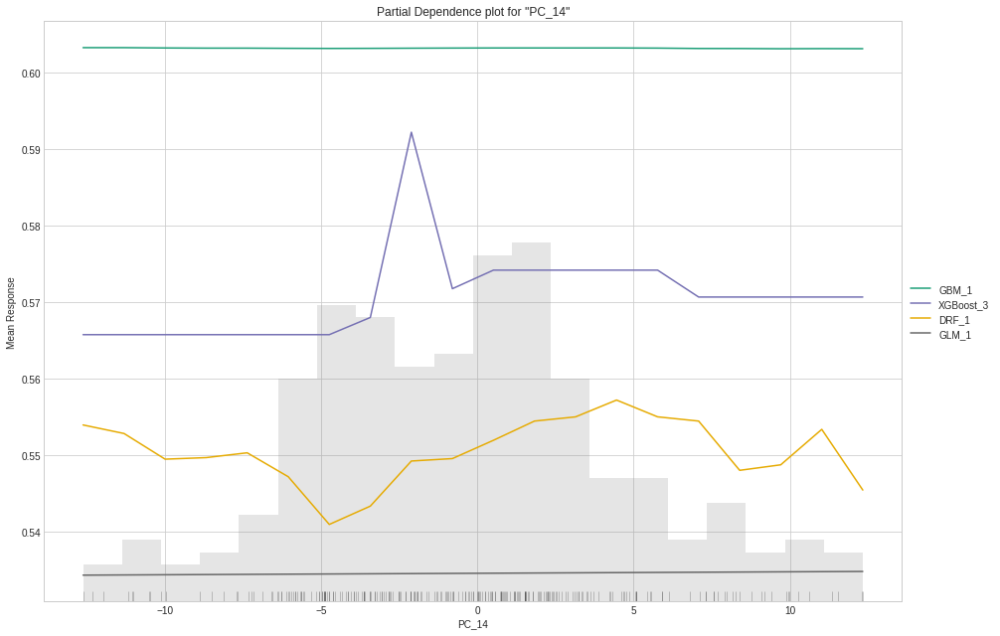



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,NV,PV
PV,1.37862e-05,0.999986
NV,5.93996e-05,0.999941
NV,3.09077e-05,0.999969
NV,3.61609e-05,0.999964
NV,3.79783e-05,0.999962
NV,2.74251e-05,0.999973
NV,2.58984e-05,0.999974
PV,1.74873e-05,0.999983
NV,0.000244705,0.999755
NV,0.000225107,0.999775



CPU times: user 2min 30s, sys: 11.2 s, total: 2min 42s
Wall time: 9min 33s


In [ ]:
%%time
subjects = [0, 1, 2]
train_subjects(subjects, 7, ["StackedEnsemble"])

In [ ]:
# print leader model params

Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:31:53.375: Project: AutoML_20210911_43153375
04:31:53.375: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:31:53.376: Build control seed: 420
04:31:53.376: training frame: Frame key: automl_training_py_758_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -8569701433379092882
04:31:53.376: validation frame: NULL
04:31:53.376: leaderboard frame: NULL
04:31:53.376: blending frame: NULL
04:31:53.376: response column: arousal
04:31:53.376: fold column: null
04:31:53.376: weights column: null
04:31:53.376: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:31

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
XGBoost_3_AutoML_20210911_043153,0.932824,0.337933,0.897496,0.142006,0.326401,0.106538,311,0.014431,XGBoost
XGBoost_1_AutoML_20210911_043153,0.810252,0.518105,0.744632,0.268098,0.417502,0.174308,691,0.011307,XGBoost
XGBoost_2_AutoML_20210911_043153,0.736539,0.59334,0.639798,0.312683,0.450382,0.202844,170,0.017508,XGBoost
GLM_1_AutoML_20210911_043153,0.440123,0.674968,0.354311,0.472311,0.490882,0.240965,85,0.012537,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_3_AutoML_20210911_043153


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.7697770595550537: 


,,HA,LA,Error,Rate
0,HA,615.0,0.0,0.0,(0.0/615.0)
1,LA,0.0,418.0,0.0,(0.0/418.0)
2,Total,615.0,418.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

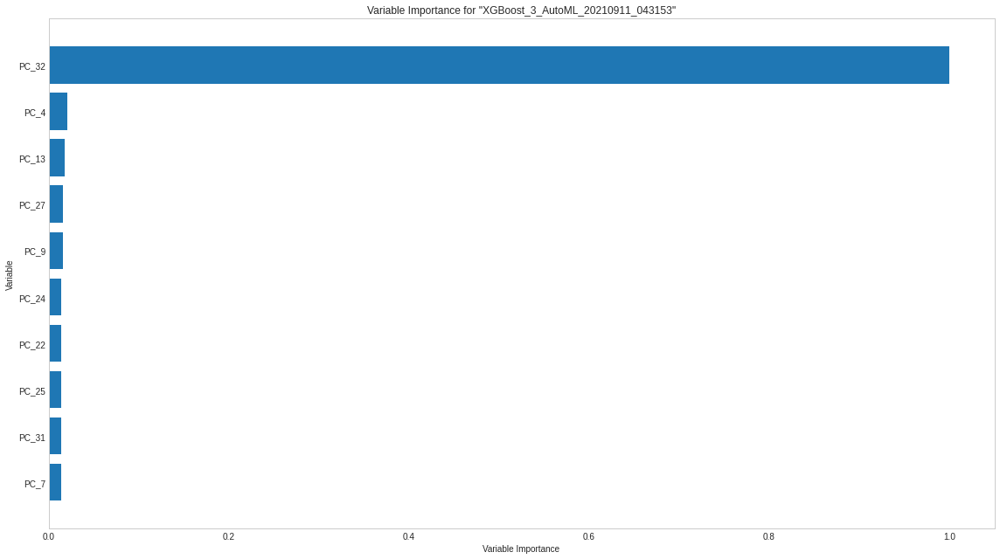

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

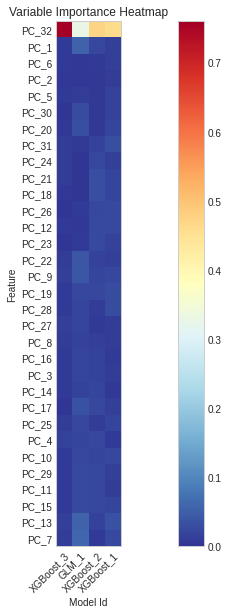

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

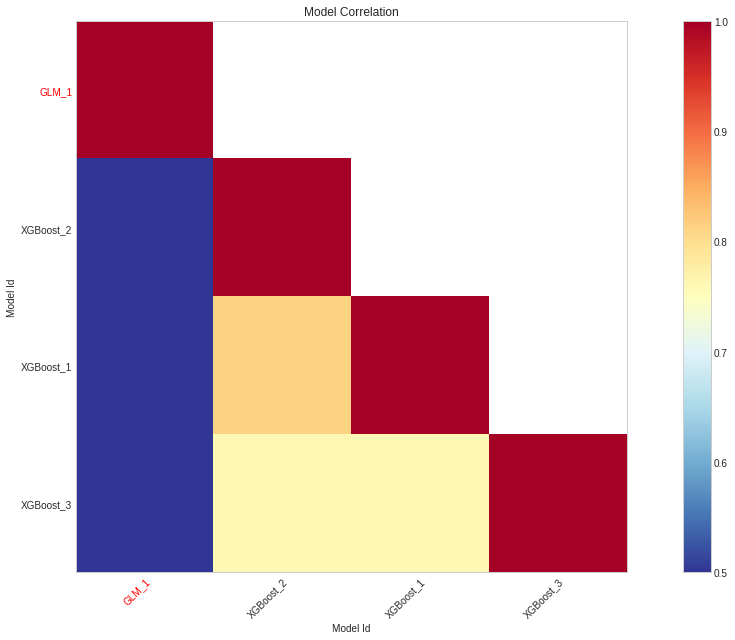

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

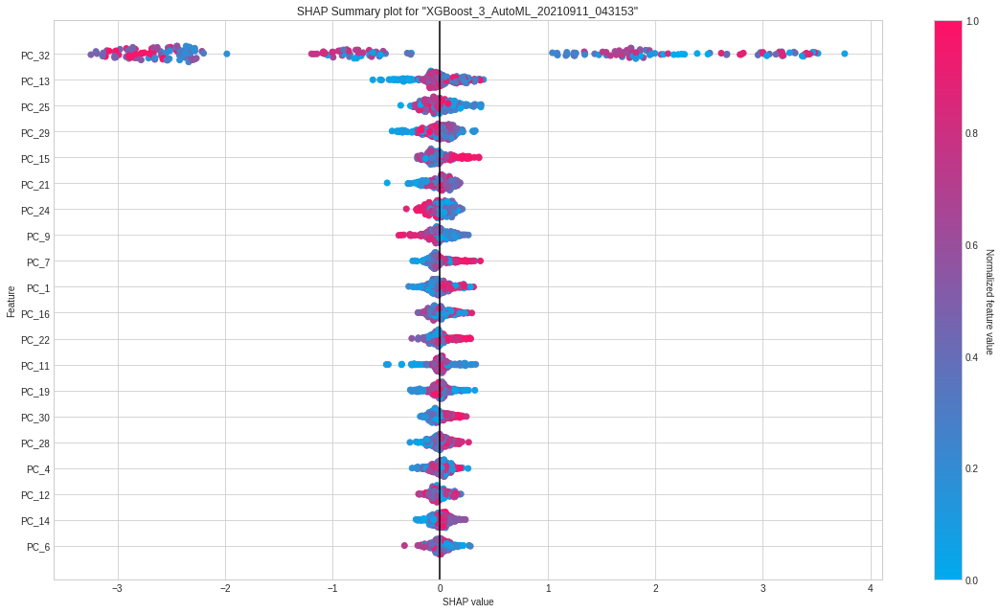

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

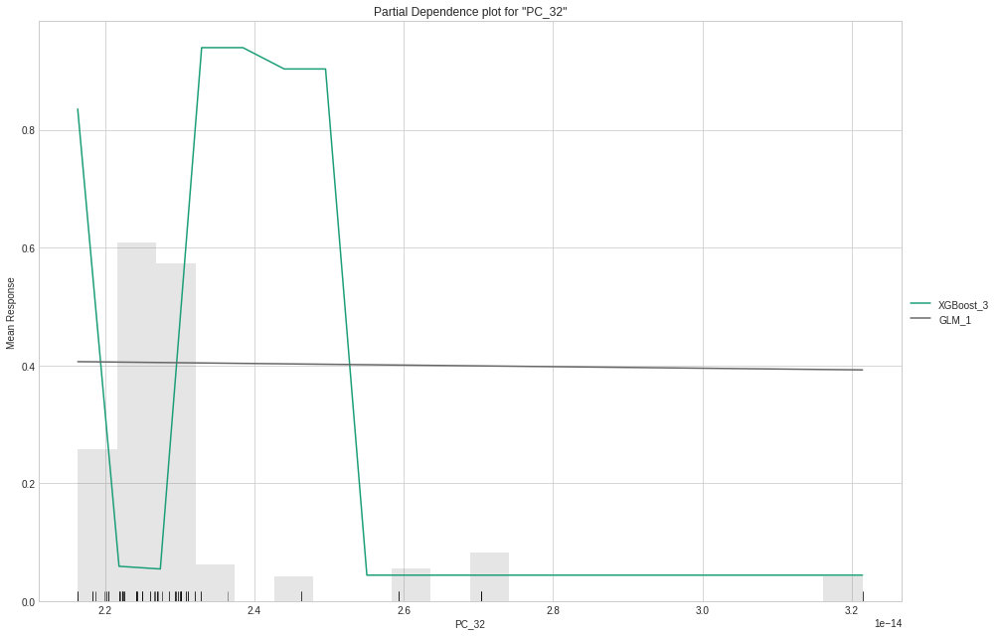

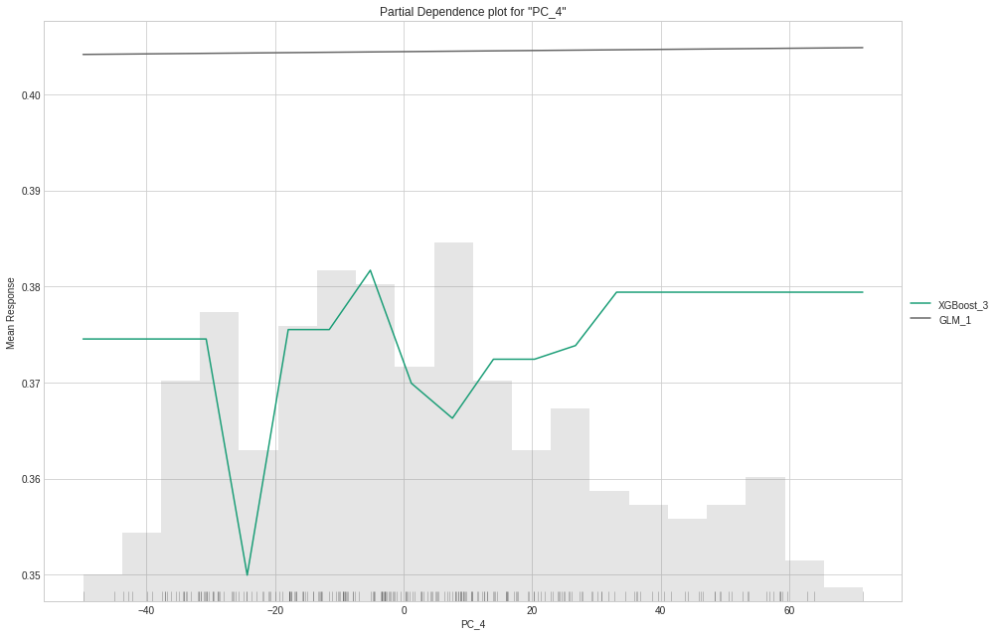

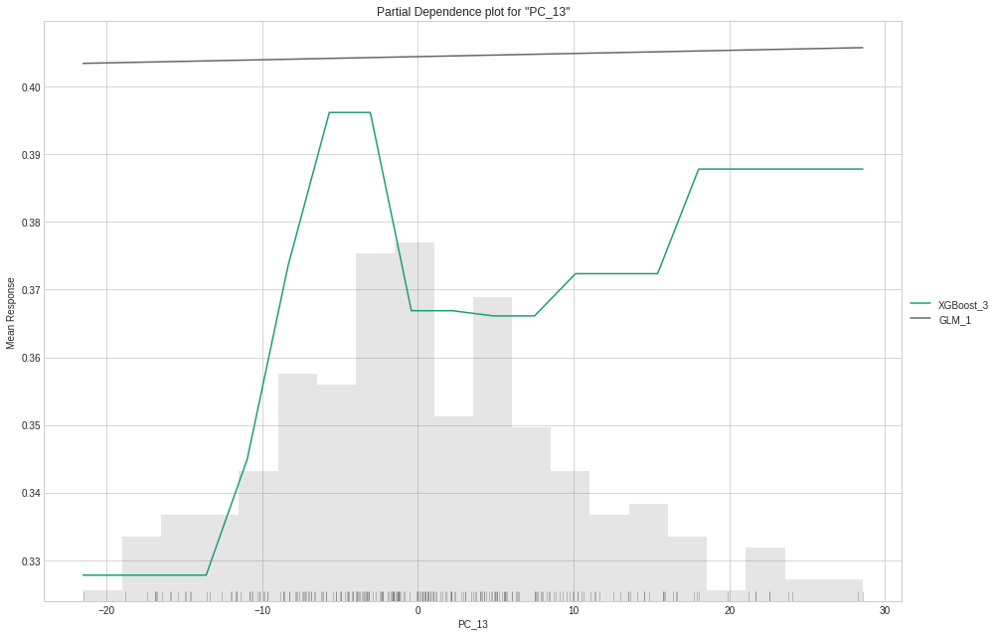

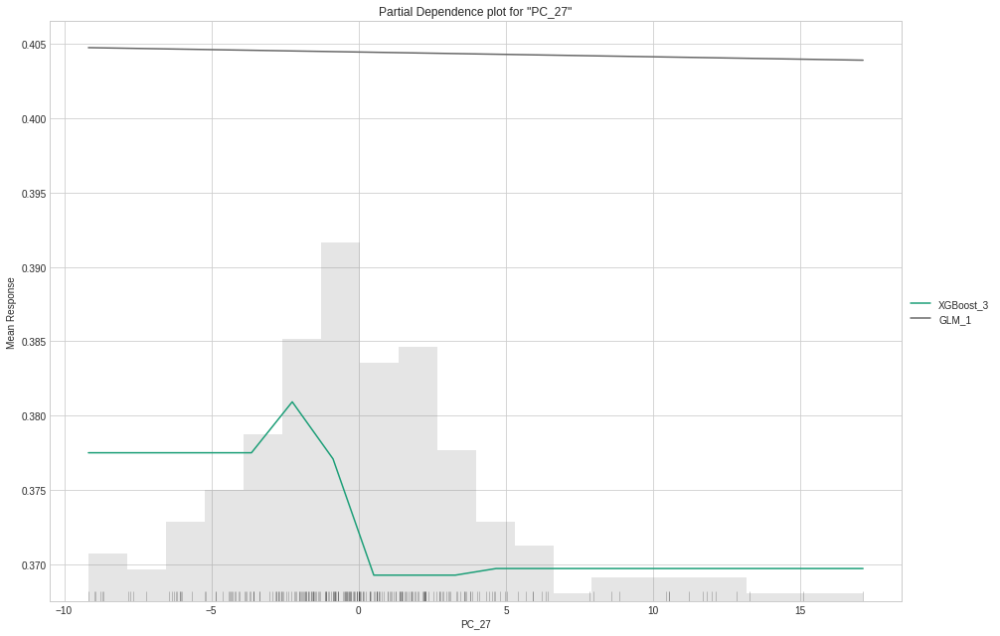

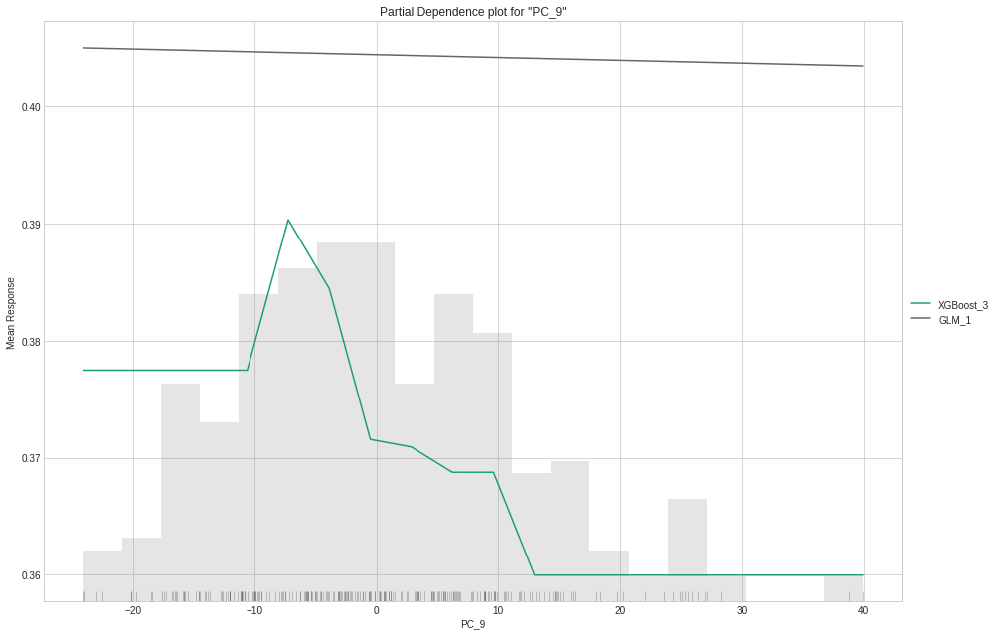



xgboost prediction progress: |████████████████████████████████████████████| 100%


predict,HA,LA
HA,0.983061,0.0169395
HA,0.992182,0.00781842
HA,0.899329,0.100671
HA,0.818619,0.18138
HA,0.950383,0.049617
HA,0.96463,0.03537
HA,0.981695,0.0183054
HA,0.961955,0.0380447
HA,0.970709,0.029291
HA,0.982886,0.0171135



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:32:17.262: Project: AutoML_20210911_43217262
04:32:17.262: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:32:17.263: Build control seed: 420
04:32:17.263: training frame: Frame key: automl_training_py_833_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267376  checksum: -7993497005368322580
04:32:17.263: validation frame: NULL
04:32:17.263: leaderboard frame: NULL
04:32:17.263: blending frame: NULL
04:32:17.263: response column: valence
04:32:17.263: fold column: null
04:32:17.263: weights column: null
04:32:17.263: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:3

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
XGBoost_3_AutoML_20210911_043217,0.979565,0.218357,0.977966,0.0798016,0.249002,0.0620018,528,0.009575,XGBoost
XGBoost_1_AutoML_20210911_043217,0.907077,0.392348,0.896087,0.169024,0.353406,0.124896,386,0.010337,XGBoost
XGBoost_2_AutoML_20210911_043217,0.840511,0.493603,0.825101,0.247126,0.403833,0.163081,513,0.009941,XGBoost
GLM_1_AutoML_20210911_043217,0.412139,0.691962,0.48973,0.499081,0.499407,0.249407,54,0.008082,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_3_AutoML_20210911_043217


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.794844925403595: 


,,NV,PV,Error,Rate
0,NV,544.0,0.0,0.0,(0.0/544.0)
1,PV,0.0,489.0,0.0,(0.0/489.0)
2,Total,544.0,489.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

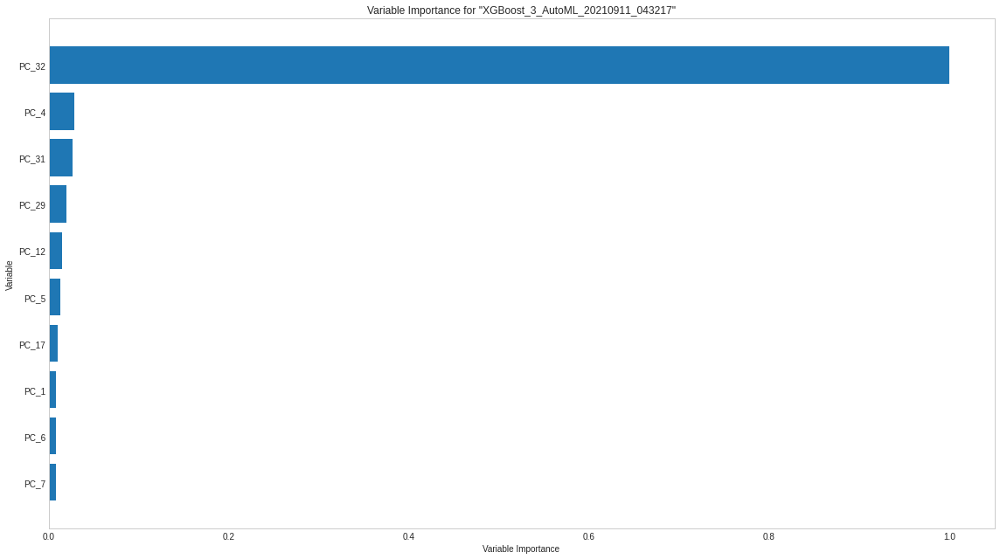

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

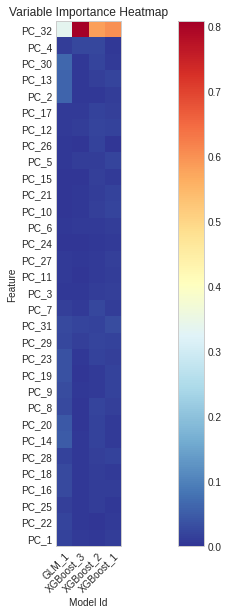

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

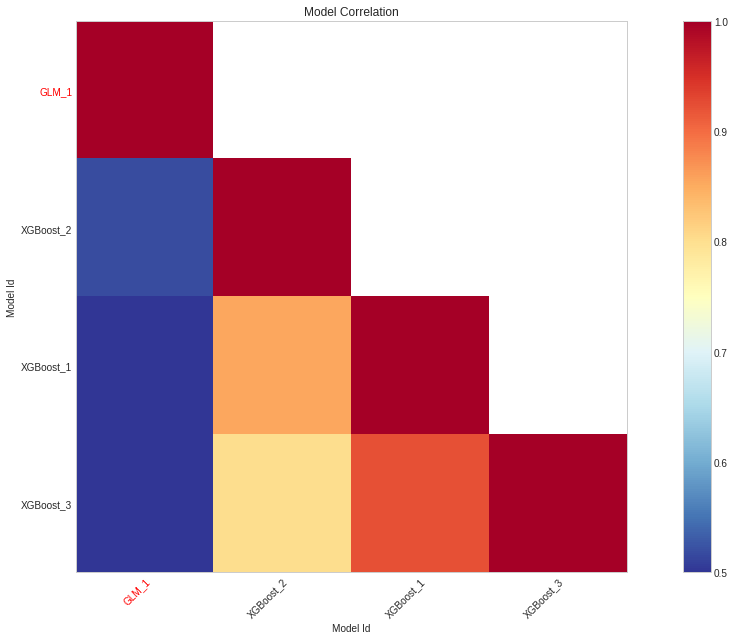

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

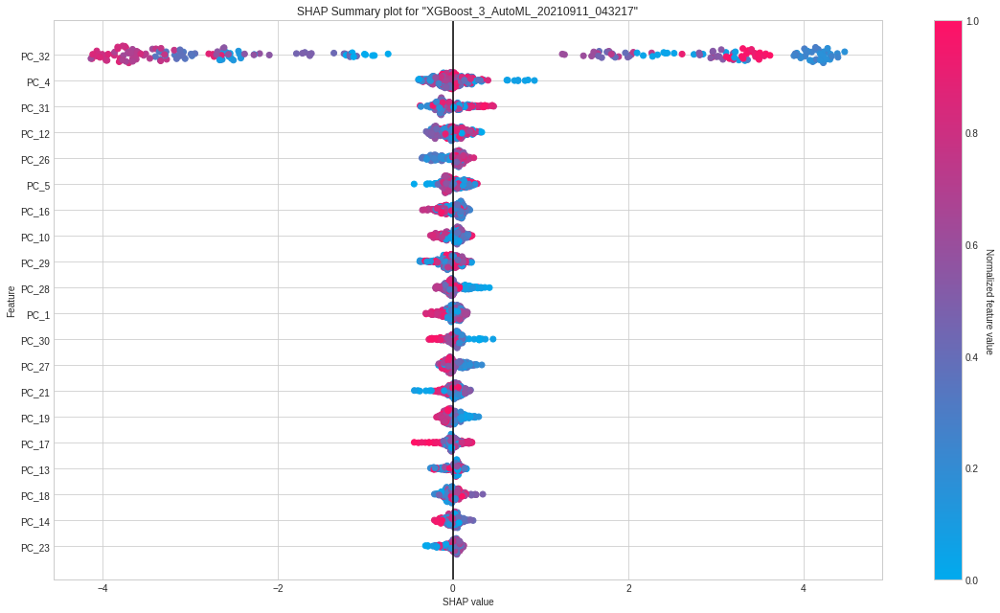

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

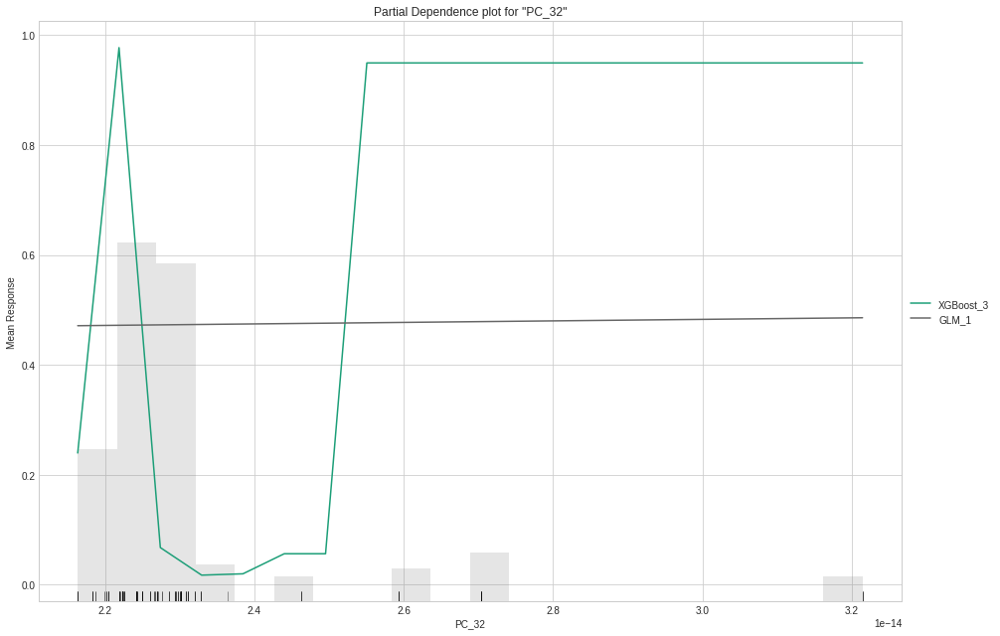

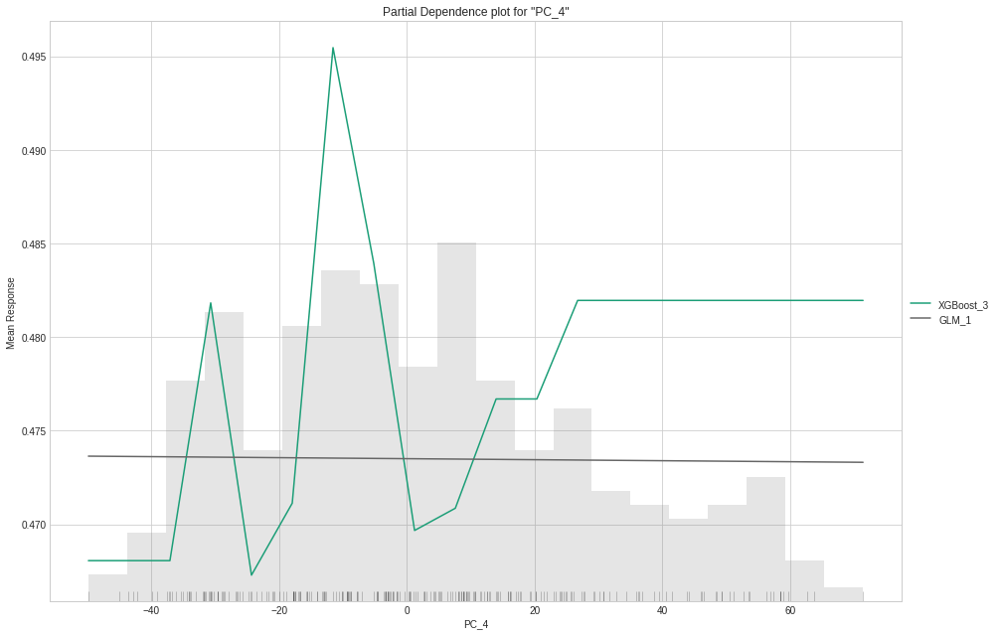

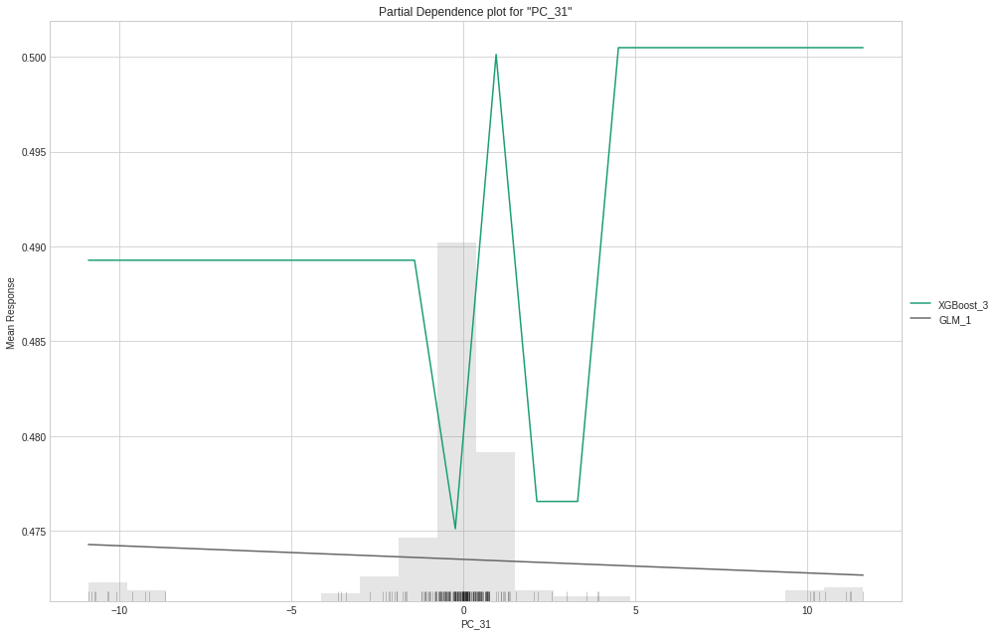

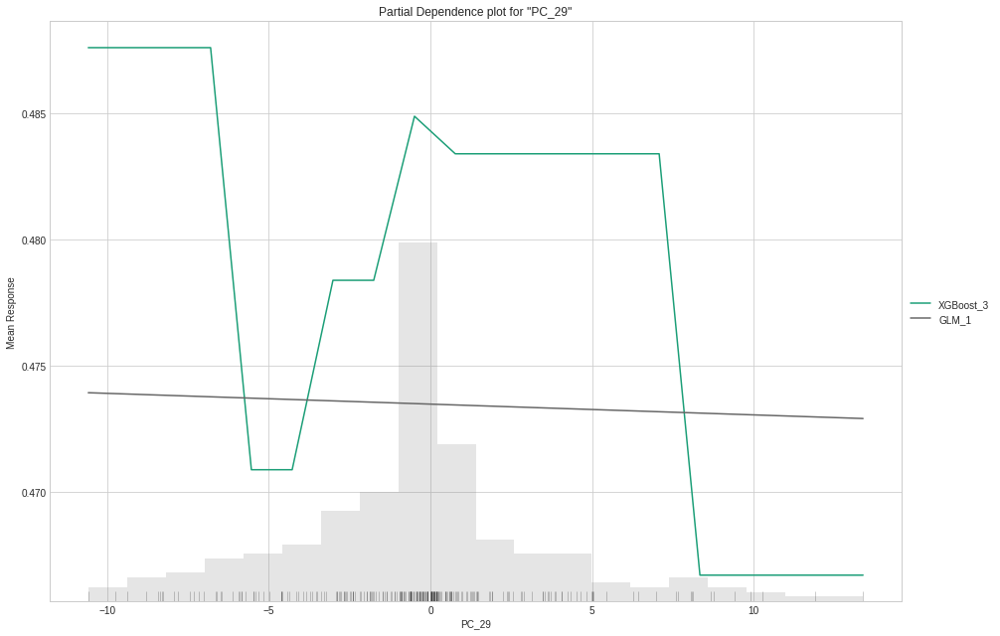

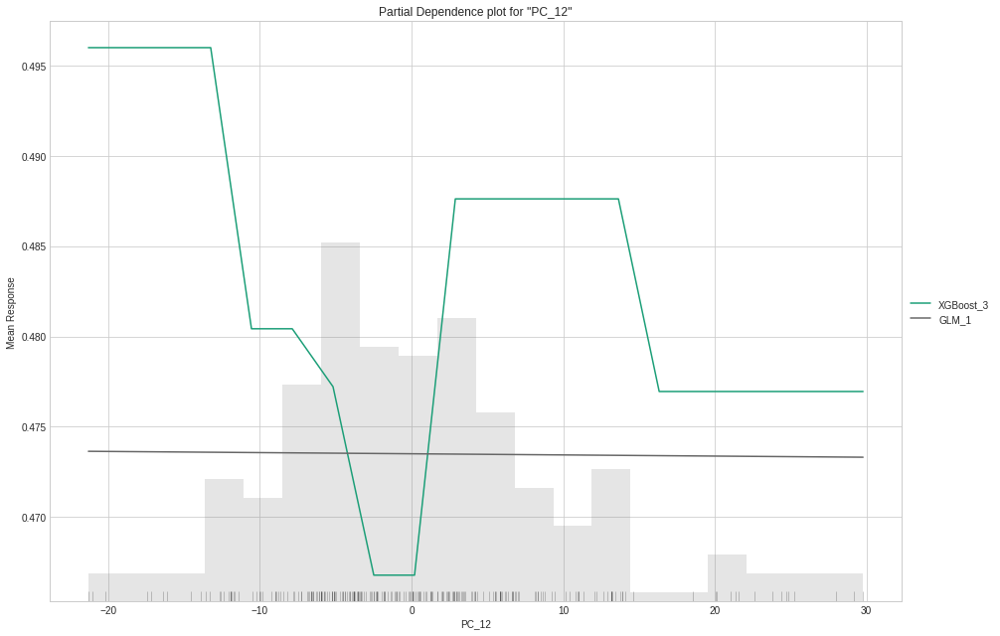



xgboost prediction progress: |████████████████████████████████████████████| 100%


predict,NV,PV
PV,0.0291915,0.970809
PV,0.0917724,0.908228
PV,0.0308626,0.969137
PV,0.042881,0.957119
PV,0.0259153,0.974085
PV,0.0334306,0.966569
PV,0.0380723,0.961928
PV,0.11001,0.88999
PV,0.0439555,0.956044
PV,0.0841831,0.915817



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:32:43.19: Project: AutoML_20210911_43243018
04:32:43.20: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:32:43.20: Build control seed: 420
04:32:43.20: training frame: Frame key: automl_training_py_907_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -7129540488822410997
04:32:43.20: validation frame: NULL
04:32:43.20: leaderboard frame: NULL
04:32:43.20: blending frame: NULL
04:32:43.20: response column: arousal
04:32:43.20: fold column: null
04:32:43.20: weights column: null
04:32:43.20: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:32:43.21: Di

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
XGBoost_3_AutoML_20210911_043243,0.960792,0.271247,0.942696,0.112996,0.287644,0.0827392,747,0.018473,XGBoost
XGBoost_1_AutoML_20210911_043243,0.897899,0.398428,0.851317,0.186118,0.361348,0.130572,528,0.01078,XGBoost
XGBoost_2_AutoML_20210911_043243,0.81594,0.508018,0.767223,0.256595,0.415513,0.172651,545,0.009544,XGBoost
GLM_1_AutoML_20210911_043243,0.583059,0.670329,0.430364,0.41253,0.488746,0.238872,135,0.00752,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_3_AutoML_20210911_043243


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.7831723093986511: 


,,HA,LA,Error,Rate
0,HA,611.0,0.0,0.0,(0.0/611.0)
1,LA,0.0,422.0,0.0,(0.0/422.0)
2,Total,611.0,422.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

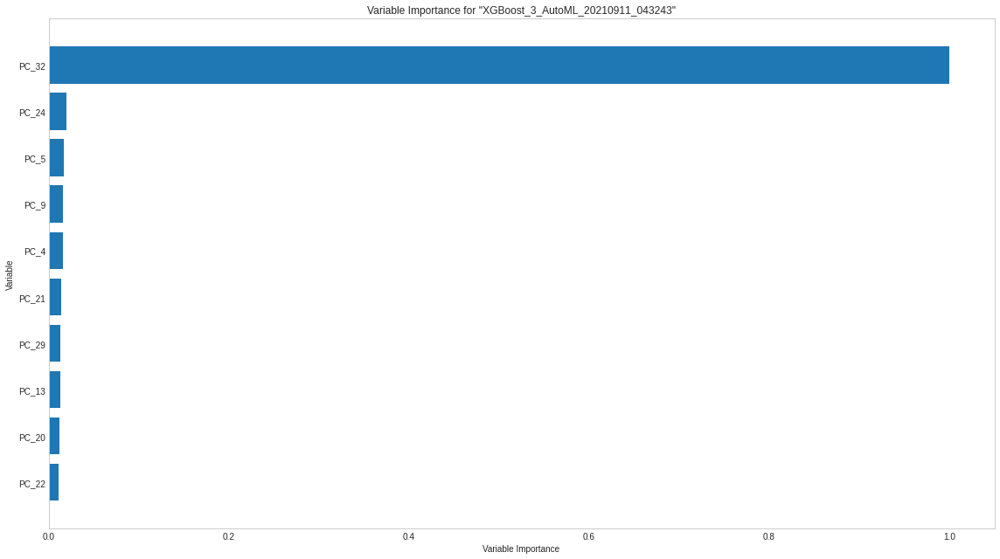

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

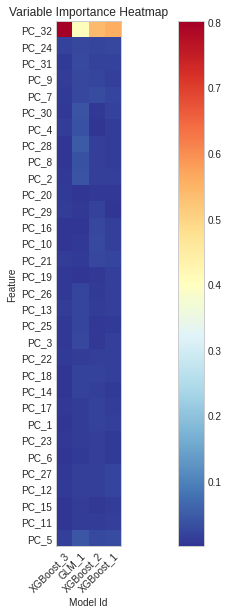

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

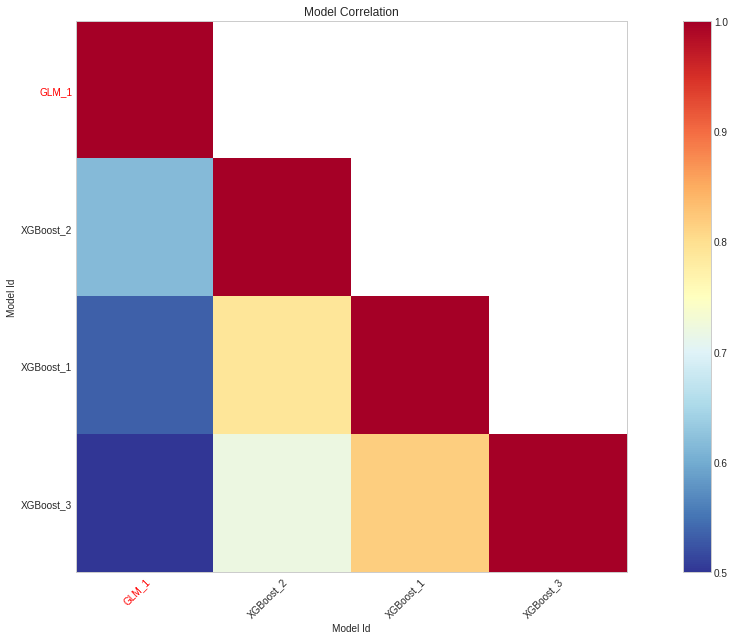

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

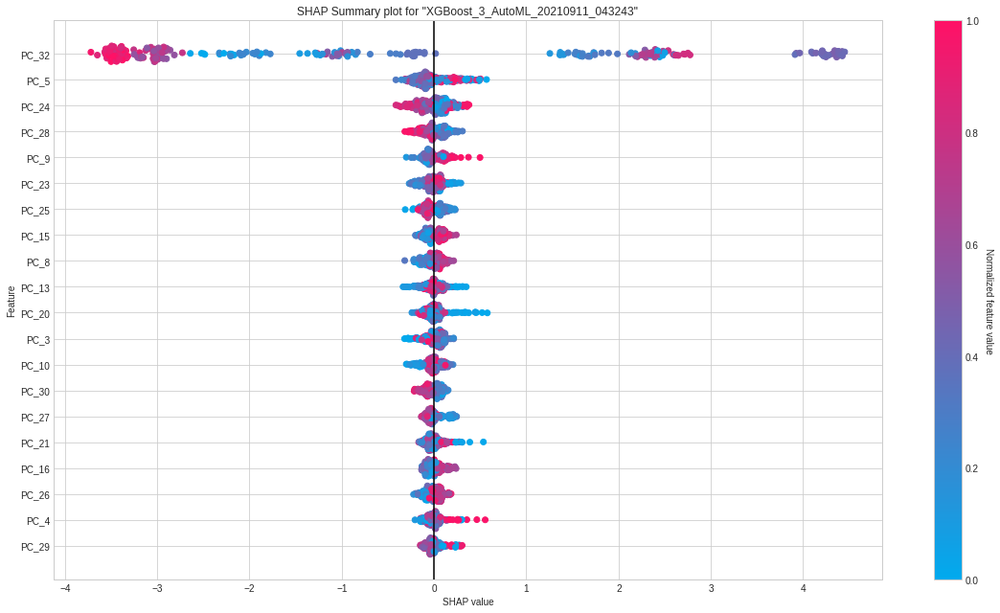

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

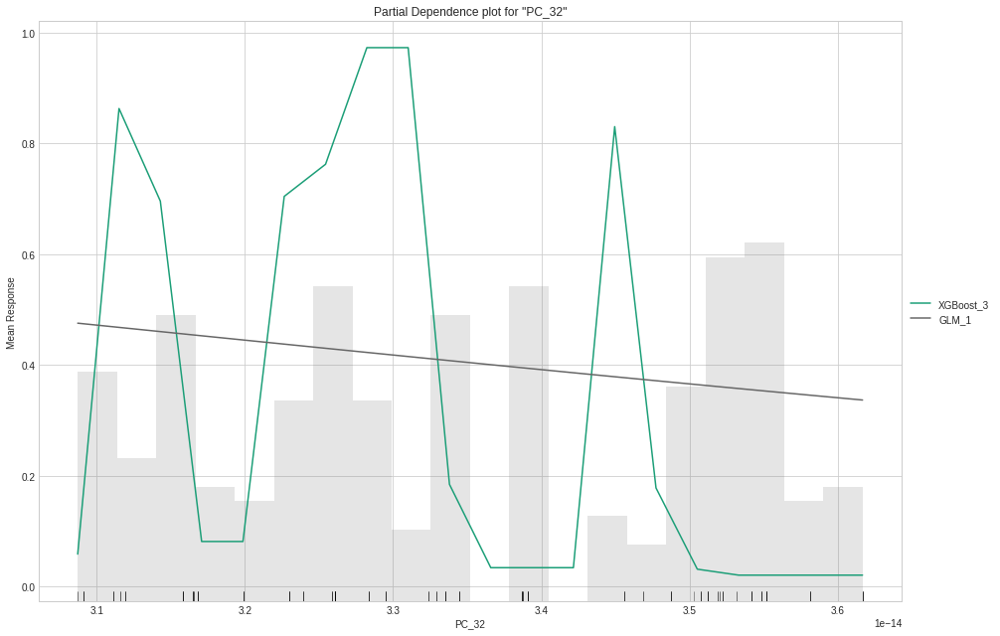

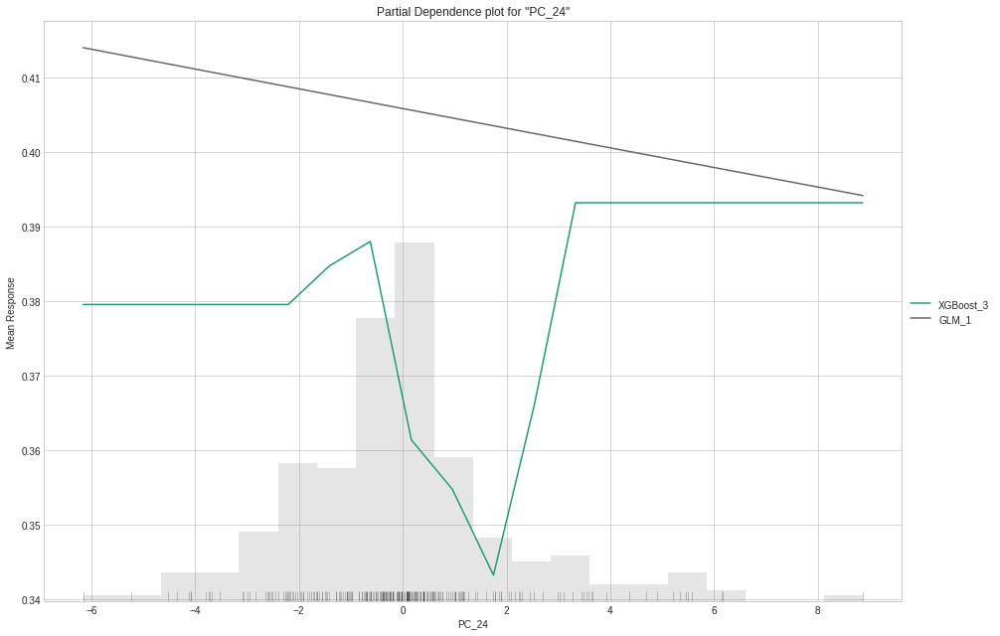

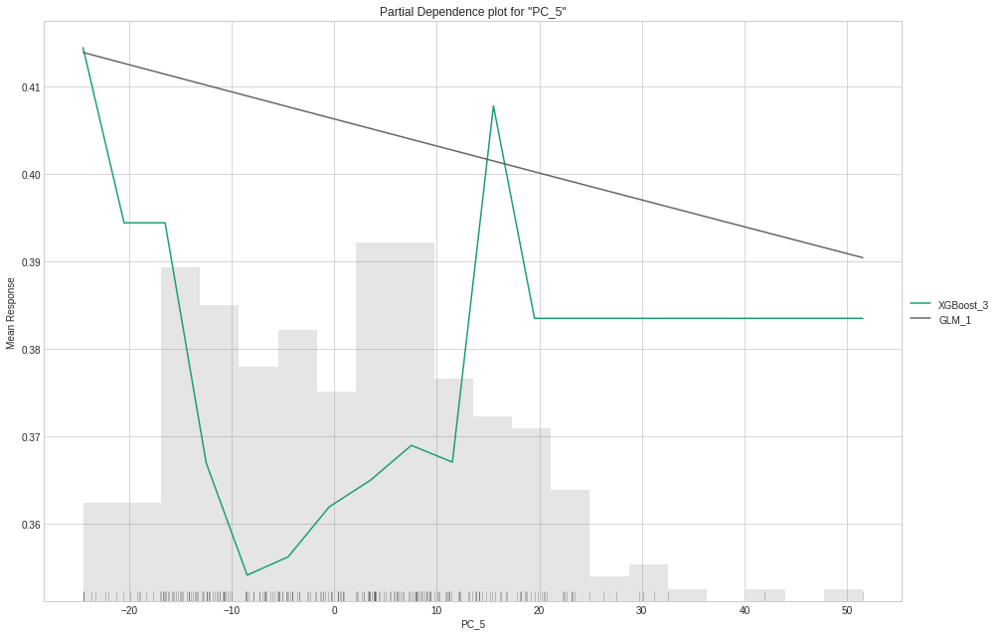

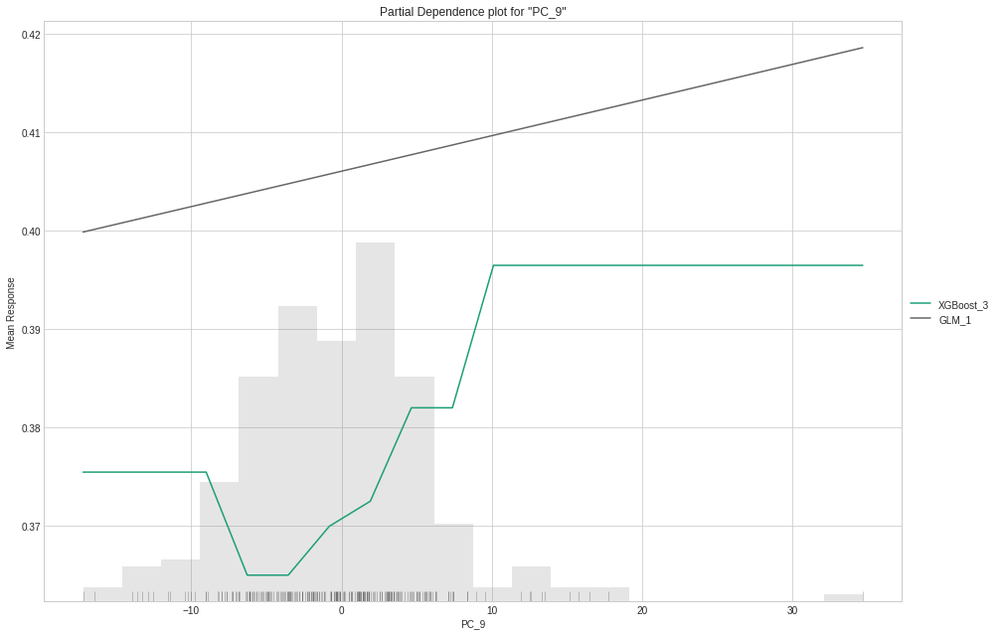

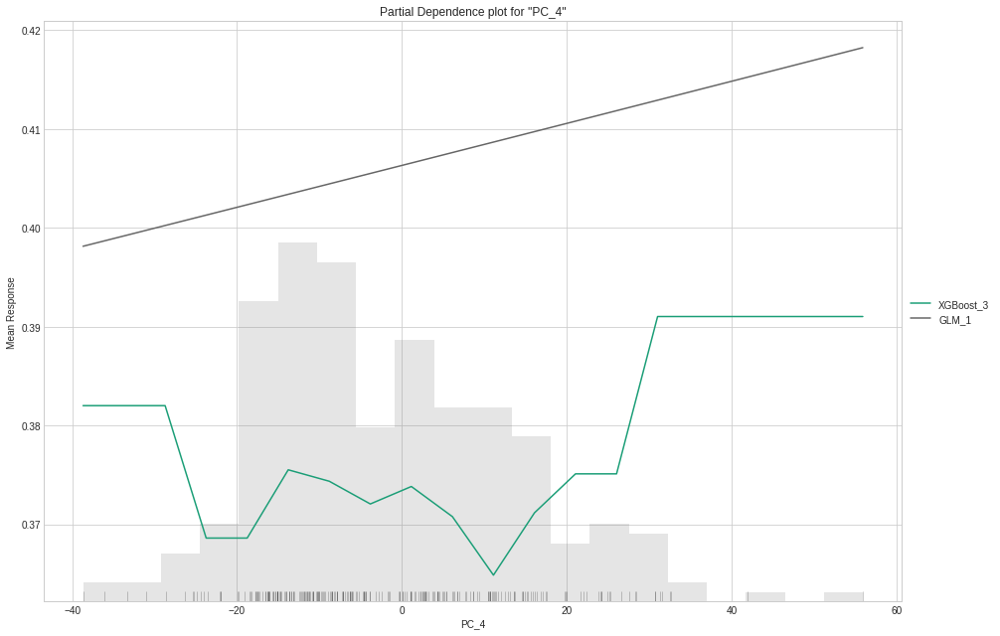



xgboost prediction progress: |████████████████████████████████████████████| 100%


predict,HA,LA
HA,0.907918,0.0920819
HA,0.939557,0.0604428
HA,0.970735,0.0292653
HA,0.803939,0.196061
HA,0.84934,0.15066
HA,0.84761,0.15239
HA,0.929044,0.0709556
HA,0.885027,0.114973
HA,0.693685,0.306315
HA,0.664545,0.335455



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:33:09.782: Project: AutoML_20210911_43309782
04:33:09.783: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:33:09.783: Build control seed: 420
04:33:09.783: training frame: Frame key: automl_training_py_981_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: 6421991642591212286
04:33:09.783: validation frame: NULL
04:33:09.783: leaderboard frame: NULL
04:33:09.783: blending frame: NULL
04:33:09.783: response column: valence
04:33:09.783: fold column: null
04:33:09.783: weights column: null
04:33:09.783: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:33

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
XGBoost_3_AutoML_20210911_043309,0.956817,0.295852,0.965728,0.113886,0.297741,0.0886496,393,0.013058,XGBoost
XGBoost_1_AutoML_20210911_043309,0.779334,0.569844,0.783507,0.300552,0.437536,0.191437,211,0.014706,XGBoost
XGBoost_2_AutoML_20210911_043309,0.734009,0.614781,0.748587,0.339008,0.458158,0.209909,161,0.010226,XGBoost
GLM_1_AutoML_20210911_043309,0.652144,0.655983,0.637007,0.376618,0.481023,0.231383,272,0.007171,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_3_AutoML_20210911_043309


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.7678753137588501: 


,,NV,PV,Error,Rate
0,NV,474.0,0.0,0.0,(0.0/474.0)
1,PV,0.0,559.0,0.0,(0.0/559.0)
2,Total,474.0,559.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

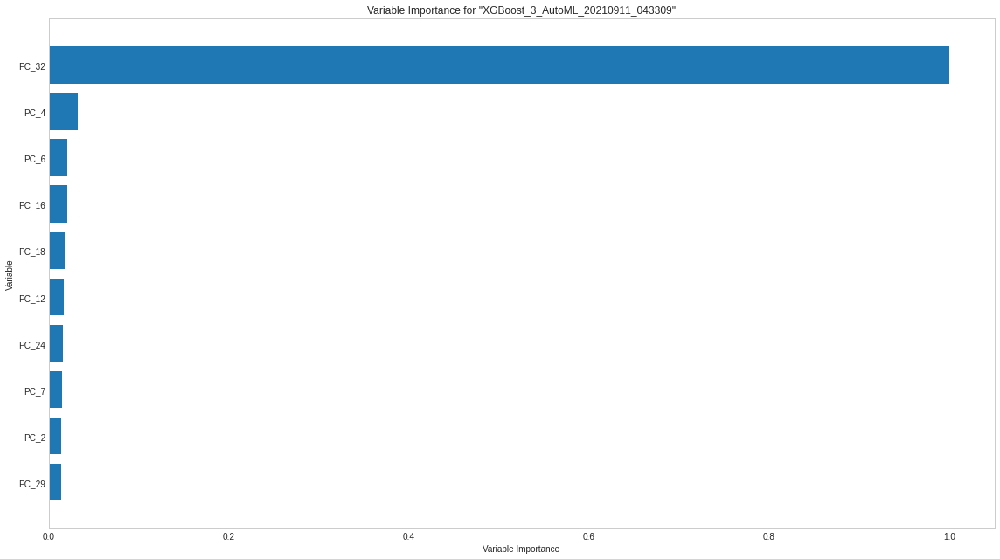

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

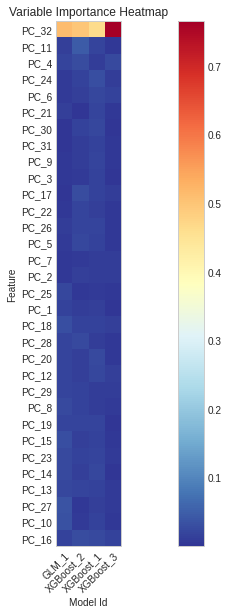

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

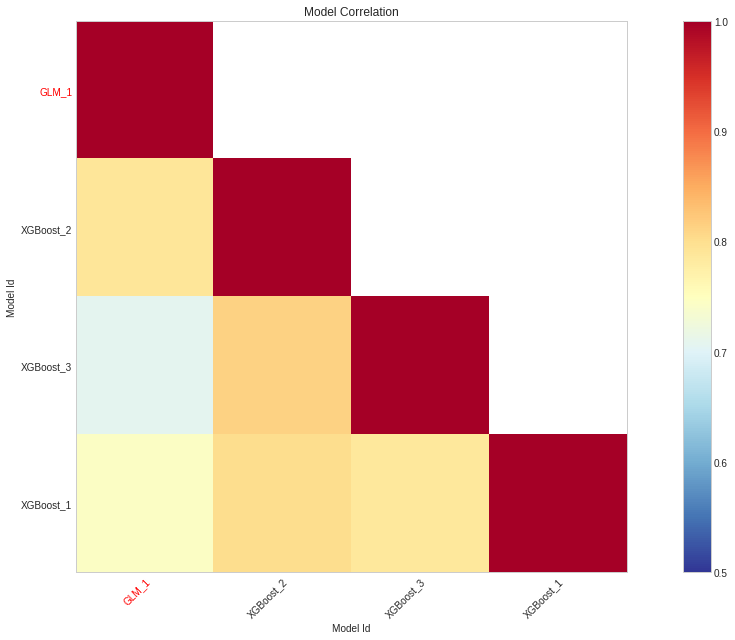

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

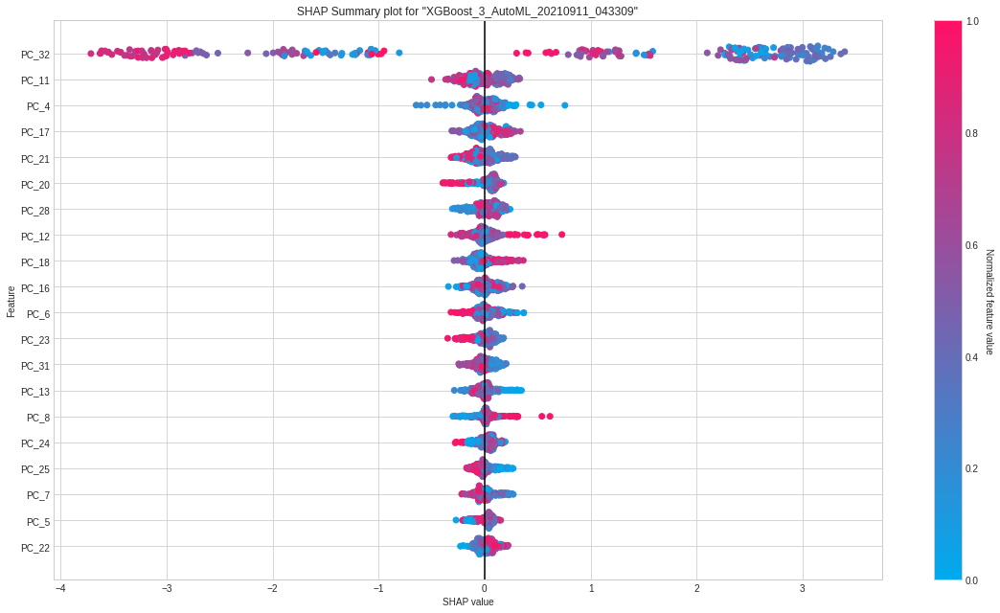

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

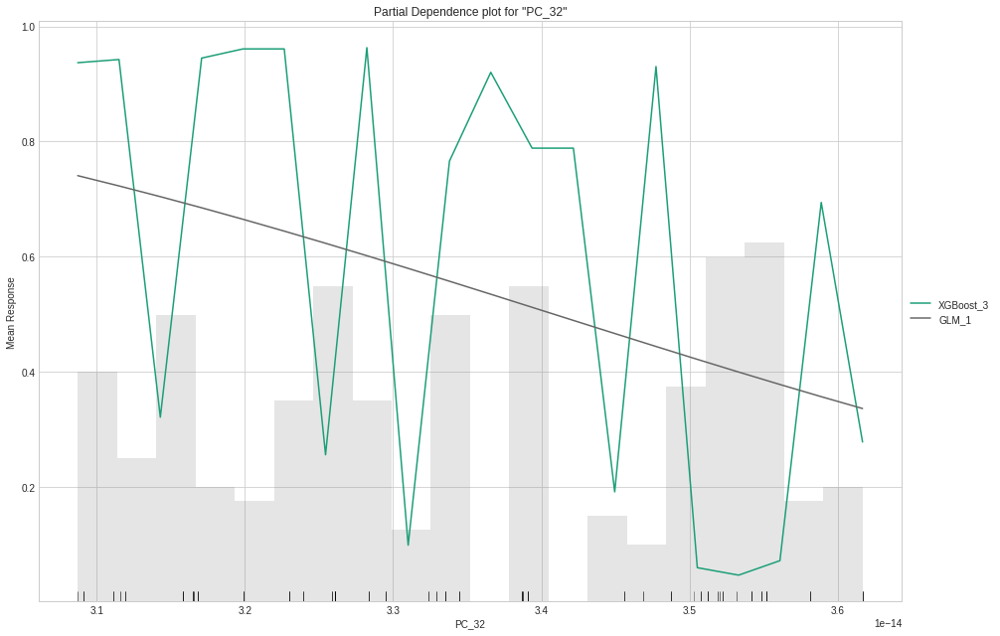

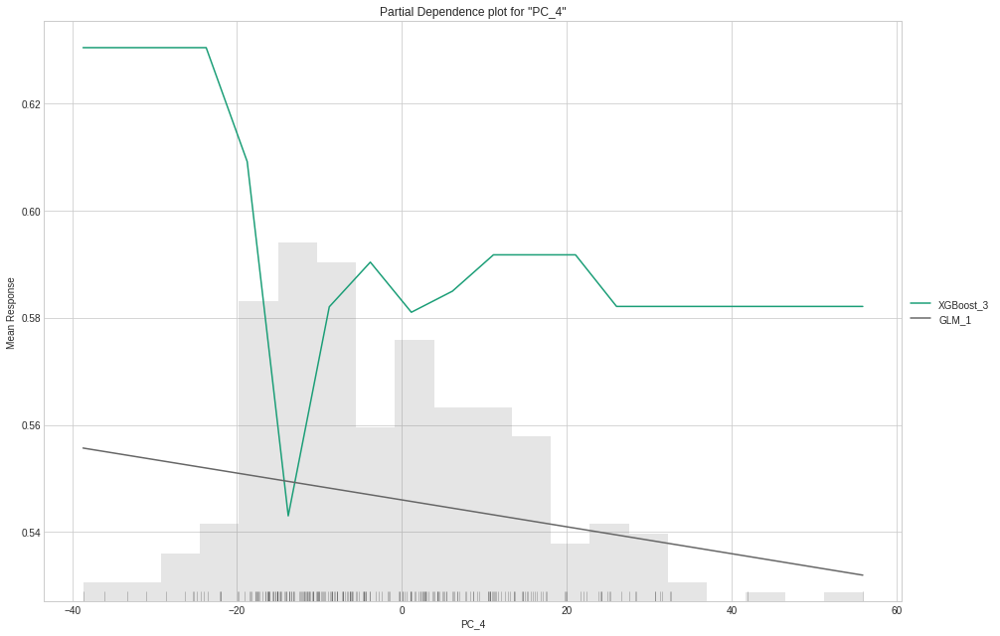

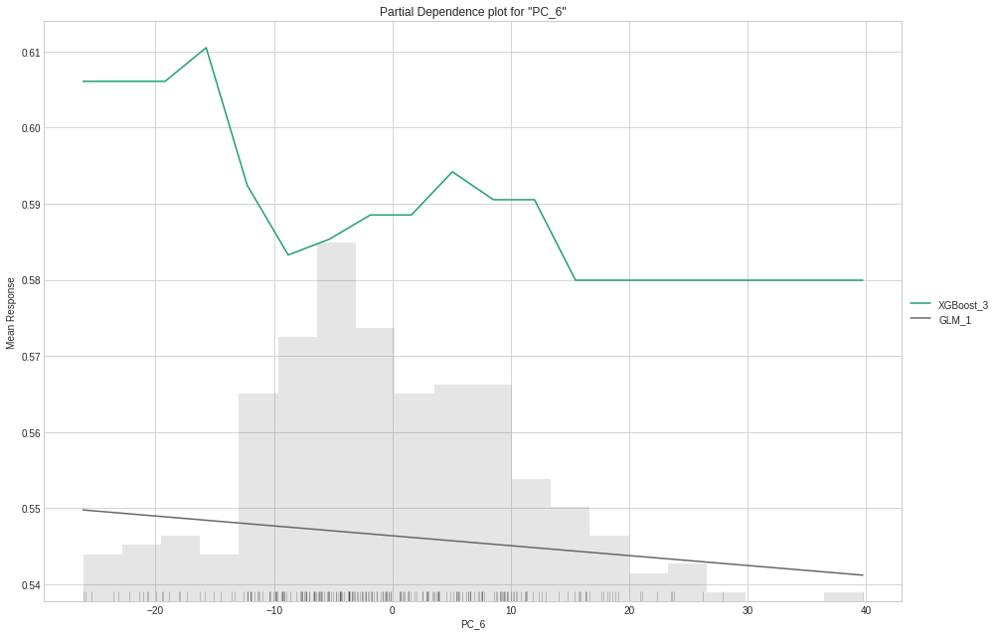

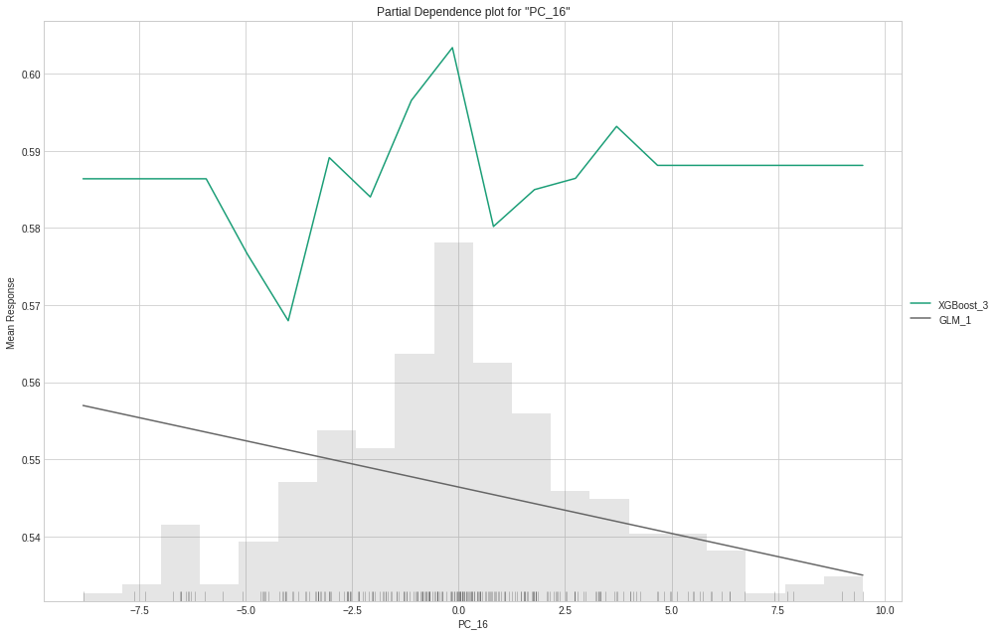

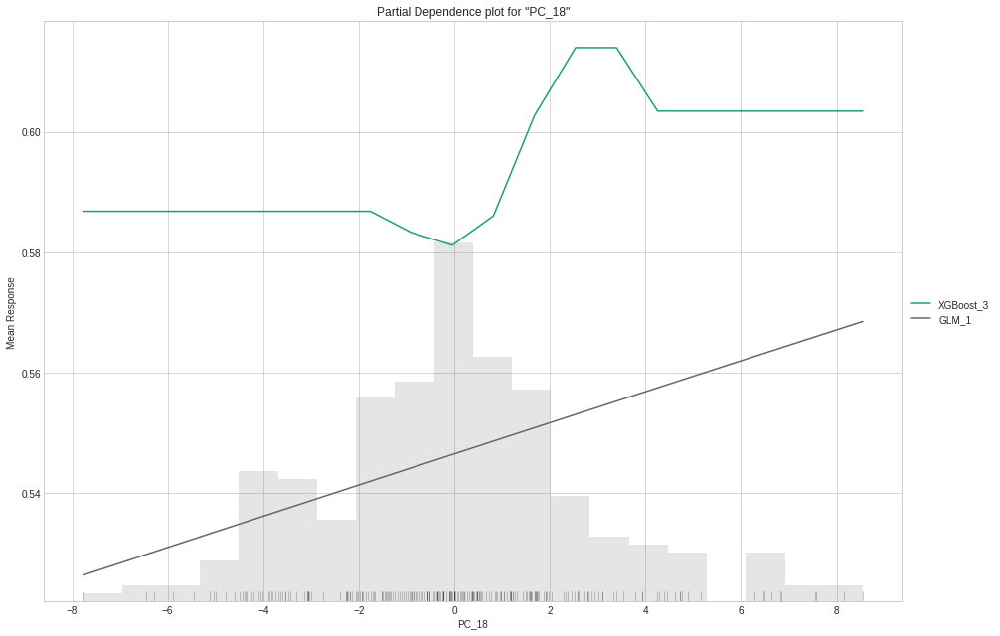



xgboost prediction progress: |████████████████████████████████████████████| 100%


predict,NV,PV
PV,0.049904,0.950096
PV,0.0347911,0.965209
PV,0.0229849,0.977015
PV,0.0306365,0.969364
PV,0.0559958,0.944004
PV,0.0415801,0.95842
PV,0.0610371,0.938963
PV,0.0528209,0.947179
PV,0.0586931,0.941307
PV,0.0140831,0.985917



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:33:37.382: Project: AutoML_20210911_43337382
04:33:37.382: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:33:37.382: Build control seed: 420
04:33:37.382: training frame: Frame key: automl_training_py_1056_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -6393927612194368767
04:33:37.382: validation frame: NULL
04:33:37.383: leaderboard frame: NULL
04:33:37.383: blending frame: NULL
04:33:37.383: response column: arousal
04:33:37.383: fold column: null
04:33:37.383: weights column: null
04:33:37.383: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
XGBoost_3_AutoML_20210911_043337,0.991207,0.140899,0.99786,0.0454676,0.200363,0.0401451,690,0.014268,XGBoost
XGBoost_1_AutoML_20210911_043337,0.947072,0.264107,0.986809,0.153092,0.289908,0.0840464,300,0.020042,XGBoost
XGBoost_2_AutoML_20210911_043337,0.808414,0.401963,0.936638,0.357782,0.357163,0.127566,878,0.008973,XGBoost
GLM_1_AutoML_20210911_043337,0.313047,0.507668,0.724561,0.5,0.403731,0.162999,24,0.005845,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_3_AutoML_20210911_043337


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.8323513269424438: 


,,HA,LA,Error,Rate
0,HA,211.0,0.0,0.0,(0.0/211.0)
1,LA,0.0,822.0,0.0,(0.0/822.0)
2,Total,211.0,822.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

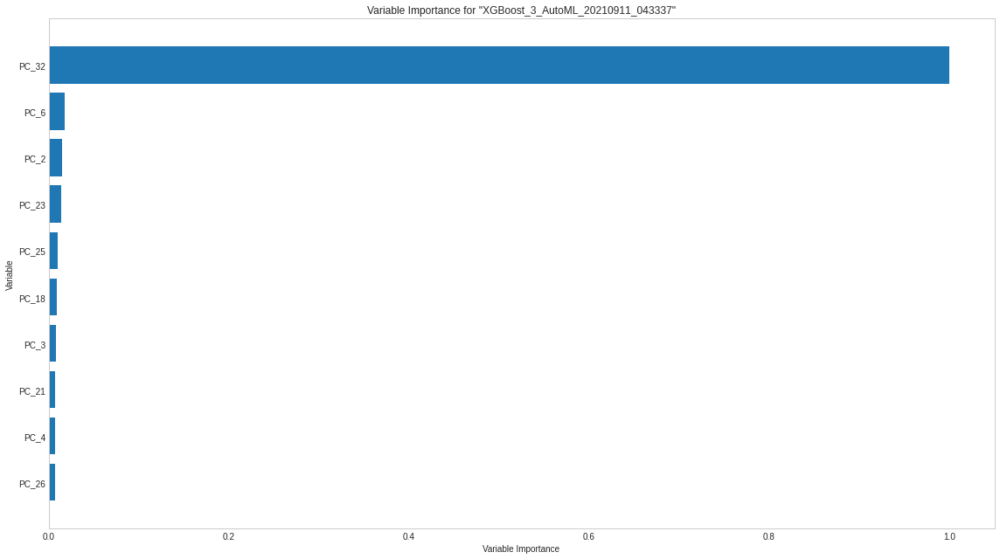

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

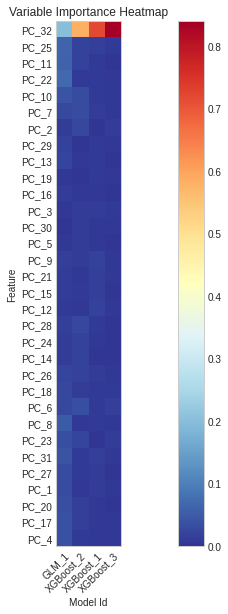

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

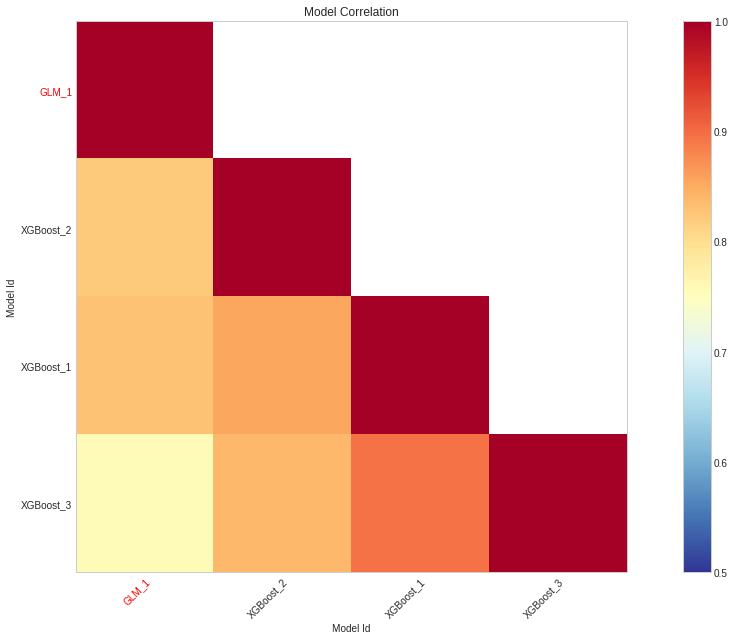

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

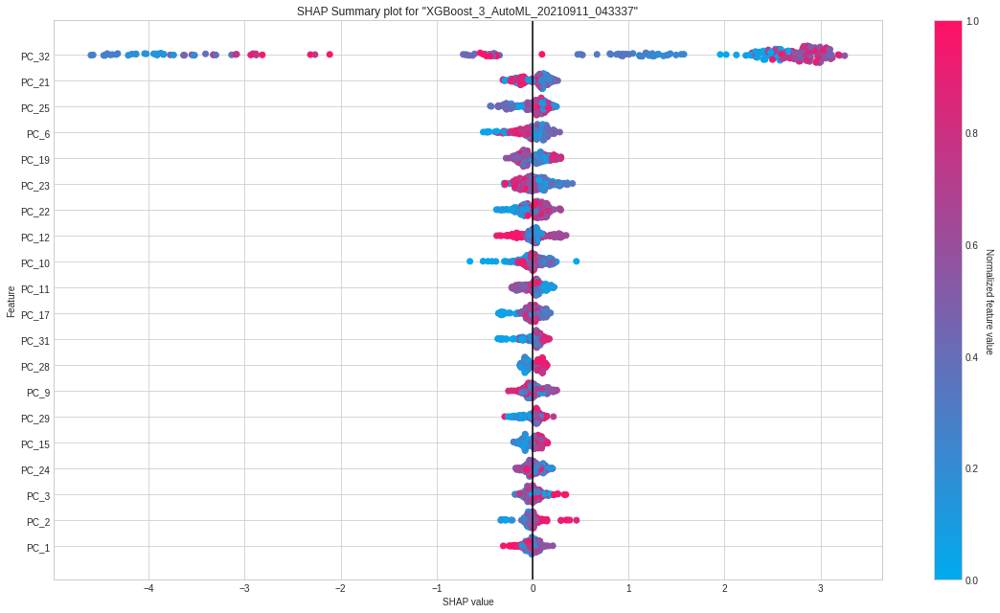

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

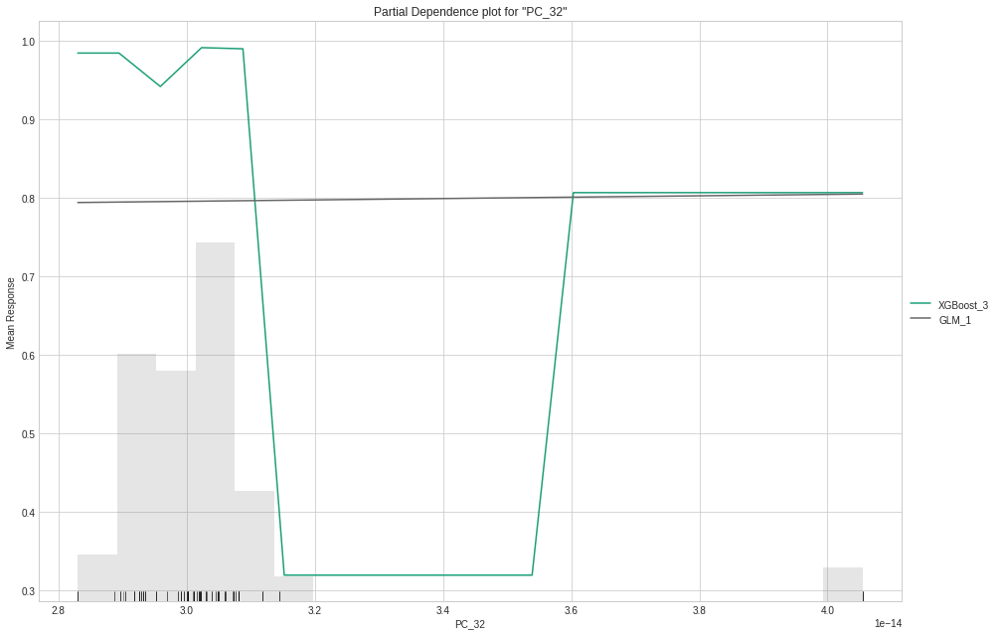

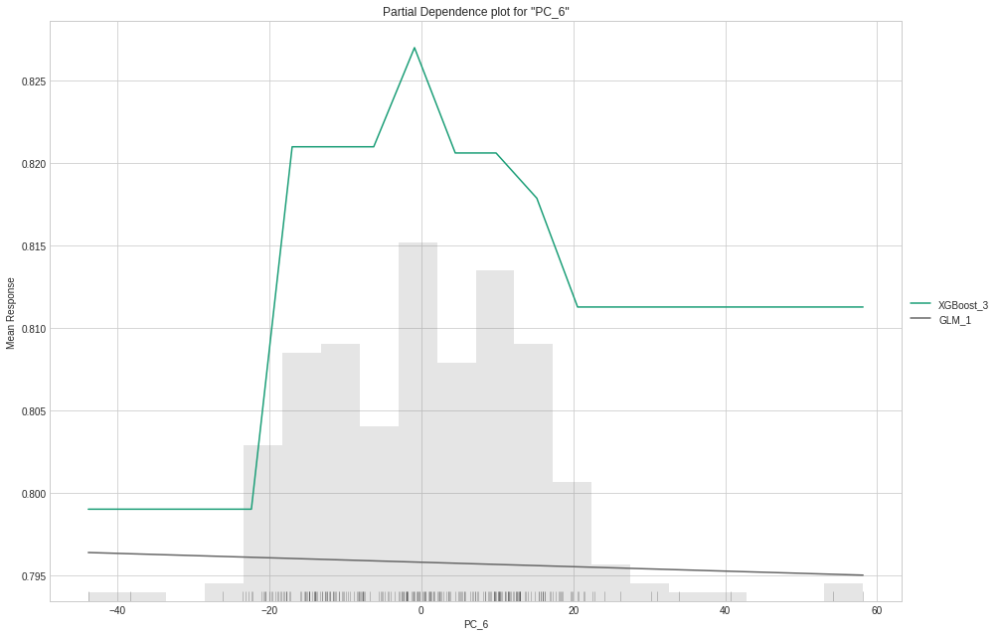

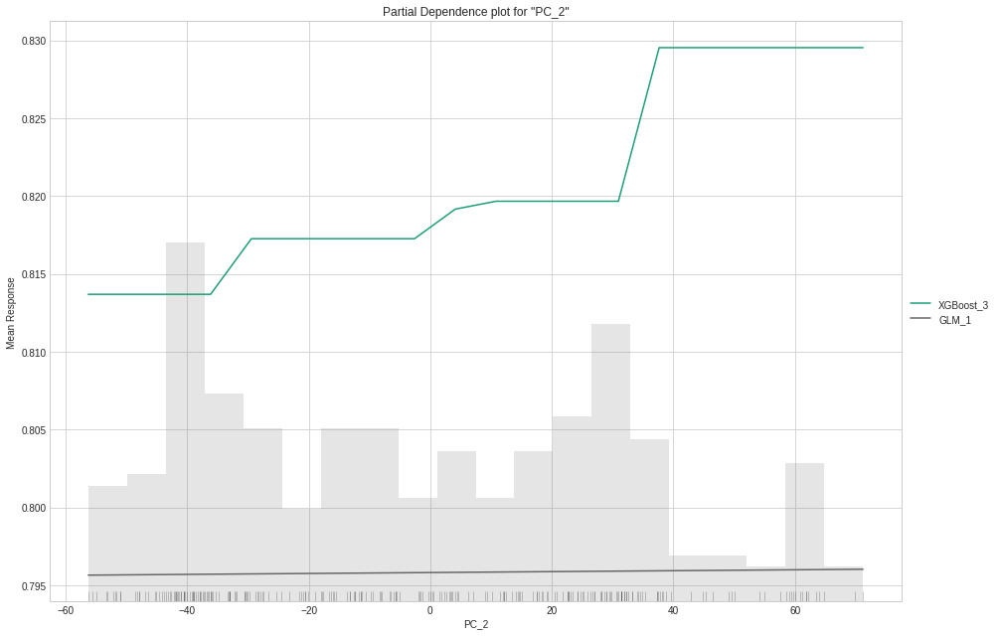

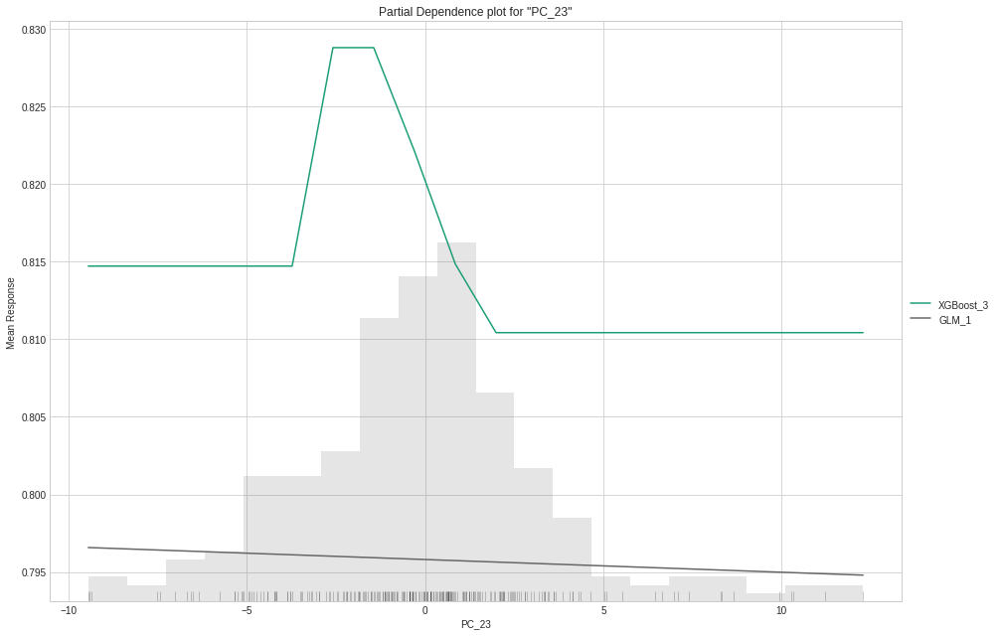

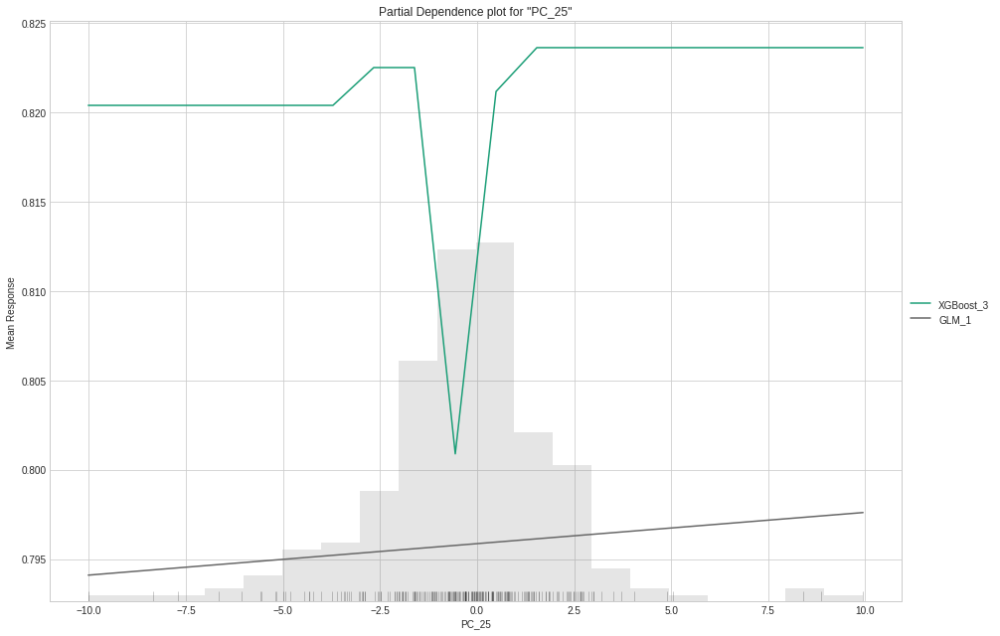



xgboost prediction progress: |████████████████████████████████████████████| 100%


predict,HA,LA
LA,0.0145389,0.985461
LA,0.00579637,0.994204
LA,0.00536221,0.994638
LA,0.00848609,0.991514
LA,0.0160704,0.98393
LA,0.00428736,0.995713
LA,0.0127475,0.987253
LA,0.0149629,0.985037
HA,0.174142,0.825858
LA,0.0654149,0.934585



Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
04:34:03.409: Project: AutoML_20210911_43403409
04:34:03.410: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
04:34:03.410: Build control seed: 420
04:34:03.410: training frame: Frame key: automl_training_py_1134_sid_aafd    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -1583201780906548806
04:34:03.410: validation frame: NULL
04:34:03.410: leaderboard frame: NULL
04:34:03.410: blending frame: NULL
04:34:03.410: response column: valence
04:34:03.410: fold column: null
04:34:03.410: weights column: null
04:34:03.410: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
04:

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
XGBoost_3_AutoML_20210911_043403,0.919916,0.379529,0.936693,0.17763,0.346338,0.11995,426,0.015955,XGBoost
XGBoost_1_AutoML_20210911_043403,0.739053,0.611271,0.764386,0.354469,0.458073,0.209831,274,0.013693,XGBoost
XGBoost_2_AutoML_20210911_043403,0.704145,0.626989,0.759072,0.414497,0.468153,0.219167,192,0.014291,XGBoost
GLM_1_AutoML_20210911_043403,0.478081,0.689362,0.519033,0.490586,0.498114,0.248118,126,0.008483,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_3_AutoML_20210911_043403


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.7964297533035278: 


,,NV,PV,Error,Rate
0,NV,478.0,0.0,0.0,(0.0/478.0)
1,PV,0.0,555.0,0.0,(0.0/555.0)
2,Total,478.0,555.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

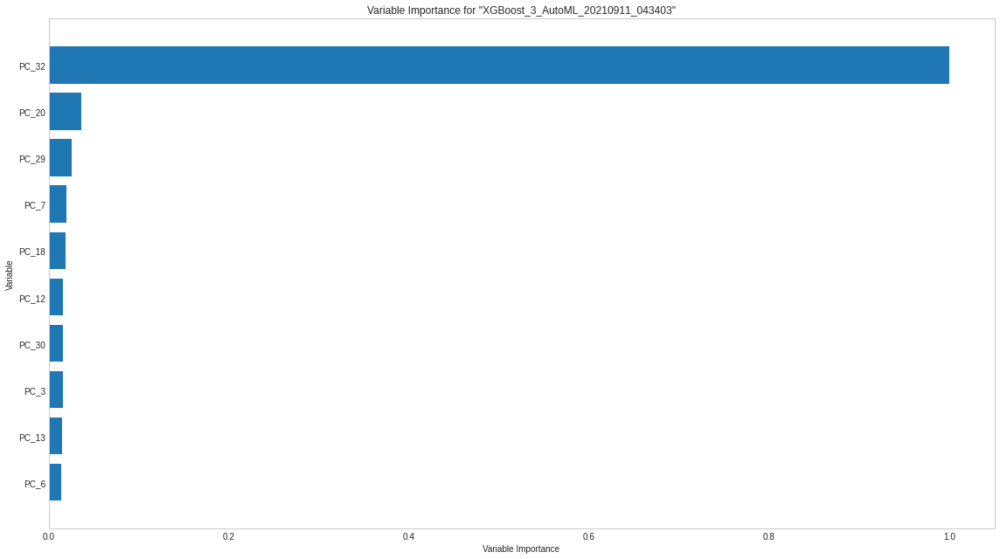

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

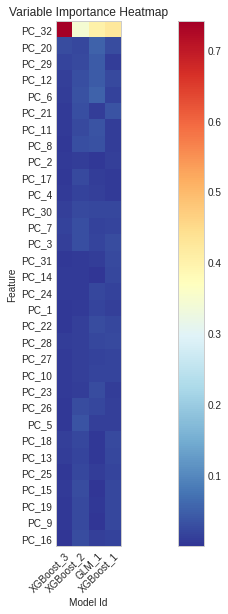

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

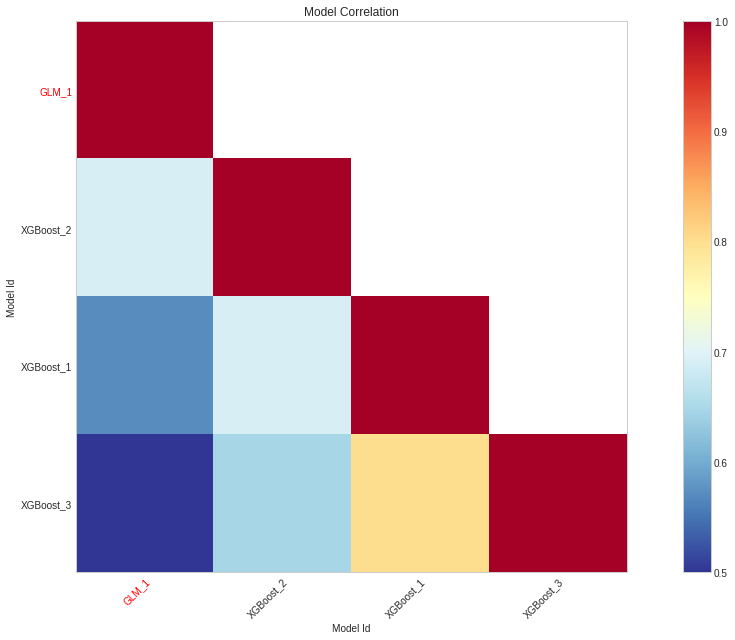

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

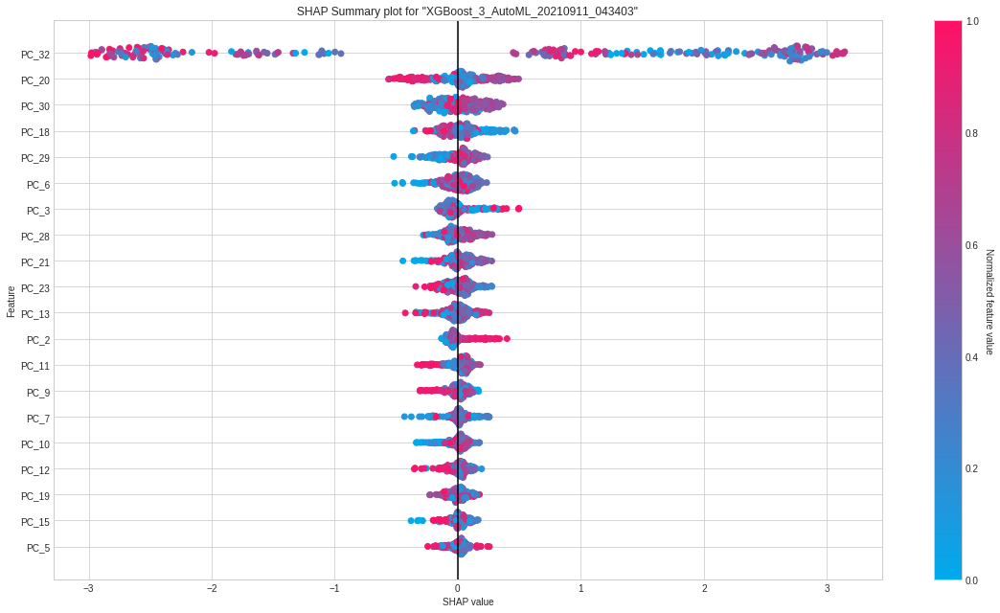

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

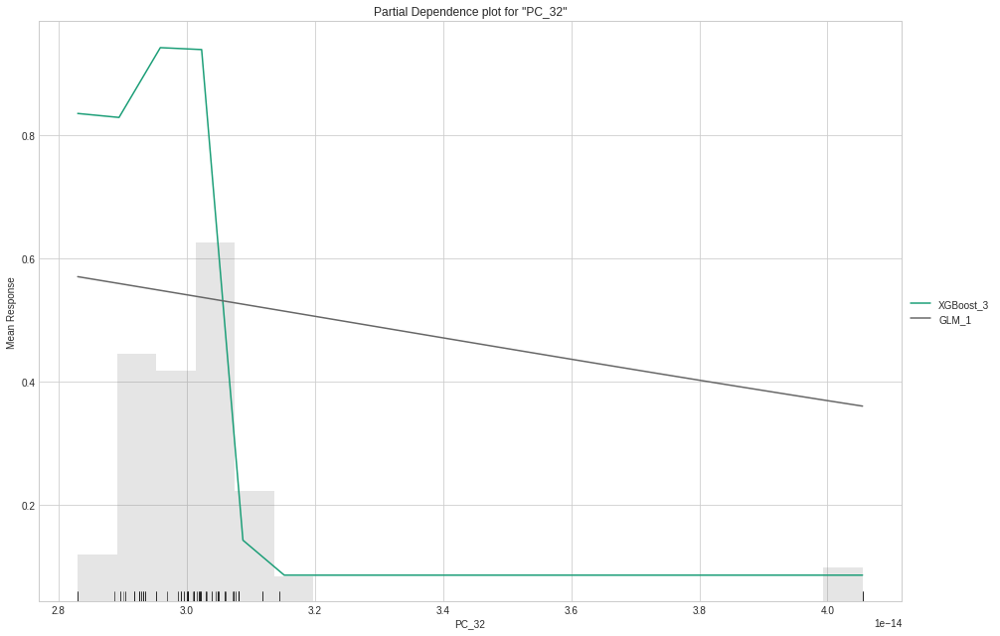

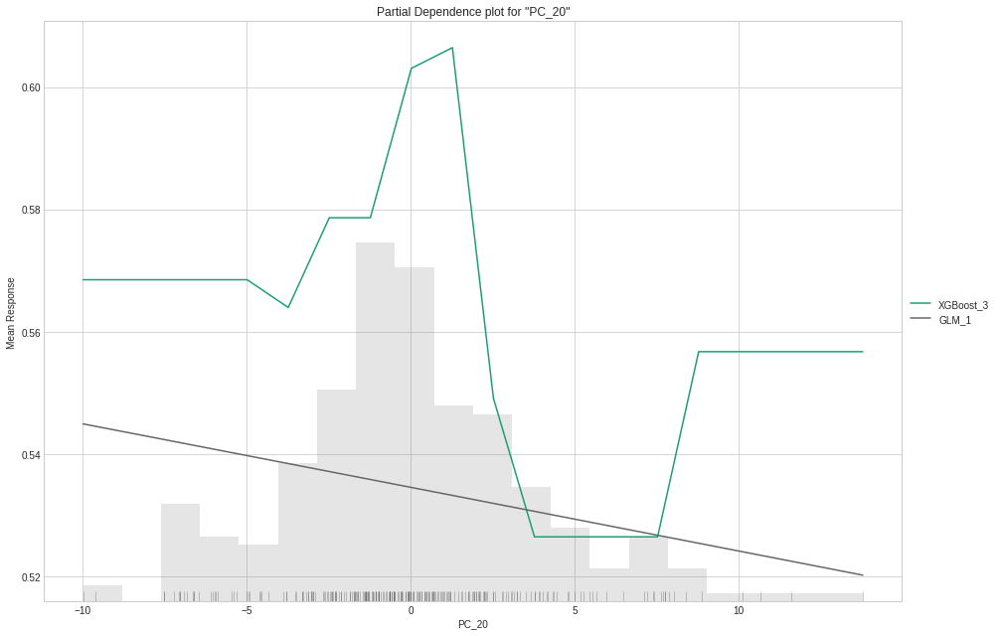

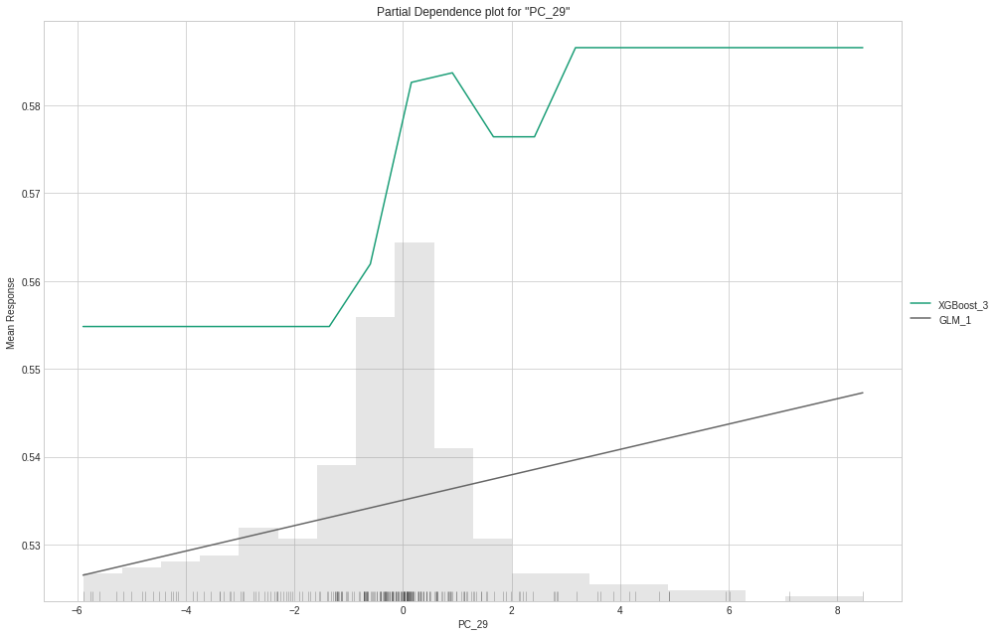

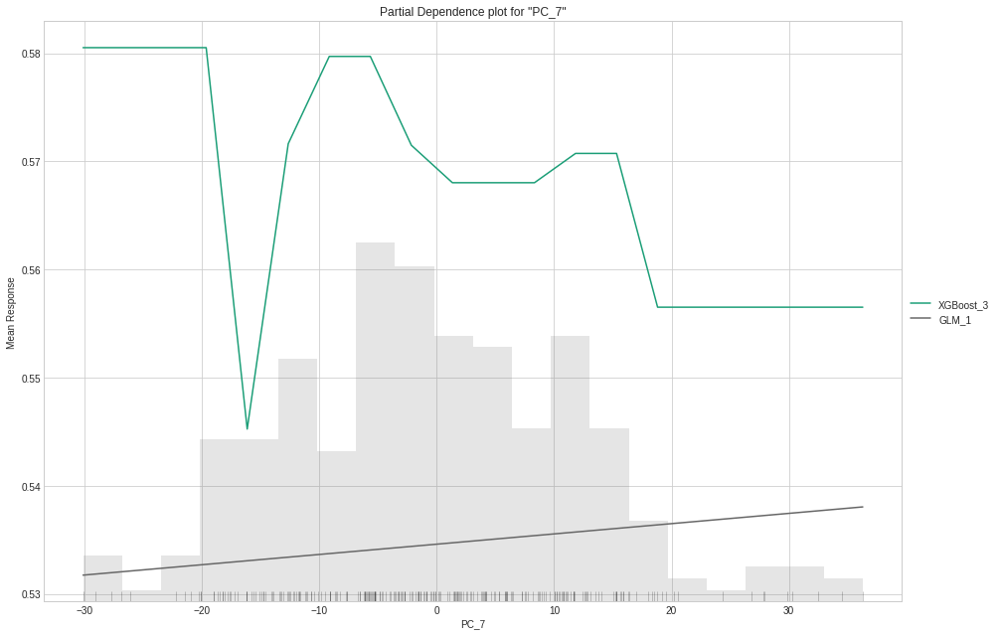

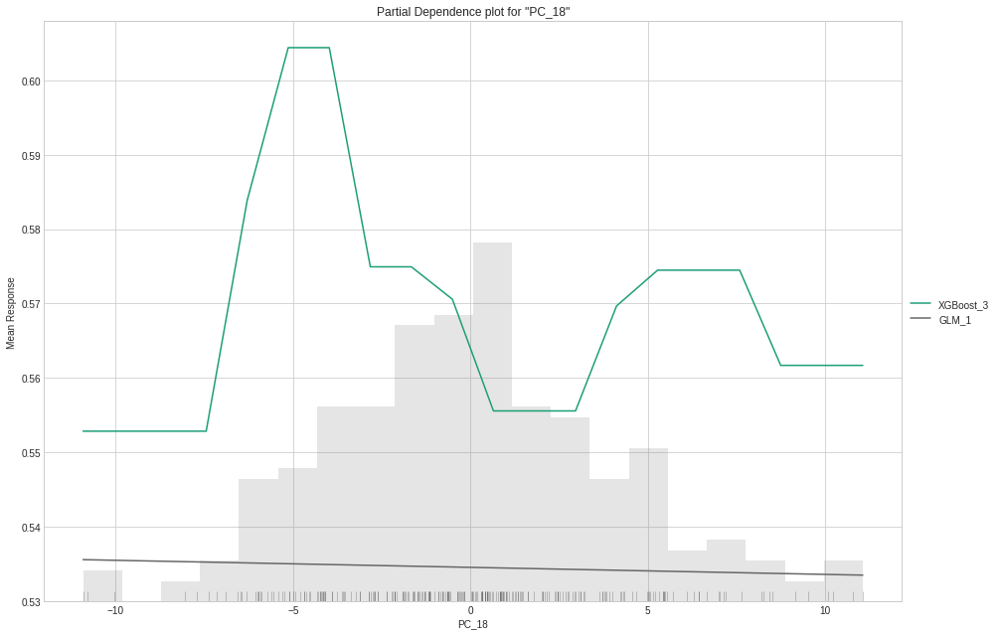



xgboost prediction progress: |████████████████████████████████████████████| 100%


predict,NV,PV
PV,0.0167323,0.983268
PV,0.06056,0.93944
PV,0.0277328,0.972267
PV,0.0603218,0.939678
PV,0.103356,0.896644
PV,0.0272489,0.972751
PV,0.123131,0.876869
PV,0.0433043,0.956696
NV,0.513934,0.486066
PV,0.202193,0.797807



CPU times: user 1min 34s, sys: 10.1 s, total: 1min 45s
Wall time: 2min 38s


In [ ]:
%%time
subjects = [0, 1, 2]
train_subjects(subjects, 4, ["StackedEnsemble"])

#Entrenando Sujetos con etiquetas muy imbalanceadas


==== Subject 11 | Label Arousal ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |
05:31:53.857: Project: AutoML_20210910_53153856
05:31:53.857: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:31:53.857: Build control seed: 420
05:31:53.857: training frame: Frame key: automl_training_py_1220_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267376  checksum: 4957307265454385053
05:31:53.857: validation frame: NULL
05:31:53.857: leaderboard frame: NULL
05:31:53.857: blending frame: NULL
05:31:53.857: response column: arousal
05:31:53.857: fold column: null
05:31:53.857: weights column: null
05:31:53.857: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
05:31

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_AutoML_20210910_053153,1,0.000511004,1,0,0.000737343,5.43674e-07,605,0.236549,StackedEnsemble
GBM_2_AutoML_20210910_053153,1,0.000379575,1,0,0.00328335,1.07804e-05,5224,0.10769,GBM
StackedEnsemble_BestOfFamily_AutoML_20210910_053153,1,0.00180829,1,0,0.0126639,0.000160374,423,0.096619,StackedEnsemble
GBM_1_AutoML_20210910_053153,1,9.39923e-10,1,0,2.18586e-08,4.77797e-16,8367,0.164165,GBM
XGBoost_3_AutoML_20210910_053153,0.992349,0.132897,0.962896,0.0469251,0.195566,0.0382462,386,0.008994,XGBoost
XGBoost_1_AutoML_20210910_053153,0.912187,0.300103,0.6569,0.155828,0.312028,0.0973617,194,0.008043,XGBoost
XGBoost_2_AutoML_20210910_053153,0.884398,0.329753,0.583554,0.217391,0.32204,0.10371,135,0.007503,XGBoost
DRF_1_AutoML_20210910_053153,0.793416,0.463046,0.427796,0.271371,0.382032,0.145948,490,0.015817,DRF
GLM_1_AutoML_20210910_053153,0.369192,0.479045,0.13829,0.499407,0.388102,0.150623,20,0.006363,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_AutoML_20210910_053153


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9993190208982172: 


,,HA,LA,Error,Rate
0,HA,843.0,0.0,0.0,(0.0/843.0)
1,LA,0.0,190.0,0.0,(0.0/190.0)
2,Total,843.0,190.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

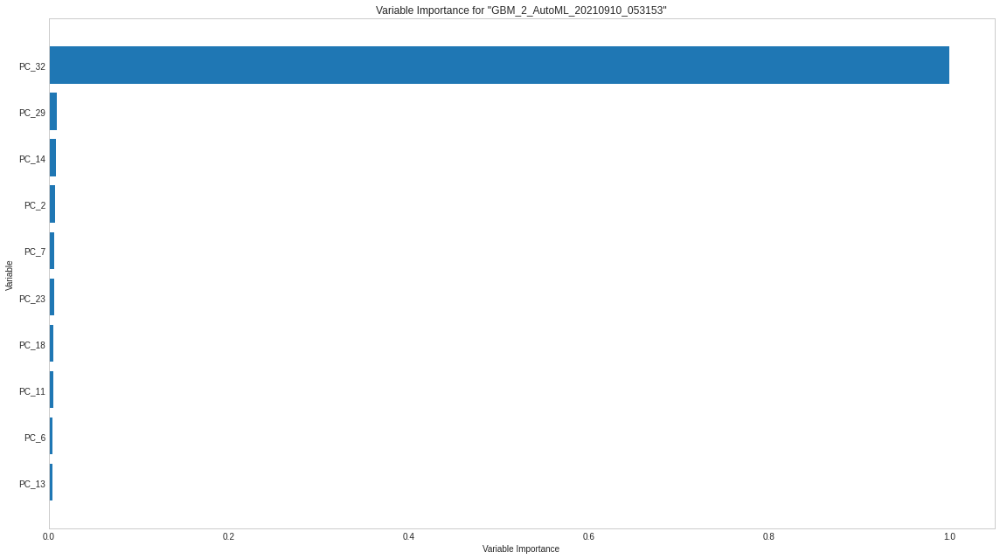

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

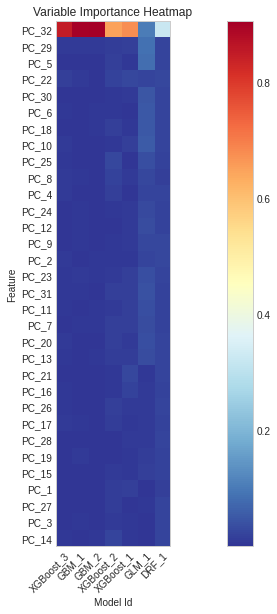

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

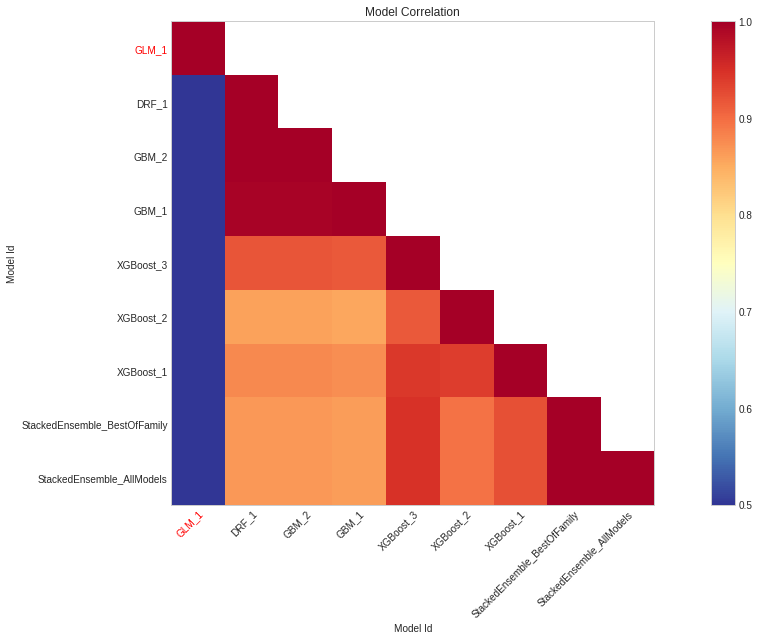

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

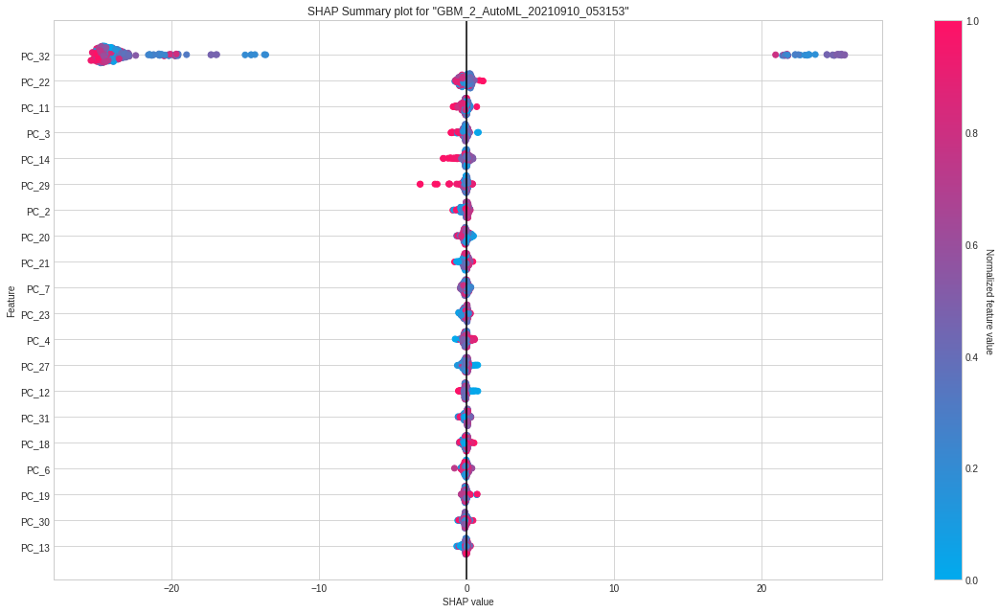

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

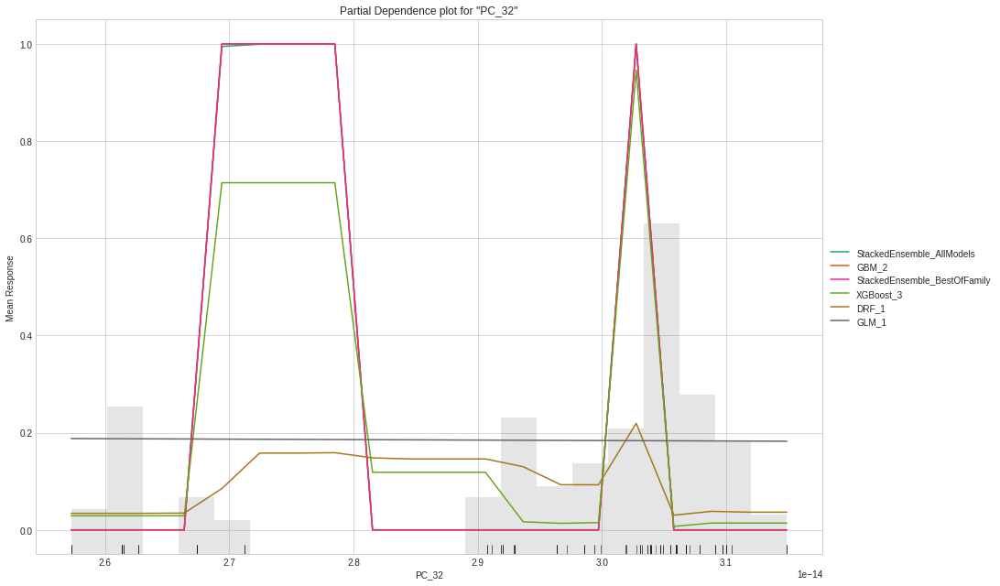

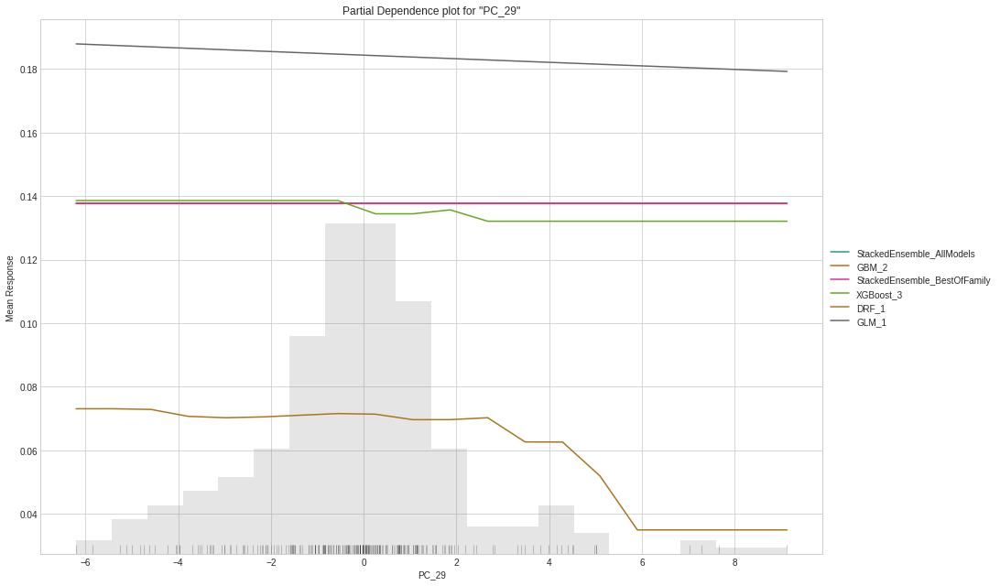

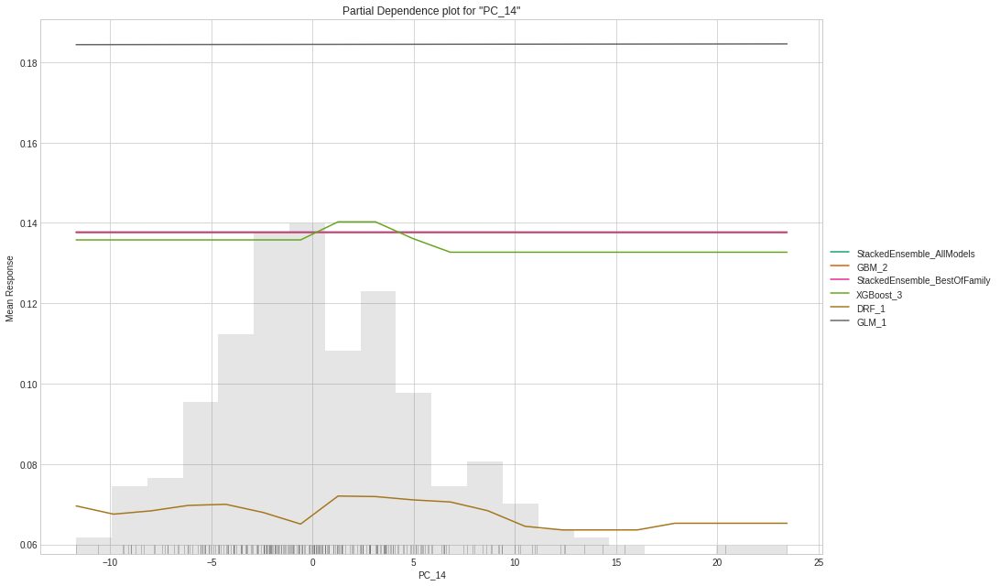

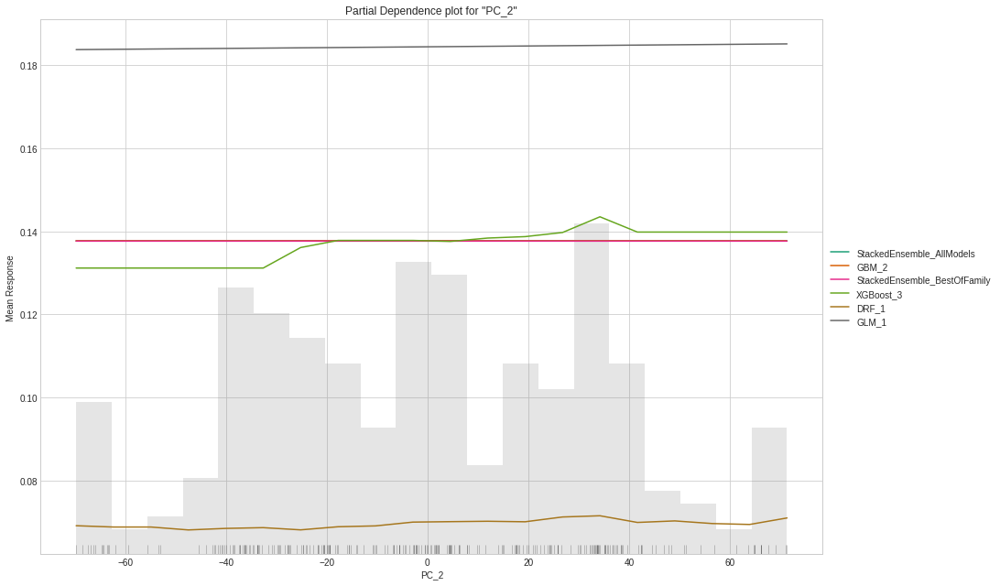

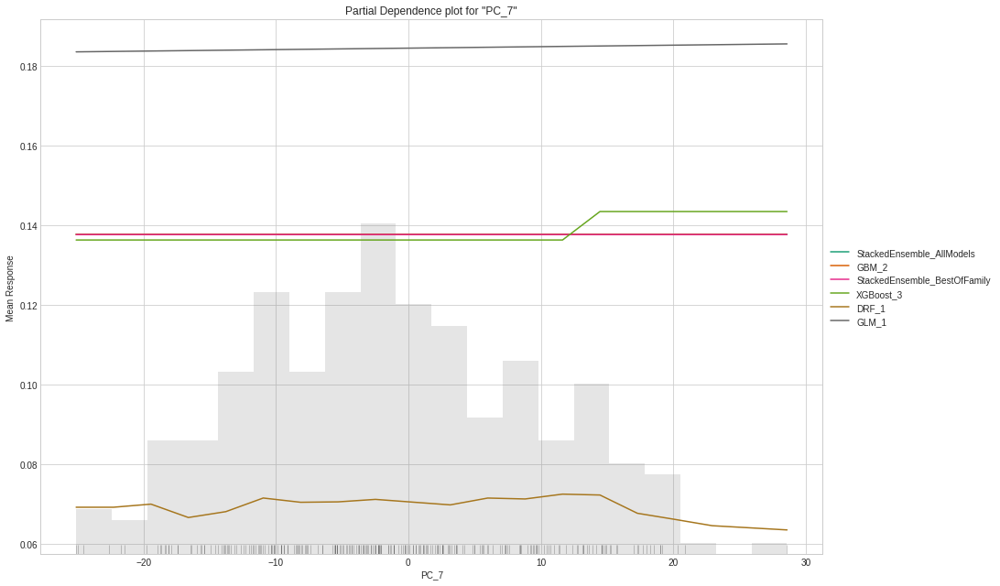



stackedensemble prediction progress: |████████████████████████████████████| 100%


predict,HA,LA
HA,0.999766,0.000234451
HA,0.999766,0.000234451
HA,0.999766,0.000234451
HA,0.999766,0.000234451
HA,0.999766,0.000234451
HA,0.999766,0.000234451
HA,0.999766,0.000234451
HA,0.999766,0.000234451
HA,0.999766,0.000234451
HA,0.999766,0.000234451




==== Subject 11 | Label Valence ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |
05:33:57.780: Project: AutoML_20210910_53357780
05:33:57.781: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:33:57.781: Build control seed: 420
05:33:57.781: training frame: Frame key: automl_training_py_1344_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -7917853864018137326
05:33:57.781: validation frame: NULL
05:33:57.781: leaderboard frame: NULL
05:33:57.781: blending frame: NULL
05:33:57.781: response column: valence
05:33:57.781: fold column: null
05:33:57.781: weights column: null
05:33:57.781: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
05:

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_BestOfFamily_AutoML_20210910_053357,1,0.000848706,1,0,0.000848796,7.20455e-07,619,0.450868,StackedEnsemble
GBM_1_AutoML_20210910_053357,1,4.19335e-12,1,0,3.58456e-11,1.28491e-21,15126,0.300169,GBM
StackedEnsemble_AllModels_AutoML_20210910_053357,1,0.000848883,1,0,0.000849011,7.20819e-07,633,0.316828,StackedEnsemble
GBM_2_AutoML_20210910_053357,1,0.000441538,1,0,0.00337066,1.13613e-05,3923,0.090261,GBM
XGBoost_3_AutoML_20210910_053357,0.991795,0.176812,0.99234,0.0443584,0.215715,0.0465328,259,0.010084,XGBoost
XGBoost_1_AutoML_20210910_053357,0.924491,0.35352,0.932195,0.177154,0.336597,0.113298,380,0.007692,XGBoost
XGBoost_2_AutoML_20210910_053357,0.913962,0.384211,0.925346,0.172868,0.349759,0.122332,689,0.007393,XGBoost
DRF_1_AutoML_20210910_053357,0.768746,0.558186,0.831856,0.287614,0.43569,0.189826,453,0.02524,DRF
GLM_1_AutoML_20210910_053357,0.661355,0.619278,0.736636,0.5,0.469058,0.220015,276,0.007029,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_BestOfFamily_AutoML_20210910_053357


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.99933439064813: 


,,NV,PV,Error,Rate
0,NV,503.0,0.0,0.0,(0.0/503.0)
1,PV,0.0,530.0,0.0,(0.0/530.0)
2,Total,503.0,530.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

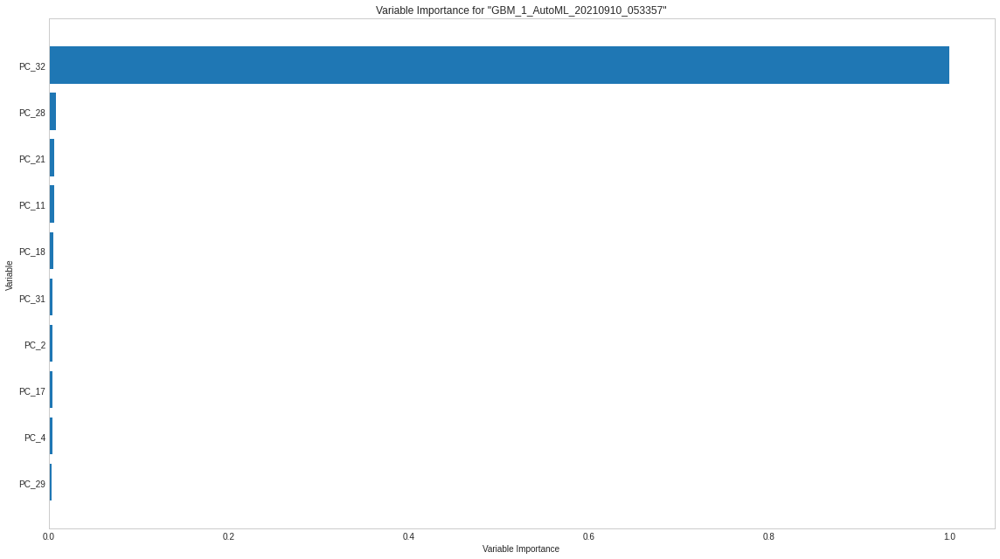

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

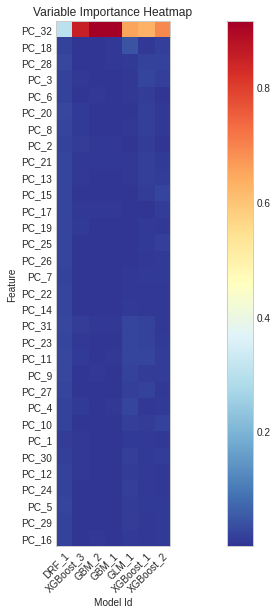

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

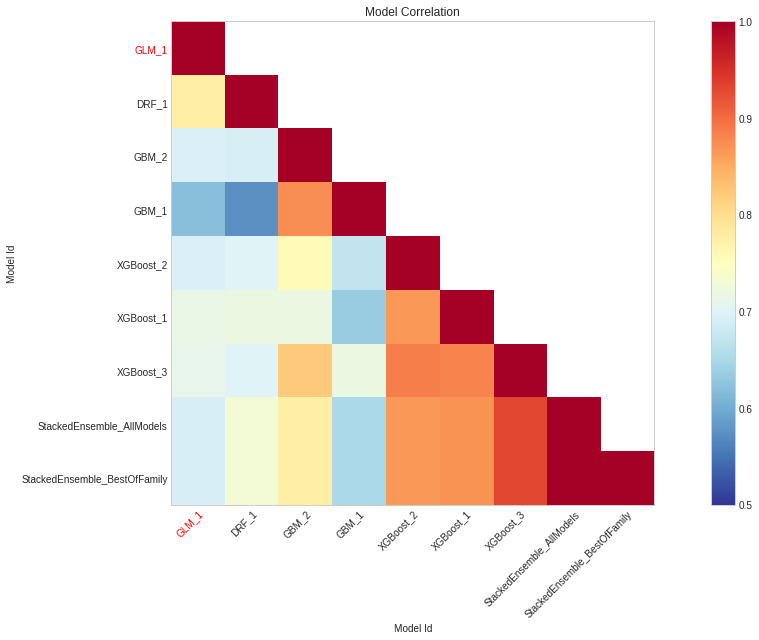

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

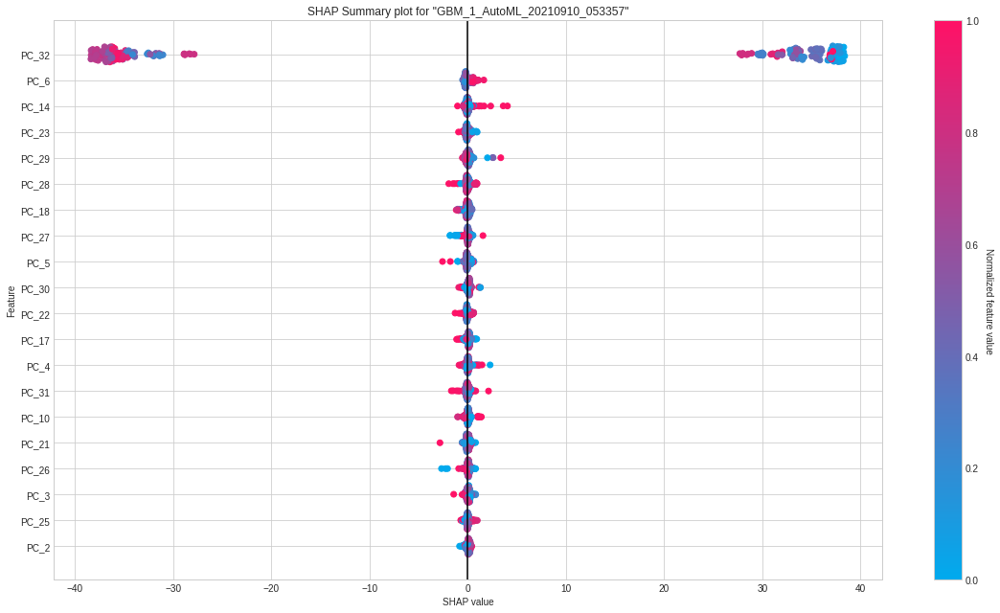

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

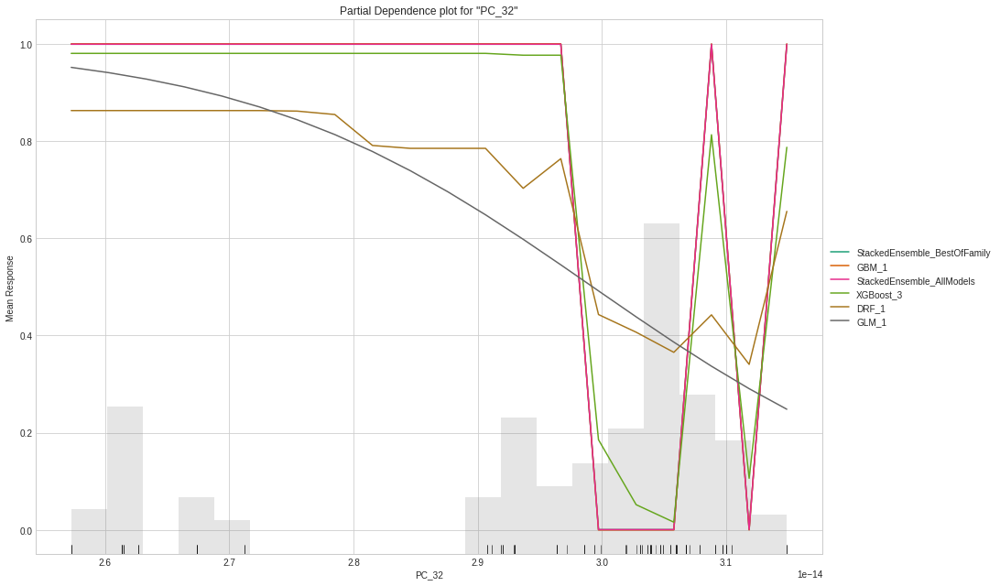

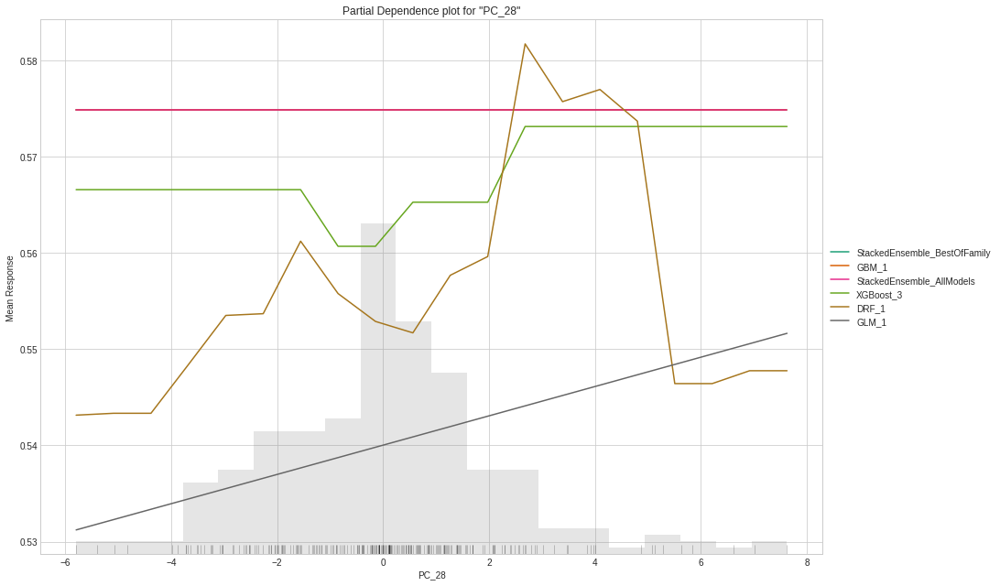

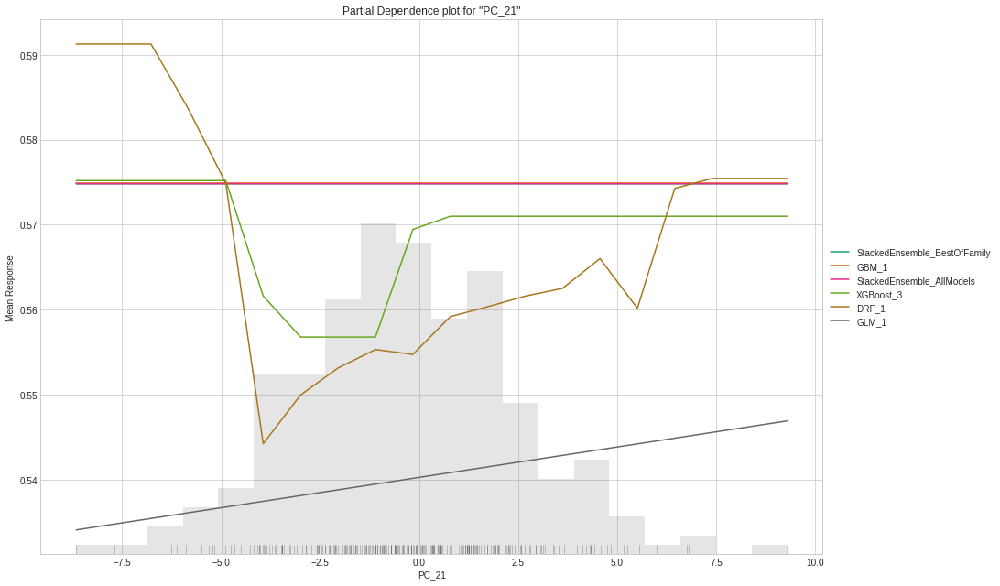

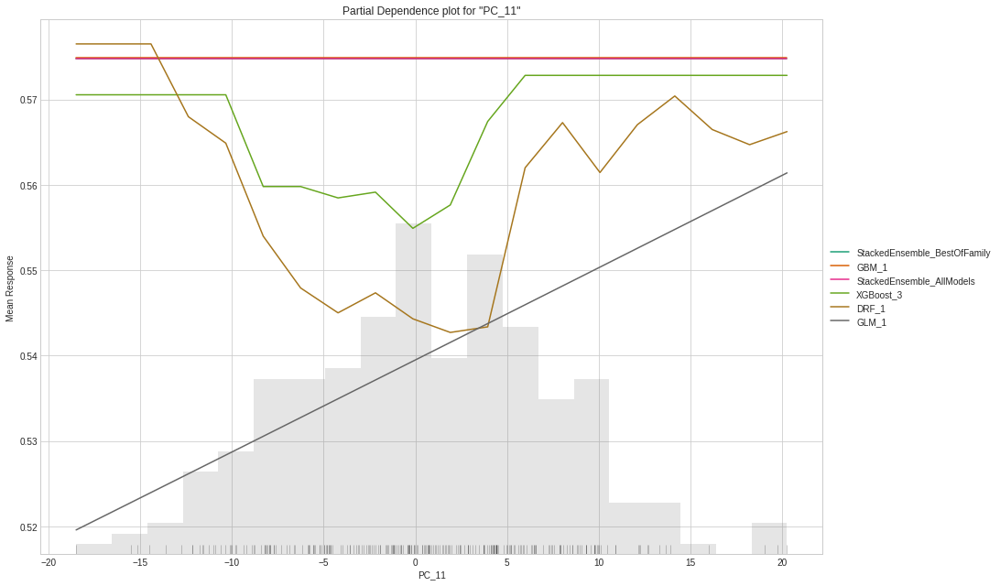

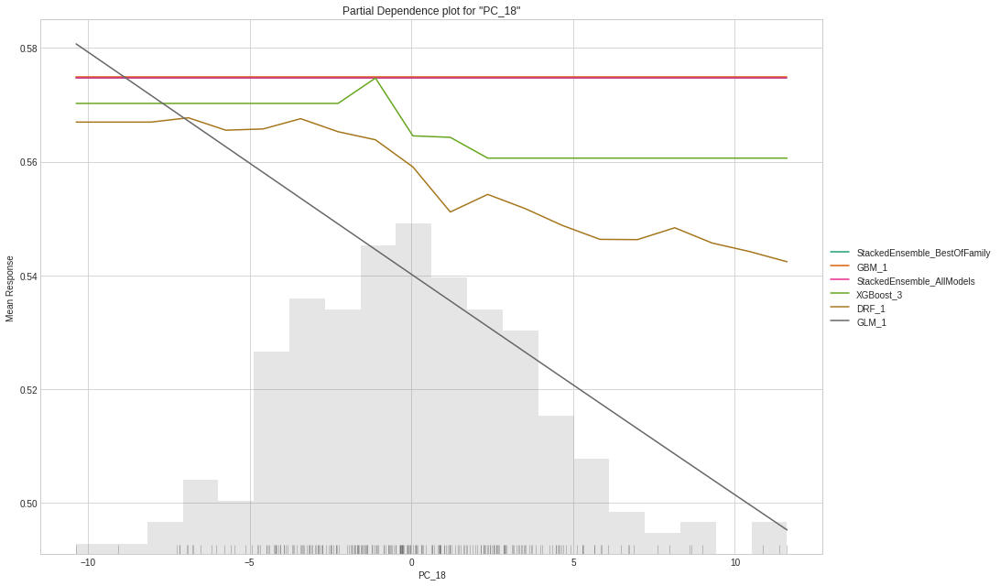



stackedensemble prediction progress: |████████████████████████████████████| 100%


predict,NV,PV
PV,0.000665609,0.999334
PV,0.000665609,0.999334
PV,0.000665609,0.999334
PV,0.000665609,0.999334
PV,0.000665609,0.999334
PV,0.000665609,0.999334
PV,0.000665609,0.999334
PV,0.000665609,0.999334
PV,0.000665609,0.999334
PV,0.000665609,0.999334




==== Subject 19 | Label Arousal ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |
05:36:46.199: Project: AutoML_20210910_53646198
05:36:46.199: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:36:46.199: Build control seed: 420
05:36:46.199: training frame: Frame key: automl_training_py_1473_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: 2176671927158912069
05:36:46.199: validation frame: NULL
05:36:46.199: leaderboard frame: NULL
05:36:46.199: blending frame: NULL
05:36:46.199: response column: arousal
05:36:46.199: fold column: null
05:36:46.199: weights column: null
05:36:46.199: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
05:3

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_AutoML_20210910_053646,0.998474,0.0421317,0.994773,0.0193193,0.10903,0.0118876,594,0.050023,StackedEnsemble
StackedEnsemble_BestOfFamily_AutoML_20210910_053646,0.998441,0.0423531,0.994675,0.0224424,0.109373,0.0119625,437,0.028384,StackedEnsemble
GBM_1_AutoML_20210910_053646,0.991231,0.152698,0.965927,0.0273903,0.220225,0.0484991,1123,0.023328,GBM
GBM_2_AutoML_20210910_053646,0.989227,0.170392,0.960505,0.0507859,0.233315,0.0544359,1215,0.025857,GBM
XGBoost_3_AutoML_20210910_053646,0.988464,0.195208,0.965978,0.0651437,0.241377,0.0582628,287,0.007921,XGBoost
XGBoost_1_AutoML_20210910_053646,0.802223,0.418369,0.582294,0.288574,0.365997,0.133954,320,0.007445,XGBoost
XGBoost_2_AutoML_20210910_053646,0.788047,0.449822,0.445143,0.275723,0.38356,0.147118,382,0.007304,XGBoost
DRF_1_AutoML_20210910_053646,0.670545,0.50748,0.482584,0.379739,0.399816,0.159852,615,0.017435,DRF
GLM_1_AutoML_20210910_053646,0.631509,0.501226,0.413988,0.422041,0.403215,0.162582,360,0.006131,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_AutoML_20210910_053646


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9999303603047304: 


,,HA,LA,Error,Rate
0,HA,804.0,0.0,0.0,(0.0/804.0)
1,LA,0.0,229.0,0.0,(0.0/229.0)
2,Total,804.0,229.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

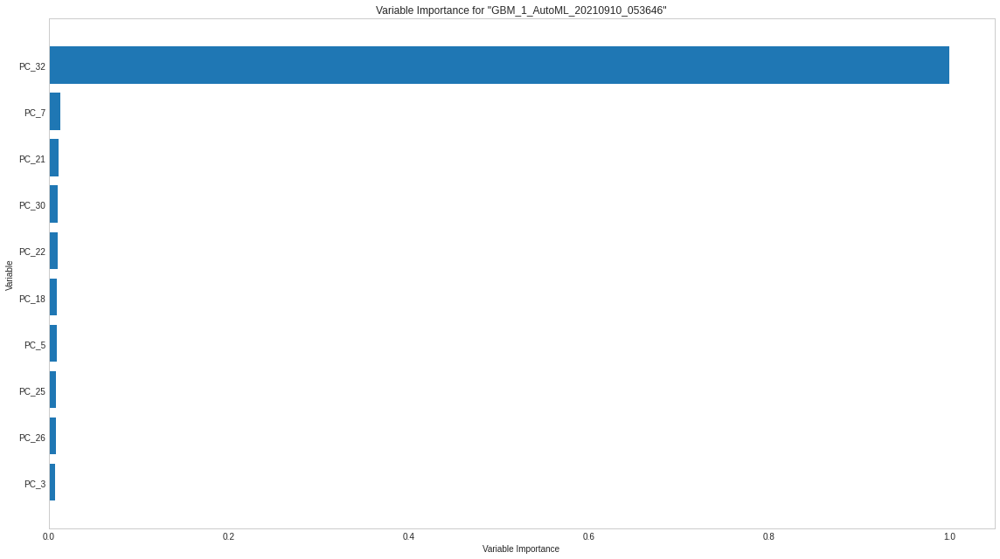

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

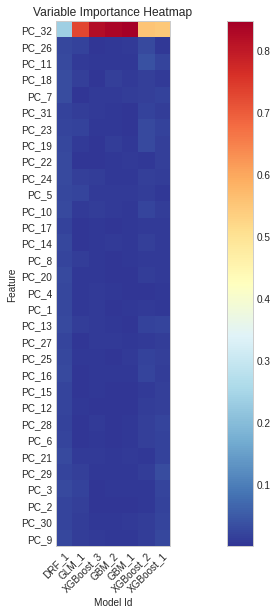

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

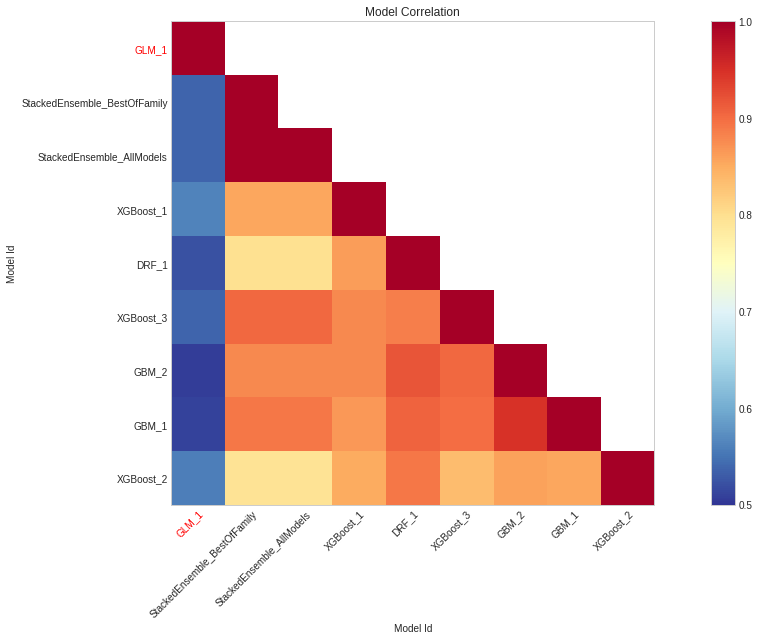

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

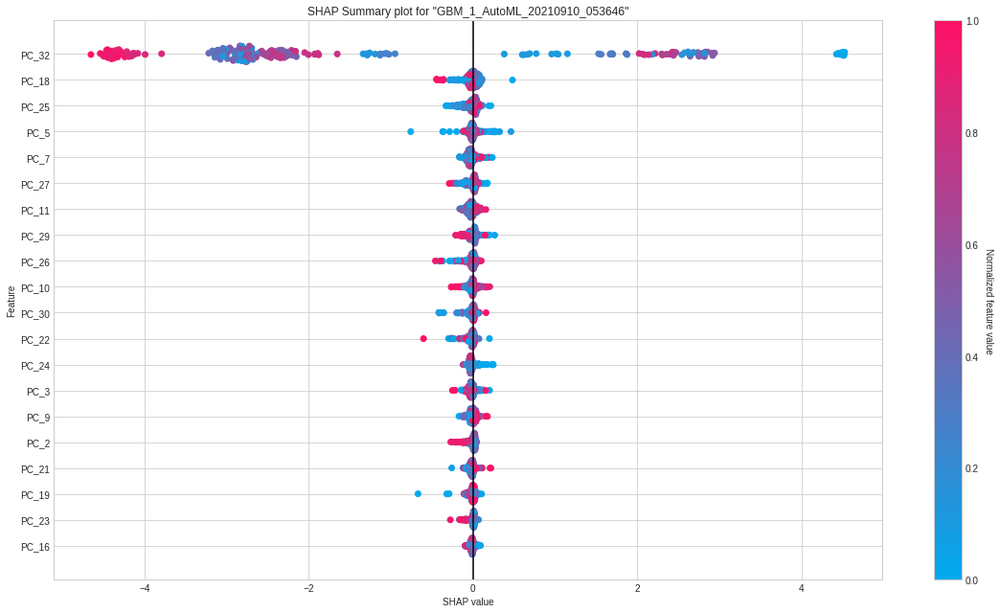

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

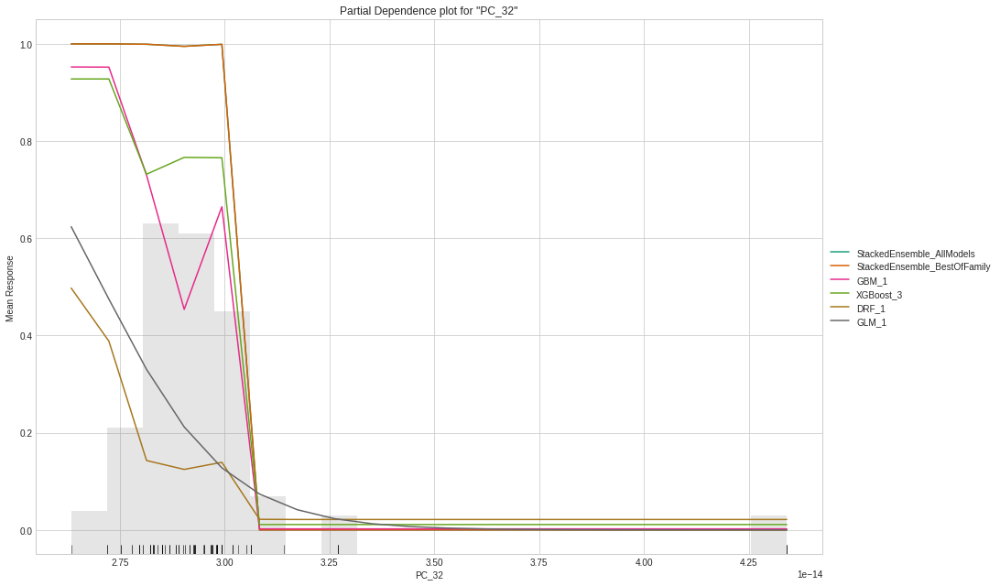

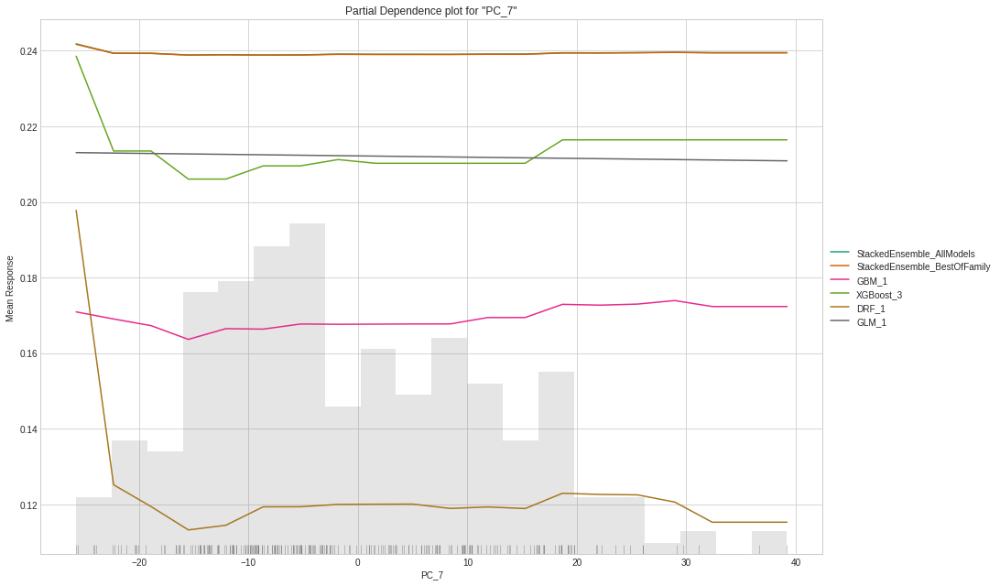

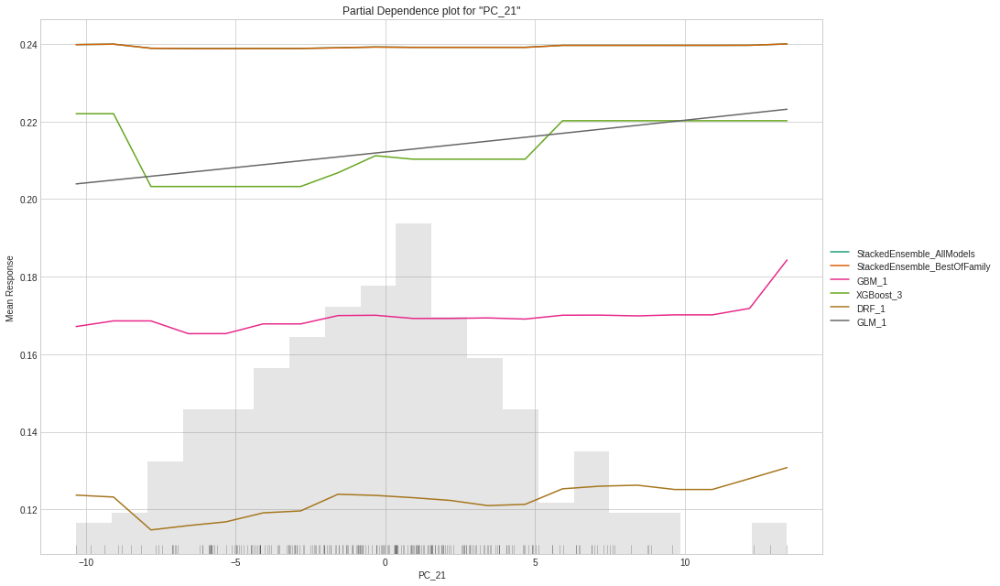

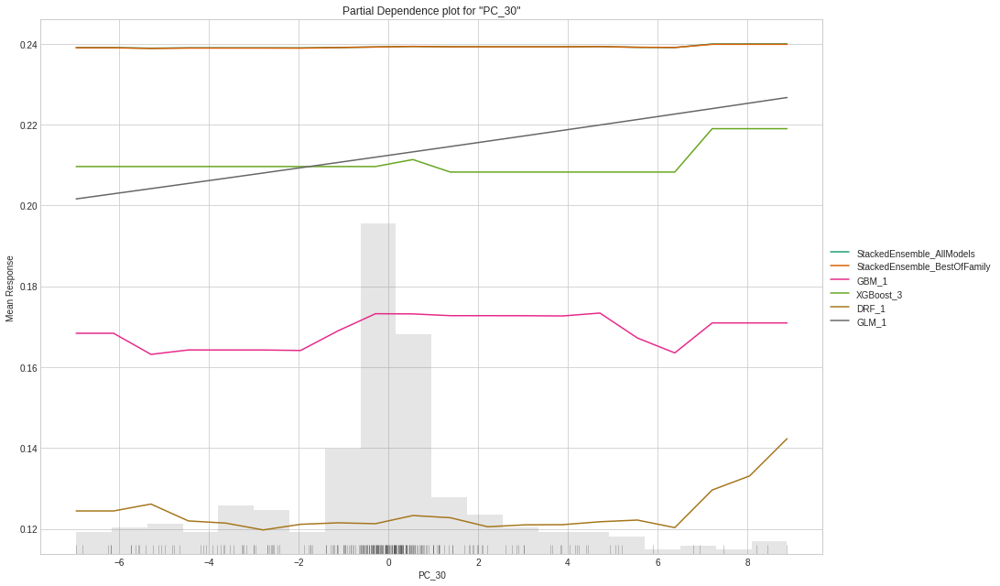

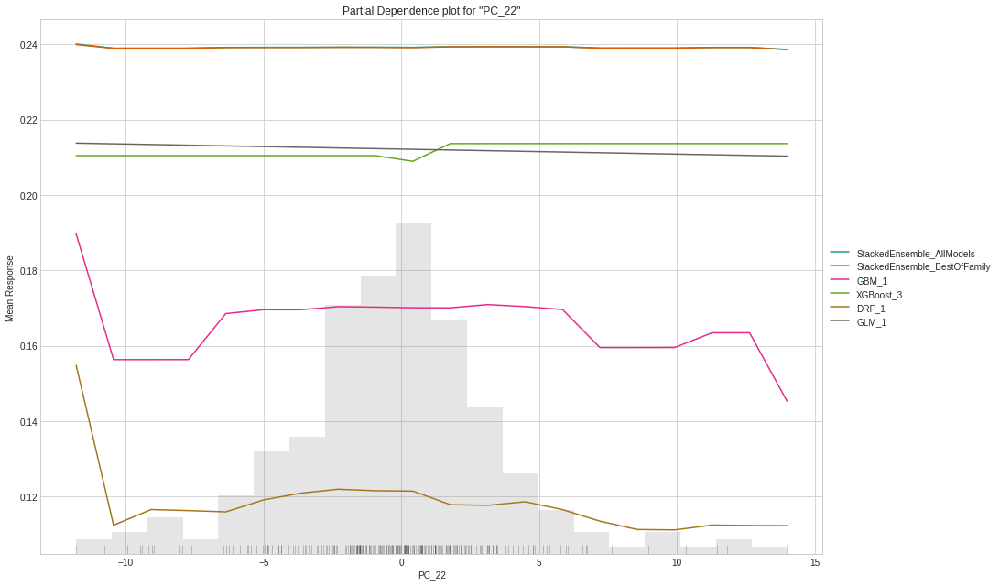



stackedensemble prediction progress: |████████████████████████████████████| 100%


predict,HA,LA
LA,0.00142022,0.99858
LA,0.000632981,0.999367
LA,0.000941378,0.999059
LA,2.4693e-05,0.999975
LA,0.00315645,0.996844
LA,0.000295923,0.999704
LA,0.000349024,0.999651
LA,0.00382638,0.996174
HA,0.999978,2.24859e-05
HA,0.999991,8.60944e-06




==== Subject 19 | Label Valence ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |
05:37:36.460: Project: AutoML_20210910_53736460
05:37:36.462: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:37:36.462: Build control seed: 420
05:37:36.463: training frame: Frame key: automl_training_py_1588_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: 4972938779586353442
05:37:36.463: validation frame: NULL
05:37:36.463: leaderboard frame: NULL
05:37:36.463: blending frame: NULL
05:37:36.463: response column: valence
05:37:36.463: fold column: null
05:37:36.463: weights column: null
05:37:36.463: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
05:3

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_AutoML_20210910_053736,0.998468,0.0500194,0.998835,0.0185128,0.121851,0.0148476,478,0.085408,StackedEnsemble
StackedEnsemble_BestOfFamily_AutoML_20210910_053736,0.99836,0.0516281,0.998746,0.0180763,0.12448,0.0154952,660,0.048795,StackedEnsemble
GBM_2_AutoML_20210910_053736,0.998153,0.0651236,0.998571,0.0206896,0.135943,0.0184804,2160,0.043216,GBM
GBM_1_AutoML_20210910_053736,0.996459,0.0913567,0.997477,0.0241739,0.149489,0.0223468,1424,0.037363,GBM
XGBoost_3_AutoML_20210910_053736,0.968512,0.254827,0.975531,0.100637,0.275393,0.0758416,336,0.010835,XGBoost
XGBoost_1_AutoML_20210910_053736,0.869742,0.44258,0.901091,0.251173,0.384153,0.147574,489,0.010757,XGBoost
XGBoost_2_AutoML_20210910_053736,0.838968,0.486328,0.876128,0.326572,0.404288,0.163449,270,0.009237,XGBoost
DRF_1_AutoML_20210910_053736,0.779649,0.562199,0.790417,0.291258,0.435485,0.189647,417,0.033299,DRF
GLM_1_AutoML_20210910_053736,0.328769,0.693175,0.445621,0.5,0.499979,0.249979,22,0.008663,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_AutoML_20210910_053736


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9995113819121205: 


,,NV,PV,Error,Rate
0,NV,459.0,0.0,0.0,(0.0/459.0)
1,PV,0.0,574.0,0.0,(0.0/574.0)
2,Total,459.0,574.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

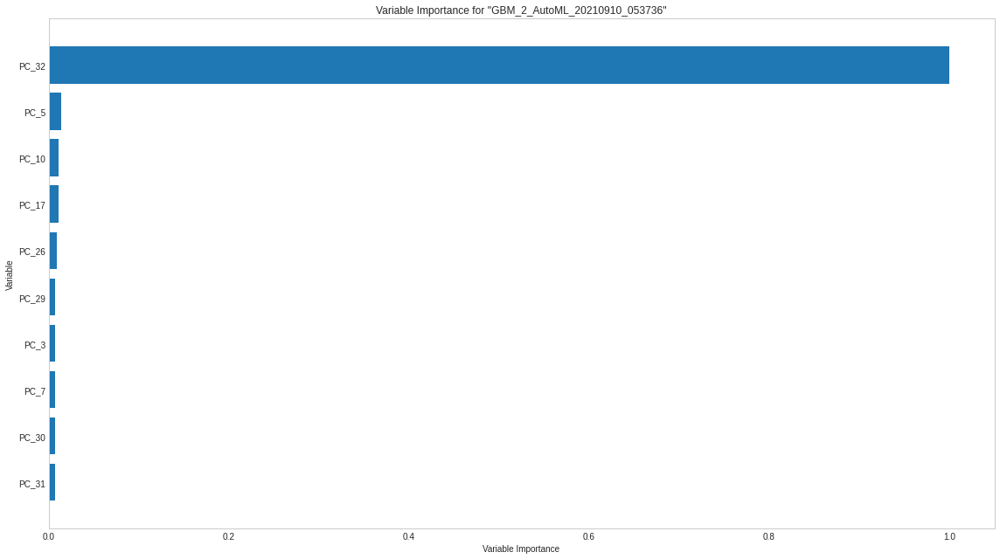

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

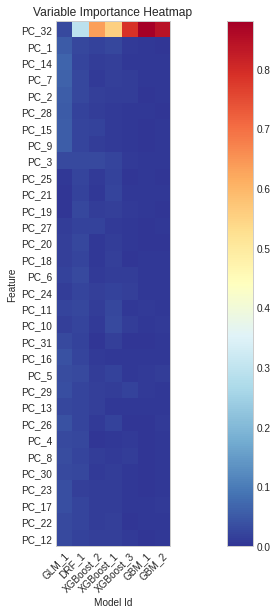

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

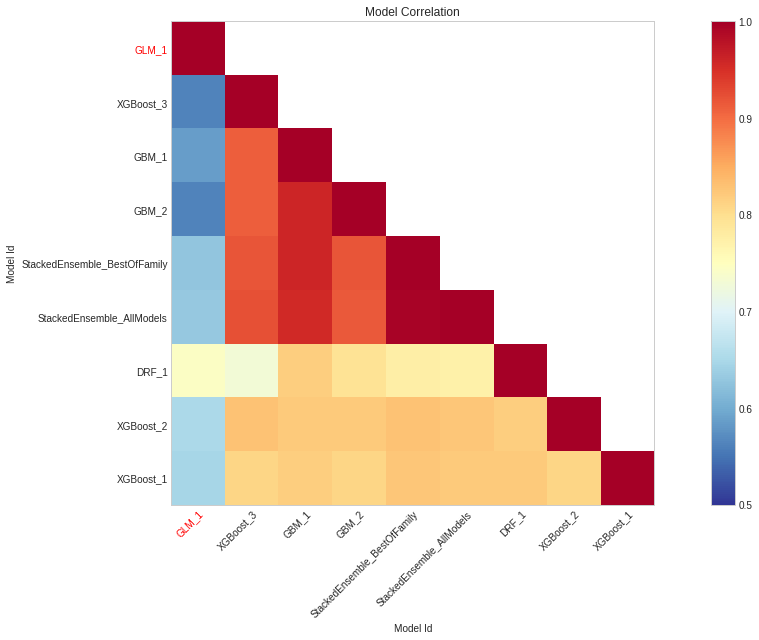

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

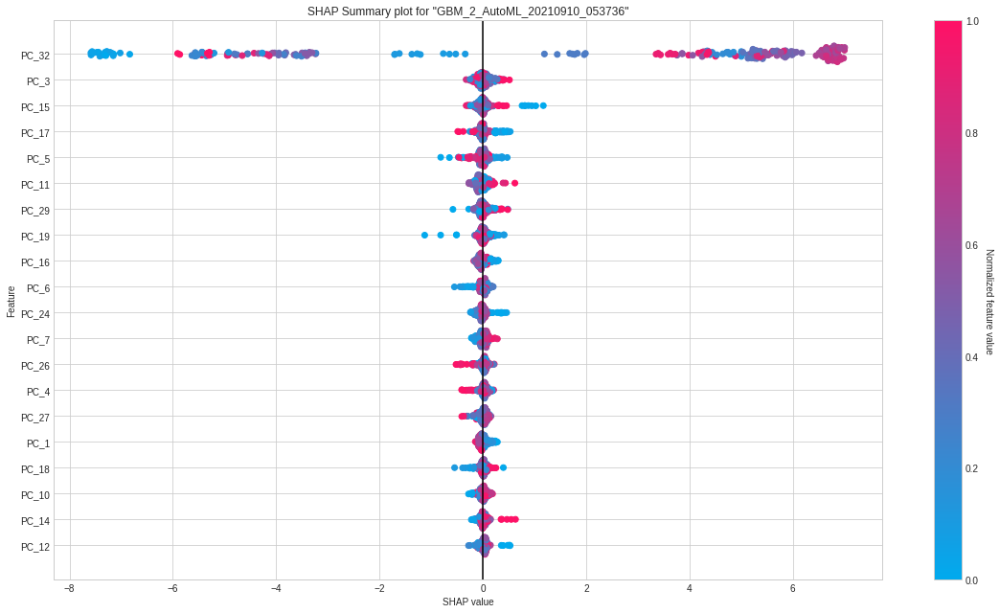

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

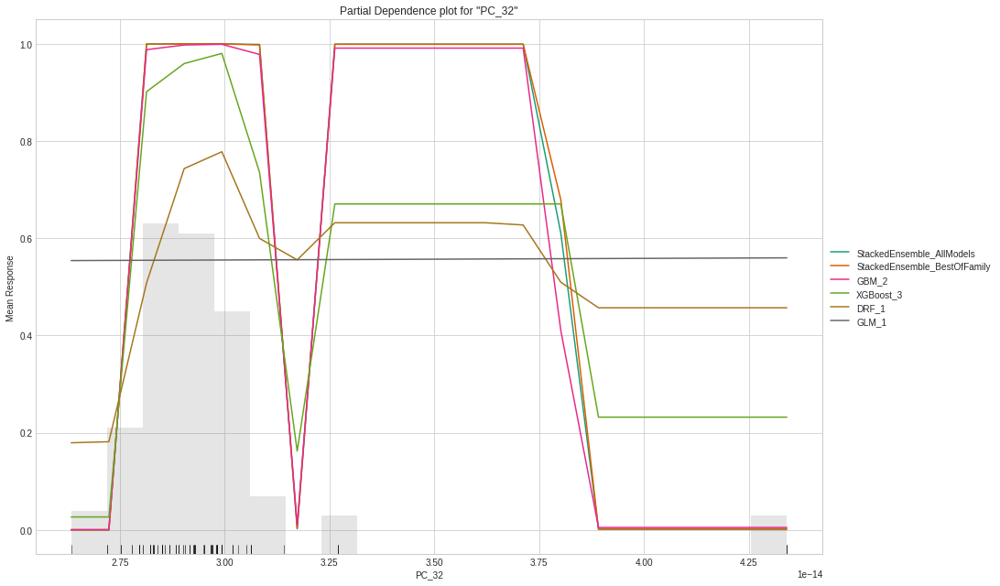

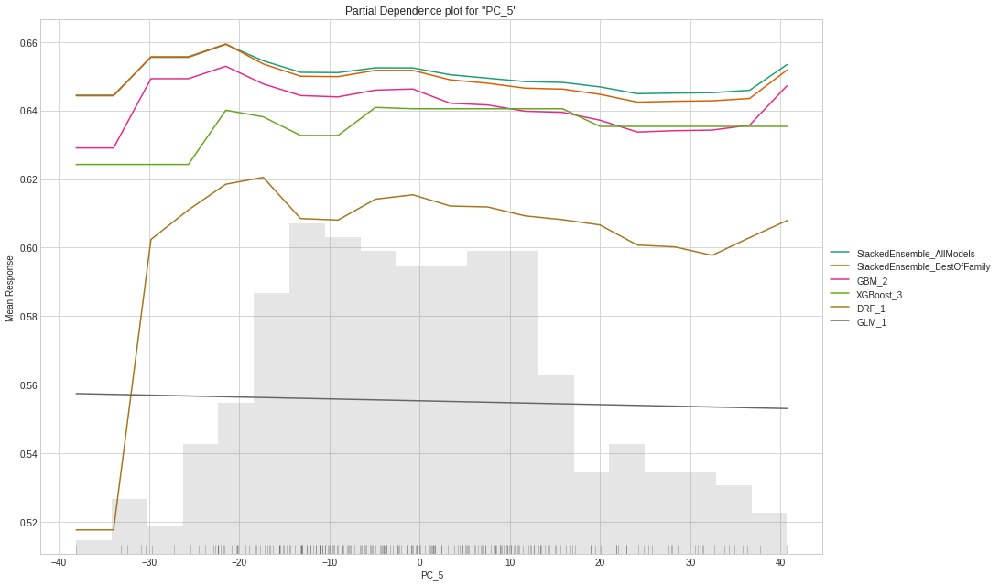

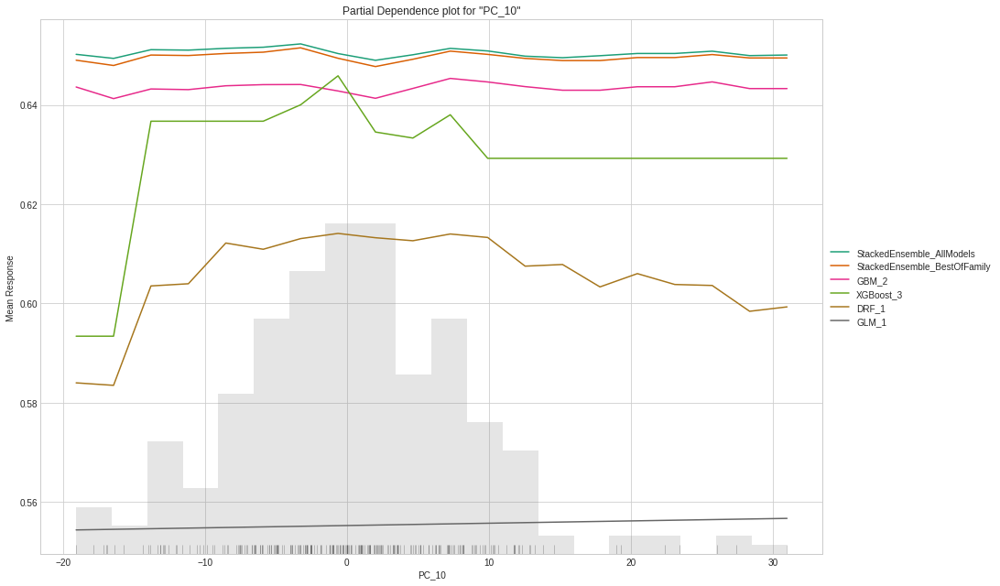

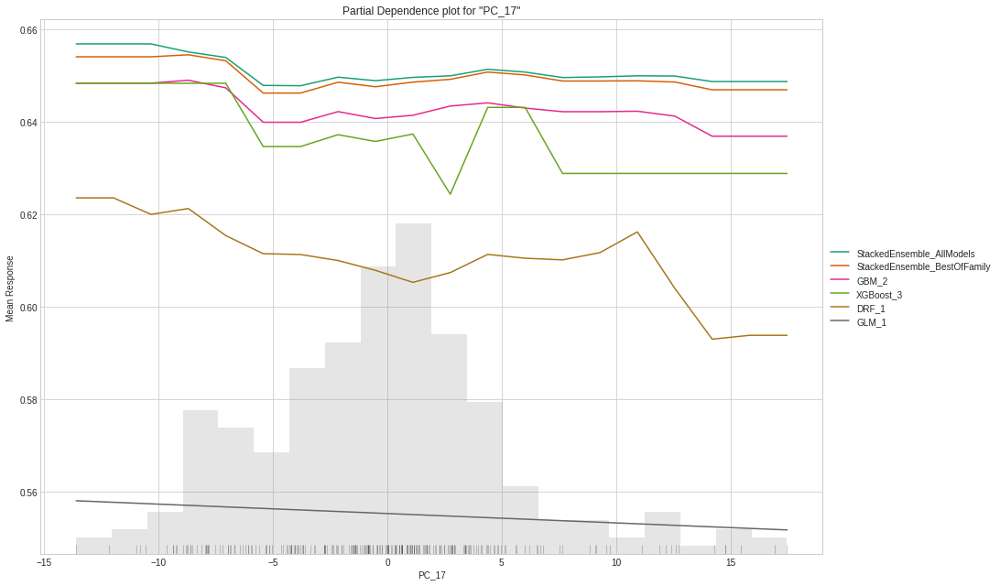

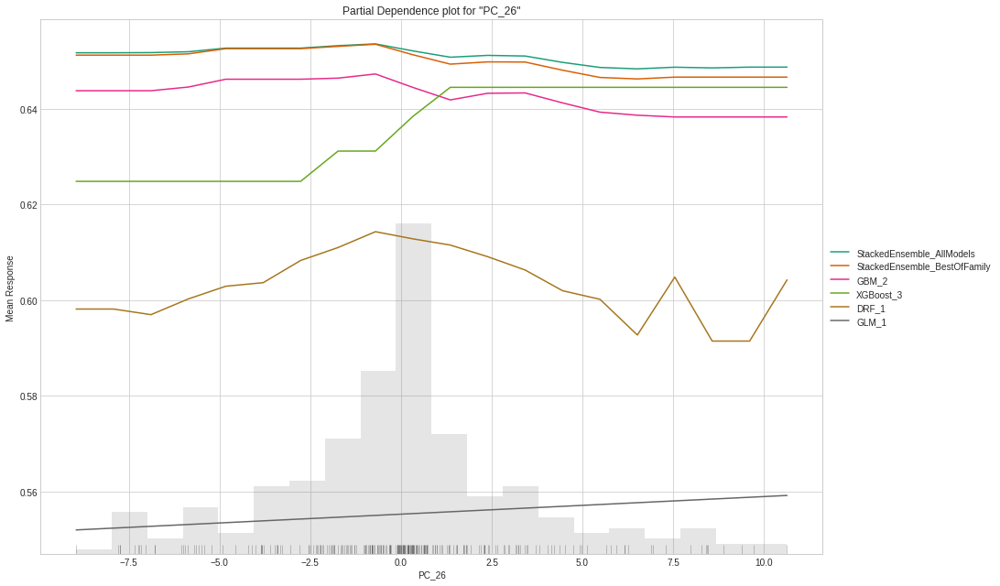



stackedensemble prediction progress: |████████████████████████████████████| 100%


predict,NV,PV
PV,0.0180807,0.981919
PV,0.00908812,0.990912
PV,0.0414761,0.958524
PV,0.00418639,0.995814
PV,0.0138743,0.986126
PV,0.00494223,0.995058
PV,0.0177019,0.982298
PV,0.0101417,0.989858
PV,4.10994e-07,1
PV,3.28567e-06,0.999997




==== Subject 23 | Label Arousal ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |
05:38:33.15: Project: AutoML_20210910_53833015
05:38:33.16: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:38:33.16: Build control seed: 420
05:38:33.16: training frame: Frame key: automl_training_py_1700_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: 5861007574687675477
05:38:33.16: validation frame: NULL
05:38:33.16: leaderboard frame: NULL
05:38:33.16: blending frame: NULL
05:38:33.16: response column: arousal
05:38:33.16: fold column: null
05:38:33.16: weights column: null
05:38:33.16: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
05:38:33.16: Au

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_1_AutoML_20210910_053833,1,1.50359e-06,1,0,2.87149e-05,8.24548e-10,8884,0.192496,GBM
StackedEnsemble_BestOfFamily_AutoML_20210910_053833,1,0.000644661,1,0,0.00229956,5.28796e-06,469,0.169926,StackedEnsemble
StackedEnsemble_AllModels_AutoML_20210910_053833,1,0.000533883,1,0,0.00145736,2.12391e-06,594,0.273486,StackedEnsemble
GBM_2_AutoML_20210910_053833,1,0.000196929,1,0,0.00236055,5.57218e-06,7094,0.154669,GBM
XGBoost_3_AutoML_20210910_053833,0.980364,0.19424,0.895258,0.064318,0.247674,0.0613423,1028,0.008662,XGBoost
XGBoost_1_AutoML_20210910_053833,0.86904,0.342444,0.496153,0.239057,0.334705,0.112028,336,0.008408,XGBoost
XGBoost_2_AutoML_20210910_053833,0.80857,0.377318,0.434732,0.269319,0.347174,0.12053,364,0.00715,XGBoost
DRF_1_AutoML_20210910_053833,0.68823,0.484927,0.260853,0.314664,0.388195,0.150696,556,0.015991,DRF
GLM_1_AutoML_20210910_053833,0.474698,0.468644,0.155969,0.460439,0.382658,0.146427,78,0.005901,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_1_AutoML_20210910_053833


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9999999999990372: 


,,HA,LA,Error,Rate
0,HA,849.0,0.0,0.0,(0.0/849.0)
1,LA,0.0,844.0,0.0,(0.0/844.0)
2,Total,849.0,844.0,0.0,(0.0/1693.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

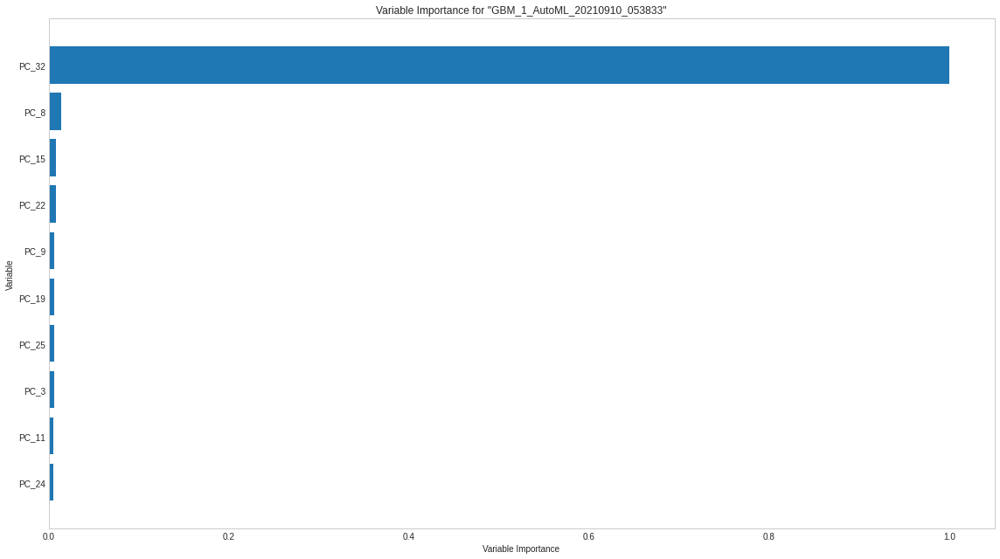

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

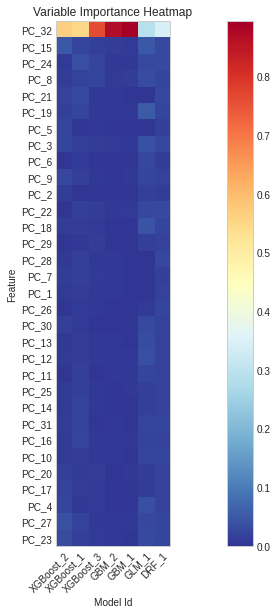

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

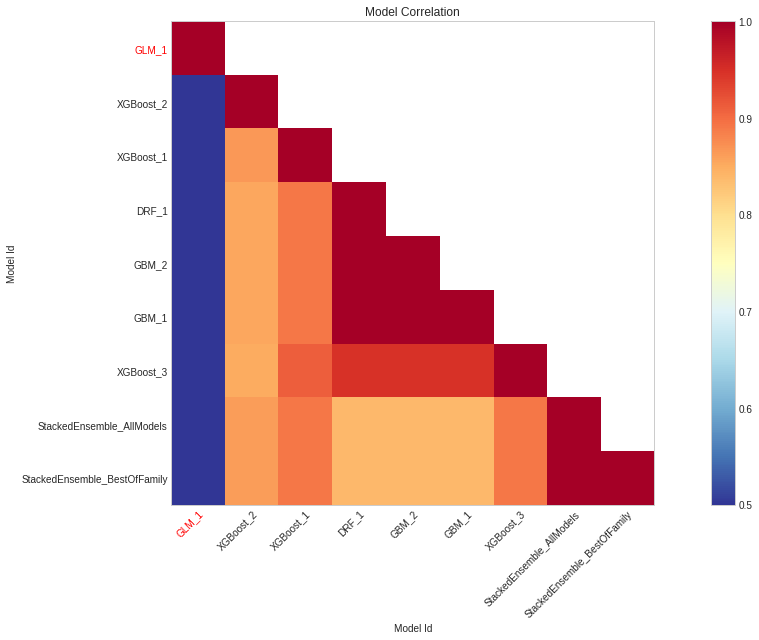

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

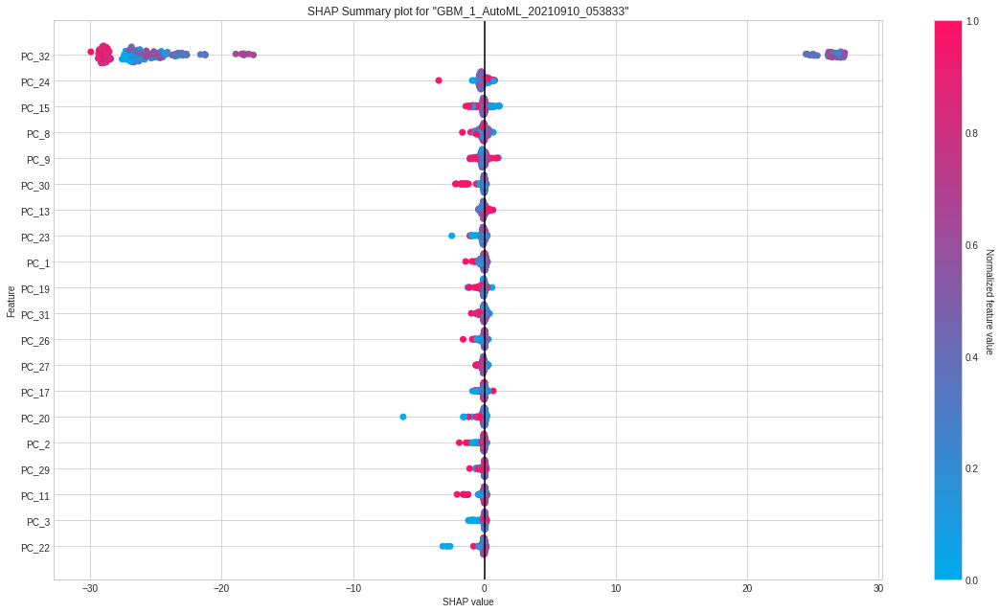

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

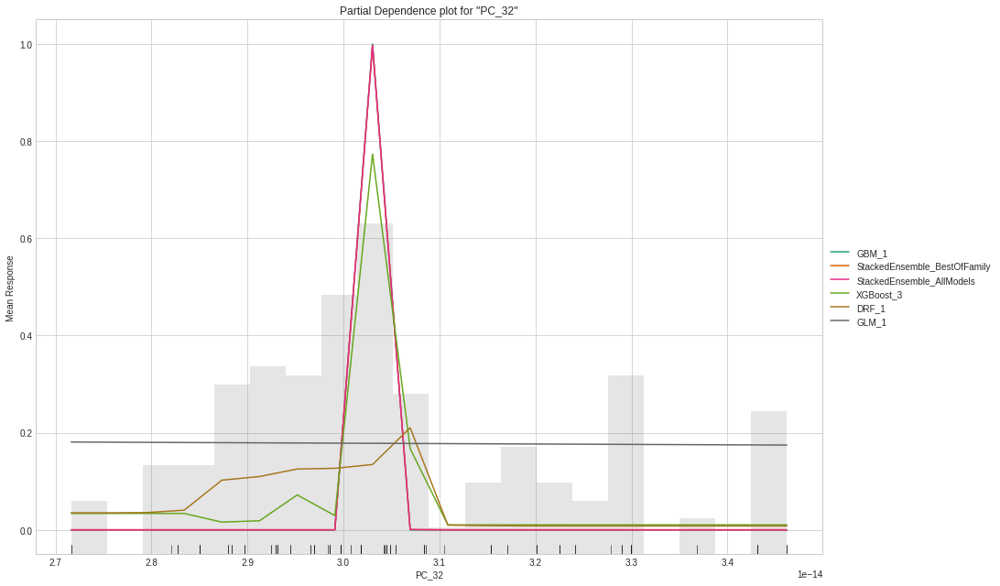

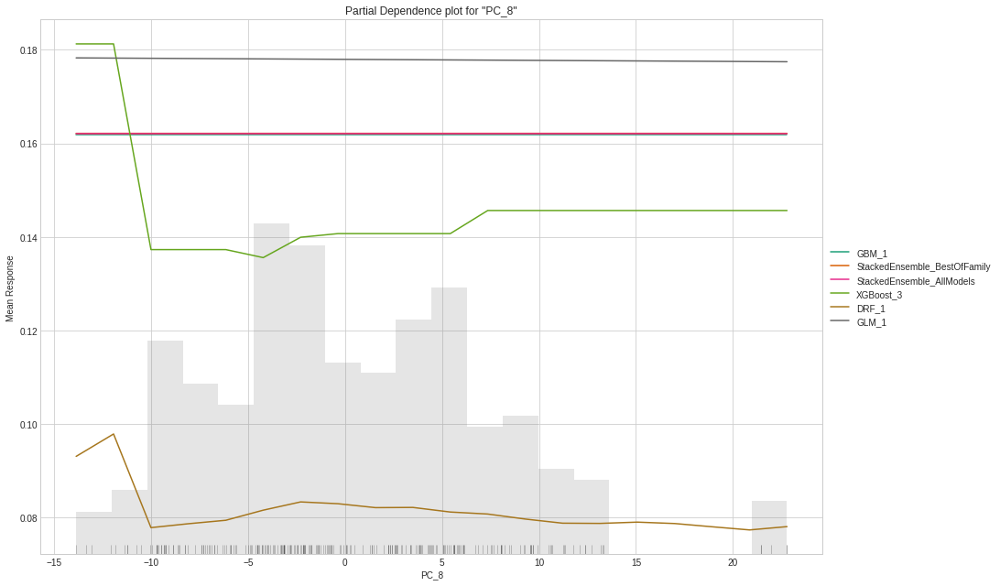

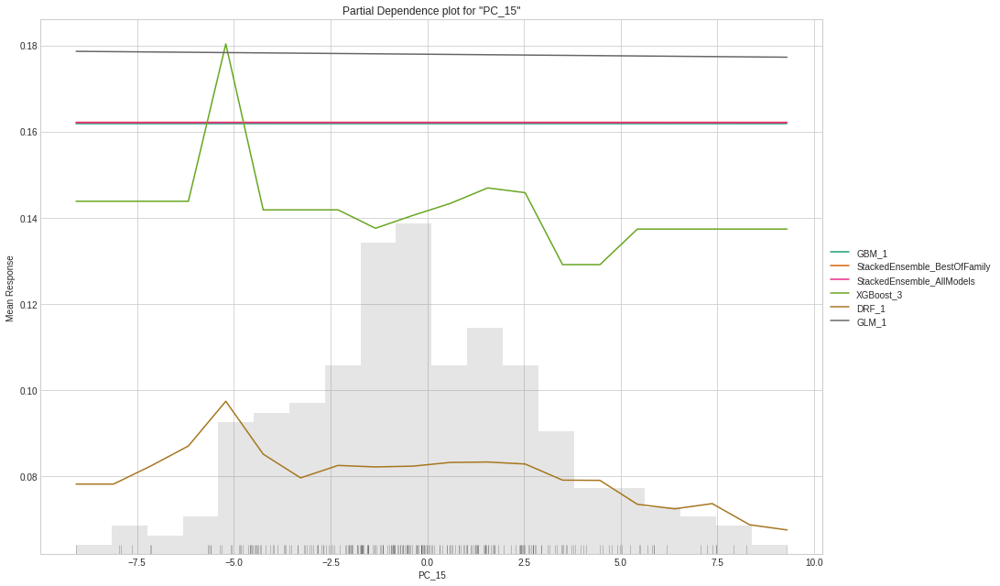

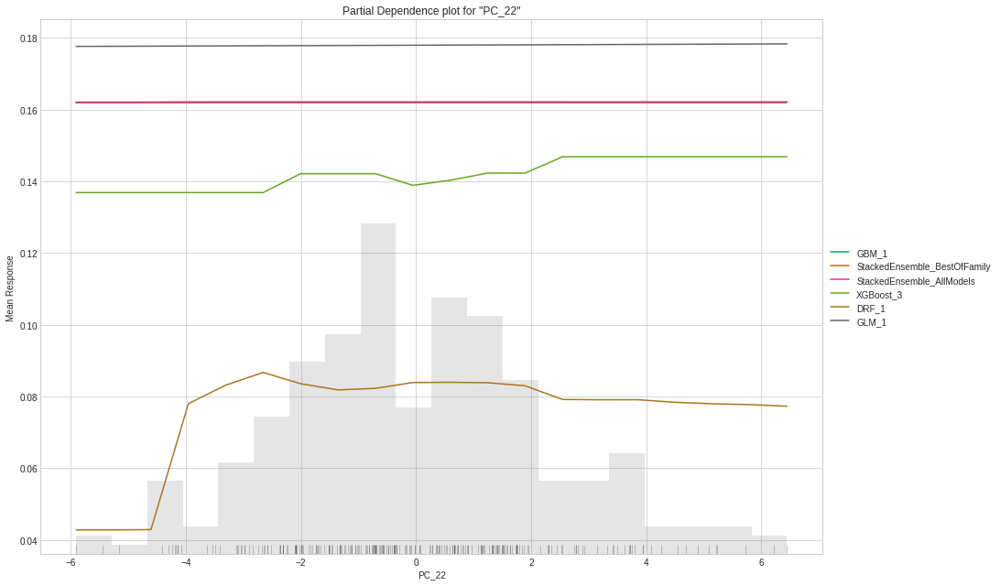

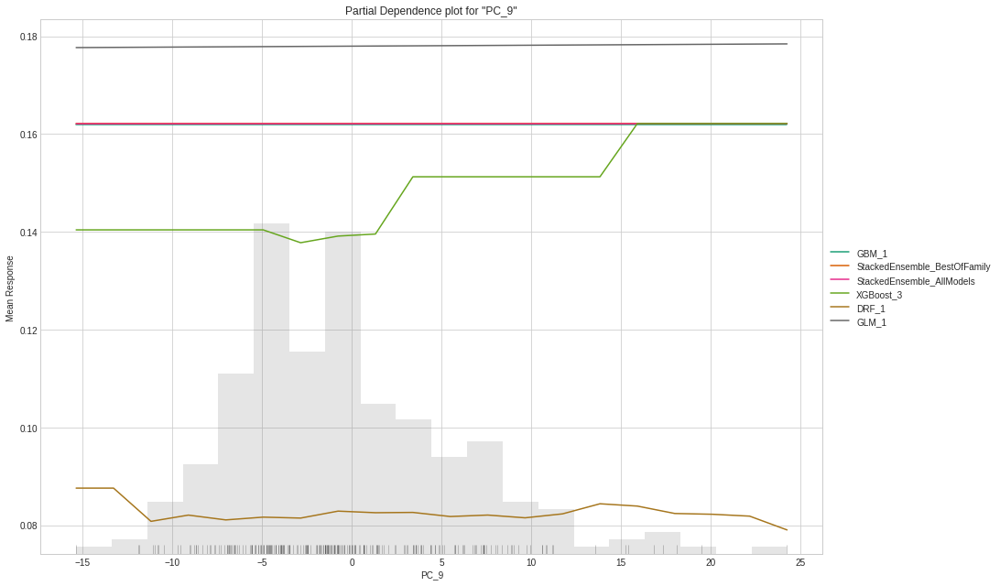



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,HA,LA
HA,1,3.78043e-13
HA,1,9.38949e-15
HA,1,1.31041e-12
HA,1,1.54963e-13
HA,1,1.95478e-13
HA,1,2.13245e-13
HA,1,3.47207e-13
HA,1,3.43196e-13
HA,1,2.63191e-13
HA,1,2.59023e-13




==== Subject 23 | Label Valence ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |
05:41:04.48: Project: AutoML_20210910_54104048
05:41:04.48: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:41:04.48: Build control seed: 420
05:41:04.48: training frame: Frame key: automl_training_py_1823_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -1601367826595638078
05:41:04.48: validation frame: NULL
05:41:04.48: leaderboard frame: NULL
05:41:04.48: blending frame: NULL
05:41:04.48: response column: valence
05:41:04.48: fold column: null
05:41:04.48: weights column: null
05:41:04.48: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search]}, {StackedEnsemble : defaults}]
05:41:04.49: A

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_AutoML_20210910_054104,1,0.00549816,1,0,0.0250054,0.000625272,543,0.14907,StackedEnsemble
StackedEnsemble_BestOfFamily_AutoML_20210910_054104,0.999992,0.0100686,0.99999,0.000847458,0.043218,0.00186779,656,0.094224,StackedEnsemble
GBM_2_AutoML_20210910_054104,0.999992,0.0286228,0.99999,0.000847458,0.0763947,0.00583615,3935,0.103517,GBM
GBM_1_AutoML_20210910_054104,0.999985,0.0508585,0.99998,0.00112867,0.0923518,0.00852885,3098,0.05841,GBM
XGBoost_3_AutoML_20210910_054104,0.896346,0.413253,0.873586,0.182423,0.364414,0.132797,433,0.008236,XGBoost
XGBoost_1_AutoML_20210910_054104,0.731916,0.610953,0.654571,0.343984,0.457927,0.209697,717,0.010273,XGBoost
XGBoost_2_AutoML_20210910_054104,0.669482,0.652325,0.582532,0.415493,0.478461,0.228925,842,0.007438,XGBoost
DRF_1_AutoML_20210910_054104,0.613163,0.654941,0.572648,0.443737,0.482038,0.23236,614,0.01838,DRF
GLM_1_AutoML_20210910_054104,0.389107,0.684684,0.356962,0.498305,0.49575,0.245768,29,0.005901,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_AutoML_20210910_054104


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9999955535548072: 


,,NV,PV,Error,Rate
0,NV,590.0,0.0,0.0,(0.0/590.0)
1,PV,0.0,443.0,0.0,(0.0/443.0)
2,Total,590.0,443.0,0.0,(0.0/1033.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

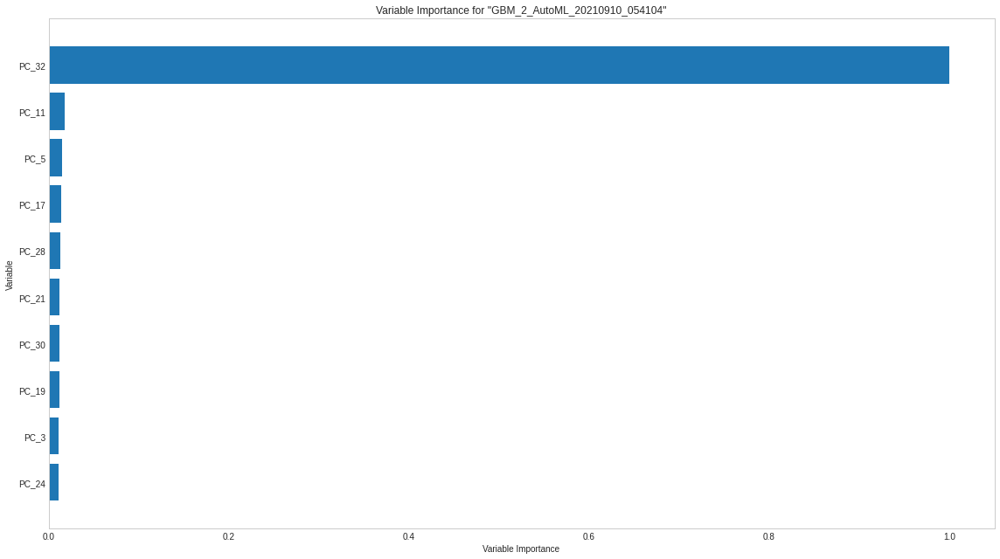

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

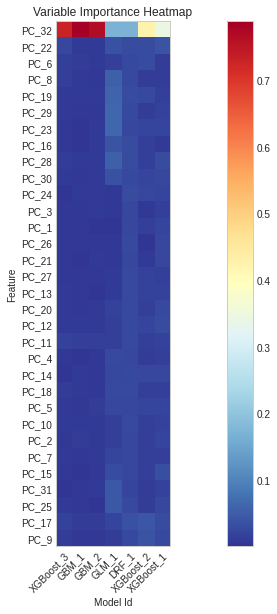

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

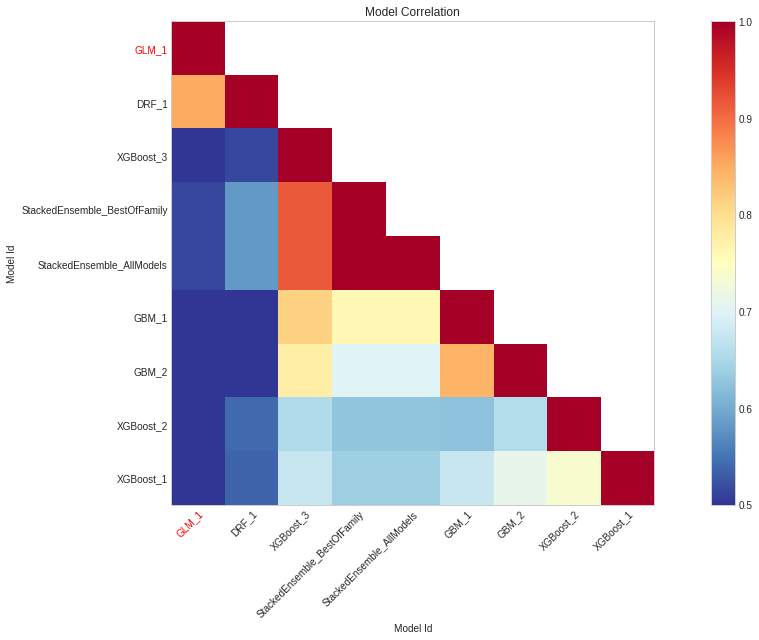

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

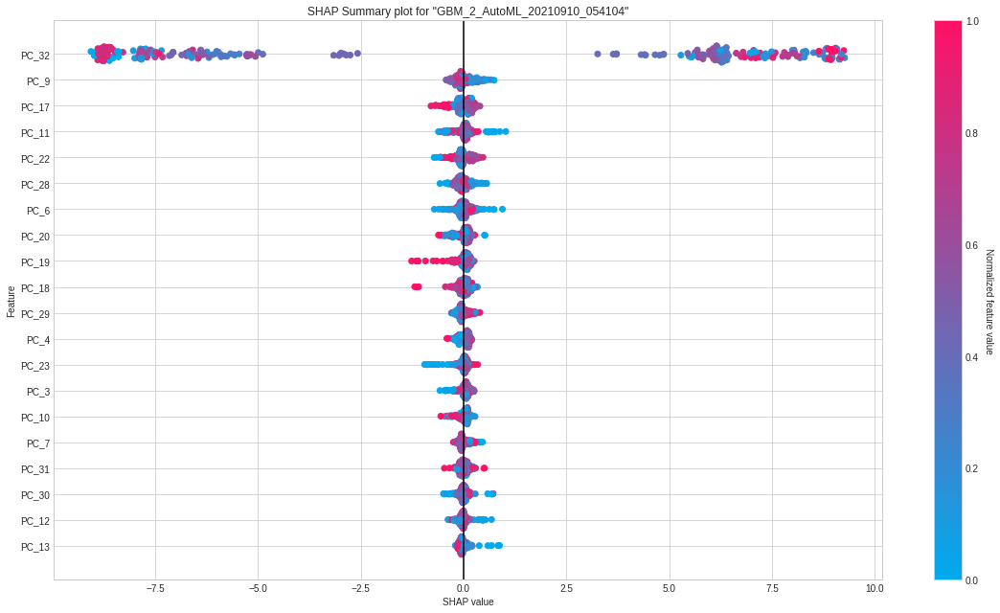

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

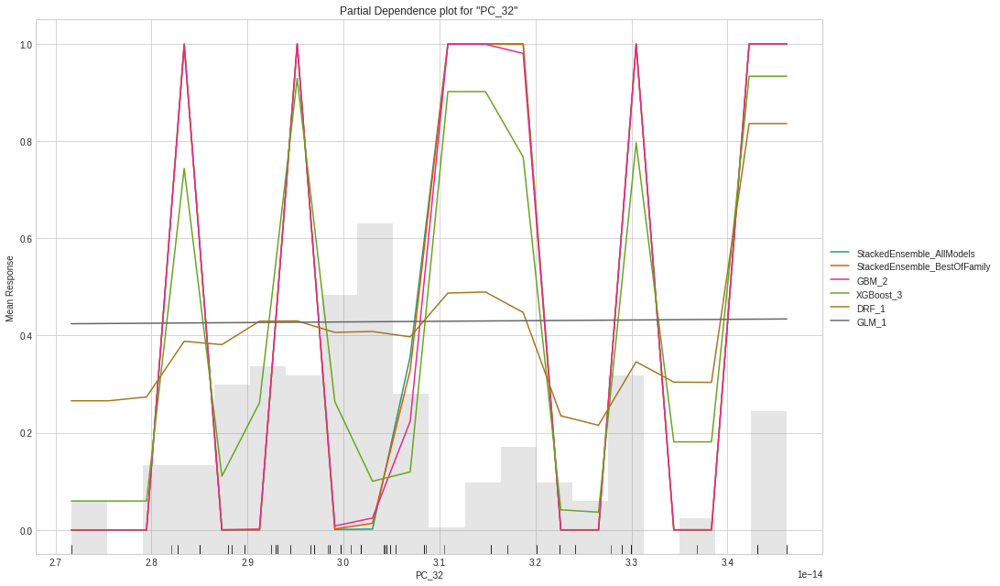

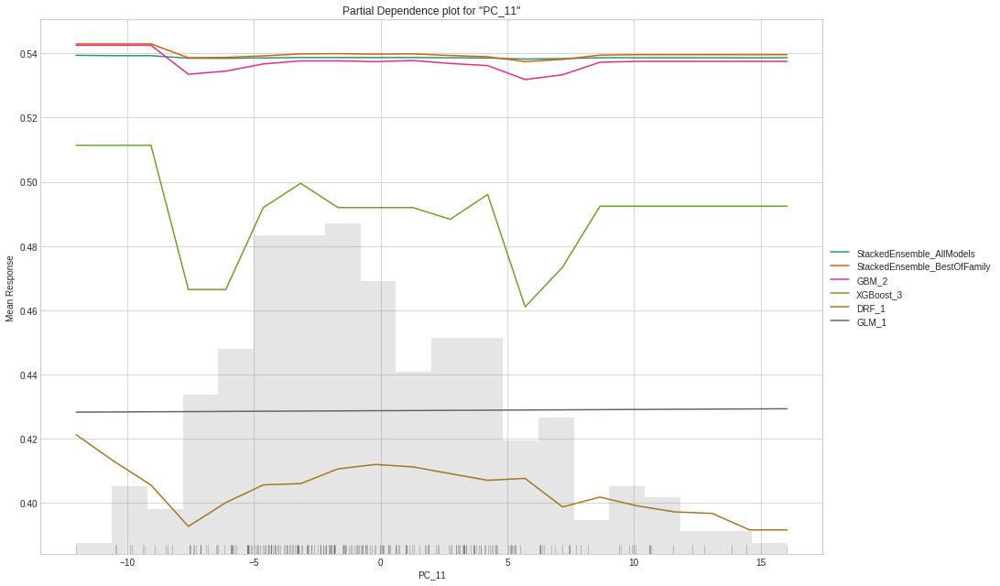

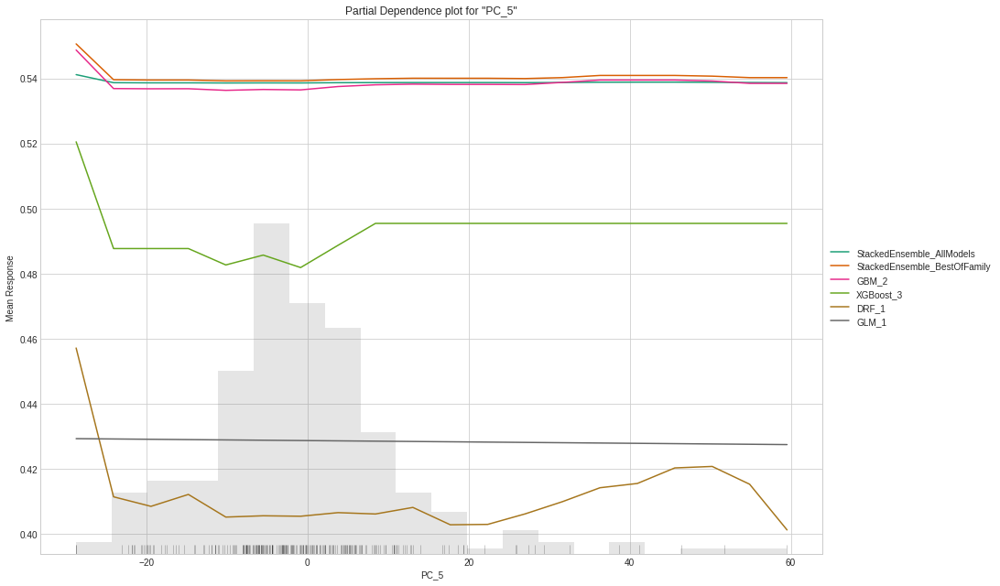

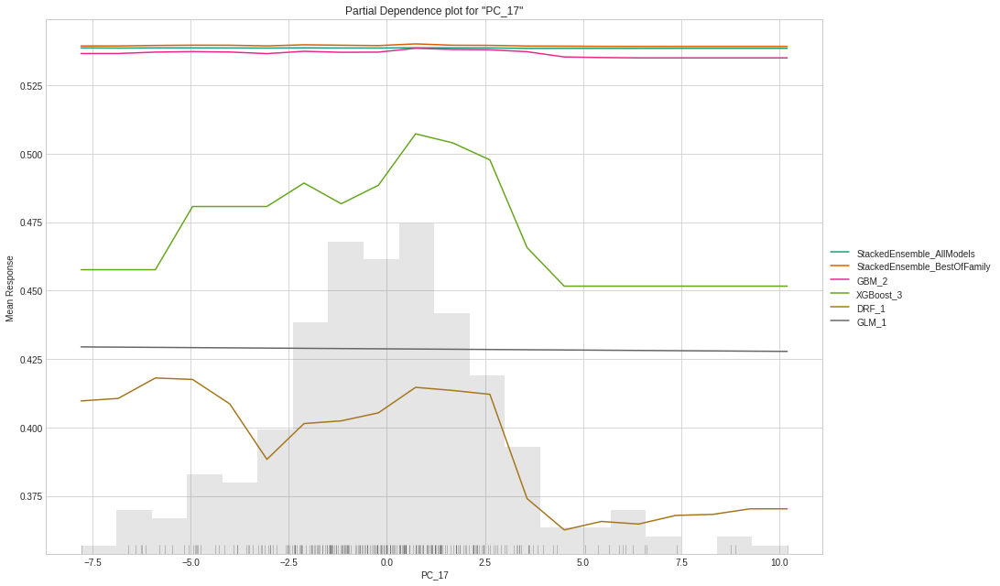

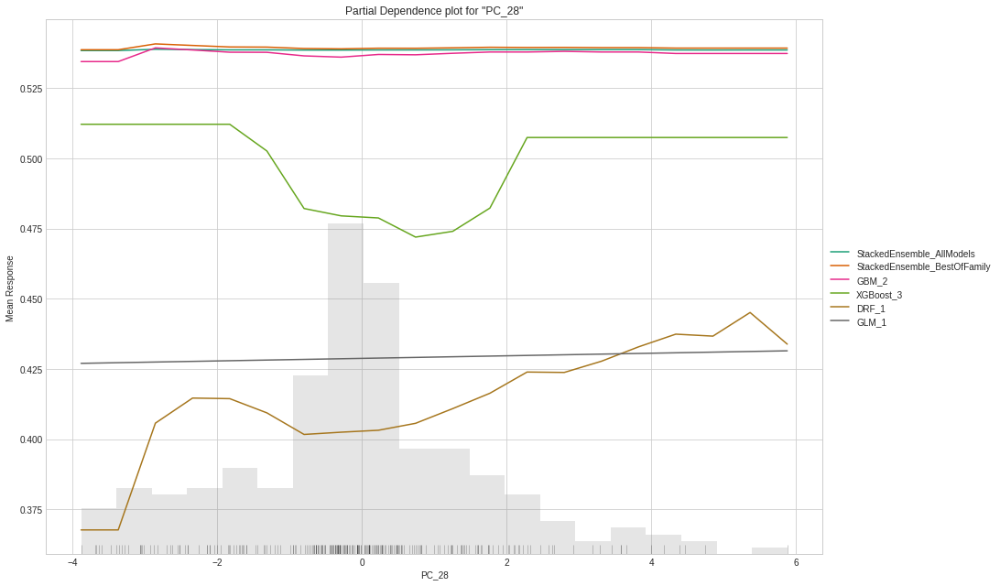



stackedensemble prediction progress: |████████████████████████████████████| 100%


predict,NV,PV
PV,5.30313e-06,0.999995
PV,9.80779e-07,0.999999
PV,2.20054e-06,0.999998
PV,5.31149e-07,0.999999
PV,1.60572e-07,1
PV,4.42674e-06,0.999996
PV,2.23521e-07,1
PV,9.28398e-07,0.999999
PV,6.46884e-06,0.999994
PV,0.000276471,0.999724



CPU times: user 2min 9s, sys: 9.97 s, total: 2min 19s
Wall time: 10min 34s


In [ ]:
%%time
subjects = [11, 19, 23]
train_subjects(subjects, 7)

#Excluyendo a Stacked Ensemble del Análisis


==== Subject 11 | Label Arousal ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
05:50:41.485: Project: AutoML_20210910_55041484
05:50:41.485: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:50:41.485: Build control seed: 420
05:50:41.485: training frame: Frame key: automl_training_py_1949_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: 4957307265454385053
05:50:41.485: validation frame: NULL
05:50:41.485: leaderboard frame: NULL
05:50:41.485: blending frame: NULL
05:50:41.485: response column: arousal
05:50:41.485: fold column: null
05:50:41.485: weights column: null
05:50:41.485: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_search

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_2_AutoML_20210910_055041,1,0.000379575,1,0,0.00328335,1.07804e-05,5371,0.105103,GBM
GBM_1_AutoML_20210910_055041,1,9.39923e-10,1,0,2.18586e-08,4.77797e-16,10964,0.163516,GBM
XGBoost_3_AutoML_20210910_055041,0.992349,0.132897,0.962896,0.0469251,0.195566,0.0382462,377,0.007705,XGBoost
XGBoost_1_AutoML_20210910_055041,0.912187,0.300103,0.6569,0.155828,0.312028,0.0973617,325,0.007289,XGBoost
XGBoost_2_AutoML_20210910_055041,0.884398,0.329753,0.583554,0.217391,0.32204,0.10371,143,0.006493,XGBoost
DRF_1_AutoML_20210910_055041,0.793416,0.463046,0.427796,0.271371,0.382032,0.145948,724,0.014296,DRF
GLM_1_AutoML_20210910_055041,0.369192,0.479045,0.13829,0.499407,0.388102,0.150623,27,0.005669,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_2_AutoML_20210910_055041


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.999999999982175: 


,,HA,LA,Error,Rate
0,HA,843.0,0.0,0.0,(0.0/843.0)
1,LA,0.0,834.0,0.0,(0.0/834.0)
2,Total,843.0,834.0,0.0,(0.0/1677.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

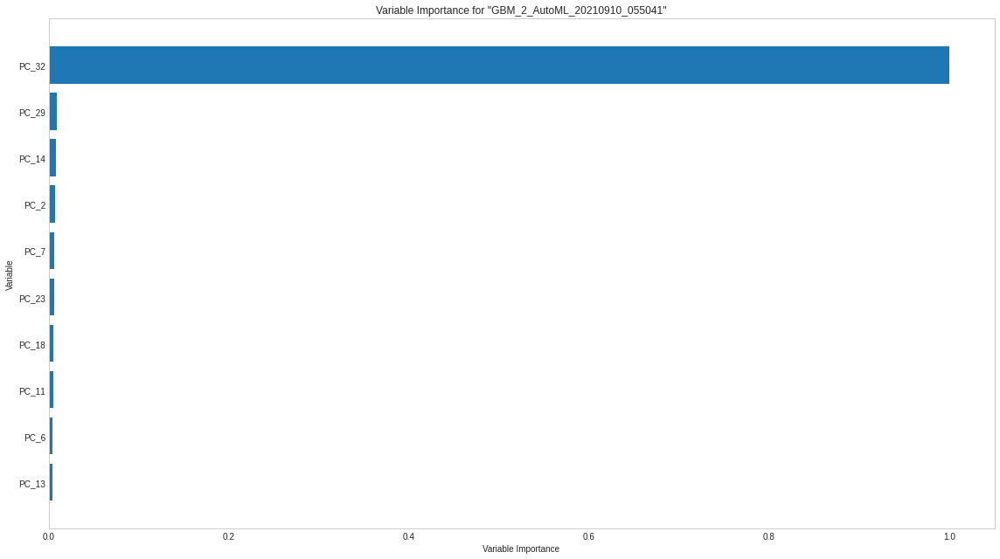

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

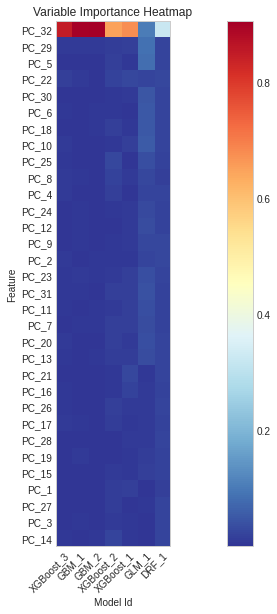

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

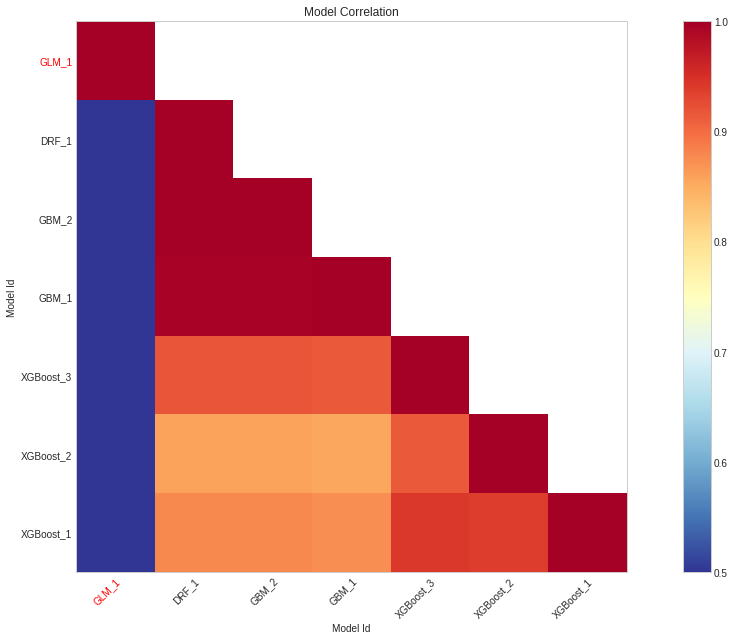

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

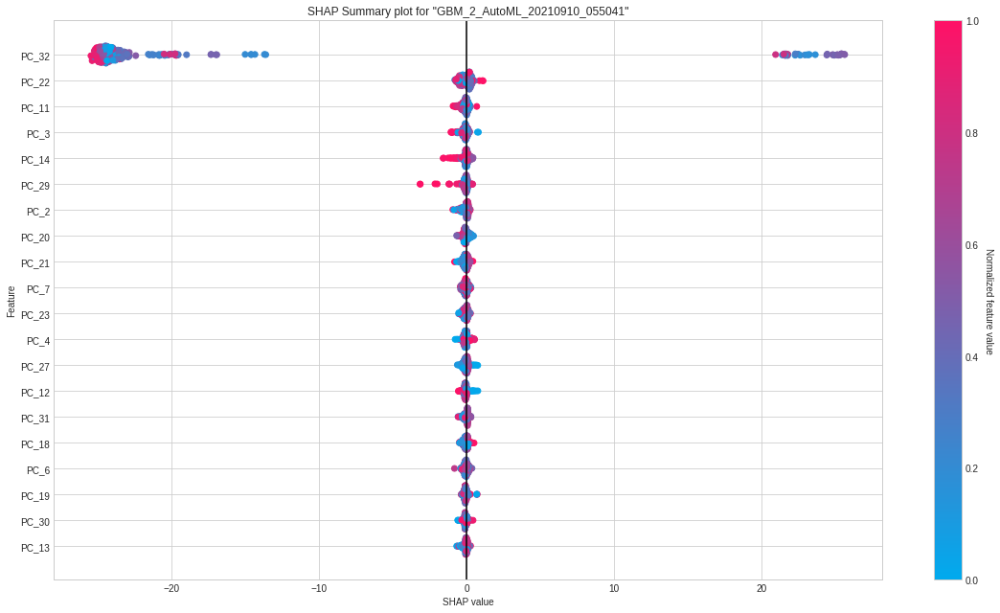

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

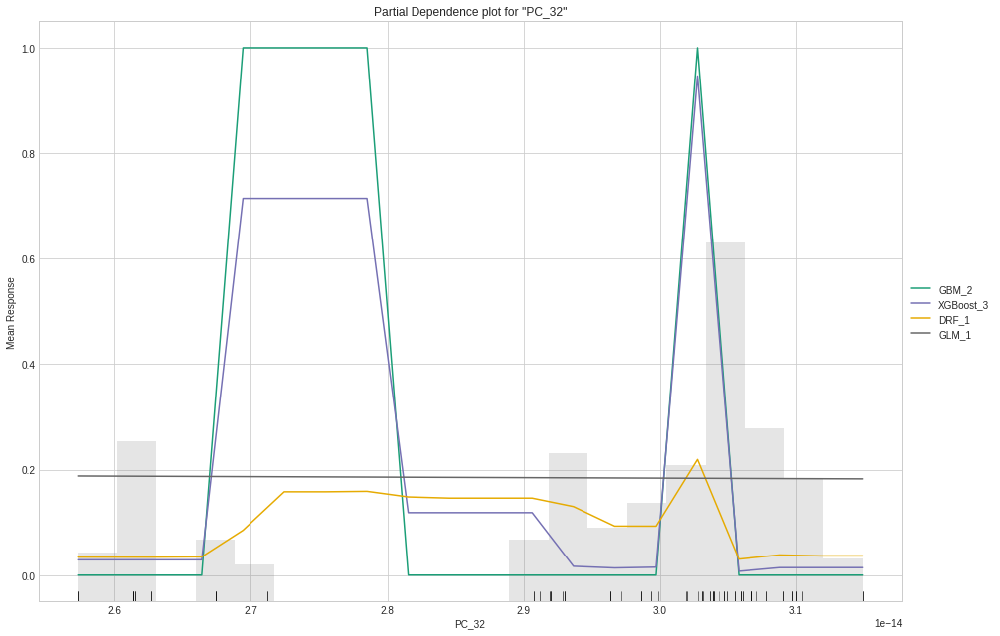

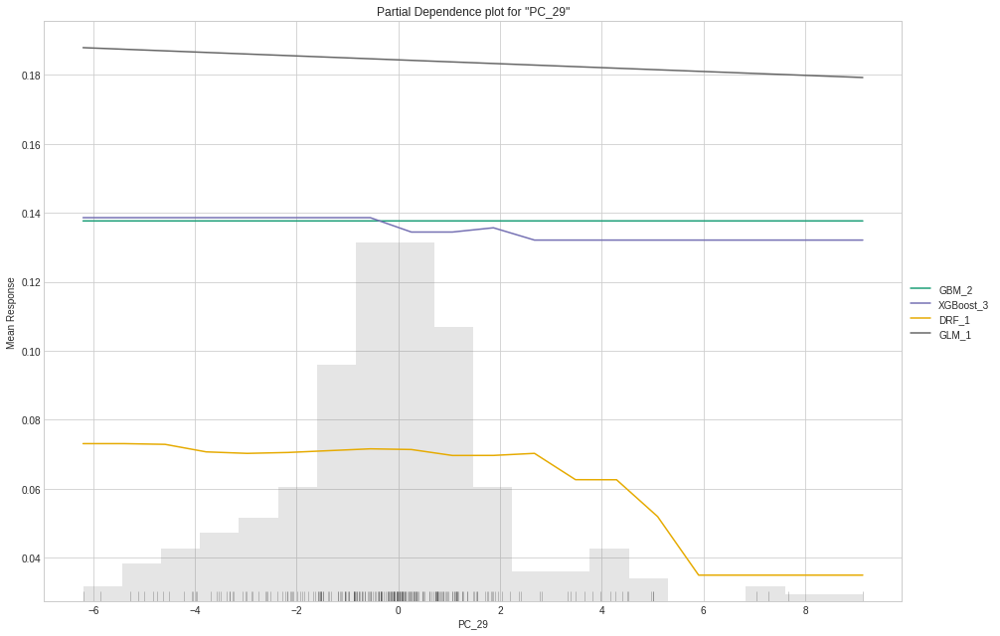

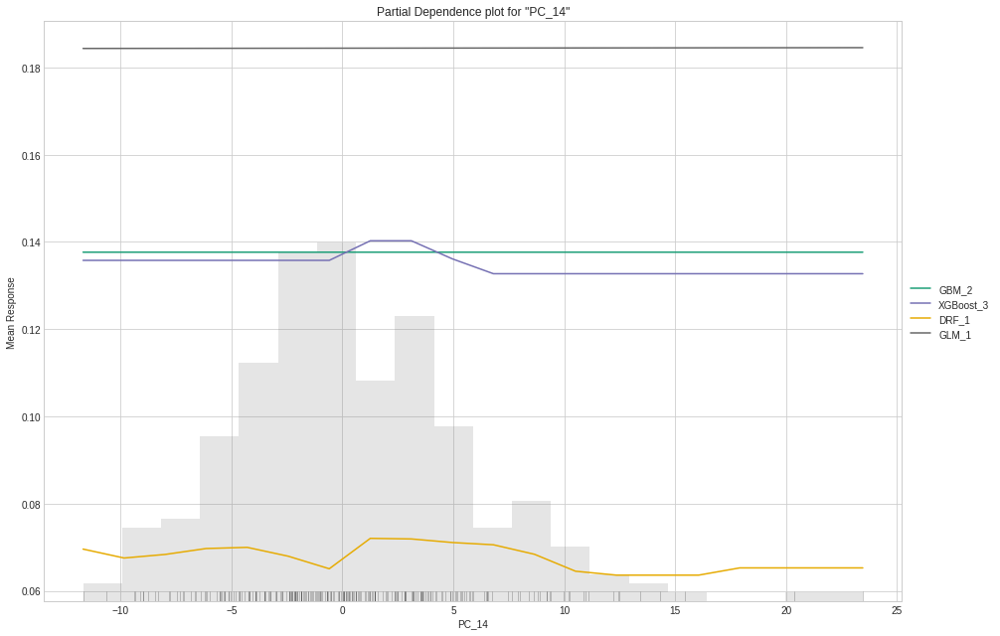

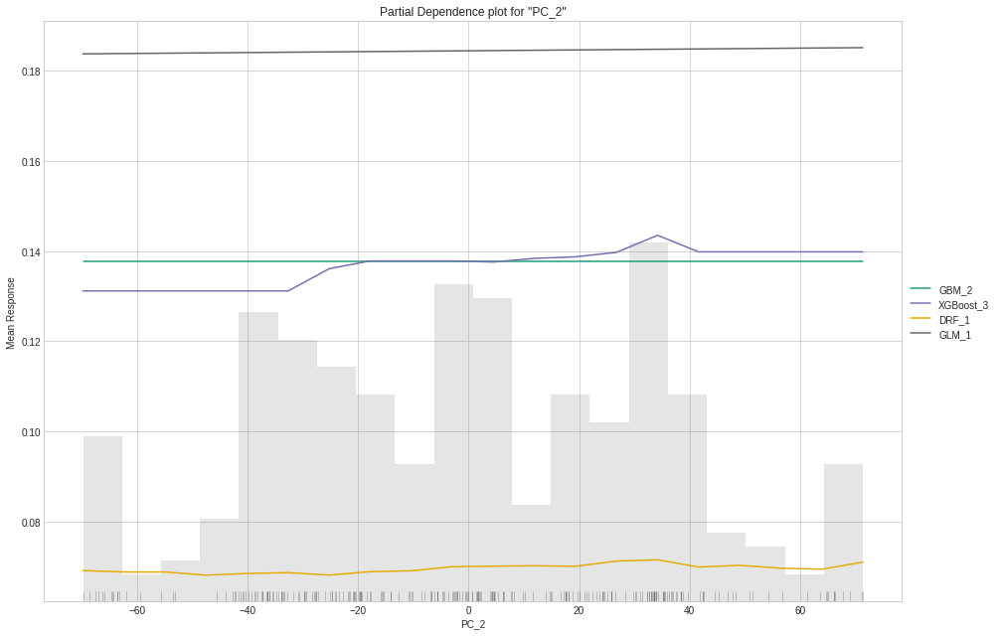

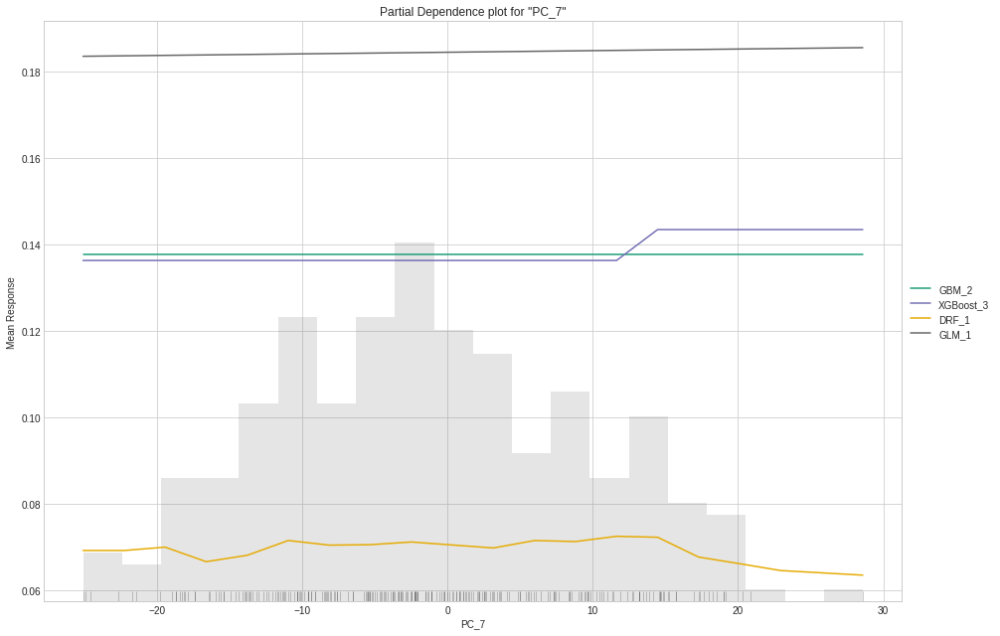



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,HA,LA
HA,1,3.50605e-10
HA,1,2.25287e-11
HA,1,1.02086e-10
HA,1,1.7122e-10
HA,1,3.0335e-11
HA,1,3.64325e-11
HA,1,6.21804e-11
HA,1,4.05651e-11
HA,1,2.76425e-13
HA,1,3.48538e-14




==== Subject 11 | Label Valence ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
05:52:54.285: Project: AutoML_20210910_55254285
05:52:54.287: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:52:54.287: Build control seed: 420
05:52:54.287: training frame: Frame key: automl_training_py_2066_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: -7917853864018137326
05:52:54.287: validation frame: NULL
05:52:54.287: leaderboard frame: NULL
05:52:54.287: blending frame: NULL
05:52:54.287: response column: valence
05:52:54.287: fold column: null
05:52:54.287: weights column: null
05:52:54.287: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_sear

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_1_AutoML_20210910_055254,1,4.19335e-12,1,0,3.58456e-11,1.28491e-21,17136,0.32858,GBM
GBM_2_AutoML_20210910_055254,1,0.000441538,1,0,0.00337066,1.13613e-05,4270,0.08941,GBM
XGBoost_3_AutoML_20210910_055254,0.991795,0.176812,0.99234,0.0443584,0.215715,0.0465328,256,0.009075,XGBoost
XGBoost_1_AutoML_20210910_055254,0.924491,0.35352,0.932195,0.177154,0.336597,0.113298,514,0.008135,XGBoost
XGBoost_2_AutoML_20210910_055254,0.913962,0.384211,0.925346,0.172868,0.349759,0.122332,298,0.00777,XGBoost
DRF_1_AutoML_20210910_055254,0.768746,0.558186,0.831856,0.287614,0.43569,0.189826,401,0.016627,DRF
GLM_1_AutoML_20210910_055254,0.661355,0.619278,0.736636,0.5,0.469058,0.220015,295,0.005878,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_1_AutoML_20210910_055254


Confusion Matrix (Act/Pred) for max f1 @ threshold = 1.0: 


,,NV,PV,Error,Rate
0,NV,526.0,0.0,0.0,(0.0/526.0)
1,PV,0.0,530.0,0.0,(0.0/530.0)
2,Total,526.0,530.0,0.0,(0.0/1056.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

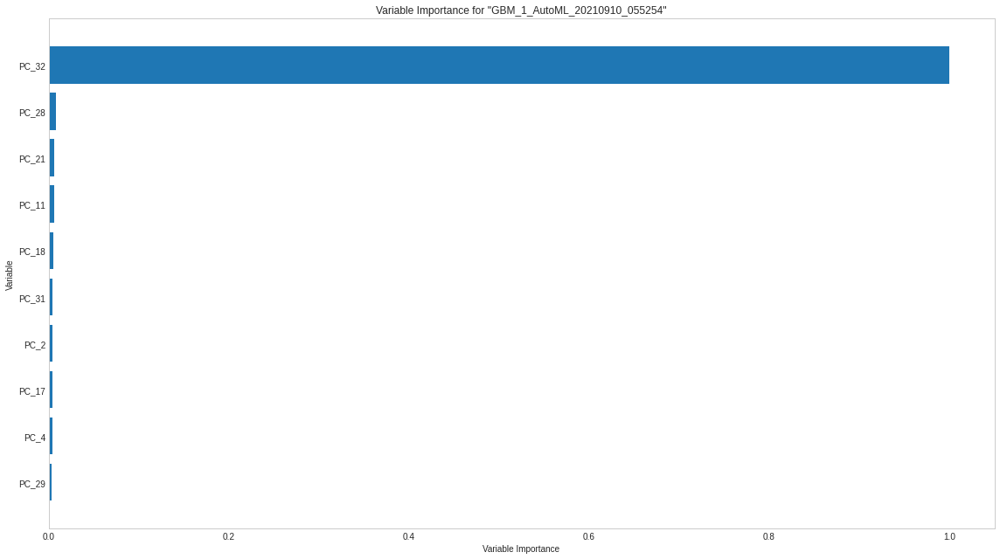

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

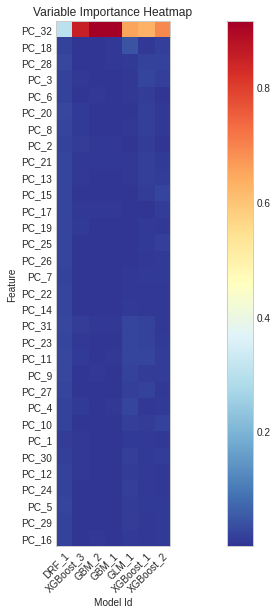

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

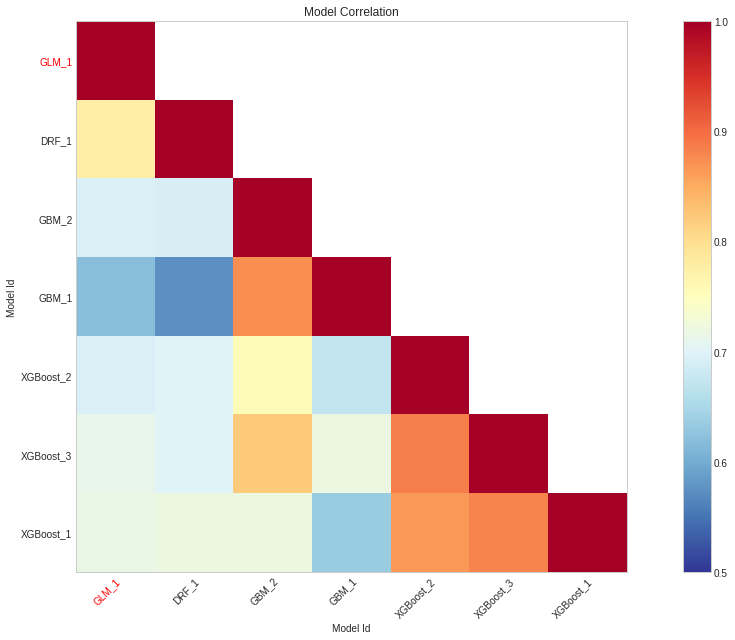

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

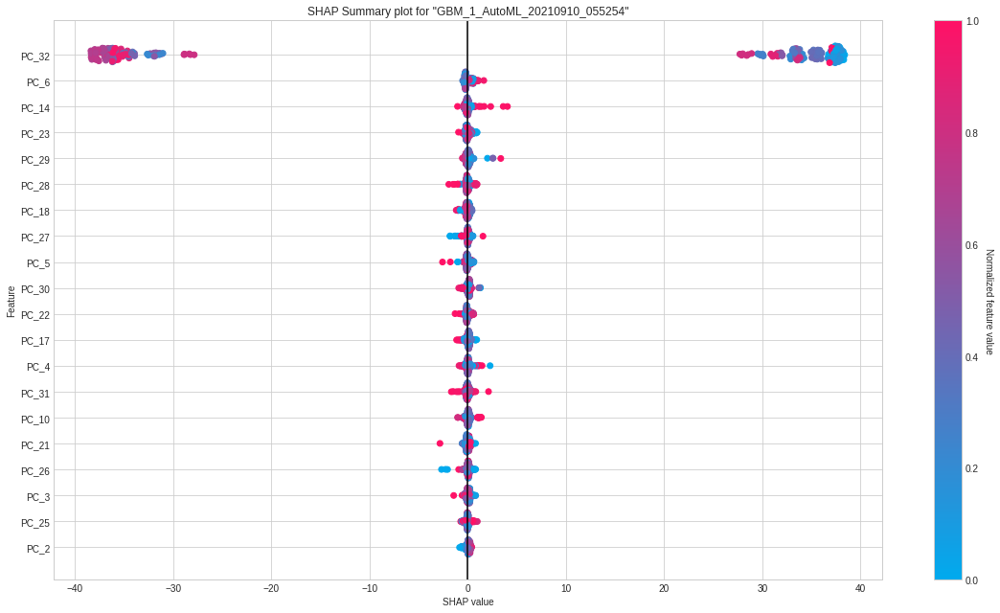

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

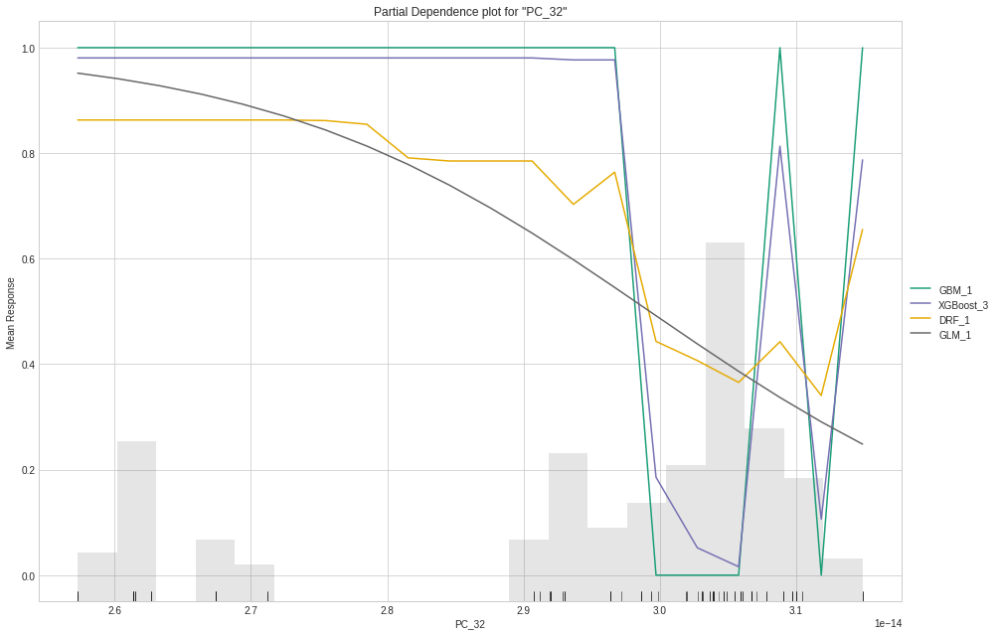

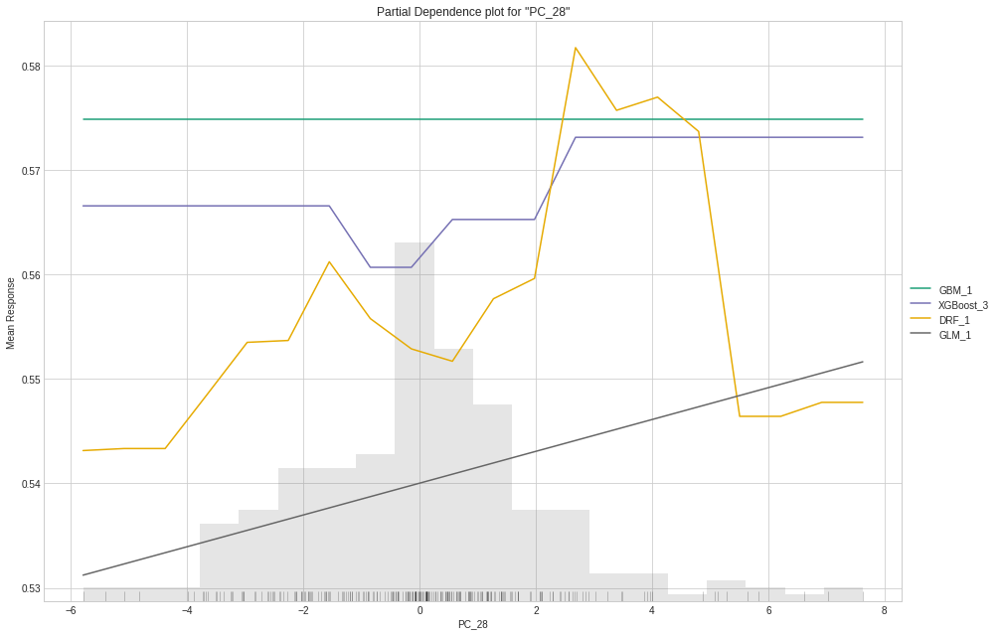

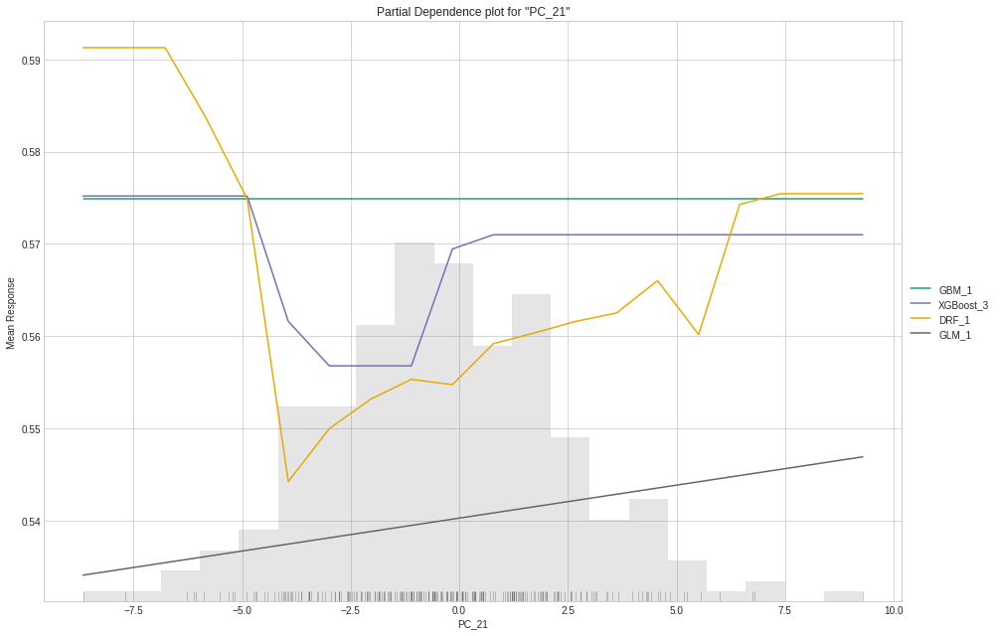

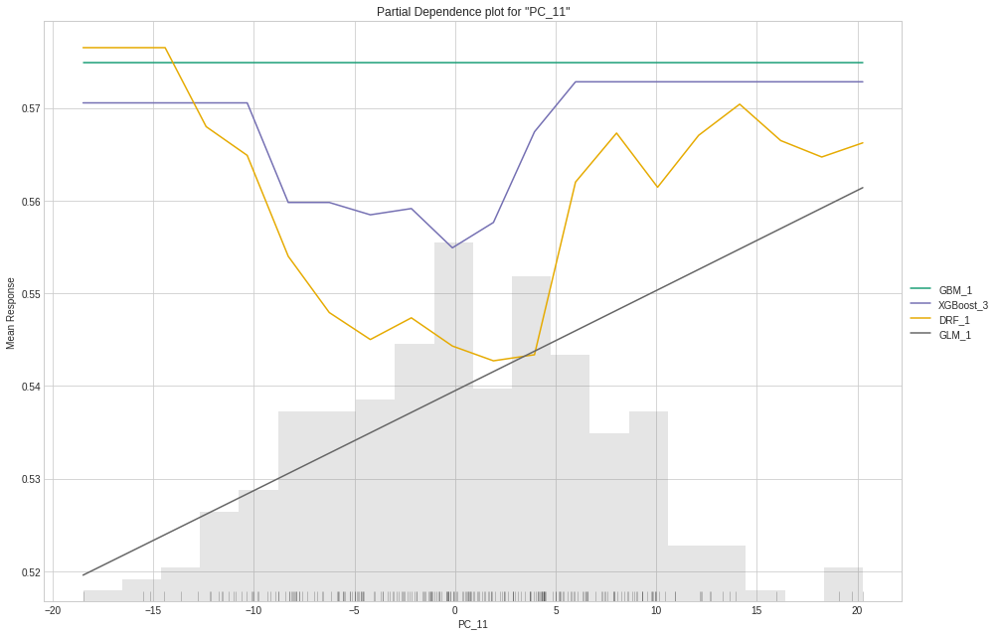

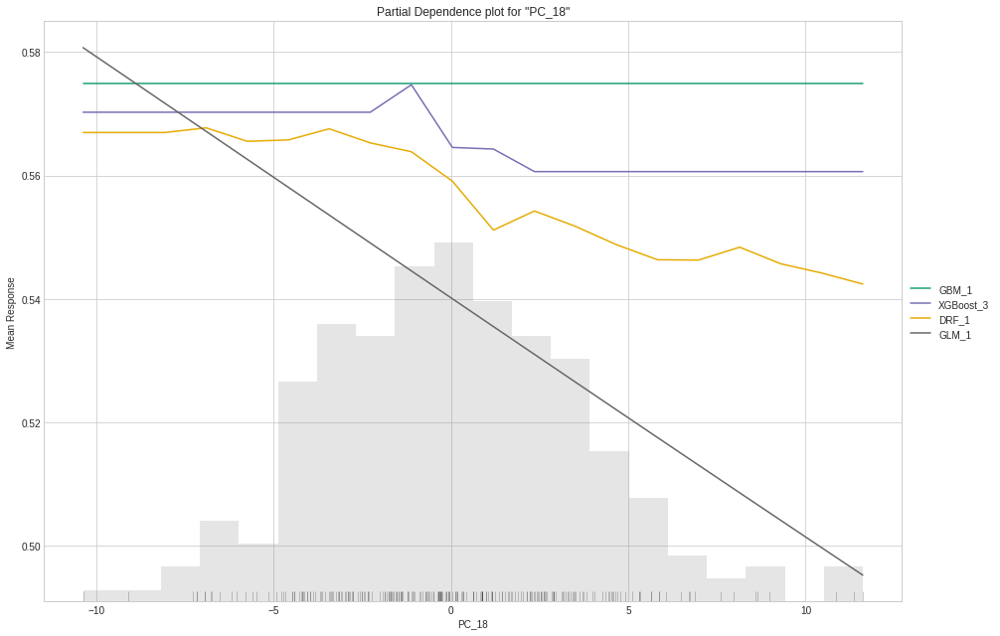



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,NV,PV
NV,1.27401e-15,1
NV,2.9727e-15,1
NV,4.03437e-15,1
NV,3.39737e-15,1
NV,5.73306e-15,1
NV,1.74115e-14,1
NV,4.11931e-14,1
NV,4.45904e-15,1
PV,0,1
PV,0,1




==== Subject 19 | Label Arousal ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
05:55:45.980: Project: AutoML_20210910_55545980
05:55:45.980: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:55:45.980: Build control seed: 420
05:55:45.980: training frame: Frame key: automl_training_py_2192_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267376  checksum: 2176671927158912069
05:55:45.980: validation frame: NULL
05:55:45.980: leaderboard frame: NULL
05:55:45.980: blending frame: NULL
05:55:45.980: response column: arousal
05:55:45.980: fold column: null
05:55:45.980: weights column: null
05:55:45.980: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_searc

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_1_AutoML_20210910_055545,0.991231,0.152698,0.965927,0.0273903,0.220225,0.0484991,1452,0.029346,GBM
GBM_2_AutoML_20210910_055545,0.989227,0.170392,0.960505,0.0507859,0.233315,0.0544359,914,0.024398,GBM
XGBoost_3_AutoML_20210910_055545,0.988464,0.195208,0.965978,0.0651437,0.241377,0.0582628,257,0.008331,XGBoost
XGBoost_1_AutoML_20210910_055545,0.802223,0.418369,0.582294,0.288574,0.365997,0.133954,294,0.007745,XGBoost
XGBoost_2_AutoML_20210910_055545,0.788047,0.449822,0.445143,0.275723,0.38356,0.147118,234,0.00718,XGBoost
DRF_1_AutoML_20210910_055545,0.670545,0.50748,0.482584,0.379739,0.399816,0.159852,656,0.016787,DRF
GLM_1_AutoML_20210910_055545,0.631509,0.501226,0.413988,0.422041,0.403215,0.162582,229,0.00657,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_1_AutoML_20210910_055545


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.6708135849472896: 


,,HA,LA,Error,Rate
0,HA,804.0,0.0,0.0,(0.0/804.0)
1,LA,0.0,811.0,0.0,(0.0/811.0)
2,Total,804.0,811.0,0.0,(0.0/1615.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

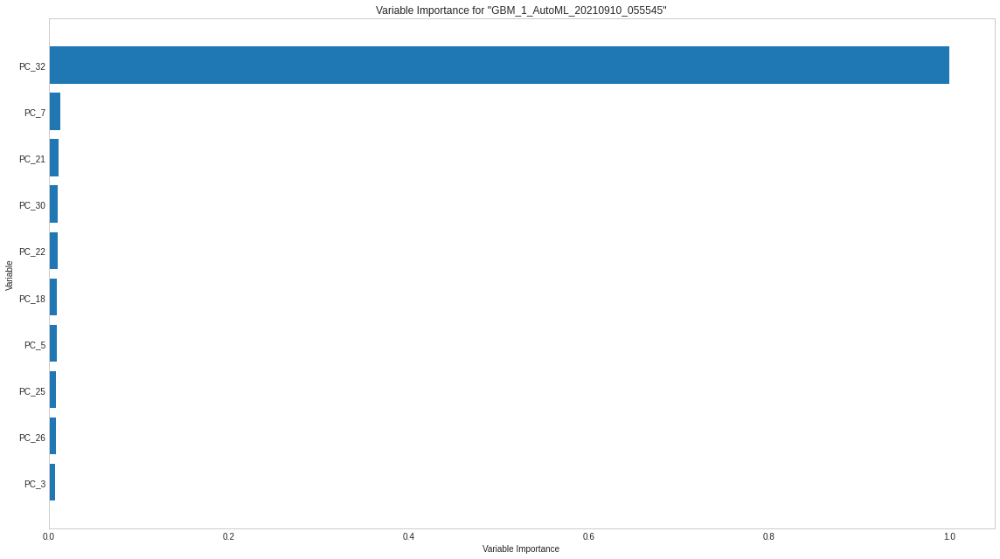

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

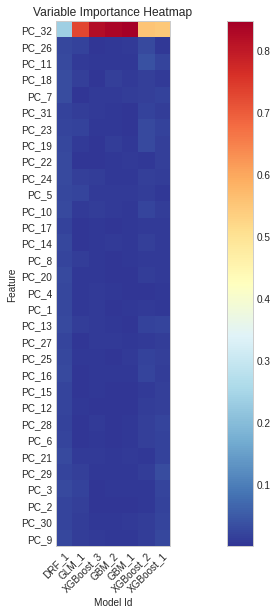

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

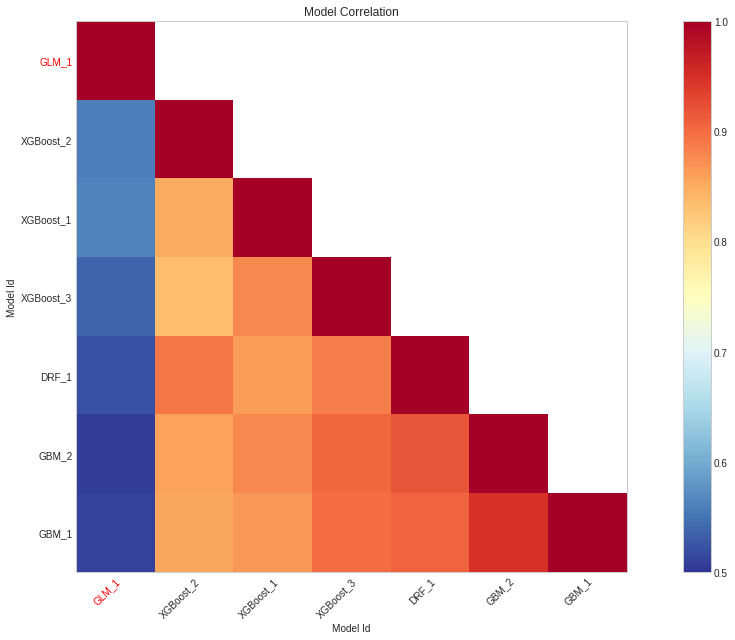

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

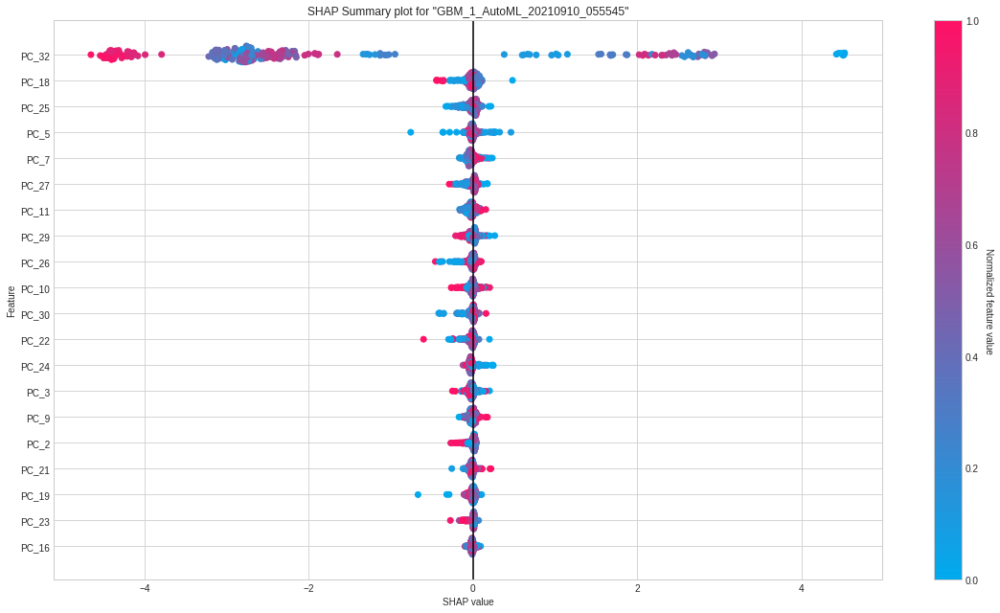

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

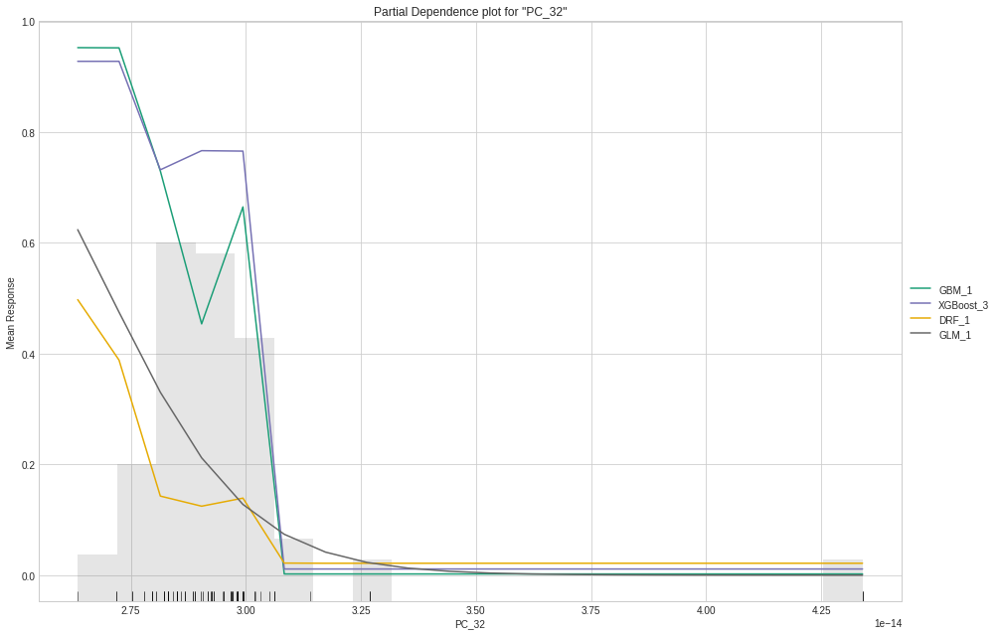

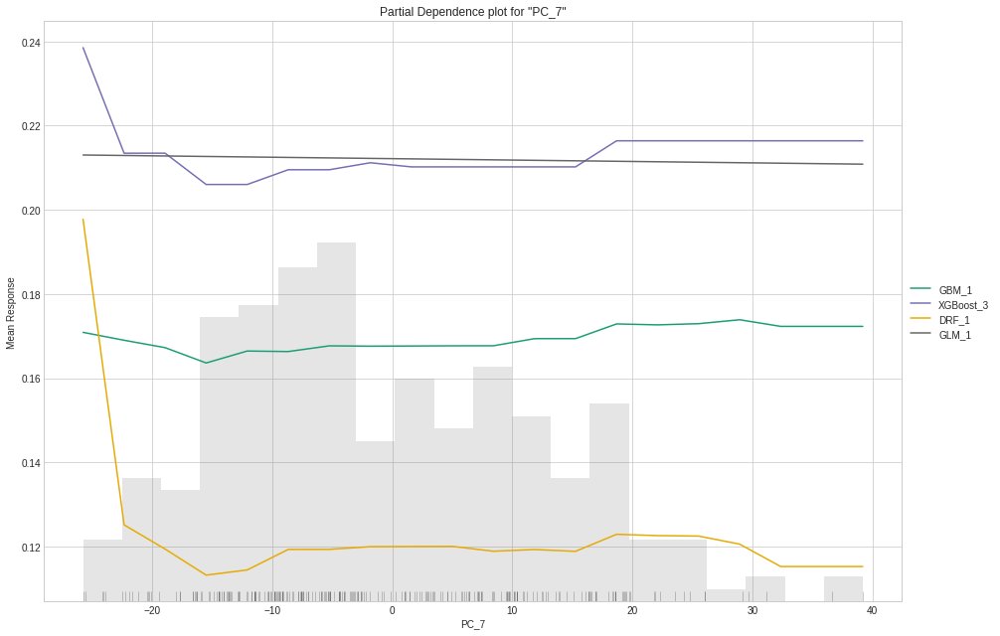

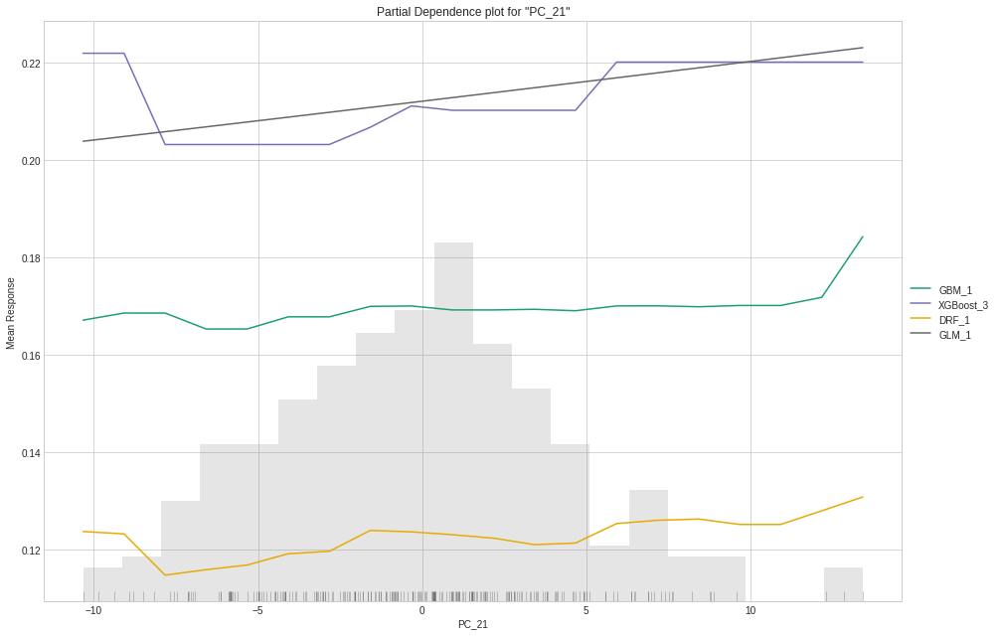

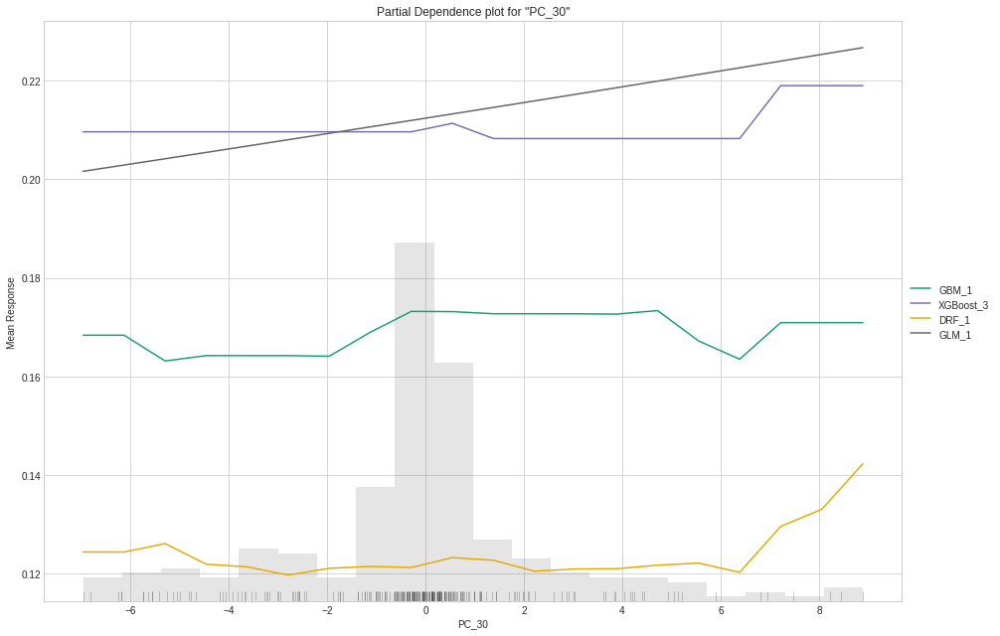

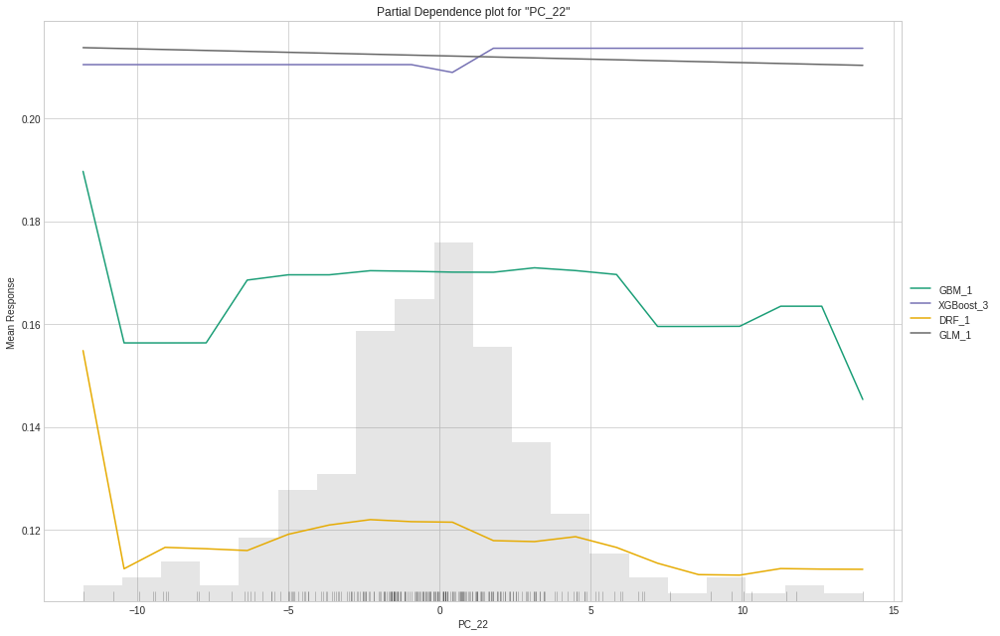



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,HA,LA
HA,0.639179,0.360821
HA,0.351763,0.648237
HA,0.533605,0.466395
LA,0.318811,0.681189
HA,0.638566,0.361434
HA,0.563817,0.436183
HA,0.468649,0.531351
HA,0.719073,0.280927
HA,0.983854,0.0161456
HA,0.990127,0.00987332




==== Subject 19 | Label Valence ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
05:56:30.348: Project: AutoML_20210910_55630348
05:56:30.348: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:56:30.348: Build control seed: 420
05:56:30.348: training frame: Frame key: automl_training_py_2294_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: 4972938779586353442
05:56:30.348: validation frame: NULL
05:56:30.348: leaderboard frame: NULL
05:56:30.349: blending frame: NULL
05:56:30.349: response column: valence
05:56:30.349: fold column: null
05:56:30.349: weights column: null
05:56:30.349: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_searc

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_2_AutoML_20210910_055630,0.998153,0.0651236,0.998571,0.0206896,0.135943,0.0184804,1710,0.053355,GBM
GBM_1_AutoML_20210910_055630,0.996459,0.0913567,0.997477,0.0241739,0.149489,0.0223468,1256,0.031323,GBM
XGBoost_3_AutoML_20210910_055630,0.968512,0.254827,0.975531,0.100637,0.275393,0.0758416,386,0.00867,XGBoost
XGBoost_1_AutoML_20210910_055630,0.869742,0.44258,0.901091,0.251173,0.384153,0.147574,718,0.008678,XGBoost
XGBoost_2_AutoML_20210910_055630,0.838968,0.486328,0.876128,0.326572,0.404288,0.163449,229,0.007762,XGBoost
DRF_1_AutoML_20210910_055630,0.779649,0.562199,0.790417,0.291258,0.435485,0.189647,516,0.017314,DRF
GLM_1_AutoML_20210910_055630,0.328769,0.693175,0.445621,0.5,0.499979,0.249979,24,0.006447,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_2_AutoML_20210910_055630


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9834912537916614: 


,,NV,PV,Error,Rate
0,NV,579.0,0.0,0.0,(0.0/579.0)
1,PV,0.0,574.0,0.0,(0.0/574.0)
2,Total,579.0,574.0,0.0,(0.0/1153.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

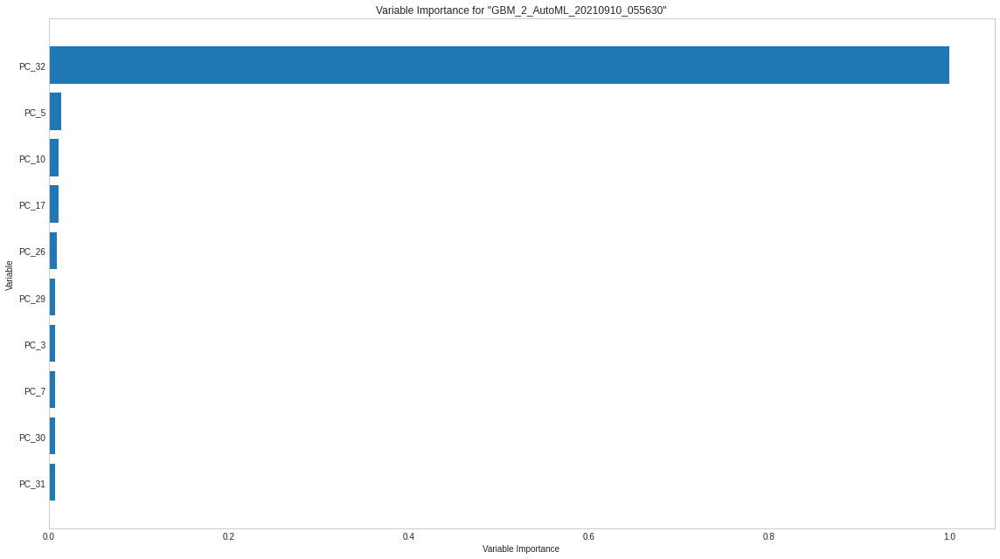

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

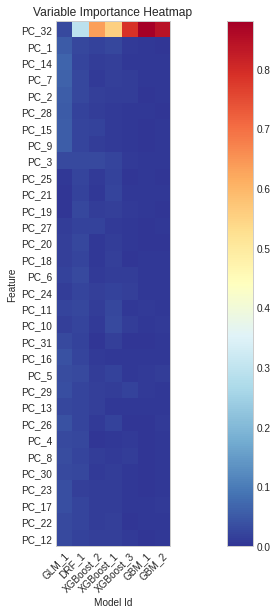

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

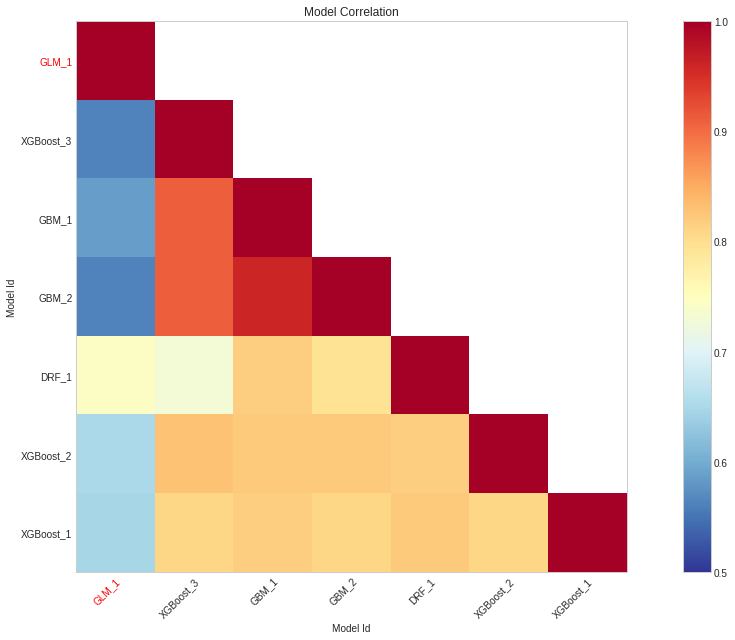

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

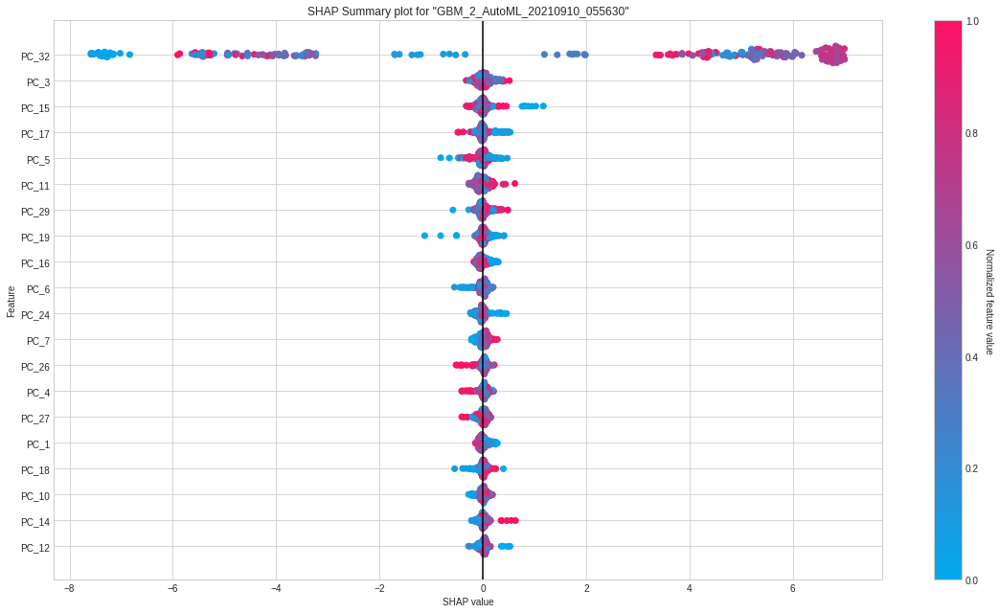

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

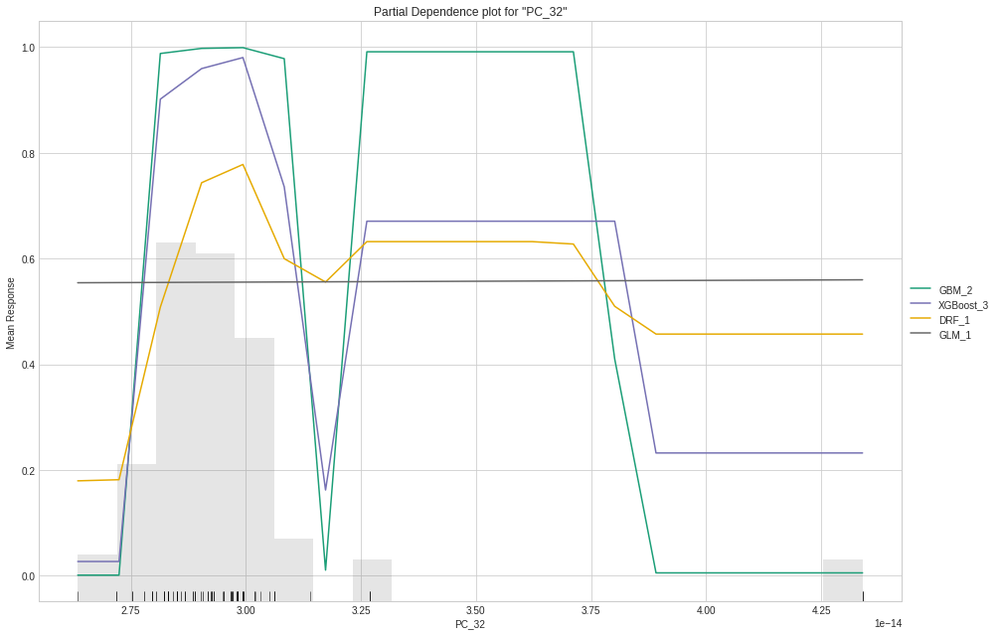

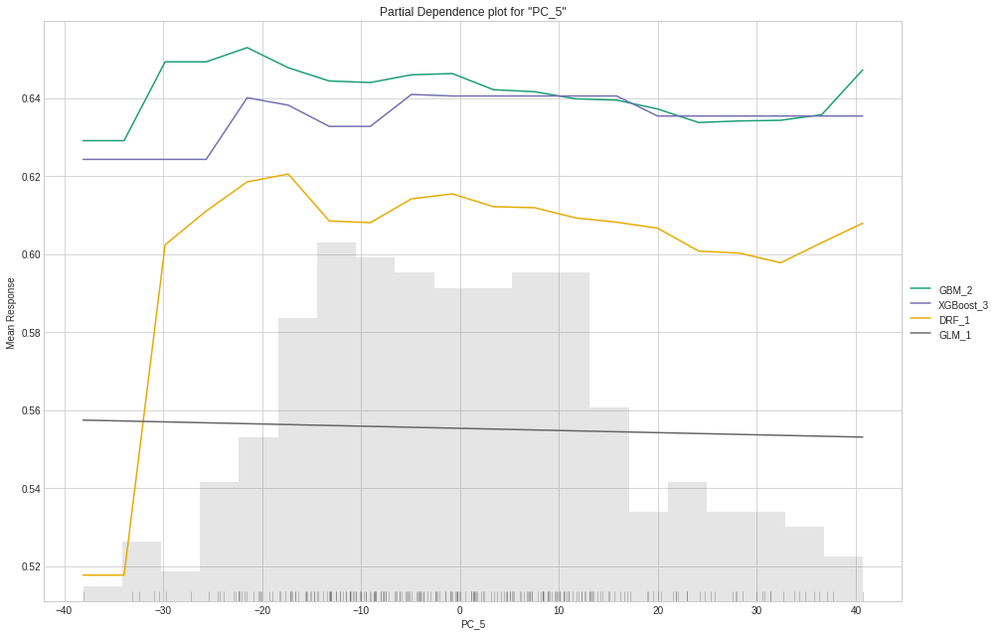

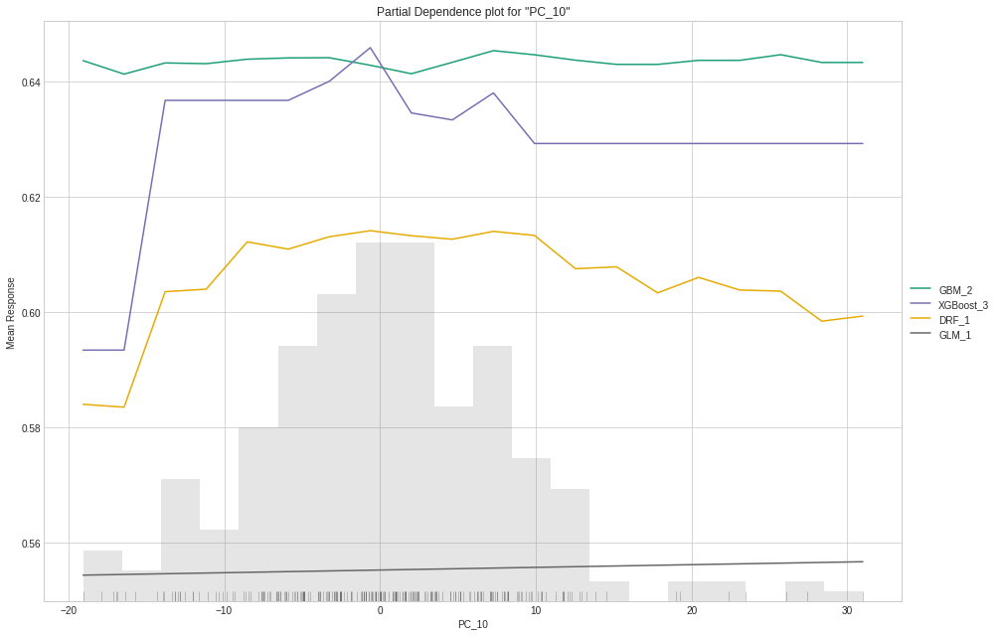

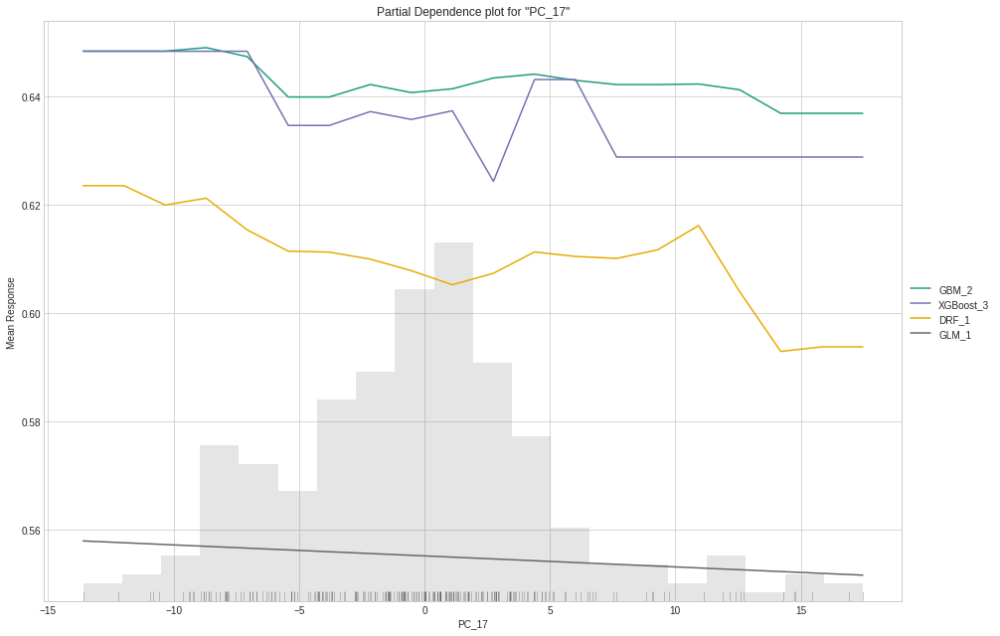

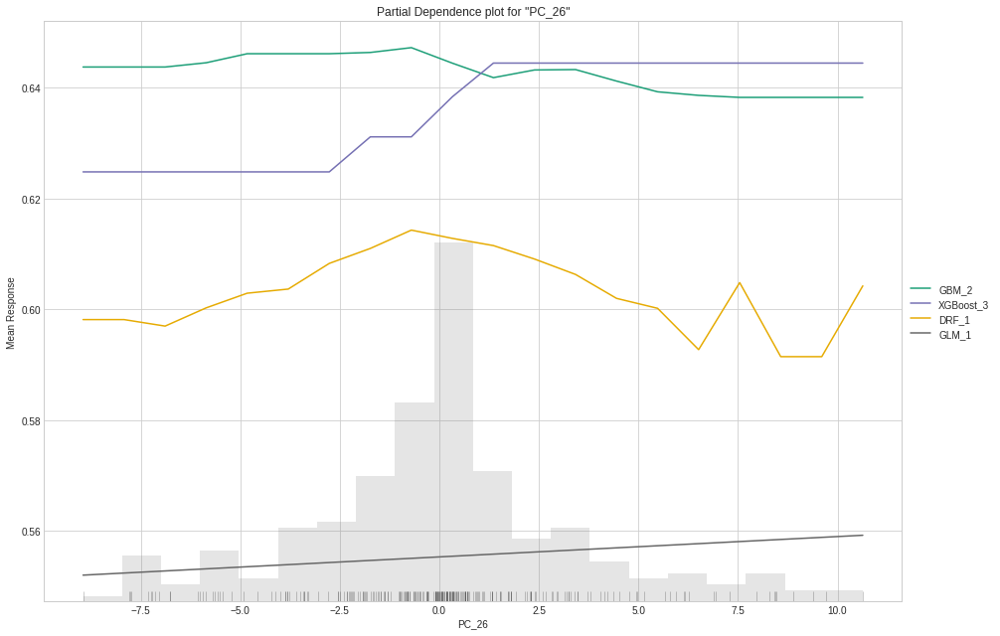



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,NV,PV
NV,0.139736,0.860264
NV,0.086693,0.913307
NV,0.138114,0.861886
NV,0.132888,0.867112
NV,0.154698,0.845302
NV,0.0698811,0.930119
NV,0.228348,0.771652
NV,0.217597,0.782403
PV,0.00067873,0.999321
PV,0.0012445,0.998755




==== Subject 23 | Label Arousal ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
05:57:23.114: Project: AutoML_20210910_55723114
05:57:23.115: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:57:23.115: Build control seed: 420
05:57:23.116: training frame: Frame key: automl_training_py_2402_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267380  checksum: 5861007574687675477
05:57:23.116: validation frame: NULL
05:57:23.116: leaderboard frame: NULL
05:57:23.116: blending frame: NULL
05:57:23.116: response column: arousal
05:57:23.116: fold column: null
05:57:23.116: weights column: null
05:57:23.116: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_searc

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_1_AutoML_20210910_055723,1,1.50359e-06,1,0,2.87149e-05,8.24548e-10,9802,0.286399,GBM
GBM_2_AutoML_20210910_055723,1,0.000196929,1,0,0.00236055,5.57218e-06,7308,0.163593,GBM
XGBoost_3_AutoML_20210910_055723,0.980364,0.19424,0.895258,0.064318,0.247674,0.0613423,391,0.008587,XGBoost
XGBoost_1_AutoML_20210910_055723,0.86904,0.342444,0.496153,0.239057,0.334705,0.112028,256,0.007773,XGBoost
XGBoost_2_AutoML_20210910_055723,0.80857,0.377318,0.434732,0.269319,0.347174,0.12053,411,0.00698,XGBoost
DRF_1_AutoML_20210910_055723,0.68823,0.484927,0.260853,0.314664,0.388195,0.150696,783,0.016106,DRF
GLM_1_AutoML_20210910_055723,0.474698,0.468644,0.155969,0.460439,0.382658,0.146427,51,0.00589,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_1_AutoML_20210910_055723


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9999999999990372: 


,,HA,LA,Error,Rate
0,HA,849.0,0.0,0.0,(0.0/849.0)
1,LA,0.0,844.0,0.0,(0.0/844.0)
2,Total,849.0,844.0,0.0,(0.0/1693.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

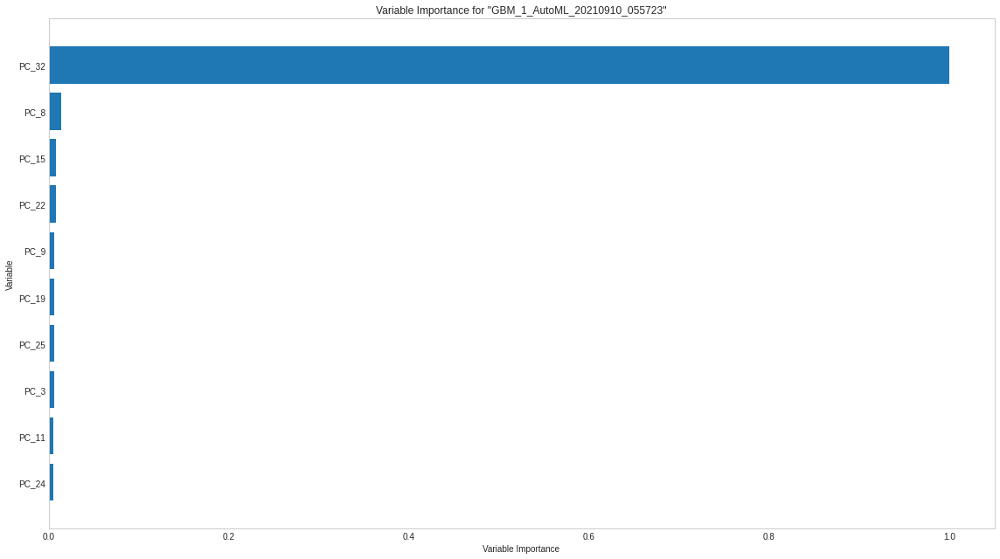

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

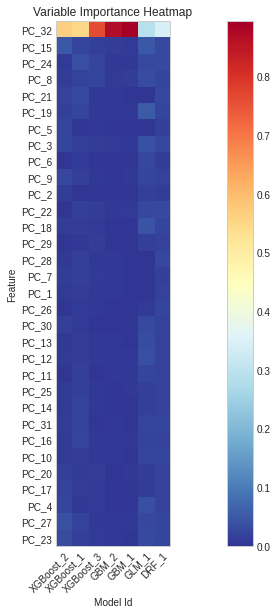

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

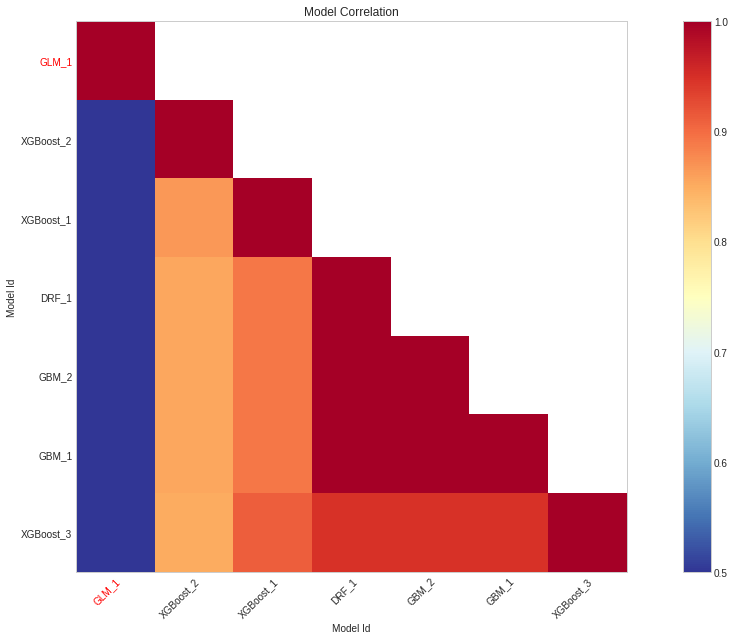

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

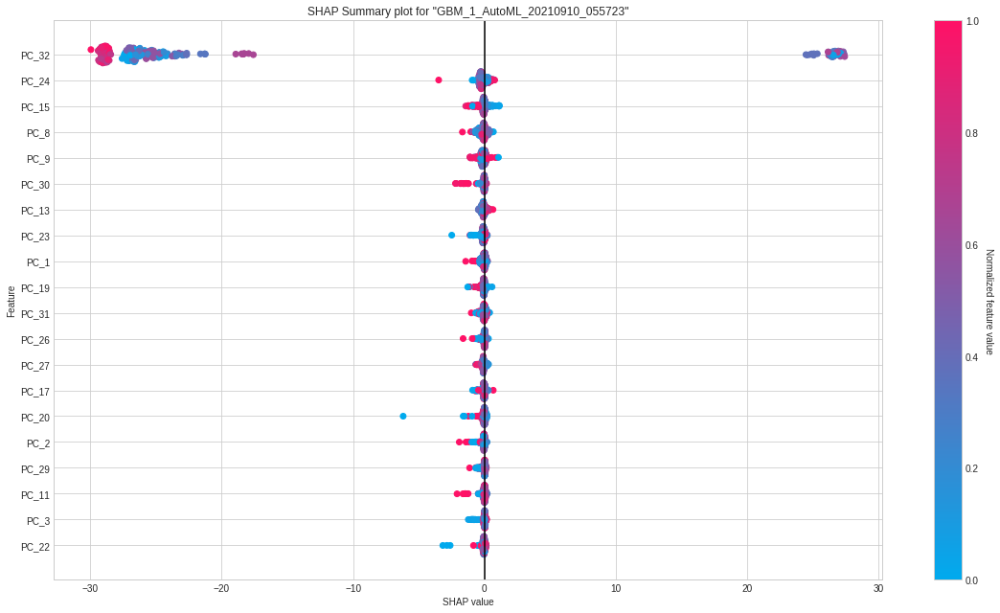

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

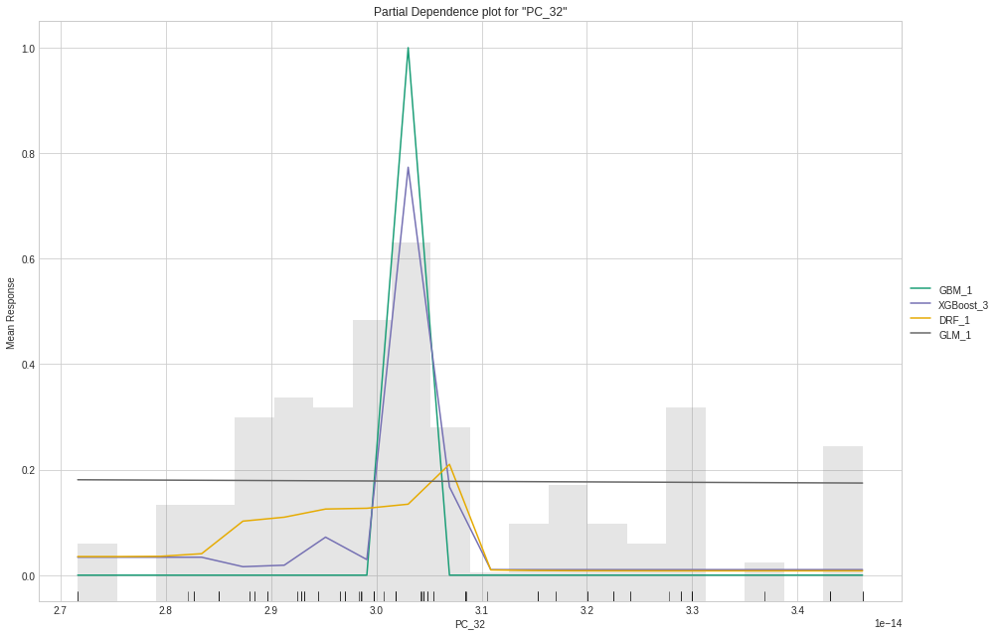

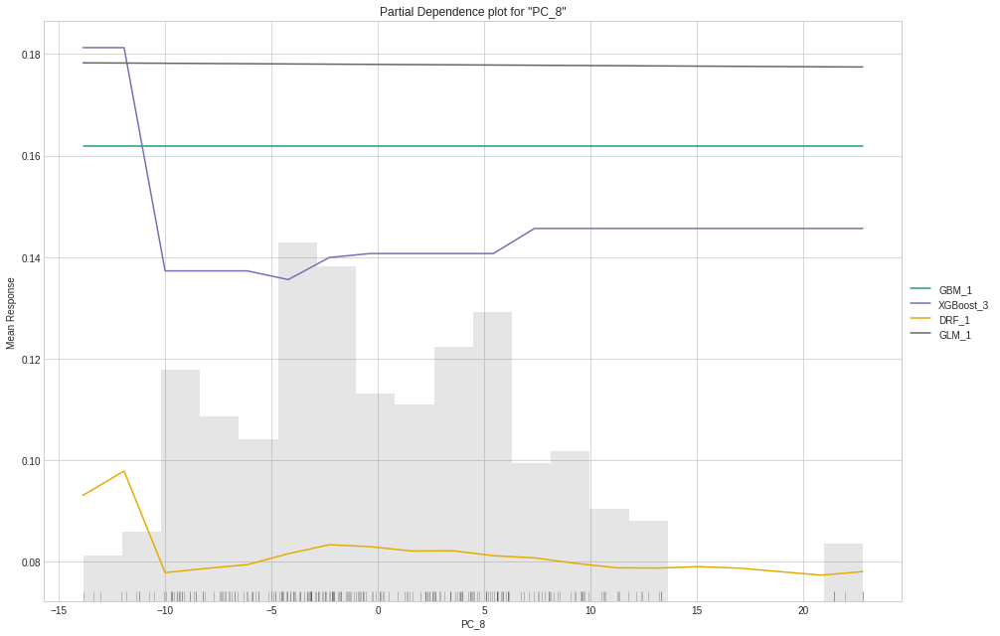

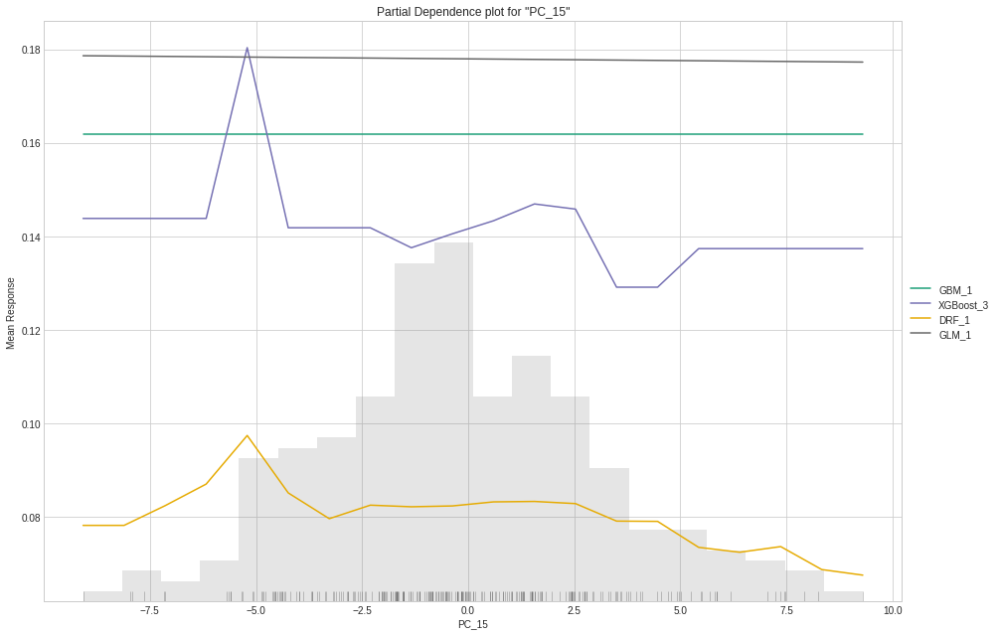

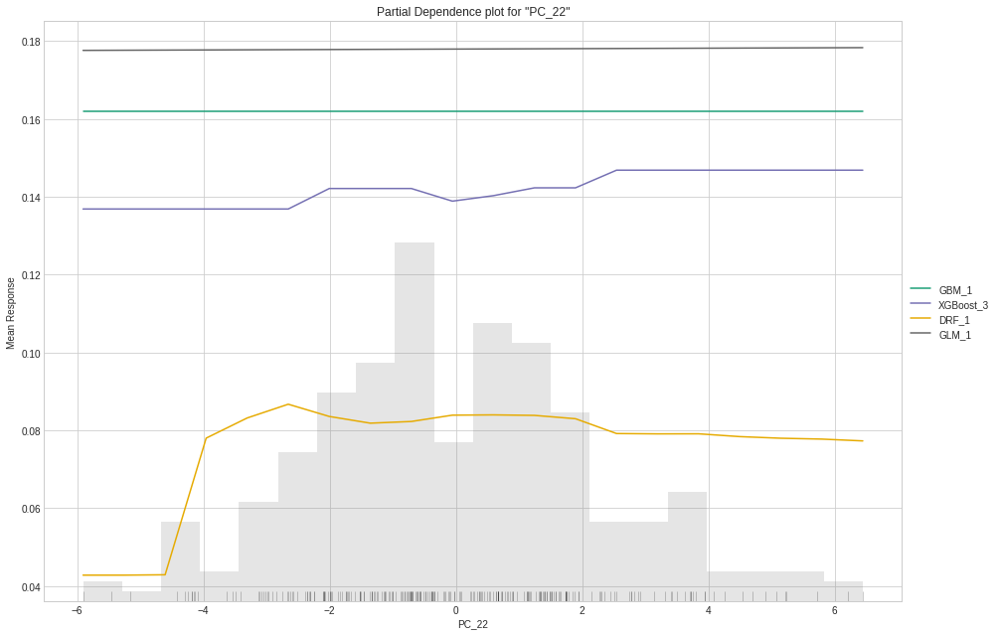

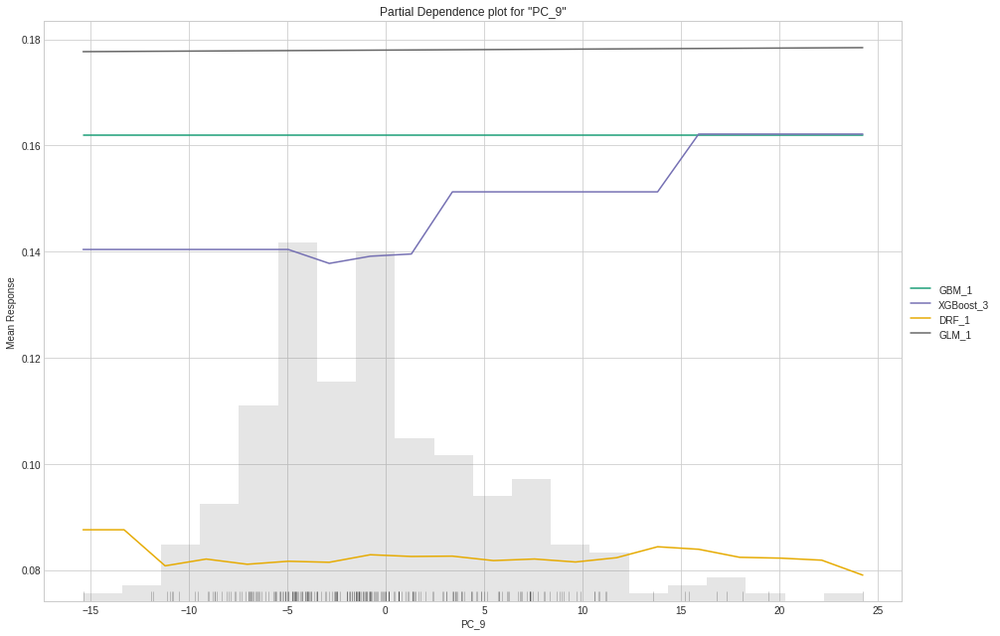



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,HA,LA
HA,1,3.78043e-13
HA,1,9.38949e-15
HA,1,1.31041e-12
HA,1,1.54963e-13
HA,1,1.95478e-13
HA,1,2.13245e-13
HA,1,3.47207e-13
HA,1,3.43196e-13
HA,1,2.63191e-13
HA,1,2.59023e-13




==== Subject 23 | Label Valence ====

Parse progress: |█████████████████████████████████████████████████████████| 100%
==Excluded Models: ['StackedEnsemble']
AutoML progress: |
05:59:54.518: Project: AutoML_20210910_55954518
05:59:54.518: Setting stopping tolerance adaptively based on the training frame: 0.031113569564352756
05:59:54.518: Build control seed: 420
05:59:54.518: training frame: Frame key: automl_training_py_2521_sid_b80e    cols: 33    rows: 1033  chunks: 1    size: 267376  checksum: -1601367826595638078
05:59:54.518: validation frame: NULL
05:59:54.518: leaderboard frame: NULL
05:59:54.518: blending frame: NULL
05:59:54.518: response column: valence
05:59:54.518: fold column: null
05:59:54.518: weights column: null
05:59:54.518: Loading execution steps: [{XGBoost : defaults}, {GLM : defaults}, {DRF : [def_1]}, {GBM : defaults}, {DeepLearning : defaults}, {DRF : [XRT]}, {XGBoost : grids}, {GBM : grids}, {DeepLearning : grids}, {GBM : [lr_annealing]}, {XGBoost : [lr_sear

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_2_AutoML_20210910_055954,0.999992,0.0286228,0.99999,0.000847458,0.0763947,0.00583615,4306,0.097534,GBM
GBM_1_AutoML_20210910_055954,0.999985,0.0508585,0.99998,0.00112867,0.0923518,0.00852885,4359,0.06314,GBM
XGBoost_3_AutoML_20210910_055954,0.896346,0.413253,0.873586,0.182423,0.364414,0.132797,388,0.010971,XGBoost
XGBoost_1_AutoML_20210910_055954,0.731916,0.610953,0.654571,0.343984,0.457927,0.209697,1294,0.00835,XGBoost
XGBoost_2_AutoML_20210910_055954,0.669482,0.652325,0.582532,0.415493,0.478461,0.228925,156,0.00753,XGBoost
DRF_1_AutoML_20210910_055954,0.613163,0.654941,0.572648,0.443737,0.482038,0.23236,799,0.018168,DRF
GLM_1_AutoML_20210910_055954,0.389107,0.684684,0.356962,0.498305,0.49575,0.245768,27,0.006302,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_2_AutoML_20210910_055954


Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9987709841505144: 


,,NV,PV,Error,Rate
0,NV,590.0,0.0,0.0,(0.0/590.0)
1,PV,0.0,581.0,0.0,(0.0/581.0)
2,Total,590.0,581.0,0.0,(0.0/1171.0)


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

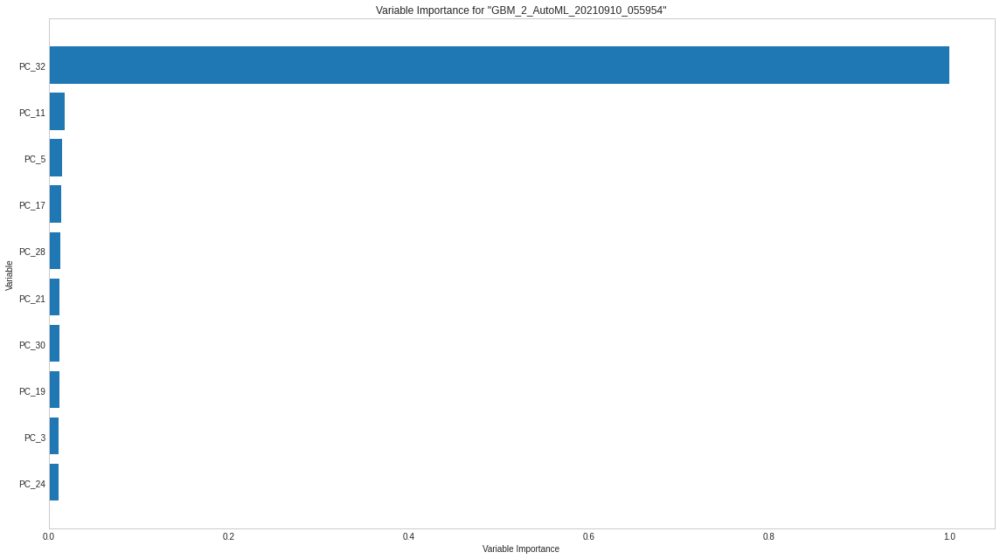

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

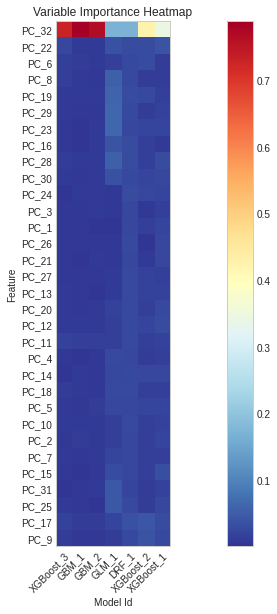

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

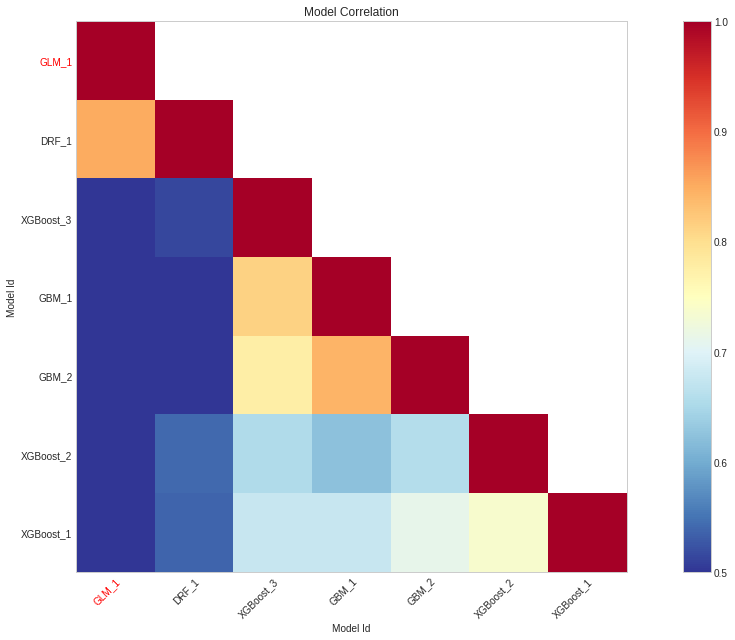

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

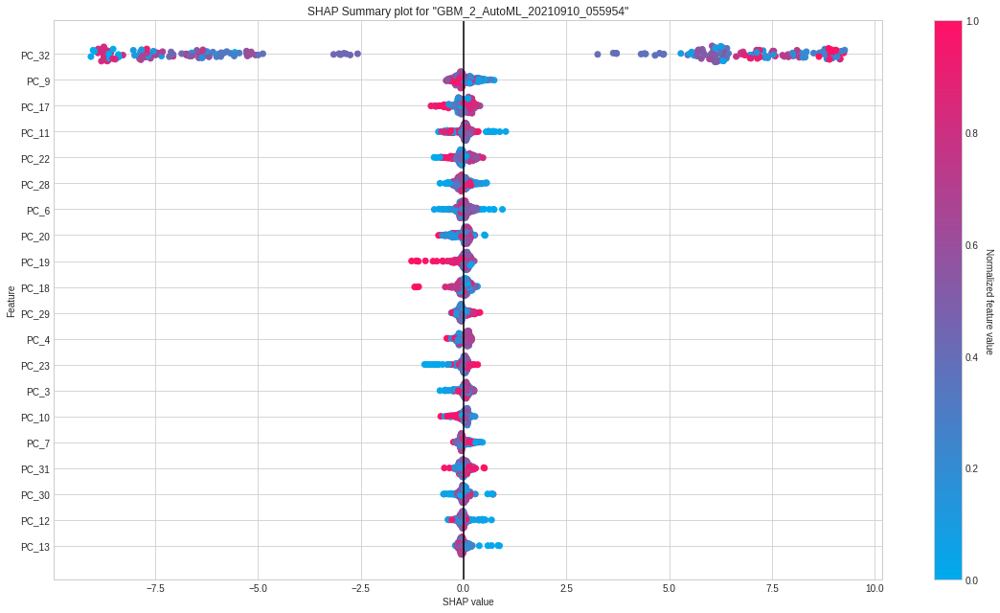

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

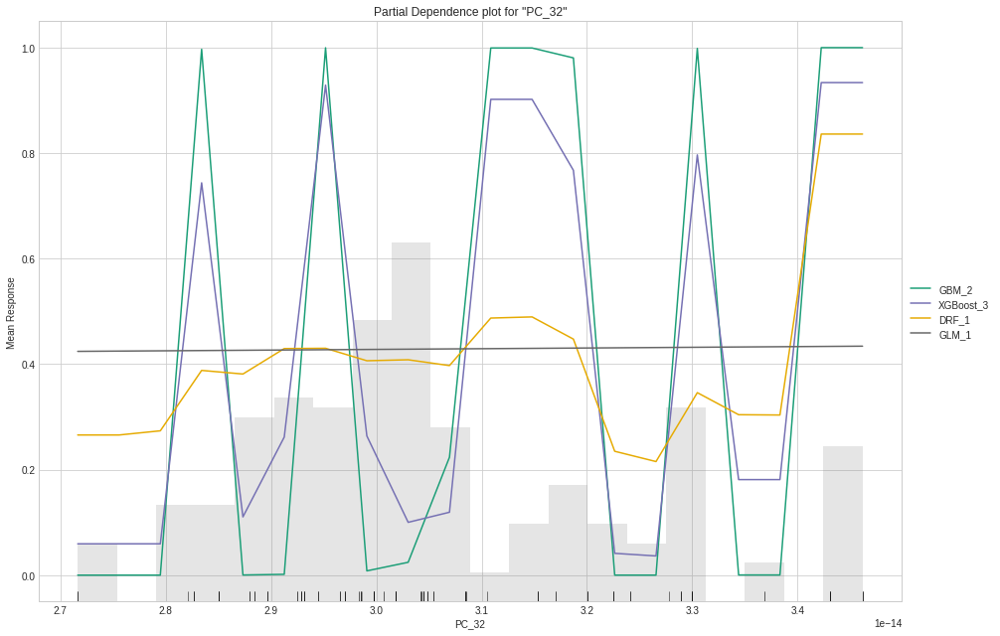

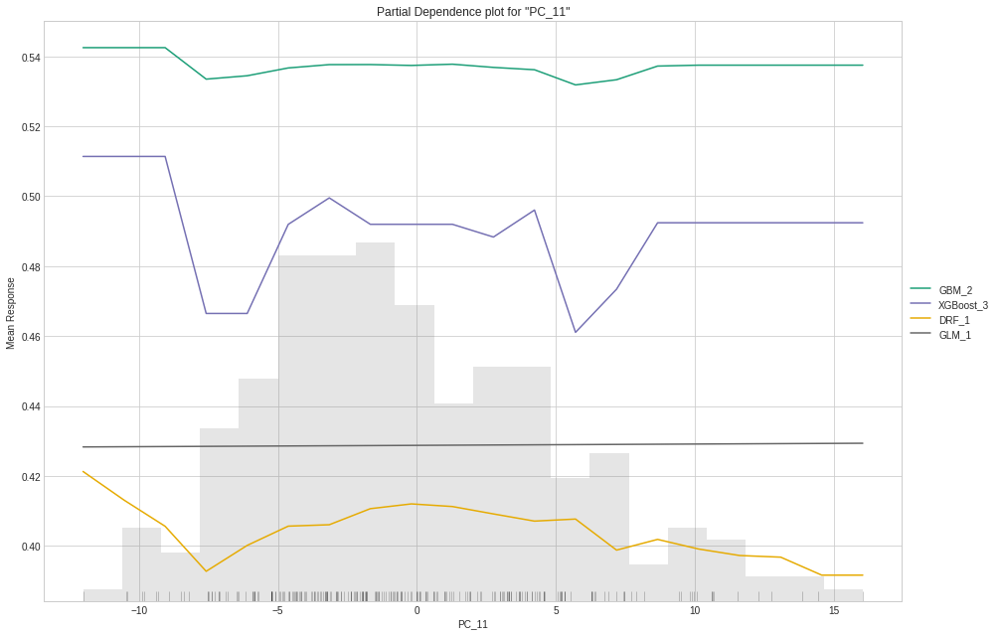

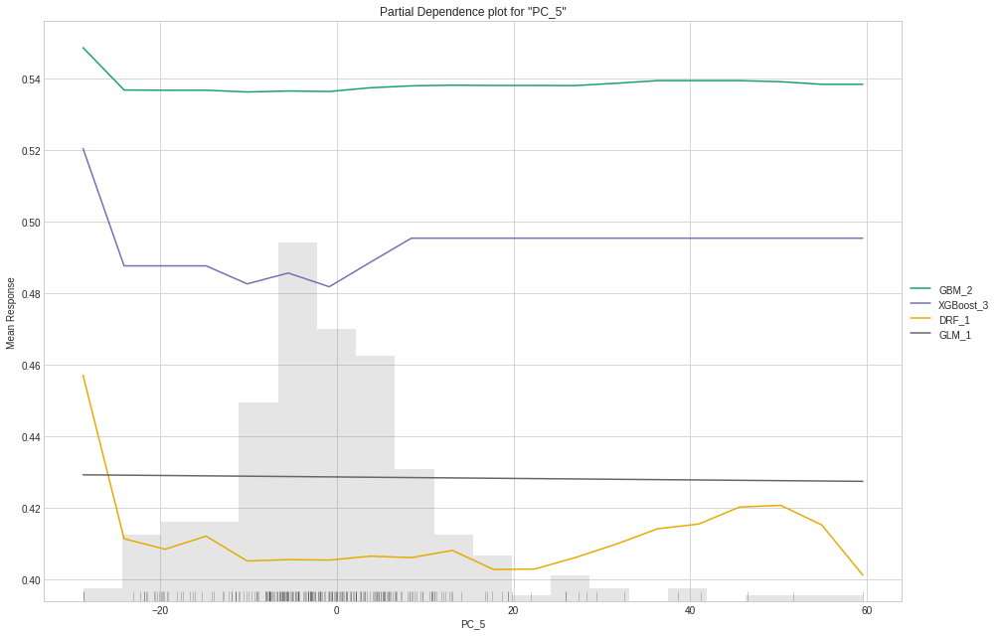

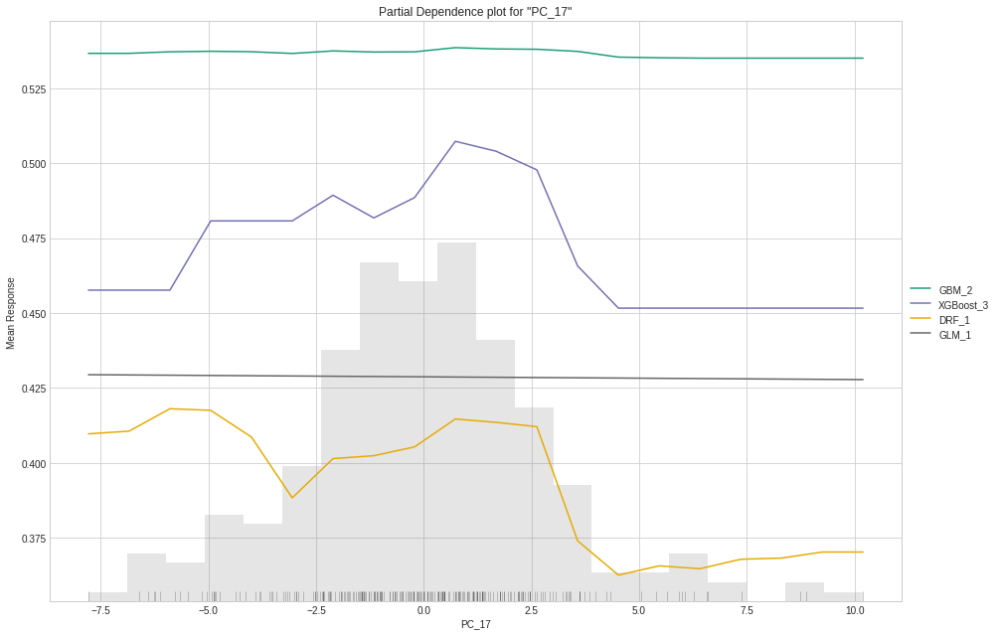

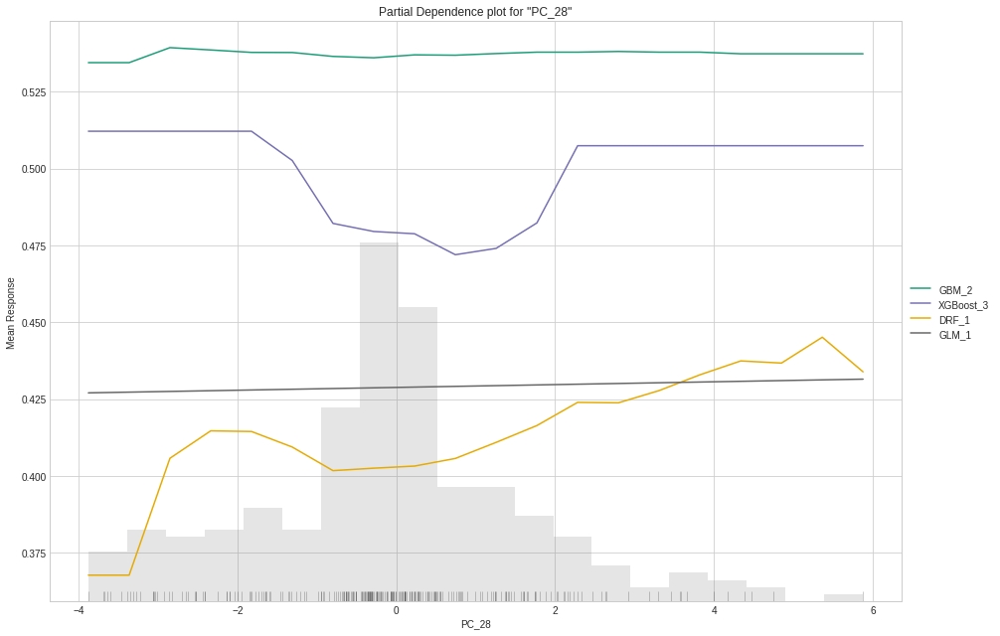



gbm prediction progress: |████████████████████████████████████████████████| 100%


predict,NV,PV
NV,0.0018107,0.998189
PV,0.000160092,0.99984
PV,0.00108758,0.998912
PV,0.000566235,0.999434
PV,0.000216696,0.999783
PV,0.000978738,0.999021
PV,0.000165618,0.999834
PV,0.000336953,0.999663
NV,0.00315386,0.996846
NV,0.0538926,0.946107



CPU times: user 2min 4s, sys: 9.72 s, total: 2min 14s
Wall time: 10min 36s


In [ ]:
%%time
subjects = [11, 19, 23]
train_subjects(subjects, 7, ["StackedEnsemble"])

In [ ]:
train_subjects?

In [ ]:
# save params from each leader model of each subject in a list

In [ ]:
!nvidia-smi

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



In [ ]:
video_list_path = "/content/video_list.csv"
video_list_df = pd.read_csv(video_list_path)
video_list_df[["Lastfm_tag", "Artist", "Title"]].iloc[:40]

,Lastfm_tag,Artist,Title
0,happy,Alphabeat,Fascination
1,fun,Emilíana Torrini,Jungle Drum
2,fun,The Go! Team,Huddle Formation
3,fun,Junior Senior,Move Your Feet
4,fun,Of Montreal,Wraith Pinned To The Mist And Other Games
5,sexy,Shakira,Loba
6,exciting,Lustra,Scotty Doesn't Know
7,pleasure,4 Strings,Let It Rain (Dj 4 Strings Vocal Mix)
8,happy,Michael Franti & Spearhead,Say Hey (I Love You)
9,adorable,Kara,Honey
